# Face Generation

Generative adversarial networks to generate new images of faces.

### Get the Data
We use two datasets in this project:
- MNIST
- CelebA

In [1]:
data_dir = './data'
import helper
helper.download_extract('mnist', data_dir)
helper.download_extract('celeba', data_dir)

Found mnist Data
Found celeba Data


## Explore the Data
### MNIST

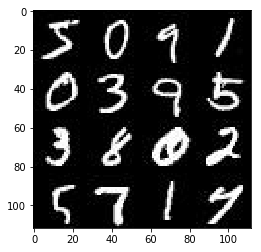

In [2]:
show_n_images = 20

%matplotlib inline
import os
from glob import glob
from matplotlib import pyplot

mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'mnist/*.jpg'))[:show_n_images], 28, 28, 'L')
pyplot.imshow(helper.images_square_grid(mnist_images, 'L'), cmap='gray')

### CelebA
The [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations.  Since you're going to be generating faces, you won't need the annotations.  You can view the first number of examples by changing `show_n_images`.

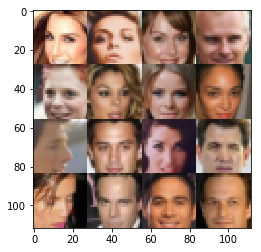

In [3]:
mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))[:show_n_images], 28, 28, 'RGB')
pyplot.imshow(helper.images_square_grid(mnist_images, 'RGB'))

## Preprocess the Data
Since the project's main focus is on building the GANs, we'll preprocess the data for you.  The values of the MNIST and CelebA dataset will be in the range of -0.5 to 0.5 of 28x28 dimensional images.  The CelebA images will be cropped to remove parts of the image that don't include a face, then resized down to 28x28.

The MNIST images are black and white images with a single [color channel](https://en.wikipedia.org/wiki/Channel_(digital_image%29) while the CelebA images have [3 color channels (RGB color channel)](https://en.wikipedia.org/wiki/Channel_(digital_image%29#RGB_Images).
## Graph process

1. `model_inputs`
- `discriminator`
- `generator`
- `model_loss`
- `model_opt`
- `train`

### Check the Version of TensorFlow and Access to GPU
This will check to make sure you have the correct version of TensorFlow and access to a GPU

In [4]:
from distutils.version import LooseVersion
import warnings
import tensorflow as tf

# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))
    
print(tf.test.is_gpu_available(cuda_only=False))  # Returns True if is GPU

TensorFlow Version: 1.1.0
Default GPU Device: /gpu:0
True


In [5]:
# Load tests
import problem_unittests as tests

### Placeholders

In [6]:
def model_inputs(image_width, image_height, image_channels, z_dim):
    """
    ||| Purpose
    Create placeholders. (Soon an AI will do this for us #Skynet)
    
    <<< Input
    image_width (int):  ie 32
    image_height (int): ie 32
    image_channels (int): ie 1 or 3
    z_dim (int): ie 100
    
    >>> Output
    Tuple of (tensor of real input images, tensor of z data, learning rate)
    """
    
    real_inputs = tf.placeholder( tf.float32, (None, image_width, image_height, image_channels),
                                  name="real_inputs")
    
    z_inputs = tf.placeholder( tf.float32, (None, z_dim), name="z_inputs" )
    
    learning_rate = tf.placeholder(tf.float32, name="learning_rate")

    return real_inputs, z_inputs, learning_rate


tests.test_model_inputs(model_inputs)

Tests Passed


### Discriminator
Implement `discriminator` to create a discriminator neural network that discriminates on `images`.  This function should be able to reuse the variabes in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "discriminator" to allow the variables to be reused.  The function should return a tuple of (tensor output of the generator, tensor logits of the generator).

In [7]:
def leaky_relu(alpha, layer):
    """
    ||| Purpose
    Define a leaky relu activation function.
    
    >>> Input
    Alpha (float):  ie .2
    Layer (Tensor): ie output from tf.layers.dense()
    
    <<< Output
    Layer (Tensor, same type as Layer): ie to feed to next layer
    """
    
    activated_layer = tf.maximum( alpha * layer, layer)
    
    return activated_layer

In [8]:
def convolutional_custom( input_layer, filter_size, kernal_size, strides, alpha):
    
    """
    ||| Purpose
    1. Convultion2d
    2. Leaky relu activation
    """
    
    # Scanning
    convolutional = tf.layers.conv2d( input_layer, filter_size, kernal_size,
                                      strides, 'same')

    # Non-linear leaky relu
    activated_layer = leaky_relu( alpha, convolutional)
    
    return activated_layer  # magic

In [9]:
def convolutional_batch_normalized_custom( input_layer, filter_size, kernal_size,
                                           strides, alpha, trainingFLAG):
    """
    ||| Purpose
    1. Convultion2d
    2. Batch normalization
    3. Leaky relu activation
    """
    
    # Scanning
    convolutional = tf.layers.conv2d( input_layer, filter_size, kernal_size,
                                                strides, 'same')
    
    # 0s and 1s
    batch_normalized = tf.layers.batch_normalization( convolutional,
                                                     training = trainingFLAG)

    # Non-linear leaky relu
    activated_layer = leaky_relu( alpha, batch_normalized)
    
    return activated_layer  # magic

## Discriminator

In [10]:
def discriminator(images, reuse=False, alpha=0.2):
    """
    ||| Purpose
    Create the discriminator network
    
    >>> Input
    image: Tensor of input image(s)
    reuse: Boolean if the weights should be reused
    
    <<< Output
    Tuple of (tensor output of the discriminator, tensor logits of the discriminator)
    """
    with tf.variable_scope('discriminator', reuse = reuse):
        
        cake_1 = convolutional_custom( images, 128, 5, 2, alpha)
        
        cake_2 = convolutional_batch_normalized_custom( cake_1, 256, 5, 2, alpha, True)
        
        cake_3 = convolutional_batch_normalized_custom( cake_2, 512, 5, 2, alpha, True)
        
        flat_as_a_pancake = tf.reshape(cake_3, (-1, 4 * 4 * 512))
        
        # LOGITS who knew this is what it stood for (clearly not Log-odds):
        logical_orangic_growth_init_termination_system = tf.layers.dense( flat_as_a_pancake, 1) 
        
        # Given we live in a quauntum world this is technically true
        quantum_probabilities = tf.sigmoid( logical_orangic_growth_init_termination_system )

    
    return quantum_probabilities, logical_orangic_growth_init_termination_system


tests.test_discriminator(discriminator, tf)

Tests Passed


In [11]:
def convolutional_transpose_batch_normalized_custom( input_layer, filter_size, kernal_size,
                                                     strides, alpha, trainingFLAG):
    """
    ||| Purpose
    1. Convultion2d *** w/ transpose ***
    2. Batch normalization
    3. Leaky relu activation
    """
    
    # de convolute sorta
    convolutional_transpose = tf.layers.conv2d_transpose( input_layer, filter_size, kernal_size,
                                                          strides, 'same')
    
    # 0s and 1s
    batch_normalized = tf.layers.batch_normalization( convolutional_transpose,
                                                     training = trainingFLAG)

    # Non-linear leaky relu
    activated_layer = leaky_relu( alpha, batch_normalized)
    
    return activated_layer  # magic
    
    

## Generator
Implement `generator` to generate an image using `z`. This function should be able to reuse the variabes in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "generator" to allow the variables to be reused. The function should return the generated 28 x 28 x `out_channel_dim` images.

In [12]:
def generator(z, out_channel_dim, is_train=True, alpha=.2):
    """
    Create the generator network
    
    >>> Input
    z: Input z
    out_channel_dim: The number of channels in the output image
    is_train: Boolean if generator is being used for training
    
    <<< Output
    The tensor output of the generator
    """
    
    # Had differently but changed to pass test...
    reuse = not is_train
    
    with tf.variable_scope('generator', reuse = reuse):
        
        cake_1_substep_1 = tf.layers.dense( z, 7 * 7 * 512)
        cake_1_substep_2 = tf.reshape( cake_1_substep_1, ( -1, 7, 7, 512))
        cake_1_substep_3 = tf.layers.batch_normalization( cake_1_substep_2, training = is_train)
        cake_1 = leaky_relu( alpha, cake_1_substep_3)

        cake_2 = convolutional_transpose_batch_normalized_custom( cake_1, 256, 5, 2, alpha, is_train)
        
        cake_3 = convolutional_transpose_batch_normalized_custom( cake_2, 128, 5, 2, alpha, is_train)
        
        # extra_layer = convolutional_transpose_batch_normalized_custom( cake_1, 512, 5, 2, alpha, is_train)

        # Scan transpose, no normalization or activation
        logits = tf.layers.conv2d_transpose( cake_3,  out_channel_dim, 5, 1, 'same') 
        
        # Activation
        output = tf.tanh(logits)

        # print(output.shape)

    return output


tests.test_generator(generator, tf)

Tests Passed


### Loss
Implement `model_loss` to build the GANs for training and calculate the loss.  The function should return a tuple of (discriminator loss, generator loss).  Use the following functions you implemented:
- `discriminator(images, reuse=False)`
- `generator(z, out_channel_dim, is_train=True)`

In [13]:
def cross_entropy_loss_custom(logits, labels):
    
    """
    ||| Purpose
    make model_loss () more readable
    1. Probability distribution differecne with log-odds
    2. Some Mu action, computates averages across dimensions of tensor
    """
    
    probability = tf.nn.sigmoid_cross_entropy_with_logits( logits = logits, 
                                                           labels = labels)
    
    reduce_mean = tf.reduce_mean( probability )
    
    return reduce_mean

In [37]:
def model_loss(input_real, input_z, out_channel_dim, alpha = .2):
    """
    ||| Purpose
    Get the loss for the discriminator and generator
    
    >>> Inputs
    input_real: Images from the real dataset
    input_z: Z input
    out_channel_dim: The number of channels in the output image
    
    <<< Outputs
    A tuple of (discriminator loss, generator loss)
    """
    
    # Generaetor model
    g_model = generator( input_z, out_channel_dim, alpha = alpha)
    
    # Dual discriminator models
    d_model_real, d_logits_real = discriminator( input_real, alpha = alpha)
    d_model_fake, d_logits_fake = discriminator( g_model, reuse = True, alpha = alpha)
    
    # Generate labels
    smooth = .1  # Suggestion from Ian Goodfellow in lessons
    ones_like_d_model_real = tf.ones_like( d_model_real ) * (1 - smooth)
    zeros_like_d_model_fake = tf.zeros_like( d_model_fake )
    ones_like_d_model_fake = tf.ones_like( d_model_fake )
    
    # Returns reduce mean ( cross entropy with logits )
    d_loss_real = cross_entropy_loss_custom( d_logits_real, ones_like_d_model_real )
    d_loss_fake = cross_entropy_loss_custom( d_logits_fake, zeros_like_d_model_fake )
    d_loss = d_loss_real + d_loss_fake
    
    g_loss = cross_entropy_loss_custom( d_logits_fake, ones_like_d_model_fake)
    # invert loss
    # g_loss = cross_entropy_loss_custom( d_logits_real, ones_like_d_model_fake)
    
    return d_loss, g_loss

tests.test_model_loss(model_loss)

Tests Passed


### Optimization
Implement `model_opt` to create the optimization operations for the GANs. Use [`tf.trainable_variables`](https://www.tensorflow.org/api_docs/python/tf/trainable_variables) to get all the trainable variables.  Filter the variables with names that are in the discriminator and generator scope names.  The function should return a tuple of (discriminator training operation, generator training operation).

In [15]:


def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    
    >>> Inputs
    d_loss: Discriminator loss Tensor
    g_loss: Generator loss Tensor
    learning_rate: Learning Rate Placeholder
    beta1: The exponential decay rate for the 1st moment in the optimizer
    
    <<< Outputs
    A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    d_train_opt = tf.train.AdamOptimizer( learning_rate, beta1=beta1).minimize( d_loss, var_list=d_vars)
    g_train_opt = tf.train.AdamOptimizer( learning_rate, beta1=beta1).minimize( g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt


tests.test_model_opt(model_opt, tf)

Tests Passed


## Neural Network Training
### Show Output
Use this function to show the current output of the generator during training. It will help you determine how well the GANs is training.

In [16]:
# Udacity function
import numpy as np

def show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode):
    """
    Show example output for the generator
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
    example_z = np.random.uniform(-1, 1, size=[n_images, z_dim])

    samples = sess.run(
        generator(input_z, out_channel_dim, False),
        feed_dict={input_z: example_z})

    images_grid = helper.images_square_grid(samples, image_mode)
    pyplot.imshow(images_grid, cmap=cmap)
    pyplot.show()

### Train

In [17]:
import matplotlib.pyplot as plt

def print_losses_chart(losses):
    fig, ax = plt.subplots()
    losses = np.array(losses)
    plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
    plt.plot(losses.T[1], label='Generator', alpha=0.5)
    plt.title("Training Losses")
    plt.legend()
    pyplot.show()


In [18]:
def train(net, epoch_count, batch_size, z_dim, get_batches, data_image_mode):
    """
    Train the GAN

    <<< Inputs
    epoch_count: Number of epochs
    batch_size: Batch Size
    z_dim: Z dimension
    learning_rate: Learning Rate
    beta1: The exponential decay rate for the 1st moment in the optimizer
    get_batches: Function to get batches
    data_shape: Shape of the data
    data_image_mode: The image mode to use for images ("RGB" or "L")
    
    >>> Ouputs
    losses : list o losses
    
    """    
    saver = tf.train.Saver()
    losses = []
    steps = 0
    print_every = 10
    show_every = 100
    
    with tf.Session() as sess:
        
        sess.run(tf.global_variables_initializer())
        
        for epoch_i in range(epoch_count):
            
            for batch_real in get_batches(batch_size):
               
                # print(batch_real.shape)
                steps += 1
                
                # Sample noise               
                batch_z = np.random.uniform( -1.0, 1.0, size = (batch_size,  z_dim))
                
                #print(batch_z)
                # add noise as suggested by https://arxiv.org/pdf/1701.07875.pdf
                batch_z_noise = np.random.normal( 0, .1)
                batch_z = batch_z * batch_z_noise
                
                #print(batch_z)
            
                # Run through all real batches twice per fake batch
                batch_real = batch_real * 2
                
                # print(batch_z.shape, batch_z.dtype)
                
                # Run optimizers
                _ = sess.run( net.d_opt, feed_dict = { net.input_real: batch_real,
                                                       net.input_z: batch_z })
                
                _ = sess.run( net.g_opt, feed_dict = { net.input_z: batch_z })
                    
                
                if steps == 1 or steps % show_every == 0:
                    
                    print( "Step: ", steps)
                        
                    show_generator_output(sess, 20, net.input_z, net.out_channel_dim, 
                                              data_image_mode)
                
                if steps % print_every == 0:
                    
                    train_loss_d = net.d_loss.eval( { net.input_real: batch_real, net.input_z: batch_z } )

                    train_loss_g = net.g_loss.eval( { net.input_z: batch_z } )
                    
                    print(  "Epoch {} / {} ".format( epoch_i + 1,  epoch_count),
                            "D loss:  {:.4f} ...".format( train_loss_d ),
                            "G loss:  {:.4f} ...".format( train_loss_g ) )
                    
                    losses.append( (train_loss_d, train_loss_g) ) 
            
        saver.save(sess, 'model_checkpoints/genereator.ckpt')
    
    return losses
                

## Graph class

In [32]:

class GAN:
    def __init__(self, data_shape, z_dim,
                 learning_rate, alpha=0.2, beta1=0.5):
        """
        ||| Purpose
        # Class for GANS :)

        >>> Inputs
        data_shape: List ie  32, 3, 3
        z_dim: int
        learning_rate: ie .001  (not placeholder, this is from model_inputs() )
        alpha and beta if you like

        <<< Outputs
        class GAN ready to learn! 

        """

        # Rest each run otherwise TF gets confused / expects different use case
        tf.reset_default_graph()
    
        # data_shape is expected to have colour channels in 3rd position 0 indexed
        # ie (32, 32, 3) where 3 == colour channels
        self.out_channel_dim = data_shape[2]
        
        # TF placeholders to class placeholders
        self.input_real, self.input_z, self.learning_rate = model_inputs(*data_shape, z_dim)
        
        # Assign learning rate value to learning rate TF placeholder
        self.learning_rate = learning_rate
        
        # loss
        self.d_loss, self.g_loss = model_loss( self.input_real, self.input_z,
                                               self.out_channel_dim)
        
        # Hill descent learning
        self.d_opt, self.g_opt = model_opt( self.d_loss, self.g_loss, 
                                            self.learning_rate, beta1)

# Explorations

Moved to readMe.md

---

# Testing

### MNIST
Test your GANs architecture on MNIST.  After 2 epochs, the GANs should be able to generate images that look like handwritten digits.  Make sure the loss of the generator is lower than the loss of the discriminator or close to 0.

In [47]:
z_dim = 128
learning_rate = 0.0003
batch_size = 64
alpha = 0.1
beta1 = 0.5
epoch_count = 2

mnist_dataset = helper.Dataset('mnist', glob(os.path.join(data_dir, 'mnist/*.jpg')))
data_shape = mnist_dataset.shape[1 : ]
print(data_shape)

(28, 28, 1)


Step:  1


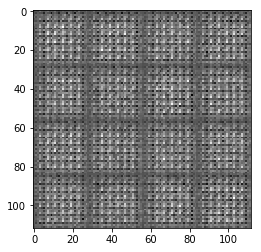

Epoch 1 / 2  D loss:  0.4373 ... G loss:  18.5627 ...
Epoch 1 / 2  D loss:  1.3922 ... G loss:  1.3539 ...
Epoch 1 / 2  D loss:  0.5344 ... G loss:  2.4224 ...
Epoch 1 / 2  D loss:  0.8284 ... G loss:  4.2800 ...
Epoch 1 / 2  D loss:  0.4045 ... G loss:  4.7921 ...
Epoch 1 / 2  D loss:  0.4271 ... G loss:  12.0794 ...
Epoch 1 / 2  D loss:  0.4087 ... G loss:  4.3193 ...
Epoch 1 / 2  D loss:  2.0980 ... G loss:  16.5142 ...
Epoch 1 / 2  D loss:  1.0012 ... G loss:  15.4967 ...
Step:  100


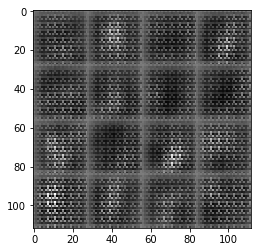

Epoch 1 / 2  D loss:  0.4415 ... G loss:  5.4994 ...
Epoch 1 / 2  D loss:  0.4358 ... G loss:  4.0395 ...
Epoch 1 / 2  D loss:  1.8056 ... G loss:  2.4482 ...
Epoch 1 / 2  D loss:  1.0647 ... G loss:  2.7297 ...
Epoch 1 / 2  D loss:  0.8923 ... G loss:  1.2803 ...
Epoch 1 / 2  D loss:  0.4478 ... G loss:  3.6033 ...
Epoch 1 / 2  D loss:  0.5769 ... G loss:  2.9814 ...
Epoch 1 / 2  D loss:  0.6593 ... G loss:  1.7464 ...
Epoch 1 / 2  D loss:  0.7086 ... G loss:  7.2823 ...
Epoch 1 / 2  D loss:  0.6839 ... G loss:  2.9255 ...
Step:  200


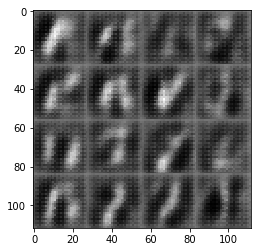

Epoch 1 / 2  D loss:  0.9796 ... G loss:  1.1321 ...
Epoch 1 / 2  D loss:  0.5084 ... G loss:  2.4475 ...
Epoch 1 / 2  D loss:  0.6594 ... G loss:  1.7698 ...
Epoch 1 / 2  D loss:  1.1937 ... G loss:  0.6202 ...
Epoch 1 / 2  D loss:  0.7436 ... G loss:  3.9295 ...
Epoch 1 / 2  D loss:  1.3713 ... G loss:  5.0125 ...
Epoch 1 / 2  D loss:  0.9722 ... G loss:  2.4811 ...
Epoch 1 / 2  D loss:  1.4087 ... G loss:  3.9919 ...
Epoch 1 / 2  D loss:  1.5412 ... G loss:  0.4537 ...
Epoch 1 / 2  D loss:  0.7336 ... G loss:  1.9988 ...
Step:  300


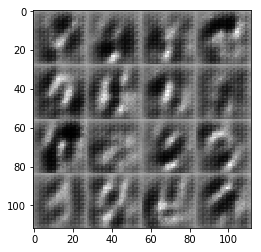

Epoch 1 / 2  D loss:  0.9207 ... G loss:  1.0890 ...
Epoch 1 / 2  D loss:  0.6283 ... G loss:  1.8946 ...
Epoch 1 / 2  D loss:  0.9682 ... G loss:  1.0840 ...
Epoch 1 / 2  D loss:  0.9009 ... G loss:  3.1973 ...
Epoch 1 / 2  D loss:  0.9976 ... G loss:  1.7612 ...
Epoch 1 / 2  D loss:  1.7778 ... G loss:  5.3811 ...
Epoch 1 / 2  D loss:  0.8674 ... G loss:  1.6812 ...
Epoch 1 / 2  D loss:  0.7826 ... G loss:  1.5250 ...
Epoch 1 / 2  D loss:  1.3543 ... G loss:  1.0440 ...
Epoch 1 / 2  D loss:  1.1869 ... G loss:  1.2538 ...
Step:  400


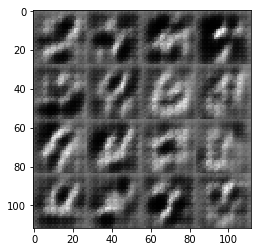

Epoch 1 / 2  D loss:  0.9431 ... G loss:  1.4221 ...
Epoch 1 / 2  D loss:  0.8279 ... G loss:  1.6002 ...
Epoch 1 / 2  D loss:  0.8759 ... G loss:  1.4831 ...
Epoch 1 / 2  D loss:  1.1232 ... G loss:  1.3206 ...
Epoch 1 / 2  D loss:  0.8635 ... G loss:  1.3295 ...
Epoch 1 / 2  D loss:  1.0680 ... G loss:  1.2604 ...
Epoch 1 / 2  D loss:  0.5561 ... G loss:  2.1591 ...
Epoch 1 / 2  D loss:  0.9290 ... G loss:  1.6137 ...
Epoch 1 / 2  D loss:  1.3897 ... G loss:  1.9479 ...
Epoch 1 / 2  D loss:  1.0069 ... G loss:  1.3036 ...
Step:  500


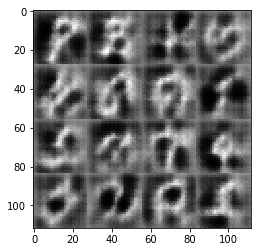

Epoch 1 / 2  D loss:  0.9871 ... G loss:  1.6084 ...
Epoch 1 / 2  D loss:  0.9581 ... G loss:  1.4671 ...
Epoch 1 / 2  D loss:  0.8537 ... G loss:  1.4010 ...
Epoch 1 / 2  D loss:  1.0505 ... G loss:  1.7010 ...
Epoch 1 / 2  D loss:  0.8645 ... G loss:  1.6417 ...
Epoch 1 / 2  D loss:  1.0647 ... G loss:  0.8984 ...
Epoch 1 / 2  D loss:  1.2387 ... G loss:  1.4553 ...
Epoch 1 / 2  D loss:  1.2767 ... G loss:  0.5861 ...
Epoch 1 / 2  D loss:  1.0326 ... G loss:  1.0427 ...
Epoch 1 / 2  D loss:  1.0525 ... G loss:  1.0894 ...
Step:  600


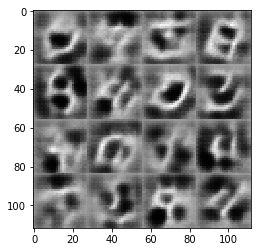

Epoch 1 / 2  D loss:  1.0256 ... G loss:  1.5205 ...
Epoch 1 / 2  D loss:  1.0033 ... G loss:  1.6060 ...
Epoch 1 / 2  D loss:  1.1364 ... G loss:  1.3609 ...
Epoch 1 / 2  D loss:  1.2587 ... G loss:  0.9661 ...
Epoch 1 / 2  D loss:  0.5561 ... G loss:  2.5031 ...
Epoch 1 / 2  D loss:  1.1138 ... G loss:  1.3645 ...
Epoch 1 / 2  D loss:  0.9011 ... G loss:  1.4201 ...
Epoch 1 / 2  D loss:  1.2846 ... G loss:  1.4636 ...
Epoch 1 / 2  D loss:  1.1456 ... G loss:  0.9100 ...
Epoch 1 / 2  D loss:  1.0746 ... G loss:  1.7481 ...
Step:  700


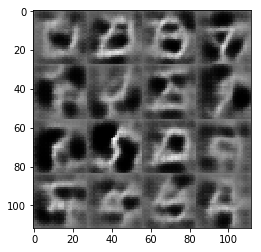

Epoch 1 / 2  D loss:  1.1148 ... G loss:  1.3641 ...
Epoch 1 / 2  D loss:  0.8941 ... G loss:  1.2083 ...
Epoch 1 / 2  D loss:  1.0385 ... G loss:  1.2751 ...
Epoch 1 / 2  D loss:  0.7096 ... G loss:  1.7242 ...
Epoch 1 / 2  D loss:  0.8959 ... G loss:  1.4644 ...
Epoch 1 / 2  D loss:  0.8628 ... G loss:  1.2643 ...
Epoch 1 / 2  D loss:  0.9160 ... G loss:  1.4246 ...
Epoch 1 / 2  D loss:  0.9989 ... G loss:  1.3929 ...
Epoch 1 / 2  D loss:  1.1204 ... G loss:  0.8903 ...
Epoch 1 / 2  D loss:  1.1586 ... G loss:  0.9856 ...
Step:  800


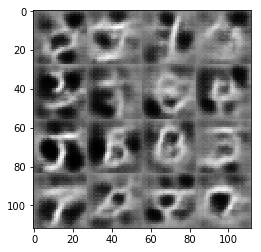

Epoch 1 / 2  D loss:  2.0353 ... G loss:  0.2113 ...
Epoch 1 / 2  D loss:  0.8927 ... G loss:  1.6667 ...
Epoch 1 / 2  D loss:  1.0874 ... G loss:  1.6395 ...
Epoch 1 / 2  D loss:  1.1587 ... G loss:  1.8420 ...
Epoch 1 / 2  D loss:  0.8521 ... G loss:  1.4631 ...
Epoch 1 / 2  D loss:  1.3685 ... G loss:  3.6963 ...
Epoch 1 / 2  D loss:  1.2038 ... G loss:  2.3584 ...
Epoch 1 / 2  D loss:  1.2516 ... G loss:  0.9021 ...
Epoch 1 / 2  D loss:  1.1828 ... G loss:  0.9677 ...
Epoch 1 / 2  D loss:  0.7105 ... G loss:  1.6107 ...
Step:  900


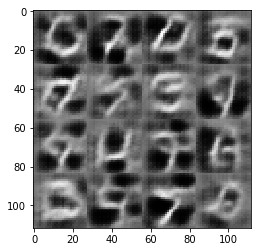

Epoch 1 / 2  D loss:  1.1684 ... G loss:  1.1780 ...
Epoch 1 / 2  D loss:  1.0534 ... G loss:  1.5820 ...
Epoch 1 / 2  D loss:  0.8641 ... G loss:  1.2582 ...
Epoch 1 / 2  D loss:  1.1025 ... G loss:  1.1099 ...
Epoch 2 / 2  D loss:  0.9967 ... G loss:  1.4671 ...
Epoch 2 / 2  D loss:  0.9673 ... G loss:  1.3891 ...
Epoch 2 / 2  D loss:  0.9835 ... G loss:  1.4607 ...
Epoch 2 / 2  D loss:  1.0334 ... G loss:  1.1780 ...
Epoch 2 / 2  D loss:  0.9330 ... G loss:  1.3509 ...
Epoch 2 / 2  D loss:  1.0210 ... G loss:  1.4523 ...
Step:  1000


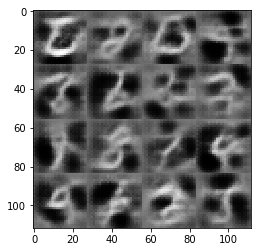

Epoch 2 / 2  D loss:  0.9905 ... G loss:  1.3519 ...
Epoch 2 / 2  D loss:  1.2112 ... G loss:  1.4594 ...
Epoch 2 / 2  D loss:  0.9513 ... G loss:  1.2244 ...
Epoch 2 / 2  D loss:  0.9304 ... G loss:  1.3832 ...
Epoch 2 / 2  D loss:  0.9468 ... G loss:  1.2419 ...
Epoch 2 / 2  D loss:  0.9162 ... G loss:  1.1062 ...
Epoch 2 / 2  D loss:  0.9944 ... G loss:  2.0662 ...
Epoch 2 / 2  D loss:  1.1113 ... G loss:  2.1738 ...
Epoch 2 / 2  D loss:  1.0058 ... G loss:  1.1468 ...
Epoch 2 / 2  D loss:  0.9525 ... G loss:  1.1682 ...
Step:  1100


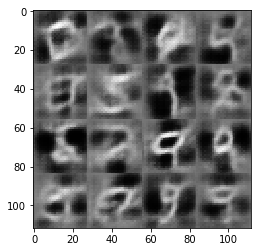

Epoch 2 / 2  D loss:  0.9783 ... G loss:  1.1159 ...
Epoch 2 / 2  D loss:  0.8568 ... G loss:  1.6043 ...
Epoch 2 / 2  D loss:  0.7157 ... G loss:  1.4878 ...
Epoch 2 / 2  D loss:  0.9051 ... G loss:  1.4880 ...
Epoch 2 / 2  D loss:  1.0593 ... G loss:  0.9789 ...
Epoch 2 / 2  D loss:  0.8176 ... G loss:  1.3974 ...
Epoch 2 / 2  D loss:  1.0289 ... G loss:  1.5042 ...
Epoch 2 / 2  D loss:  1.3871 ... G loss:  0.5481 ...
Epoch 2 / 2  D loss:  1.2404 ... G loss:  0.6733 ...
Epoch 2 / 2  D loss:  1.0317 ... G loss:  1.8089 ...
Step:  1200


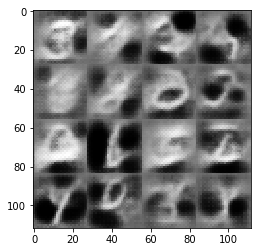

Epoch 2 / 2  D loss:  1.1113 ... G loss:  1.8570 ...
Epoch 2 / 2  D loss:  1.1902 ... G loss:  1.5465 ...
Epoch 2 / 2  D loss:  0.8414 ... G loss:  1.6150 ...
Epoch 2 / 2  D loss:  0.9389 ... G loss:  1.5797 ...
Epoch 2 / 2  D loss:  0.9098 ... G loss:  1.7185 ...
Epoch 2 / 2  D loss:  0.7045 ... G loss:  1.7576 ...
Epoch 2 / 2  D loss:  1.0251 ... G loss:  1.2120 ...
Epoch 2 / 2  D loss:  0.9760 ... G loss:  1.1977 ...
Epoch 2 / 2  D loss:  0.9672 ... G loss:  1.0995 ...
Epoch 2 / 2  D loss:  1.0708 ... G loss:  2.7362 ...
Step:  1300


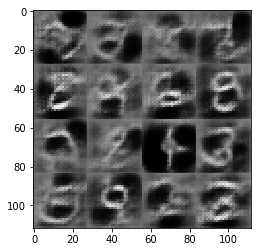

Epoch 2 / 2  D loss:  0.4063 ... G loss:  4.0511 ...
Epoch 2 / 2  D loss:  0.7837 ... G loss:  1.3691 ...
Epoch 2 / 2  D loss:  0.8581 ... G loss:  1.5956 ...
Epoch 2 / 2  D loss:  0.8366 ... G loss:  1.3013 ...
Epoch 2 / 2  D loss:  0.8867 ... G loss:  1.7628 ...
Epoch 2 / 2  D loss:  1.1456 ... G loss:  0.8485 ...
Epoch 2 / 2  D loss:  0.8579 ... G loss:  1.1500 ...
Epoch 2 / 2  D loss:  1.2350 ... G loss:  1.3543 ...
Epoch 2 / 2  D loss:  0.9065 ... G loss:  1.8941 ...
Epoch 2 / 2  D loss:  0.7357 ... G loss:  1.9088 ...
Step:  1400


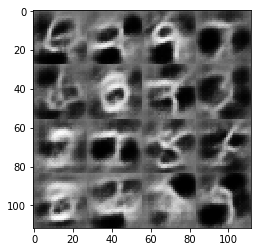

Epoch 2 / 2  D loss:  0.8775 ... G loss:  1.3198 ...
Epoch 2 / 2  D loss:  0.8749 ... G loss:  1.6244 ...
Epoch 2 / 2  D loss:  1.0614 ... G loss:  1.8183 ...
Epoch 2 / 2  D loss:  0.9513 ... G loss:  0.9929 ...
Epoch 2 / 2  D loss:  0.8164 ... G loss:  2.6373 ...
Epoch 2 / 2  D loss:  1.5769 ... G loss:  0.4269 ...
Epoch 2 / 2  D loss:  0.5221 ... G loss:  2.9764 ...
Epoch 2 / 2  D loss:  0.8474 ... G loss:  1.3543 ...
Epoch 2 / 2  D loss:  0.9954 ... G loss:  1.1037 ...
Epoch 2 / 2  D loss:  0.6841 ... G loss:  1.7176 ...
Step:  1500


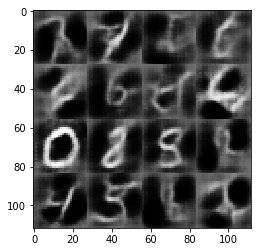

Epoch 2 / 2  D loss:  0.9038 ... G loss:  2.4898 ...
Epoch 2 / 2  D loss:  0.9329 ... G loss:  1.7527 ...
Epoch 2 / 2  D loss:  1.2110 ... G loss:  2.9139 ...
Epoch 2 / 2  D loss:  0.6804 ... G loss:  1.7497 ...
Epoch 2 / 2  D loss:  0.7778 ... G loss:  1.5414 ...
Epoch 2 / 2  D loss:  0.7378 ... G loss:  1.5241 ...
Epoch 2 / 2  D loss:  0.8679 ... G loss:  1.2828 ...
Epoch 2 / 2  D loss:  0.6076 ... G loss:  2.3916 ...
Epoch 2 / 2  D loss:  1.0698 ... G loss:  1.4999 ...
Epoch 2 / 2  D loss:  1.0351 ... G loss:  1.1330 ...
Step:  1600


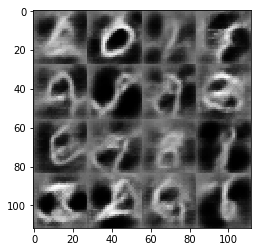

Epoch 2 / 2  D loss:  0.8839 ... G loss:  1.7060 ...
Epoch 2 / 2  D loss:  1.0689 ... G loss:  0.9208 ...
Epoch 2 / 2  D loss:  0.9246 ... G loss:  1.1202 ...
Epoch 2 / 2  D loss:  0.8316 ... G loss:  1.4607 ...
Epoch 2 / 2  D loss:  0.4050 ... G loss:  4.0177 ...
Epoch 2 / 2  D loss:  0.5077 ... G loss:  2.4551 ...
Epoch 2 / 2  D loss:  0.7292 ... G loss:  1.7317 ...
Epoch 2 / 2  D loss:  0.6490 ... G loss:  1.8070 ...
Epoch 2 / 2  D loss:  0.6497 ... G loss:  1.5849 ...
Epoch 2 / 2  D loss:  0.8024 ... G loss:  1.5317 ...
Step:  1700


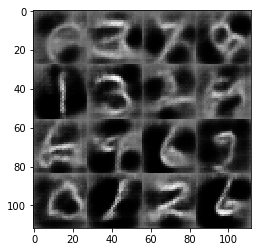

Epoch 2 / 2  D loss:  0.6078 ... G loss:  2.8468 ...
Epoch 2 / 2  D loss:  0.9040 ... G loss:  2.0799 ...
Epoch 2 / 2  D loss:  0.5285 ... G loss:  1.9206 ...
Epoch 2 / 2  D loss:  1.3597 ... G loss:  0.5898 ...
Epoch 2 / 2  D loss:  0.9615 ... G loss:  1.0381 ...
Epoch 2 / 2  D loss:  0.8243 ... G loss:  1.6548 ...
Epoch 2 / 2  D loss:  0.8277 ... G loss:  1.3062 ...
Epoch 2 / 2  D loss:  0.8124 ... G loss:  1.9237 ...
Epoch 2 / 2  D loss:  1.4617 ... G loss:  0.4966 ...
Epoch 2 / 2  D loss:  0.7439 ... G loss:  1.7416 ...
Step:  1800


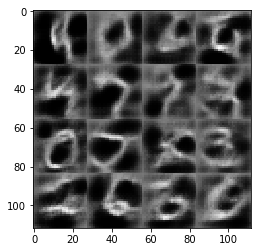

Epoch 2 / 2  D loss:  1.2901 ... G loss:  0.8990 ...
Epoch 2 / 2  D loss:  1.6267 ... G loss:  0.4288 ...
Epoch 2 / 2  D loss:  0.8184 ... G loss:  1.4087 ...
Epoch 2 / 2  D loss:  0.7005 ... G loss:  1.6810 ...
Epoch 2 / 2  D loss:  0.5433 ... G loss:  2.1097 ...
Epoch 2 / 2  D loss:  0.9853 ... G loss:  1.8454 ...
Epoch 2 / 2  D loss:  0.8596 ... G loss:  1.2109 ...
Epoch 2 / 2  D loss:  0.8460 ... G loss:  1.1361 ...


In [48]:
# learning rate = 3e-4
# batch size = 5
# alpha = .2

net = GAN( data_shape, z_dim, learning_rate, alpha = alpha, beta1 = beta1)

losses = train( net, epoch_count, batch_size, z_dim, 
                mnist_dataset.get_batches, mnist_dataset.image_mode)

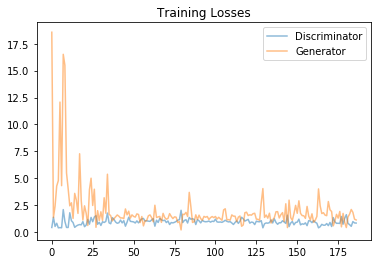

In [49]:
print_losses_chart(losses)

INFO:tensorflow:Restoring parameters from model_checkpoints/genereator.ckpt


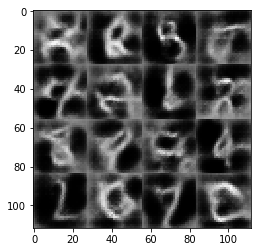

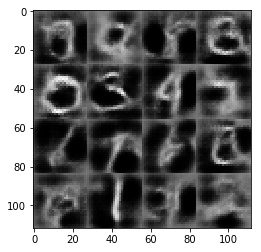

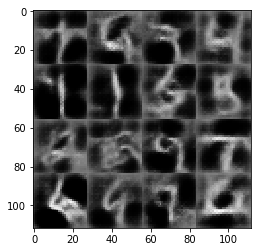

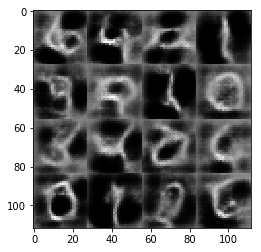

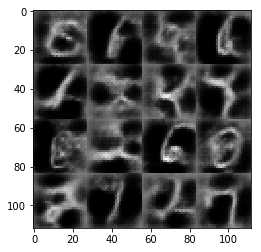

In [50]:

with tf.Session() as sess:
    
    saver = tf.train.Saver()
    saver.restore(sess, "model_checkpoints/genereator.ckpt")
    
    for x in range(5):
        show_generator_output(sess, 20, net.input_z, net.out_channel_dim, 
                                              mnist_dataset.image_mode)

---

Step:  1


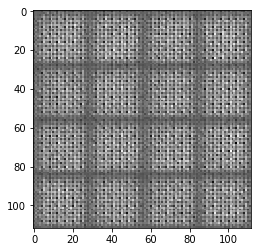

Epoch 1 / 2  D loss:  2.8916 ... G loss:  0.1625 ...
Epoch 1 / 2  D loss:  0.6909 ... G loss:  2.5383 ...
Epoch 1 / 2  D loss:  0.3732 ... G loss:  9.3610 ...
Epoch 1 / 2  D loss:  0.3635 ... G loss:  10.4544 ...
Epoch 1 / 2  D loss:  0.5172 ... G loss:  3.9271 ...
Epoch 1 / 2  D loss:  0.4223 ... G loss:  7.8077 ...
Epoch 1 / 2  D loss:  0.3659 ... G loss:  4.8934 ...
Epoch 1 / 2  D loss:  0.4842 ... G loss:  10.6831 ...
Epoch 1 / 2  D loss:  0.4376 ... G loss:  2.9983 ...
Step:  100


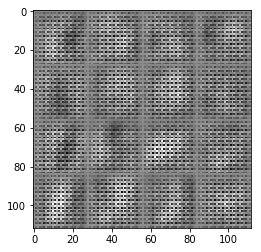

Epoch 1 / 2  D loss:  0.3971 ... G loss:  3.7456 ...
Epoch 1 / 2  D loss:  0.4402 ... G loss:  8.4332 ...
Epoch 1 / 2  D loss:  0.3695 ... G loss:  4.6813 ...
Epoch 1 / 2  D loss:  0.3599 ... G loss:  5.8925 ...
Epoch 1 / 2  D loss:  0.3603 ... G loss:  5.0088 ...
Epoch 1 / 2  D loss:  0.3479 ... G loss:  4.7251 ...
Epoch 1 / 2  D loss:  0.7208 ... G loss:  3.2030 ...
Epoch 1 / 2  D loss:  1.3029 ... G loss:  3.5254 ...
Epoch 1 / 2  D loss:  1.2097 ... G loss:  11.7813 ...
Epoch 1 / 2  D loss:  0.8841 ... G loss:  1.9329 ...
Step:  200


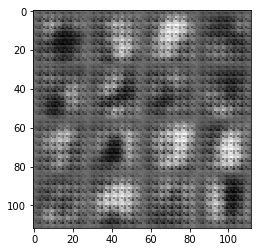

Epoch 1 / 2  D loss:  0.4256 ... G loss:  2.9941 ...
Epoch 1 / 2  D loss:  0.4225 ... G loss:  3.1063 ...
Epoch 1 / 2  D loss:  0.6282 ... G loss:  2.6309 ...
Epoch 1 / 2  D loss:  1.8604 ... G loss:  9.1140 ...
Epoch 1 / 2  D loss:  0.6115 ... G loss:  2.0561 ...
Epoch 1 / 2  D loss:  0.4785 ... G loss:  2.8311 ...
Epoch 1 / 2  D loss:  0.7627 ... G loss:  3.8213 ...
Epoch 1 / 2  D loss:  1.0613 ... G loss:  1.7444 ...
Epoch 1 / 2  D loss:  1.2810 ... G loss:  4.5890 ...
Epoch 1 / 2  D loss:  0.7969 ... G loss:  1.8819 ...
Step:  300


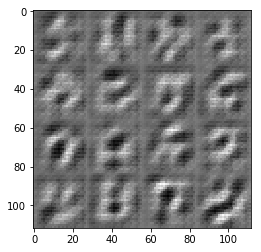

Epoch 1 / 2  D loss:  1.7076 ... G loss:  0.3226 ...
Epoch 1 / 2  D loss:  1.1140 ... G loss:  1.2220 ...
Epoch 1 / 2  D loss:  1.0158 ... G loss:  1.5095 ...
Epoch 1 / 2  D loss:  0.9917 ... G loss:  1.5428 ...
Epoch 1 / 2  D loss:  0.4135 ... G loss:  3.1046 ...
Epoch 1 / 2  D loss:  1.4512 ... G loss:  1.6653 ...
Epoch 1 / 2  D loss:  3.3817 ... G loss:  0.1549 ...
Epoch 1 / 2  D loss:  1.1356 ... G loss:  2.1001 ...
Epoch 1 / 2  D loss:  0.9793 ... G loss:  1.6930 ...
Epoch 1 / 2  D loss:  0.8747 ... G loss:  1.4529 ...
Step:  400


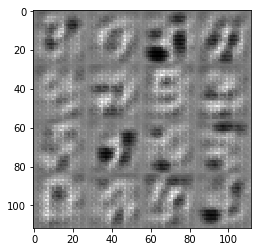

Epoch 1 / 2  D loss:  1.3300 ... G loss:  1.4697 ...
Epoch 1 / 2  D loss:  1.7068 ... G loss:  0.8054 ...
Epoch 1 / 2  D loss:  0.8334 ... G loss:  1.5903 ...
Epoch 1 / 2  D loss:  0.8250 ... G loss:  1.7296 ...
Epoch 1 / 2  D loss:  2.3247 ... G loss:  0.1632 ...
Epoch 1 / 2  D loss:  0.8153 ... G loss:  1.2502 ...
Epoch 1 / 2  D loss:  1.2165 ... G loss:  1.2293 ...
Epoch 1 / 2  D loss:  0.8017 ... G loss:  1.6375 ...
Epoch 1 / 2  D loss:  1.0065 ... G loss:  1.4601 ...
Epoch 1 / 2  D loss:  1.1811 ... G loss:  0.8276 ...
Step:  500


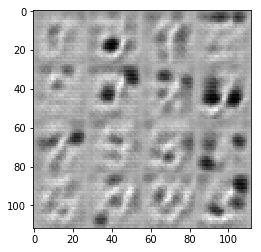

Epoch 1 / 2  D loss:  1.1621 ... G loss:  0.8828 ...
Epoch 1 / 2  D loss:  1.2241 ... G loss:  1.9667 ...
Epoch 1 / 2  D loss:  0.4933 ... G loss:  3.0646 ...
Epoch 1 / 2  D loss:  0.8211 ... G loss:  1.4233 ...
Epoch 1 / 2  D loss:  0.7446 ... G loss:  2.1646 ...
Epoch 1 / 2  D loss:  0.9902 ... G loss:  1.2177 ...
Epoch 1 / 2  D loss:  1.1292 ... G loss:  1.4866 ...
Epoch 1 / 2  D loss:  1.3313 ... G loss:  0.9561 ...
Epoch 1 / 2  D loss:  0.7261 ... G loss:  1.3838 ...
Epoch 1 / 2  D loss:  0.6581 ... G loss:  2.1612 ...
Step:  600


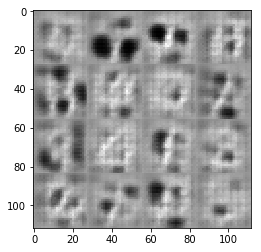

Epoch 1 / 2  D loss:  0.5653 ... G loss:  3.7311 ...
Epoch 1 / 2  D loss:  0.6336 ... G loss:  1.5971 ...
Epoch 1 / 2  D loss:  1.2230 ... G loss:  1.2050 ...
Epoch 1 / 2  D loss:  0.9802 ... G loss:  1.0836 ...
Epoch 1 / 2  D loss:  1.1186 ... G loss:  1.2849 ...
Epoch 1 / 2  D loss:  0.9528 ... G loss:  1.9412 ...
Epoch 1 / 2  D loss:  0.9539 ... G loss:  1.5268 ...
Epoch 1 / 2  D loss:  1.4795 ... G loss:  0.4581 ...
Epoch 1 / 2  D loss:  0.8027 ... G loss:  1.3266 ...
Epoch 1 / 2  D loss:  1.8881 ... G loss:  0.2464 ...
Step:  700


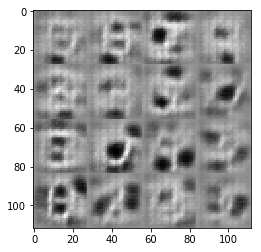

Epoch 1 / 2  D loss:  0.7481 ... G loss:  1.8383 ...
Epoch 1 / 2  D loss:  1.4610 ... G loss:  0.4966 ...
Epoch 1 / 2  D loss:  1.0444 ... G loss:  0.8868 ...
Epoch 1 / 2  D loss:  0.8057 ... G loss:  1.3278 ...
Epoch 1 / 2  D loss:  0.9006 ... G loss:  1.3763 ...
Epoch 1 / 2  D loss:  0.8100 ... G loss:  1.3766 ...
Epoch 1 / 2  D loss:  0.8028 ... G loss:  1.7174 ...
Epoch 1 / 2  D loss:  0.8698 ... G loss:  1.1215 ...
Epoch 1 / 2  D loss:  1.4048 ... G loss:  1.2535 ...
Epoch 1 / 2  D loss:  1.1748 ... G loss:  0.8871 ...
Step:  800


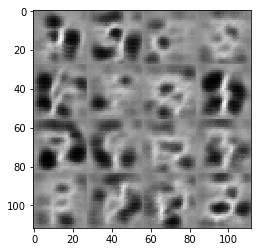

Epoch 1 / 2  D loss:  1.4162 ... G loss:  1.8928 ...
Epoch 1 / 2  D loss:  0.7815 ... G loss:  1.2964 ...
Epoch 1 / 2  D loss:  1.1502 ... G loss:  0.8606 ...
Epoch 1 / 2  D loss:  0.8699 ... G loss:  1.0169 ...
Epoch 1 / 2  D loss:  0.8426 ... G loss:  2.3251 ...
Epoch 1 / 2  D loss:  0.6302 ... G loss:  2.5557 ...
Epoch 1 / 2  D loss:  1.1550 ... G loss:  1.5908 ...
Epoch 1 / 2  D loss:  0.7180 ... G loss:  2.3509 ...
Epoch 1 / 2  D loss:  1.1393 ... G loss:  0.8415 ...
Epoch 1 / 2  D loss:  1.0555 ... G loss:  0.9699 ...
Step:  900


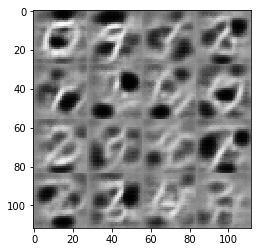

Epoch 1 / 2  D loss:  0.9974 ... G loss:  1.1436 ...
Epoch 1 / 2  D loss:  1.1270 ... G loss:  1.9602 ...
Epoch 1 / 2  D loss:  1.0067 ... G loss:  1.3177 ...
Epoch 1 / 2  D loss:  1.1226 ... G loss:  0.8955 ...
Epoch 1 / 2  D loss:  0.8986 ... G loss:  1.3615 ...
Epoch 1 / 2  D loss:  1.2277 ... G loss:  0.5581 ...
Epoch 1 / 2  D loss:  0.9341 ... G loss:  1.5714 ...
Epoch 1 / 2  D loss:  1.1058 ... G loss:  1.0833 ...
Epoch 1 / 2  D loss:  1.1637 ... G loss:  1.8838 ...
Epoch 1 / 2  D loss:  0.6291 ... G loss:  2.9031 ...
Step:  1000


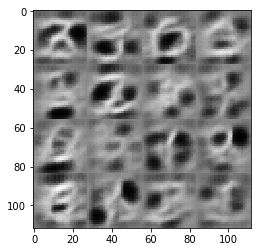

Epoch 1 / 2  D loss:  0.9837 ... G loss:  0.8720 ...
Epoch 1 / 2  D loss:  0.8863 ... G loss:  1.2430 ...
Epoch 1 / 2  D loss:  1.0730 ... G loss:  1.0353 ...
Epoch 1 / 2  D loss:  0.7503 ... G loss:  1.3333 ...
Epoch 1 / 2  D loss:  0.9918 ... G loss:  1.2470 ...
Epoch 1 / 2  D loss:  1.3826 ... G loss:  0.4775 ...
Epoch 1 / 2  D loss:  1.0047 ... G loss:  1.0485 ...
Epoch 1 / 2  D loss:  0.7982 ... G loss:  1.3648 ...
Epoch 1 / 2  D loss:  0.8221 ... G loss:  1.0645 ...
Epoch 1 / 2  D loss:  0.9838 ... G loss:  1.2213 ...
Step:  1100


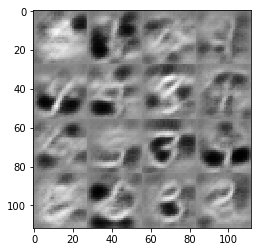

Epoch 1 / 2  D loss:  1.0137 ... G loss:  1.1904 ...
Epoch 1 / 2  D loss:  0.9481 ... G loss:  1.3558 ...
Epoch 1 / 2  D loss:  0.9374 ... G loss:  1.3072 ...
Epoch 1 / 2  D loss:  0.8680 ... G loss:  1.4456 ...
Epoch 1 / 2  D loss:  1.2504 ... G loss:  0.8015 ...
Epoch 1 / 2  D loss:  0.7386 ... G loss:  3.1289 ...
Epoch 1 / 2  D loss:  0.9540 ... G loss:  1.3635 ...
Epoch 1 / 2  D loss:  1.0682 ... G loss:  0.9350 ...
Epoch 1 / 2  D loss:  0.4158 ... G loss:  2.7628 ...
Epoch 1 / 2  D loss:  0.8959 ... G loss:  1.5633 ...
Step:  1200


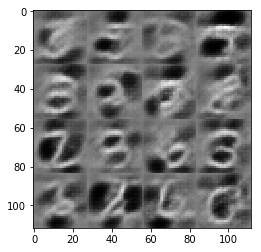

Epoch 1 / 2  D loss:  0.8465 ... G loss:  1.5348 ...
Epoch 1 / 2  D loss:  0.9143 ... G loss:  1.7653 ...
Epoch 1 / 2  D loss:  0.8576 ... G loss:  1.4415 ...
Epoch 1 / 2  D loss:  1.0712 ... G loss:  0.9914 ...
Epoch 1 / 2  D loss:  1.0260 ... G loss:  0.8712 ...
Epoch 1 / 2  D loss:  0.7574 ... G loss:  1.6461 ...
Epoch 1 / 2  D loss:  1.4402 ... G loss:  5.8891 ...
Epoch 1 / 2  D loss:  0.8402 ... G loss:  1.2961 ...
Epoch 1 / 2  D loss:  0.9403 ... G loss:  1.8365 ...
Epoch 1 / 2  D loss:  1.9966 ... G loss:  0.2344 ...
Step:  1300


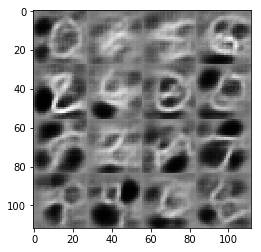

Epoch 1 / 2  D loss:  1.1024 ... G loss:  0.9121 ...
Epoch 1 / 2  D loss:  0.7891 ... G loss:  1.4949 ...
Epoch 1 / 2  D loss:  0.8836 ... G loss:  1.1670 ...
Epoch 1 / 2  D loss:  0.9378 ... G loss:  1.5368 ...
Epoch 1 / 2  D loss:  1.0776 ... G loss:  1.0196 ...
Epoch 1 / 2  D loss:  1.0287 ... G loss:  1.0145 ...
Epoch 1 / 2  D loss:  1.2540 ... G loss:  0.8060 ...
Epoch 1 / 2  D loss:  0.8663 ... G loss:  1.5689 ...
Epoch 1 / 2  D loss:  0.9060 ... G loss:  1.1589 ...
Epoch 1 / 2  D loss:  0.9108 ... G loss:  1.3847 ...
Step:  1400


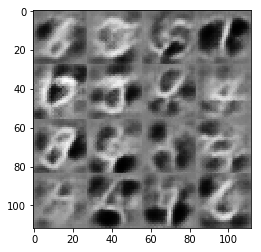

Epoch 1 / 2  D loss:  1.0403 ... G loss:  0.9242 ...
Epoch 1 / 2  D loss:  0.7834 ... G loss:  1.9144 ...
Epoch 1 / 2  D loss:  1.0225 ... G loss:  0.9781 ...
Epoch 1 / 2  D loss:  0.7398 ... G loss:  1.6608 ...
Epoch 1 / 2  D loss:  1.0676 ... G loss:  0.9517 ...
Epoch 1 / 2  D loss:  1.1775 ... G loss:  2.4877 ...
Epoch 1 / 2  D loss:  0.9161 ... G loss:  1.1849 ...
Epoch 1 / 2  D loss:  3.3620 ... G loss:  0.0519 ...
Epoch 1 / 2  D loss:  0.8793 ... G loss:  1.9303 ...
Epoch 1 / 2  D loss:  0.8113 ... G loss:  1.4004 ...
Step:  1500


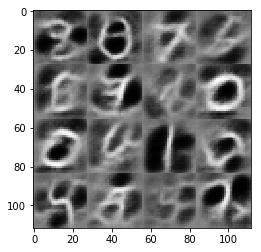

Epoch 1 / 2  D loss:  1.0069 ... G loss:  0.9753 ...
Epoch 1 / 2  D loss:  1.1539 ... G loss:  0.7296 ...
Epoch 1 / 2  D loss:  0.7335 ... G loss:  1.7373 ...
Epoch 1 / 2  D loss:  0.8222 ... G loss:  1.4766 ...
Epoch 1 / 2  D loss:  0.7864 ... G loss:  1.5596 ...
Epoch 1 / 2  D loss:  0.8366 ... G loss:  1.3262 ...
Epoch 1 / 2  D loss:  1.1363 ... G loss:  1.5335 ...
Epoch 1 / 2  D loss:  1.1250 ... G loss:  1.1122 ...
Epoch 1 / 2  D loss:  0.8984 ... G loss:  1.2350 ...
Epoch 1 / 2  D loss:  0.9005 ... G loss:  1.3582 ...
Step:  1600


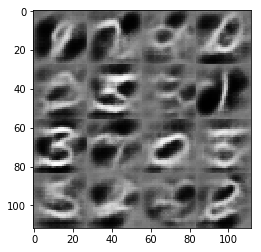

Epoch 1 / 2  D loss:  1.2450 ... G loss:  0.8627 ...
Epoch 1 / 2  D loss:  0.8958 ... G loss:  1.1318 ...
Epoch 1 / 2  D loss:  0.9948 ... G loss:  1.0185 ...
Epoch 1 / 2  D loss:  0.8329 ... G loss:  1.2844 ...
Epoch 1 / 2  D loss:  0.7285 ... G loss:  1.4191 ...
Epoch 1 / 2  D loss:  0.6007 ... G loss:  1.7885 ...
Epoch 1 / 2  D loss:  0.7620 ... G loss:  1.5265 ...
Epoch 1 / 2  D loss:  1.0246 ... G loss:  0.8315 ...
Epoch 1 / 2  D loss:  0.7894 ... G loss:  1.6698 ...
Epoch 1 / 2  D loss:  1.1367 ... G loss:  1.0581 ...
Step:  1700


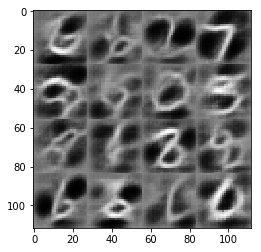

Epoch 1 / 2  D loss:  0.8315 ... G loss:  1.5958 ...
Epoch 1 / 2  D loss:  0.8443 ... G loss:  1.5234 ...
Epoch 1 / 2  D loss:  0.7625 ... G loss:  1.6605 ...
Epoch 1 / 2  D loss:  1.3894 ... G loss:  0.5809 ...
Epoch 1 / 2  D loss:  1.1094 ... G loss:  1.6860 ...
Epoch 1 / 2  D loss:  0.8566 ... G loss:  1.6965 ...
Epoch 1 / 2  D loss:  0.9218 ... G loss:  0.9823 ...
Epoch 1 / 2  D loss:  0.9392 ... G loss:  1.4478 ...
Epoch 1 / 2  D loss:  0.7612 ... G loss:  1.3799 ...
Epoch 1 / 2  D loss:  0.6408 ... G loss:  3.0360 ...
Step:  1800


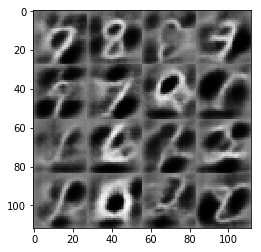

Epoch 1 / 2  D loss:  0.7491 ... G loss:  1.3727 ...
Epoch 1 / 2  D loss:  0.8749 ... G loss:  1.5034 ...
Epoch 1 / 2  D loss:  0.9333 ... G loss:  1.3091 ...
Epoch 1 / 2  D loss:  1.3754 ... G loss:  0.4580 ...
Epoch 1 / 2  D loss:  0.8120 ... G loss:  1.1441 ...
Epoch 1 / 2  D loss:  1.0764 ... G loss:  0.8602 ...
Epoch 1 / 2  D loss:  0.6187 ... G loss:  1.7313 ...
Epoch 1 / 2  D loss:  0.8384 ... G loss:  1.1762 ...
Epoch 2 / 2  D loss:  0.8579 ... G loss:  1.3044 ...
Epoch 2 / 2  D loss:  0.6756 ... G loss:  1.4917 ...
Step:  1900


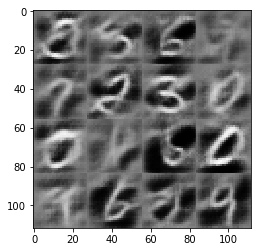

Epoch 2 / 2  D loss:  0.7453 ... G loss:  1.5955 ...
Epoch 2 / 2  D loss:  0.9197 ... G loss:  1.1173 ...
Epoch 2 / 2  D loss:  1.1511 ... G loss:  0.7260 ...
Epoch 2 / 2  D loss:  1.0131 ... G loss:  0.9464 ...
Epoch 2 / 2  D loss:  1.0531 ... G loss:  1.8355 ...
Epoch 2 / 2  D loss:  0.8063 ... G loss:  1.2080 ...
Epoch 2 / 2  D loss:  1.0612 ... G loss:  0.9798 ...
Epoch 2 / 2  D loss:  0.9517 ... G loss:  0.9667 ...
Epoch 2 / 2  D loss:  1.0662 ... G loss:  1.0134 ...
Epoch 2 / 2  D loss:  0.9467 ... G loss:  8.1606 ...
Step:  2000


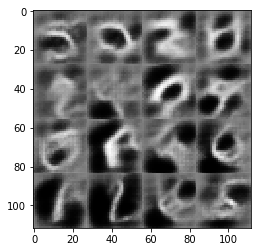

Epoch 2 / 2  D loss:  0.8254 ... G loss:  1.3973 ...
Epoch 2 / 2  D loss:  0.5393 ... G loss:  2.0263 ...
Epoch 2 / 2  D loss:  0.8853 ... G loss:  1.4023 ...
Epoch 2 / 2  D loss:  1.1586 ... G loss:  0.7603 ...
Epoch 2 / 2  D loss:  0.7192 ... G loss:  1.7262 ...
Epoch 2 / 2  D loss:  0.8388 ... G loss:  1.4381 ...
Epoch 2 / 2  D loss:  0.7089 ... G loss:  2.1517 ...
Epoch 2 / 2  D loss:  0.8294 ... G loss:  1.2598 ...
Epoch 2 / 2  D loss:  0.7301 ... G loss:  1.2427 ...
Epoch 2 / 2  D loss:  0.9833 ... G loss:  0.9177 ...
Step:  2100


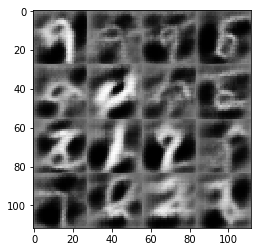

Epoch 2 / 2  D loss:  0.8301 ... G loss:  1.5101 ...
Epoch 2 / 2  D loss:  1.0431 ... G loss:  0.8943 ...
Epoch 2 / 2  D loss:  0.7562 ... G loss:  1.1793 ...
Epoch 2 / 2  D loss:  1.0693 ... G loss:  1.4903 ...
Epoch 2 / 2  D loss:  1.2029 ... G loss:  0.8214 ...
Epoch 2 / 2  D loss:  1.1032 ... G loss:  1.0190 ...
Epoch 2 / 2  D loss:  0.9499 ... G loss:  1.0464 ...
Epoch 2 / 2  D loss:  1.1386 ... G loss:  0.7904 ...
Epoch 2 / 2  D loss:  0.5338 ... G loss:  1.8991 ...
Epoch 2 / 2  D loss:  0.6763 ... G loss:  1.5301 ...
Step:  2200


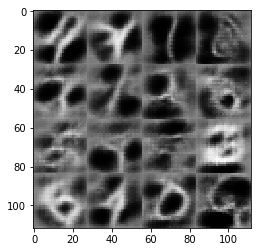

Epoch 2 / 2  D loss:  0.9804 ... G loss:  1.1603 ...
Epoch 2 / 2  D loss:  1.4601 ... G loss:  2.4703 ...
Epoch 2 / 2  D loss:  0.9874 ... G loss:  1.1723 ...
Epoch 2 / 2  D loss:  0.9877 ... G loss:  1.2736 ...
Epoch 2 / 2  D loss:  0.6491 ... G loss:  1.7452 ...
Epoch 2 / 2  D loss:  0.8954 ... G loss:  1.3113 ...
Epoch 2 / 2  D loss:  0.5701 ... G loss:  1.8127 ...
Epoch 2 / 2  D loss:  0.8948 ... G loss:  1.2187 ...
Epoch 2 / 2  D loss:  0.8732 ... G loss:  1.0563 ...
Epoch 2 / 2  D loss:  0.8250 ... G loss:  1.3928 ...
Step:  2300


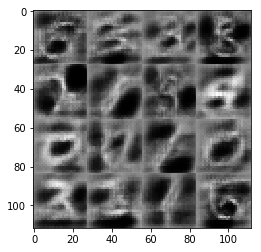

Epoch 2 / 2  D loss:  0.7199 ... G loss:  1.3604 ...
Epoch 2 / 2  D loss:  1.0412 ... G loss:  1.2434 ...
Epoch 2 / 2  D loss:  0.8709 ... G loss:  2.0689 ...
Epoch 2 / 2  D loss:  1.1686 ... G loss:  0.7811 ...
Epoch 2 / 2  D loss:  0.6343 ... G loss:  2.4650 ...
Epoch 2 / 2  D loss:  0.6596 ... G loss:  1.9056 ...
Epoch 2 / 2  D loss:  0.7229 ... G loss:  1.5153 ...
Epoch 2 / 2  D loss:  0.8564 ... G loss:  1.1722 ...
Epoch 2 / 2  D loss:  2.1458 ... G loss:  0.1851 ...
Epoch 2 / 2  D loss:  0.6954 ... G loss:  2.1693 ...
Step:  2400


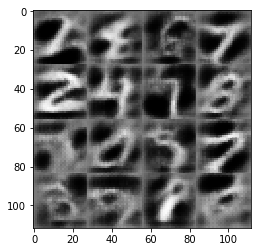

Epoch 2 / 2  D loss:  0.7073 ... G loss:  1.4303 ...
Epoch 2 / 2  D loss:  1.0644 ... G loss:  0.9426 ...
Epoch 2 / 2  D loss:  1.0309 ... G loss:  0.8551 ...
Epoch 2 / 2  D loss:  0.7529 ... G loss:  1.5903 ...
Epoch 2 / 2  D loss:  1.4565 ... G loss:  3.3625 ...
Epoch 2 / 2  D loss:  0.9062 ... G loss:  1.4025 ...
Epoch 2 / 2  D loss:  0.7181 ... G loss:  1.5246 ...
Epoch 2 / 2  D loss:  1.6323 ... G loss:  0.4298 ...
Epoch 2 / 2  D loss:  1.2645 ... G loss:  0.6017 ...
Epoch 2 / 2  D loss:  0.8413 ... G loss:  1.1686 ...
Step:  2500


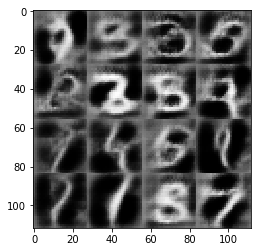

Epoch 2 / 2  D loss:  1.0170 ... G loss:  0.9884 ...
Epoch 2 / 2  D loss:  1.1528 ... G loss:  0.9241 ...
Epoch 2 / 2  D loss:  0.8177 ... G loss:  1.6186 ...
Epoch 2 / 2  D loss:  1.0896 ... G loss:  0.8445 ...
Epoch 2 / 2  D loss:  0.9552 ... G loss:  1.2262 ...
Epoch 2 / 2  D loss:  1.1892 ... G loss:  2.1517 ...
Epoch 2 / 2  D loss:  0.9561 ... G loss:  1.3935 ...
Epoch 2 / 2  D loss:  0.6603 ... G loss:  1.5350 ...
Epoch 2 / 2  D loss:  0.8797 ... G loss:  1.6282 ...
Epoch 2 / 2  D loss:  1.0019 ... G loss:  0.8776 ...
Step:  2600


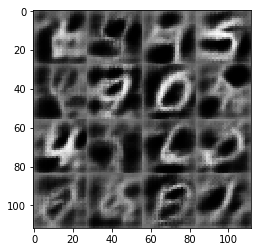

Epoch 2 / 2  D loss:  0.8105 ... G loss:  1.4871 ...
Epoch 2 / 2  D loss:  0.8494 ... G loss:  1.1726 ...
Epoch 2 / 2  D loss:  0.3865 ... G loss:  4.0968 ...
Epoch 2 / 2  D loss:  0.7020 ... G loss:  1.4338 ...
Epoch 2 / 2  D loss:  0.9254 ... G loss:  1.1009 ...
Epoch 2 / 2  D loss:  0.8379 ... G loss:  1.2473 ...
Epoch 2 / 2  D loss:  1.1323 ... G loss:  0.8087 ...
Epoch 2 / 2  D loss:  0.5976 ... G loss:  1.7351 ...
Epoch 2 / 2  D loss:  0.8265 ... G loss:  2.5335 ...
Epoch 2 / 2  D loss:  0.7501 ... G loss:  1.3340 ...
Step:  2700


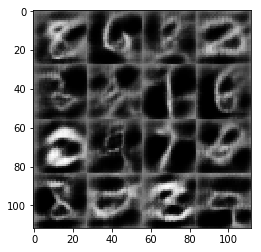

Epoch 2 / 2  D loss:  1.1679 ... G loss:  0.7730 ...
Epoch 2 / 2  D loss:  0.3847 ... G loss:  3.9772 ...
Epoch 2 / 2  D loss:  0.5831 ... G loss:  2.6086 ...
Epoch 2 / 2  D loss:  1.5530 ... G loss:  0.5021 ...
Epoch 2 / 2  D loss:  0.8010 ... G loss:  1.3834 ...
Epoch 2 / 2  D loss:  1.0337 ... G loss:  0.9592 ...
Epoch 2 / 2  D loss:  0.8650 ... G loss:  1.8921 ...
Epoch 2 / 2  D loss:  0.5722 ... G loss:  4.0810 ...
Epoch 2 / 2  D loss:  0.7219 ... G loss:  1.4948 ...
Epoch 2 / 2  D loss:  0.6855 ... G loss:  1.4330 ...
Step:  2800


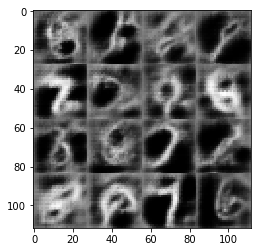

Epoch 2 / 2  D loss:  0.8911 ... G loss:  1.0439 ...
Epoch 2 / 2  D loss:  1.1913 ... G loss:  2.7803 ...
Epoch 2 / 2  D loss:  0.4554 ... G loss:  2.4823 ...
Epoch 2 / 2  D loss:  0.7773 ... G loss:  1.5728 ...
Epoch 2 / 2  D loss:  0.5994 ... G loss:  2.3852 ...
Epoch 2 / 2  D loss:  0.9674 ... G loss:  2.0587 ...
Epoch 2 / 2  D loss:  0.7955 ... G loss:  1.2984 ...
Epoch 2 / 2  D loss:  1.1540 ... G loss:  0.7232 ...
Epoch 2 / 2  D loss:  0.6653 ... G loss:  1.9040 ...
Epoch 2 / 2  D loss:  0.7520 ... G loss:  1.3199 ...
Step:  2900


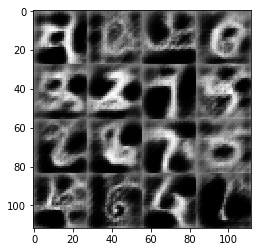

Epoch 2 / 2  D loss:  0.9088 ... G loss:  1.2427 ...
Epoch 2 / 2  D loss:  0.6437 ... G loss:  1.8186 ...
Epoch 2 / 2  D loss:  0.9162 ... G loss:  1.0378 ...
Epoch 2 / 2  D loss:  0.6986 ... G loss:  1.4486 ...
Epoch 2 / 2  D loss:  0.7338 ... G loss:  1.3939 ...
Epoch 2 / 2  D loss:  0.3949 ... G loss:  3.5548 ...
Epoch 2 / 2  D loss:  0.3620 ... G loss:  4.3406 ...
Epoch 2 / 2  D loss:  0.7783 ... G loss:  2.2867 ...
Epoch 2 / 2  D loss:  0.8690 ... G loss:  1.5995 ...
Epoch 2 / 2  D loss:  0.9452 ... G loss:  0.9684 ...
Step:  3000


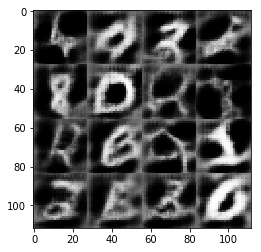

Epoch 2 / 2  D loss:  0.8435 ... G loss:  1.2989 ...
Epoch 2 / 2  D loss:  0.5239 ... G loss:  2.1486 ...
Epoch 2 / 2  D loss:  0.8467 ... G loss:  2.6367 ...
Epoch 2 / 2  D loss:  0.5529 ... G loss:  1.9751 ...
Epoch 2 / 2  D loss:  0.9702 ... G loss:  1.0262 ...
Epoch 2 / 2  D loss:  0.5653 ... G loss:  1.9592 ...
Epoch 2 / 2  D loss:  0.4714 ... G loss:  2.5243 ...
Epoch 2 / 2  D loss:  0.8027 ... G loss:  1.3120 ...
Epoch 2 / 2  D loss:  0.7364 ... G loss:  1.2830 ...
Epoch 2 / 2  D loss:  0.5303 ... G loss:  2.1295 ...
Step:  3100


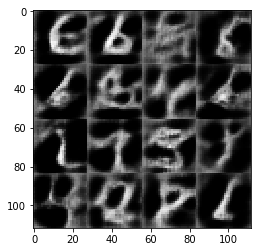

Epoch 2 / 2  D loss:  0.6344 ... G loss:  1.7966 ...
Epoch 2 / 2  D loss:  0.8461 ... G loss:  2.0373 ...
Epoch 2 / 2  D loss:  0.8281 ... G loss:  1.2868 ...
Epoch 2 / 2  D loss:  0.5080 ... G loss:  2.7767 ...
Epoch 2 / 2  D loss:  0.4527 ... G loss:  2.7555 ...
Epoch 2 / 2  D loss:  1.0282 ... G loss:  1.0330 ...
Epoch 2 / 2  D loss:  0.8597 ... G loss:  1.1640 ...
Epoch 2 / 2  D loss:  0.4236 ... G loss:  3.4074 ...
Epoch 2 / 2  D loss:  1.2484 ... G loss:  0.7545 ...
Epoch 2 / 2  D loss:  0.6207 ... G loss:  9.2922 ...
Step:  3200


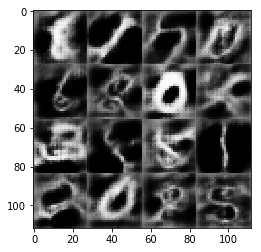

Epoch 2 / 2  D loss:  1.0663 ... G loss:  1.0531 ...
Epoch 2 / 2  D loss:  0.5249 ... G loss:  2.0187 ...
Epoch 2 / 2  D loss:  0.9279 ... G loss:  0.9899 ...
Epoch 2 / 2  D loss:  1.2615 ... G loss:  0.7868 ...
Epoch 2 / 2  D loss:  0.9092 ... G loss:  1.4046 ...
Epoch 2 / 2  D loss:  0.9019 ... G loss:  1.3505 ...
Epoch 2 / 2  D loss:  0.7994 ... G loss:  1.5501 ...
Epoch 2 / 2  D loss:  0.7248 ... G loss:  1.5408 ...
Epoch 2 / 2  D loss:  1.2470 ... G loss:  0.7727 ...
Epoch 2 / 2  D loss:  1.2449 ... G loss:  0.7662 ...
Step:  3300


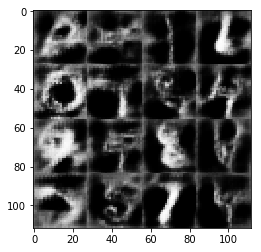

Epoch 2 / 2  D loss:  0.8029 ... G loss:  1.4973 ...
Epoch 2 / 2  D loss:  0.8308 ... G loss:  1.1372 ...
Epoch 2 / 2  D loss:  0.6402 ... G loss:  1.6096 ...
Epoch 2 / 2  D loss:  0.6405 ... G loss:  1.5950 ...
Epoch 2 / 2  D loss:  0.9466 ... G loss:  2.8593 ...
Epoch 2 / 2  D loss:  1.1213 ... G loss:  0.8841 ...
Epoch 2 / 2  D loss:  0.5694 ... G loss:  1.9323 ...
Epoch 2 / 2  D loss:  0.9667 ... G loss:  0.9930 ...
Epoch 2 / 2  D loss:  0.9838 ... G loss:  0.9608 ...
Epoch 2 / 2  D loss:  0.6917 ... G loss:  2.2940 ...
Step:  3400


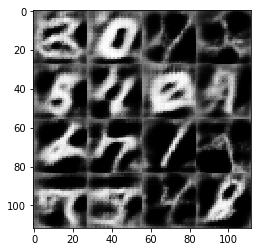

Epoch 2 / 2  D loss:  1.0532 ... G loss:  0.8915 ...
Epoch 2 / 2  D loss:  0.8323 ... G loss:  1.1527 ...
Epoch 2 / 2  D loss:  0.7512 ... G loss:  1.3742 ...
Epoch 2 / 2  D loss:  0.8228 ... G loss:  1.3103 ...
Epoch 2 / 2  D loss:  0.5009 ... G loss:  2.1912 ...
Epoch 2 / 2  D loss:  0.7994 ... G loss:  1.1779 ...
Epoch 2 / 2  D loss:  0.7585 ... G loss:  1.9094 ...
Epoch 2 / 2  D loss:  0.5491 ... G loss:  1.9661 ...
Epoch 2 / 2  D loss:  0.7599 ... G loss:  2.5230 ...
Epoch 2 / 2  D loss:  0.8714 ... G loss:  1.8967 ...
Step:  3500


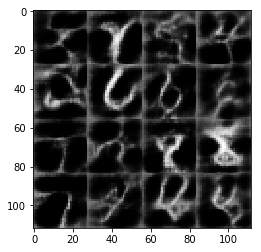

Epoch 2 / 2  D loss:  1.3690 ... G loss:  0.5278 ...
Epoch 2 / 2  D loss:  0.8301 ... G loss:  1.6426 ...
Epoch 2 / 2  D loss:  0.7194 ... G loss:  1.5691 ...
Epoch 2 / 2  D loss:  0.9803 ... G loss:  1.0069 ...
Epoch 2 / 2  D loss:  0.4366 ... G loss:  3.0948 ...
Epoch 2 / 2  D loss:  0.7795 ... G loss:  1.3395 ...
Epoch 2 / 2  D loss:  0.6426 ... G loss:  1.8578 ...
Epoch 2 / 2  D loss:  0.9181 ... G loss:  1.3818 ...
Epoch 2 / 2  D loss:  0.6326 ... G loss:  1.9101 ...
Epoch 2 / 2  D loss:  2.4540 ... G loss:  0.3787 ...
Step:  3600


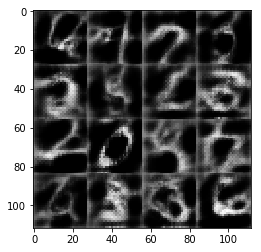

Epoch 2 / 2  D loss:  1.2995 ... G loss:  0.7830 ...
Epoch 2 / 2  D loss:  0.8827 ... G loss:  1.2549 ...
Epoch 2 / 2  D loss:  0.7295 ... G loss:  1.5547 ...
Epoch 2 / 2  D loss:  0.8504 ... G loss:  2.0809 ...
Epoch 2 / 2  D loss:  0.7558 ... G loss:  1.3207 ...
Epoch 2 / 2  D loss:  1.1578 ... G loss:  0.8778 ...
Epoch 2 / 2  D loss:  0.9704 ... G loss:  1.0036 ...
Epoch 2 / 2  D loss:  0.7653 ... G loss:  1.3605 ...
Epoch 2 / 2  D loss:  0.9680 ... G loss:  0.9832 ...
Epoch 2 / 2  D loss:  0.6470 ... G loss:  1.7780 ...
Step:  3700


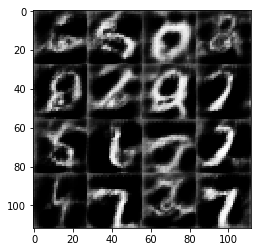

Epoch 2 / 2  D loss:  0.6818 ... G loss:  1.7713 ...
Epoch 2 / 2  D loss:  0.4885 ... G loss:  2.4921 ...
Epoch 2 / 2  D loss:  0.7812 ... G loss:  1.2841 ...
Epoch 2 / 2  D loss:  0.4358 ... G loss:  3.0926 ...
Epoch 2 / 2  D loss:  0.5873 ... G loss:  2.3449 ...
Epoch 2 / 2  D loss:  0.8218 ... G loss:  1.2715 ...


In [98]:
# learning rate = 3e-4
# batch size = 32
# alpha = .2
losses = train( net, epoch_count, batch_size, z_dim, 
                mnist_dataset.get_batches, mnist_dataset.image_mode)

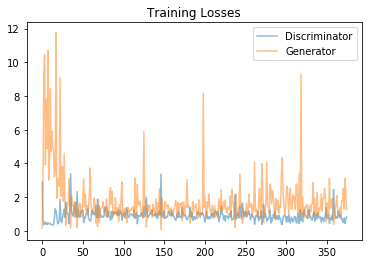

In [99]:
print_losses_chart(losses)

INFO:tensorflow:Restoring parameters from model_checkpoints/genereator.ckpt


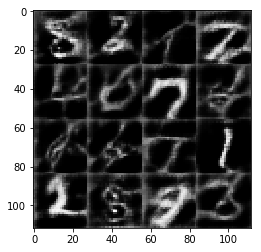

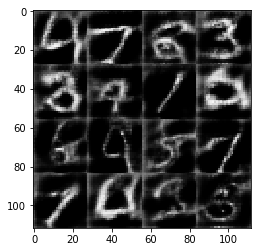

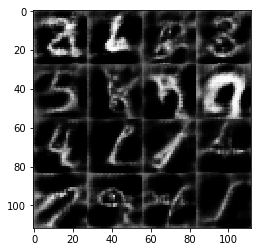

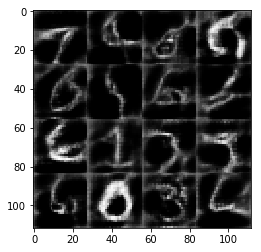

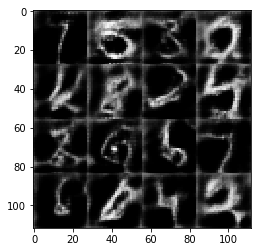

In [105]:

with tf.Session() as sess:
    
    saver = tf.train.Saver()
    saver.restore(sess, "model_checkpoints/genereator.ckpt")
    
    for x in range(5):
        show_generator_output(sess, 20, net.input_z, net.out_channel_dim, 
                                              mnist_dataset.image_mode)

---

Step:  1


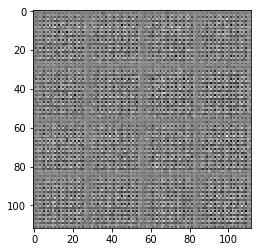

Epoch 1 / 2  D loss:  1.0568 ... G loss:  1.9434 ...
Epoch 1 / 2  D loss:  0.3754 ... G loss:  6.0288 ...
Epoch 1 / 2  D loss:  0.4901 ... G loss:  15.3334 ...
Epoch 1 / 2  D loss:  0.9946 ... G loss:  1.2972 ...
Epoch 1 / 2  D loss:  0.4236 ... G loss:  4.1589 ...
Epoch 1 / 2  D loss:  0.3724 ... G loss:  5.5312 ...
Epoch 1 / 2  D loss:  0.6567 ... G loss:  20.6469 ...
Epoch 1 / 2  D loss:  4.4130 ... G loss:  22.8937 ...
Epoch 1 / 2  D loss:  0.6170 ... G loss:  15.7629 ...
Step:  100


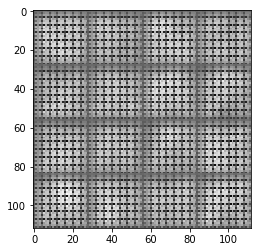

Epoch 1 / 2  D loss:  0.4998 ... G loss:  3.1678 ...
Epoch 1 / 2  D loss:  0.3912 ... G loss:  4.4993 ...
Epoch 1 / 2  D loss:  0.3919 ... G loss:  4.1315 ...
Epoch 1 / 2  D loss:  0.6776 ... G loss:  1.3453 ...
Epoch 1 / 2  D loss:  0.5095 ... G loss:  2.0057 ...
Epoch 1 / 2  D loss:  0.7762 ... G loss:  1.2274 ...
Epoch 1 / 2  D loss:  1.8179 ... G loss:  0.4243 ...
Epoch 1 / 2  D loss:  0.9002 ... G loss:  1.1316 ...
Epoch 1 / 2  D loss:  0.4814 ... G loss:  2.4615 ...
Epoch 1 / 2  D loss:  0.5045 ... G loss:  3.5295 ...
Step:  200


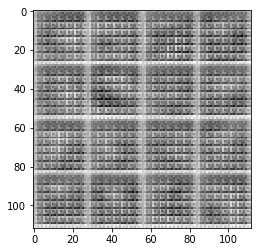

Epoch 1 / 2  D loss:  0.4563 ... G loss:  3.9501 ...
Epoch 1 / 2  D loss:  0.3804 ... G loss:  5.3893 ...
Epoch 1 / 2  D loss:  0.3813 ... G loss:  5.3988 ...
Epoch 1 / 2  D loss:  0.3600 ... G loss:  4.4158 ...
Epoch 1 / 2  D loss:  0.9763 ... G loss:  4.7747 ...
Epoch 1 / 2  D loss:  0.4123 ... G loss:  3.2186 ...
Epoch 1 / 2  D loss:  0.3522 ... G loss:  5.1414 ...
Epoch 1 / 2  D loss:  0.3509 ... G loss:  5.0147 ...
Epoch 1 / 2  D loss:  0.3545 ... G loss:  4.9269 ...
Epoch 1 / 2  D loss:  0.3500 ... G loss:  5.3030 ...
Step:  300


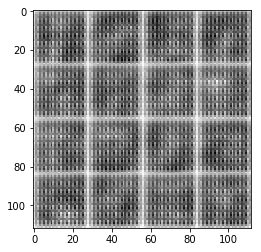

Epoch 1 / 2  D loss:  0.9600 ... G loss:  0.8027 ...
Epoch 1 / 2  D loss:  0.4363 ... G loss:  8.0672 ...
Epoch 1 / 2  D loss:  0.3896 ... G loss:  5.4999 ...
Epoch 1 / 2  D loss:  0.3602 ... G loss:  4.9517 ...
Epoch 1 / 2  D loss:  0.3746 ... G loss:  5.2322 ...
Epoch 1 / 2  D loss:  0.3743 ... G loss:  4.2550 ...
Epoch 1 / 2  D loss:  0.3428 ... G loss:  5.4585 ...
Epoch 1 / 2  D loss:  0.3486 ... G loss:  4.3823 ...
Epoch 1 / 2  D loss:  0.3558 ... G loss:  4.6238 ...
Epoch 1 / 2  D loss:  0.3428 ... G loss:  5.8307 ...
Step:  400


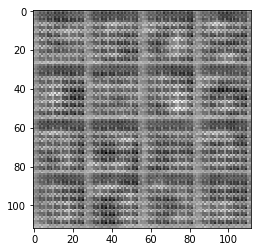

Epoch 1 / 2  D loss:  0.3371 ... G loss:  5.6117 ...
Epoch 1 / 2  D loss:  0.3411 ... G loss:  6.0844 ...
Epoch 1 / 2  D loss:  0.3495 ... G loss:  6.0650 ...
Epoch 1 / 2  D loss:  0.3392 ... G loss:  5.9809 ...
Epoch 1 / 2  D loss:  0.3375 ... G loss:  5.3640 ...
Epoch 1 / 2  D loss:  0.3955 ... G loss:  3.0719 ...
Epoch 1 / 2  D loss:  0.4567 ... G loss:  2.5030 ...
Epoch 1 / 2  D loss:  0.3705 ... G loss:  4.4761 ...
Epoch 1 / 2  D loss:  0.3782 ... G loss:  4.2396 ...
Epoch 1 / 2  D loss:  0.3580 ... G loss:  5.4428 ...
Step:  500


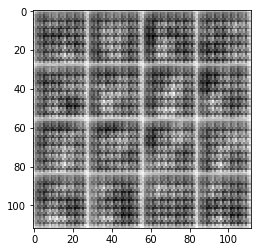

Epoch 1 / 2  D loss:  0.3479 ... G loss:  5.2341 ...
Epoch 1 / 2  D loss:  0.3632 ... G loss:  4.2845 ...
Epoch 1 / 2  D loss:  0.3814 ... G loss:  3.9650 ...
Epoch 1 / 2  D loss:  0.3400 ... G loss:  5.1555 ...
Epoch 1 / 2  D loss:  0.3545 ... G loss:  5.8599 ...
Epoch 1 / 2  D loss:  0.3856 ... G loss:  3.8885 ...
Epoch 1 / 2  D loss:  0.3575 ... G loss:  4.5269 ...
Epoch 1 / 2  D loss:  0.3700 ... G loss:  4.2715 ...
Epoch 1 / 2  D loss:  0.4348 ... G loss:  2.6133 ...
Epoch 1 / 2  D loss:  0.4505 ... G loss:  2.9780 ...
Step:  600


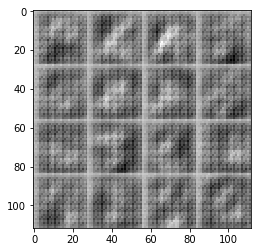

Epoch 1 / 2  D loss:  0.3498 ... G loss:  5.7832 ...
Epoch 1 / 2  D loss:  0.4134 ... G loss:  3.7502 ...
Epoch 1 / 2  D loss:  0.4226 ... G loss:  3.4041 ...
Epoch 1 / 2  D loss:  0.3855 ... G loss:  8.0252 ...
Epoch 1 / 2  D loss:  0.3929 ... G loss:  7.7060 ...
Epoch 1 / 2  D loss:  0.3568 ... G loss:  5.4049 ...
Epoch 1 / 2  D loss:  0.3872 ... G loss:  3.4182 ...
Epoch 1 / 2  D loss:  0.3933 ... G loss:  7.4220 ...
Epoch 1 / 2  D loss:  0.3476 ... G loss:  4.9018 ...
Epoch 1 / 2  D loss:  0.4365 ... G loss:  5.6660 ...
Step:  700


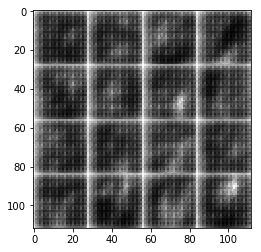

Epoch 1 / 2  D loss:  0.3681 ... G loss:  5.1852 ...
Epoch 1 / 2  D loss:  0.3901 ... G loss:  4.2828 ...
Epoch 1 / 2  D loss:  0.3741 ... G loss:  4.0917 ...
Epoch 1 / 2  D loss:  0.3515 ... G loss:  4.8487 ...
Epoch 1 / 2  D loss:  0.3491 ... G loss:  6.7204 ...
Epoch 1 / 2  D loss:  0.4007 ... G loss:  2.8466 ...
Epoch 1 / 2  D loss:  0.3591 ... G loss:  5.0633 ...
Epoch 1 / 2  D loss:  0.6065 ... G loss:  6.8609 ...
Epoch 1 / 2  D loss:  0.3916 ... G loss:  3.3521 ...
Epoch 1 / 2  D loss:  0.3922 ... G loss:  3.3810 ...
Step:  800


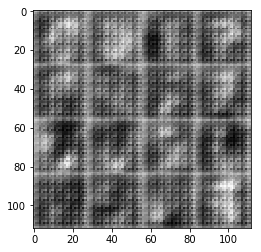

Epoch 1 / 2  D loss:  1.2965 ... G loss:  0.6262 ...
Epoch 1 / 2  D loss:  0.4988 ... G loss:  6.8291 ...
Epoch 1 / 2  D loss:  0.3628 ... G loss:  5.9220 ...
Epoch 1 / 2  D loss:  0.4089 ... G loss:  4.0394 ...
Epoch 1 / 2  D loss:  0.3387 ... G loss:  7.3812 ...
Epoch 1 / 2  D loss:  0.3373 ... G loss:  5.5632 ...
Epoch 1 / 2  D loss:  0.3344 ... G loss:  5.4260 ...
Epoch 1 / 2  D loss:  0.3448 ... G loss:  4.4646 ...
Epoch 1 / 2  D loss:  0.3758 ... G loss:  3.3757 ...
Epoch 1 / 2  D loss:  0.3864 ... G loss:  3.1836 ...
Step:  900


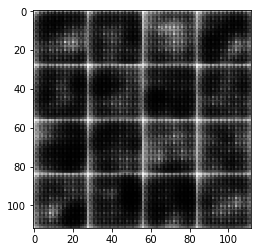

Epoch 1 / 2  D loss:  0.3585 ... G loss:  4.2824 ...
Epoch 1 / 2  D loss:  0.3414 ... G loss:  5.5566 ...
Epoch 1 / 2  D loss:  0.3394 ... G loss:  5.6550 ...
Epoch 1 / 2  D loss:  0.3897 ... G loss:  3.2587 ...
Epoch 1 / 2  D loss:  0.3932 ... G loss:  3.6936 ...
Epoch 1 / 2  D loss:  0.5158 ... G loss:  2.3583 ...
Epoch 1 / 2  D loss:  0.4002 ... G loss:  3.5293 ...
Epoch 1 / 2  D loss:  0.4189 ... G loss:  3.1643 ...
Epoch 1 / 2  D loss:  1.6219 ... G loss:  7.4065 ...
Epoch 1 / 2  D loss:  0.7303 ... G loss:  2.9419 ...
Step:  1000


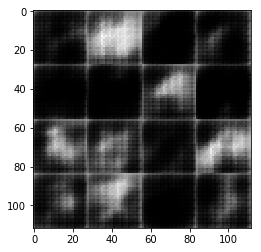

Epoch 1 / 2  D loss:  0.6187 ... G loss:  1.9156 ...
Epoch 1 / 2  D loss:  0.4352 ... G loss:  4.5033 ...
Epoch 1 / 2  D loss:  0.4042 ... G loss:  4.0497 ...
Epoch 1 / 2  D loss:  0.3636 ... G loss:  3.7868 ...
Epoch 1 / 2  D loss:  0.3760 ... G loss:  3.7263 ...
Epoch 1 / 2  D loss:  0.5098 ... G loss:  2.2661 ...
Epoch 1 / 2  D loss:  0.7285 ... G loss:  2.0479 ...
Epoch 1 / 2  D loss:  0.4132 ... G loss:  4.3593 ...
Epoch 1 / 2  D loss:  0.4505 ... G loss:  2.8191 ...
Epoch 1 / 2  D loss:  0.4766 ... G loss:  3.6995 ...
Step:  1100


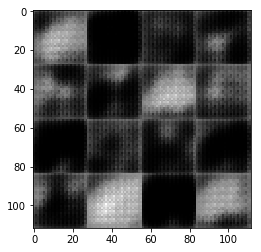

Epoch 1 / 2  D loss:  0.5358 ... G loss:  2.6675 ...
Epoch 1 / 2  D loss:  0.5442 ... G loss:  2.6512 ...
Epoch 1 / 2  D loss:  0.3856 ... G loss:  4.5212 ...
Epoch 1 / 2  D loss:  0.3731 ... G loss:  4.8731 ...
Epoch 1 / 2  D loss:  0.4195 ... G loss:  2.8394 ...
Epoch 1 / 2  D loss:  0.4454 ... G loss:  3.1531 ...
Epoch 1 / 2  D loss:  0.6138 ... G loss:  2.0413 ...
Epoch 1 / 2  D loss:  0.4039 ... G loss:  3.5281 ...
Epoch 1 / 2  D loss:  0.5150 ... G loss:  2.0893 ...
Epoch 1 / 2  D loss:  0.5365 ... G loss:  2.1696 ...
Step:  1200


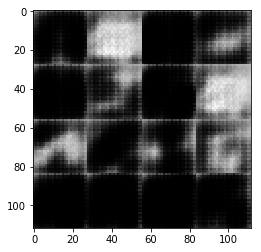

Epoch 1 / 2  D loss:  0.4590 ... G loss:  3.1203 ...
Epoch 1 / 2  D loss:  0.4145 ... G loss:  3.6195 ...
Epoch 1 / 2  D loss:  0.5705 ... G loss:  2.0331 ...
Epoch 1 / 2  D loss:  0.5644 ... G loss:  1.8663 ...
Epoch 1 / 2  D loss:  0.4240 ... G loss:  2.9095 ...
Epoch 1 / 2  D loss:  0.4654 ... G loss:  3.1484 ...
Epoch 1 / 2  D loss:  0.4339 ... G loss:  3.4779 ...
Epoch 1 / 2  D loss:  0.4041 ... G loss:  3.3222 ...
Epoch 1 / 2  D loss:  0.4579 ... G loss:  5.6024 ...
Epoch 1 / 2  D loss:  0.3839 ... G loss:  3.7502 ...
Step:  1300


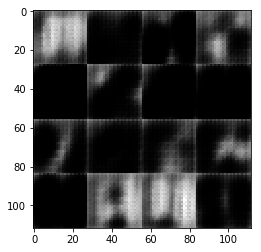

Epoch 1 / 2  D loss:  0.4197 ... G loss:  3.3156 ...
Epoch 1 / 2  D loss:  0.4267 ... G loss:  5.2336 ...
Epoch 1 / 2  D loss:  0.4780 ... G loss:  3.0125 ...
Epoch 1 / 2  D loss:  0.7357 ... G loss:  2.0413 ...
Epoch 1 / 2  D loss:  0.5385 ... G loss:  2.4631 ...
Epoch 1 / 2  D loss:  0.4908 ... G loss:  2.9248 ...
Epoch 1 / 2  D loss:  0.4267 ... G loss:  9.5888 ...
Epoch 1 / 2  D loss:  0.4494 ... G loss:  3.0075 ...
Epoch 1 / 2  D loss:  0.5714 ... G loss:  2.0226 ...
Epoch 1 / 2  D loss:  0.4287 ... G loss:  3.3987 ...
Step:  1400


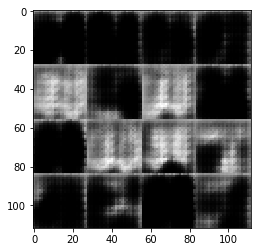

Epoch 1 / 2  D loss:  0.5608 ... G loss:  8.1283 ...
Epoch 1 / 2  D loss:  0.6065 ... G loss:  1.9654 ...
Epoch 1 / 2  D loss:  0.4774 ... G loss:  4.2409 ...
Epoch 1 / 2  D loss:  0.4534 ... G loss:  3.9511 ...
Epoch 1 / 2  D loss:  0.4091 ... G loss:  3.8012 ...
Epoch 1 / 2  D loss:  0.4237 ... G loss:  5.2168 ...
Epoch 1 / 2  D loss:  0.4129 ... G loss:  3.2279 ...
Epoch 1 / 2  D loss:  0.3970 ... G loss:  3.3049 ...
Epoch 1 / 2  D loss:  0.4446 ... G loss:  2.7689 ...
Epoch 1 / 2  D loss:  1.0412 ... G loss:  10.6669 ...
Step:  1500


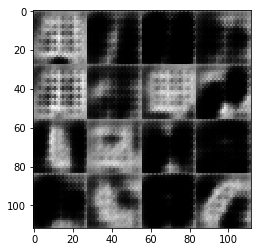

Epoch 1 / 2  D loss:  0.4984 ... G loss:  2.5723 ...
Epoch 1 / 2  D loss:  0.4437 ... G loss:  3.0814 ...
Epoch 1 / 2  D loss:  0.4867 ... G loss:  2.4056 ...
Epoch 1 / 2  D loss:  0.3946 ... G loss:  3.1980 ...
Epoch 1 / 2  D loss:  0.5259 ... G loss:  1.9342 ...
Epoch 1 / 2  D loss:  0.4613 ... G loss:  2.4247 ...
Epoch 1 / 2  D loss:  0.4065 ... G loss:  4.3105 ...
Epoch 1 / 2  D loss:  0.4533 ... G loss:  2.9726 ...
Epoch 1 / 2  D loss:  2.5823 ... G loss:  10.0857 ...
Epoch 1 / 2  D loss:  0.3935 ... G loss:  4.2460 ...
Step:  1600


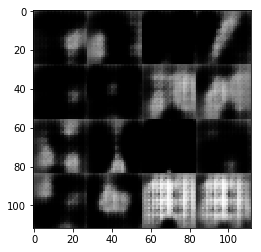

Epoch 1 / 2  D loss:  0.3977 ... G loss:  3.2585 ...
Epoch 1 / 2  D loss:  0.5363 ... G loss:  5.8801 ...
Epoch 1 / 2  D loss:  0.3847 ... G loss:  4.0812 ...
Epoch 1 / 2  D loss:  0.5290 ... G loss:  2.4737 ...
Epoch 1 / 2  D loss:  0.5355 ... G loss:  2.1483 ...
Epoch 1 / 2  D loss:  0.5118 ... G loss:  3.3168 ...
Epoch 1 / 2  D loss:  0.3937 ... G loss:  3.8481 ...
Epoch 1 / 2  D loss:  0.3864 ... G loss:  3.3273 ...
Epoch 1 / 2  D loss:  0.4216 ... G loss:  5.0764 ...
Epoch 1 / 2  D loss:  0.4490 ... G loss:  3.3416 ...
Step:  1700


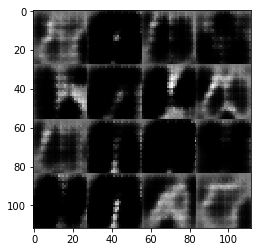

Epoch 1 / 2  D loss:  0.4040 ... G loss:  3.2590 ...
Epoch 1 / 2  D loss:  0.4068 ... G loss:  3.6664 ...
Epoch 1 / 2  D loss:  0.3716 ... G loss:  4.4525 ...
Epoch 1 / 2  D loss:  0.3923 ... G loss:  4.6897 ...
Epoch 1 / 2  D loss:  0.3868 ... G loss:  3.9815 ...
Epoch 1 / 2  D loss:  0.4703 ... G loss:  3.0656 ...
Epoch 1 / 2  D loss:  0.5504 ... G loss:  2.0020 ...
Epoch 1 / 2  D loss:  0.5078 ... G loss:  2.3984 ...
Epoch 1 / 2  D loss:  0.5218 ... G loss:  2.5225 ...
Epoch 1 / 2  D loss:  0.4379 ... G loss:  3.5434 ...
Step:  1800


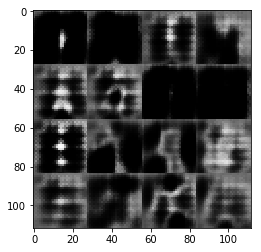

Epoch 1 / 2  D loss:  0.4872 ... G loss:  2.8721 ...
Epoch 1 / 2  D loss:  1.8363 ... G loss:  7.4029 ...
Epoch 1 / 2  D loss:  2.6717 ... G loss:  0.1541 ...
Epoch 1 / 2  D loss:  0.6063 ... G loss:  2.1720 ...
Epoch 1 / 2  D loss:  0.5133 ... G loss:  2.6289 ...
Epoch 1 / 2  D loss:  0.7118 ... G loss:  2.1473 ...
Epoch 1 / 2  D loss:  0.6304 ... G loss:  2.2417 ...
Epoch 1 / 2  D loss:  0.3828 ... G loss:  4.5394 ...
Epoch 2 / 2  D loss:  0.5341 ... G loss:  2.8438 ...
Epoch 2 / 2  D loss:  0.6486 ... G loss:  2.1125 ...
Step:  1900


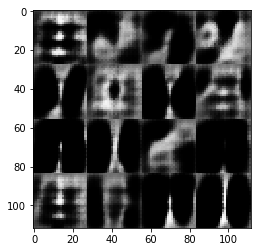

Epoch 2 / 2  D loss:  0.4826 ... G loss:  2.8421 ...
Epoch 2 / 2  D loss:  0.7211 ... G loss:  1.7240 ...
Epoch 2 / 2  D loss:  0.7090 ... G loss:  2.5309 ...
Epoch 2 / 2  D loss:  0.5842 ... G loss:  2.5799 ...
Epoch 2 / 2  D loss:  0.5458 ... G loss:  3.2381 ...
Epoch 2 / 2  D loss:  0.7008 ... G loss:  1.7261 ...
Epoch 2 / 2  D loss:  0.4811 ... G loss:  3.1426 ...
Epoch 2 / 2  D loss:  0.7704 ... G loss:  1.6557 ...
Epoch 2 / 2  D loss:  0.5699 ... G loss:  3.3343 ...
Epoch 2 / 2  D loss:  0.6914 ... G loss:  1.3546 ...
Step:  2000


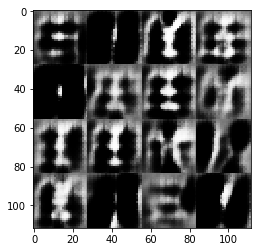

Epoch 2 / 2  D loss:  0.4568 ... G loss:  4.2091 ...
Epoch 2 / 2  D loss:  0.4732 ... G loss:  4.1610 ...
Epoch 2 / 2  D loss:  0.9506 ... G loss:  0.9484 ...
Epoch 2 / 2  D loss:  0.5217 ... G loss:  3.0157 ...
Epoch 2 / 2  D loss:  0.3657 ... G loss:  3.8709 ...
Epoch 2 / 2  D loss:  0.4190 ... G loss:  3.5143 ...
Epoch 2 / 2  D loss:  0.4833 ... G loss:  2.5095 ...
Epoch 2 / 2  D loss:  0.4408 ... G loss:  2.9875 ...
Epoch 2 / 2  D loss:  0.5378 ... G loss:  2.2449 ...
Epoch 2 / 2  D loss:  0.3791 ... G loss:  5.7044 ...
Step:  2100


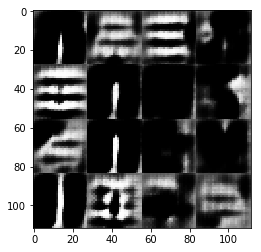

Epoch 2 / 2  D loss:  0.4610 ... G loss:  2.9847 ...
Epoch 2 / 2  D loss:  0.9188 ... G loss:  0.9641 ...
Epoch 2 / 2  D loss:  0.4701 ... G loss:  2.7831 ...
Epoch 2 / 2  D loss:  0.4246 ... G loss:  4.3804 ...
Epoch 2 / 2  D loss:  0.4644 ... G loss:  2.4381 ...
Epoch 2 / 2  D loss:  0.8391 ... G loss:  1.8079 ...
Epoch 2 / 2  D loss:  0.7699 ... G loss:  1.2297 ...
Epoch 2 / 2  D loss:  0.5759 ... G loss:  3.6403 ...
Epoch 2 / 2  D loss:  0.5293 ... G loss:  2.3083 ...
Epoch 2 / 2  D loss:  0.3770 ... G loss:  3.9499 ...
Step:  2200


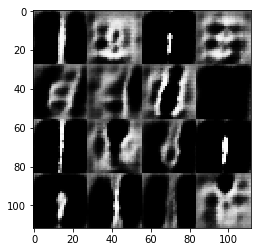

Epoch 2 / 2  D loss:  0.4456 ... G loss:  2.7360 ...
Epoch 2 / 2  D loss:  0.6583 ... G loss:  2.2514 ...
Epoch 2 / 2  D loss:  0.7013 ... G loss:  1.7350 ...
Epoch 2 / 2  D loss:  0.6508 ... G loss:  1.7179 ...
Epoch 2 / 2  D loss:  0.4655 ... G loss:  2.8636 ...
Epoch 2 / 2  D loss:  0.5715 ... G loss:  3.0198 ...
Epoch 2 / 2  D loss:  0.5226 ... G loss:  2.4248 ...
Epoch 2 / 2  D loss:  0.3777 ... G loss:  5.3157 ...
Epoch 2 / 2  D loss:  0.4755 ... G loss:  3.9272 ...
Epoch 2 / 2  D loss:  0.6422 ... G loss:  2.5612 ...
Step:  2300


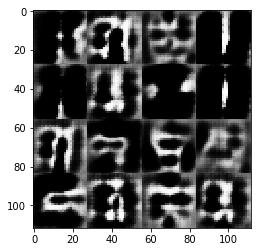

Epoch 2 / 2  D loss:  0.4280 ... G loss:  3.3716 ...
Epoch 2 / 2  D loss:  0.4694 ... G loss:  4.4023 ...
Epoch 2 / 2  D loss:  0.6015 ... G loss:  2.6210 ...
Epoch 2 / 2  D loss:  0.6175 ... G loss:  6.8659 ...
Epoch 2 / 2  D loss:  0.5509 ... G loss:  2.4562 ...
Epoch 2 / 2  D loss:  0.5230 ... G loss:  2.3475 ...
Epoch 2 / 2  D loss:  0.5541 ... G loss:  2.3572 ...
Epoch 2 / 2  D loss:  0.5860 ... G loss:  3.7119 ...
Epoch 2 / 2  D loss:  0.4193 ... G loss:  3.9281 ...
Epoch 2 / 2  D loss:  0.5740 ... G loss:  2.3453 ...
Step:  2400


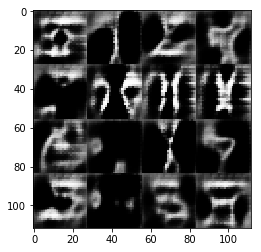

Epoch 2 / 2  D loss:  0.4464 ... G loss:  4.4274 ...
Epoch 2 / 2  D loss:  1.0068 ... G loss:  0.9262 ...
Epoch 2 / 2  D loss:  1.0367 ... G loss:  5.1535 ...
Epoch 2 / 2  D loss:  0.4521 ... G loss:  3.5177 ...
Epoch 2 / 2  D loss:  0.4712 ... G loss:  2.6984 ...
Epoch 2 / 2  D loss:  0.5588 ... G loss:  2.6881 ...
Epoch 2 / 2  D loss:  0.4467 ... G loss:  2.8030 ...
Epoch 2 / 2  D loss:  0.8726 ... G loss:  4.9334 ...
Epoch 2 / 2  D loss:  0.5616 ... G loss:  2.3229 ...
Epoch 2 / 2  D loss:  0.5763 ... G loss:  2.1970 ...
Step:  2500


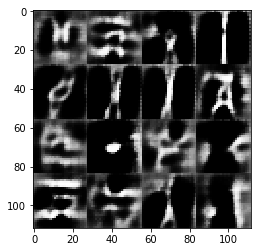

Epoch 2 / 2  D loss:  0.4811 ... G loss:  3.6693 ...
Epoch 2 / 2  D loss:  0.6860 ... G loss:  2.0283 ...
Epoch 2 / 2  D loss:  0.4144 ... G loss:  5.0204 ...
Epoch 2 / 2  D loss:  0.6605 ... G loss:  2.0771 ...
Epoch 2 / 2  D loss:  0.5157 ... G loss:  2.1245 ...
Epoch 2 / 2  D loss:  0.4475 ... G loss:  2.8658 ...
Epoch 2 / 2  D loss:  0.4319 ... G loss:  3.0139 ...
Epoch 2 / 2  D loss:  0.5591 ... G loss:  2.4785 ...
Epoch 2 / 2  D loss:  0.4267 ... G loss:  3.6174 ...
Epoch 2 / 2  D loss:  0.5450 ... G loss:  2.2930 ...
Step:  2600


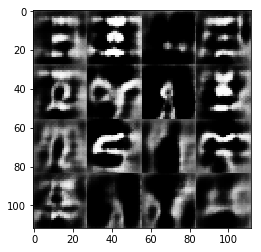

Epoch 2 / 2  D loss:  0.6910 ... G loss:  1.6904 ...
Epoch 2 / 2  D loss:  0.5406 ... G loss:  3.0934 ...
Epoch 2 / 2  D loss:  0.4751 ... G loss:  2.7451 ...
Epoch 2 / 2  D loss:  0.4706 ... G loss:  2.6941 ...
Epoch 2 / 2  D loss:  0.5477 ... G loss:  2.5592 ...
Epoch 2 / 2  D loss:  0.8220 ... G loss:  6.8703 ...
Epoch 2 / 2  D loss:  0.6064 ... G loss:  2.2995 ...
Epoch 2 / 2  D loss:  0.6466 ... G loss:  1.9513 ...
Epoch 2 / 2  D loss:  0.5370 ... G loss:  5.4971 ...
Epoch 2 / 2  D loss:  0.5390 ... G loss:  2.5034 ...
Step:  2700


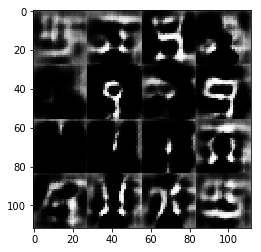

Epoch 2 / 2  D loss:  0.5867 ... G loss:  2.6664 ...
Epoch 2 / 2  D loss:  0.5602 ... G loss:  2.1937 ...
Epoch 2 / 2  D loss:  0.7365 ... G loss:  1.9769 ...
Epoch 2 / 2  D loss:  0.5164 ... G loss:  2.8164 ...
Epoch 2 / 2  D loss:  0.6072 ... G loss:  2.6125 ...
Epoch 2 / 2  D loss:  0.5956 ... G loss:  1.9405 ...
Epoch 2 / 2  D loss:  0.7103 ... G loss:  1.9276 ...
Epoch 2 / 2  D loss:  0.4063 ... G loss:  3.4907 ...
Epoch 2 / 2  D loss:  0.5278 ... G loss:  2.2393 ...
Epoch 2 / 2  D loss:  0.5971 ... G loss:  1.8388 ...
Step:  2800


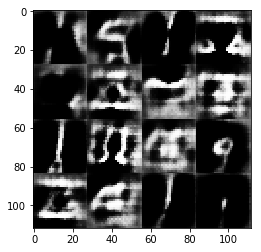

Epoch 2 / 2  D loss:  0.5690 ... G loss:  3.9659 ...
Epoch 2 / 2  D loss:  0.5655 ... G loss:  2.4228 ...
Epoch 2 / 2  D loss:  0.4813 ... G loss:  2.2527 ...
Epoch 2 / 2  D loss:  0.4098 ... G loss:  3.3042 ...
Epoch 2 / 2  D loss:  0.7534 ... G loss:  1.9945 ...
Epoch 2 / 2  D loss:  0.7999 ... G loss:  4.9016 ...
Epoch 2 / 2  D loss:  0.5419 ... G loss:  2.1818 ...
Epoch 2 / 2  D loss:  0.7764 ... G loss:  2.4845 ...
Epoch 2 / 2  D loss:  0.5740 ... G loss:  2.3103 ...
Epoch 2 / 2  D loss:  0.6391 ... G loss:  1.9580 ...
Step:  2900


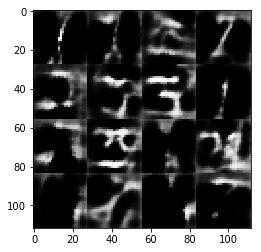

Epoch 2 / 2  D loss:  0.5713 ... G loss:  3.6277 ...
Epoch 2 / 2  D loss:  0.6701 ... G loss:  1.6607 ...
Epoch 2 / 2  D loss:  0.5594 ... G loss:  1.8454 ...
Epoch 2 / 2  D loss:  0.4954 ... G loss:  2.3110 ...
Epoch 2 / 2  D loss:  0.5295 ... G loss:  2.6157 ...
Epoch 2 / 2  D loss:  0.3931 ... G loss:  4.5262 ...
Epoch 2 / 2  D loss:  0.5603 ... G loss:  2.8418 ...
Epoch 2 / 2  D loss:  0.5085 ... G loss:  2.2609 ...
Epoch 2 / 2  D loss:  0.4465 ... G loss:  3.2005 ...
Epoch 2 / 2  D loss:  0.6567 ... G loss:  1.5968 ...
Step:  3000


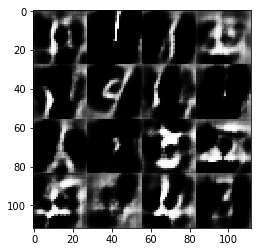

Epoch 2 / 2  D loss:  0.6011 ... G loss:  2.8205 ...
Epoch 2 / 2  D loss:  1.9676 ... G loss:  0.2343 ...
Epoch 2 / 2  D loss:  0.6912 ... G loss:  2.3936 ...
Epoch 2 / 2  D loss:  0.8116 ... G loss:  1.5578 ...
Epoch 2 / 2  D loss:  0.7182 ... G loss:  2.6527 ...
Epoch 2 / 2  D loss:  0.5461 ... G loss:  1.8647 ...
Epoch 2 / 2  D loss:  0.6348 ... G loss:  1.7399 ...
Epoch 2 / 2  D loss:  0.7390 ... G loss:  1.5820 ...
Epoch 2 / 2  D loss:  0.4725 ... G loss:  3.2051 ...
Epoch 2 / 2  D loss:  0.7163 ... G loss:  2.1329 ...
Step:  3100


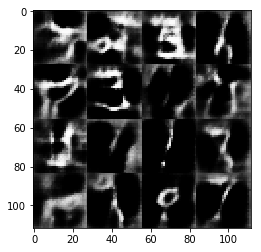

Epoch 2 / 2  D loss:  1.6715 ... G loss:  0.3443 ...
Epoch 2 / 2  D loss:  0.5641 ... G loss:  2.8777 ...
Epoch 2 / 2  D loss:  0.5949 ... G loss:  2.8377 ...
Epoch 2 / 2  D loss:  0.4117 ... G loss:  4.1342 ...
Epoch 2 / 2  D loss:  0.5827 ... G loss:  2.3089 ...
Epoch 2 / 2  D loss:  0.8162 ... G loss:  1.5359 ...
Epoch 2 / 2  D loss:  0.6398 ... G loss:  2.2013 ...
Epoch 2 / 2  D loss:  0.6080 ... G loss:  2.6297 ...
Epoch 2 / 2  D loss:  0.4766 ... G loss:  3.0255 ...
Epoch 2 / 2  D loss:  0.4906 ... G loss:  2.3786 ...
Step:  3200


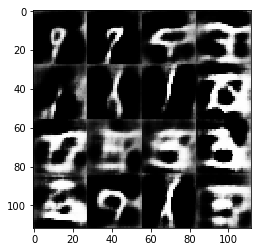

Epoch 2 / 2  D loss:  0.5110 ... G loss:  2.9224 ...
Epoch 2 / 2  D loss:  0.6132 ... G loss:  2.0607 ...
Epoch 2 / 2  D loss:  0.4626 ... G loss:  2.6457 ...
Epoch 2 / 2  D loss:  0.5774 ... G loss:  2.3981 ...
Epoch 2 / 2  D loss:  0.4513 ... G loss:  2.6590 ...
Epoch 2 / 2  D loss:  0.5288 ... G loss:  6.9560 ...
Epoch 2 / 2  D loss:  0.5339 ... G loss:  2.4872 ...
Epoch 2 / 2  D loss:  0.5041 ... G loss:  2.4691 ...
Epoch 2 / 2  D loss:  0.5227 ... G loss:  2.6187 ...
Epoch 2 / 2  D loss:  0.6698 ... G loss:  1.4315 ...
Step:  3300


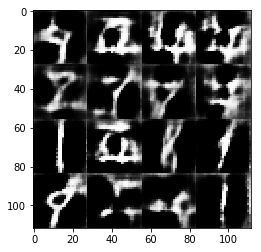

Epoch 2 / 2  D loss:  0.6055 ... G loss:  2.2257 ...
Epoch 2 / 2  D loss:  0.5678 ... G loss:  2.2301 ...
Epoch 2 / 2  D loss:  0.4130 ... G loss:  4.0036 ...
Epoch 2 / 2  D loss:  0.9447 ... G loss:  1.2215 ...
Epoch 2 / 2  D loss:  0.5297 ... G loss:  2.6955 ...
Epoch 2 / 2  D loss:  0.7499 ... G loss:  1.3510 ...
Epoch 2 / 2  D loss:  0.6187 ... G loss:  2.4741 ...
Epoch 2 / 2  D loss:  0.7051 ... G loss:  1.6429 ...
Epoch 2 / 2  D loss:  0.6683 ... G loss:  2.1930 ...
Epoch 2 / 2  D loss:  0.4947 ... G loss:  3.0962 ...
Step:  3400


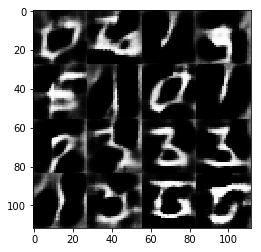

Epoch 2 / 2  D loss:  0.8162 ... G loss:  1.3585 ...
Epoch 2 / 2  D loss:  0.7926 ... G loss:  1.5759 ...
Epoch 2 / 2  D loss:  0.6878 ... G loss:  4.7240 ...
Epoch 2 / 2  D loss:  0.4798 ... G loss:  2.3828 ...
Epoch 2 / 2  D loss:  0.6188 ... G loss:  1.9802 ...
Epoch 2 / 2  D loss:  0.6710 ... G loss:  2.7881 ...
Epoch 2 / 2  D loss:  0.7045 ... G loss:  1.4386 ...
Epoch 2 / 2  D loss:  0.6389 ... G loss:  2.1304 ...
Epoch 2 / 2  D loss:  0.9136 ... G loss:  1.1522 ...
Epoch 2 / 2  D loss:  0.4785 ... G loss:  2.6186 ...
Step:  3500


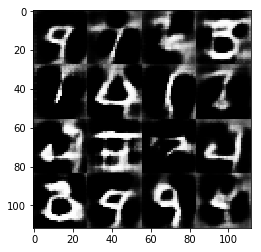

Epoch 2 / 2  D loss:  0.4494 ... G loss:  2.8514 ...
Epoch 2 / 2  D loss:  0.6347 ... G loss:  1.8758 ...
Epoch 2 / 2  D loss:  0.4809 ... G loss:  3.0708 ...
Epoch 2 / 2  D loss:  0.8145 ... G loss:  1.2947 ...
Epoch 2 / 2  D loss:  0.5286 ... G loss:  1.9402 ...
Epoch 2 / 2  D loss:  0.3891 ... G loss:  3.6862 ...
Epoch 2 / 2  D loss:  0.5985 ... G loss:  2.3481 ...
Epoch 2 / 2  D loss:  0.8004 ... G loss:  1.5887 ...
Epoch 2 / 2  D loss:  0.5312 ... G loss:  2.4533 ...
Epoch 2 / 2  D loss:  1.2327 ... G loss:  0.8344 ...
Step:  3600


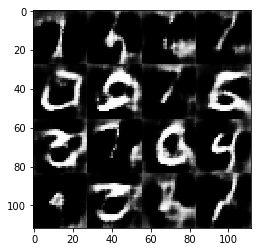

Epoch 2 / 2  D loss:  0.8583 ... G loss:  2.1154 ...
Epoch 2 / 2  D loss:  0.6181 ... G loss:  2.2688 ...
Epoch 2 / 2  D loss:  0.6568 ... G loss:  2.2164 ...
Epoch 2 / 2  D loss:  0.5092 ... G loss:  2.6209 ...
Epoch 2 / 2  D loss:  0.6612 ... G loss:  2.0652 ...
Epoch 2 / 2  D loss:  0.5234 ... G loss:  2.3309 ...
Epoch 2 / 2  D loss:  0.4892 ... G loss:  2.6779 ...
Epoch 2 / 2  D loss:  0.5433 ... G loss:  2.5206 ...
Epoch 2 / 2  D loss:  0.6472 ... G loss:  1.9620 ...
Epoch 2 / 2  D loss:  0.4811 ... G loss:  3.0438 ...
Step:  3700


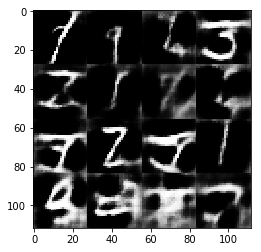

Epoch 2 / 2  D loss:  0.9940 ... G loss:  1.1732 ...
Epoch 2 / 2  D loss:  0.6122 ... G loss:  1.9125 ...
Epoch 2 / 2  D loss:  0.7872 ... G loss:  2.0600 ...
Epoch 2 / 2  D loss:  0.5288 ... G loss:  2.2703 ...
Epoch 2 / 2  D loss:  0.7915 ... G loss:  1.2662 ...
Epoch 2 / 2  D loss:  0.6555 ... G loss:  2.3269 ...


In [78]:
# learning rate = 2e-4
losses = train( net, epoch_count, batch_size, z_dim, 
                mnist_dataset.get_batches, mnist_dataset.image_mode)

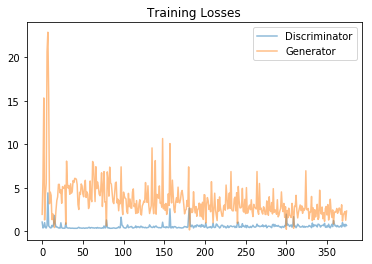

In [79]:
print_losses_chart(losses)

---

### CelebA
Run your GANs on CelebA.  It will take around 20 minutes on the average GPU to run one epoch.  You can run the whole epoch or stop when it starts to generate realistic faces.

In [42]:
z_dim = 128
learning_rate = 0.0003
batch_size = 64
alpha = 0.1
beta1 = 0.5
epoch_count = 1

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))

data_shape = celeba_dataset.shape[1 : ]
print(data_shape)


(28, 28, 3)


---

Step:  1


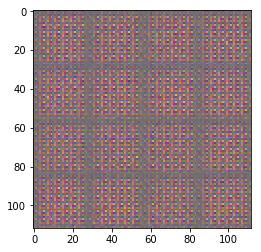

Epoch 1 / 1  D loss:  0.7870 ... G loss:  17.7527 ...
Epoch 1 / 1  D loss:  0.4764 ... G loss:  8.2102 ...
Epoch 1 / 1  D loss:  0.9463 ... G loss:  1.2652 ...
Epoch 1 / 1  D loss:  0.8445 ... G loss:  5.4777 ...
Epoch 1 / 1  D loss:  0.7052 ... G loss:  4.9616 ...
Epoch 1 / 1  D loss:  1.1787 ... G loss:  1.3002 ...
Epoch 1 / 1  D loss:  3.1953 ... G loss:  0.1042 ...
Epoch 1 / 1  D loss:  0.7100 ... G loss:  6.0361 ...
Epoch 1 / 1  D loss:  0.7309 ... G loss:  1.8915 ...
Step:  100


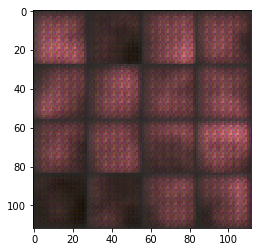

Epoch 1 / 1  D loss:  0.8962 ... G loss:  0.9725 ...
Epoch 1 / 1  D loss:  0.5286 ... G loss:  2.3021 ...
Epoch 1 / 1  D loss:  0.5461 ... G loss:  2.3564 ...
Epoch 1 / 1  D loss:  0.4906 ... G loss:  3.0557 ...
Epoch 1 / 1  D loss:  0.6474 ... G loss:  1.5031 ...
Epoch 1 / 1  D loss:  1.2811 ... G loss:  0.8182 ...
Epoch 1 / 1  D loss:  0.7988 ... G loss:  1.5290 ...
Epoch 1 / 1  D loss:  2.5810 ... G loss:  8.4942 ...
Epoch 1 / 1  D loss:  1.4191 ... G loss:  0.4612 ...
Epoch 1 / 1  D loss:  0.7625 ... G loss:  2.8882 ...
Step:  200


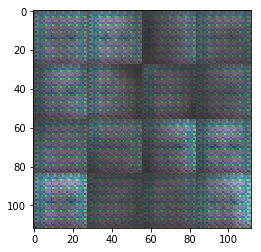

Epoch 1 / 1  D loss:  0.5663 ... G loss:  2.7607 ...
Epoch 1 / 1  D loss:  2.5548 ... G loss:  0.1595 ...
Epoch 1 / 1  D loss:  0.6663 ... G loss:  1.7793 ...
Epoch 1 / 1  D loss:  1.0271 ... G loss:  1.0614 ...
Epoch 1 / 1  D loss:  1.3407 ... G loss:  0.6748 ...
Epoch 1 / 1  D loss:  0.7574 ... G loss:  1.4849 ...
Epoch 1 / 1  D loss:  0.6338 ... G loss:  2.1933 ...
Epoch 1 / 1  D loss:  2.3342 ... G loss:  0.1833 ...
Epoch 1 / 1  D loss:  0.7565 ... G loss:  1.5543 ...
Epoch 1 / 1  D loss:  0.7596 ... G loss:  2.2200 ...
Step:  300


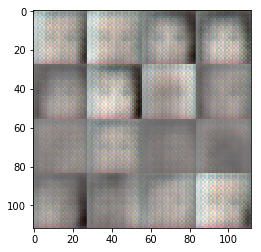

Epoch 1 / 1  D loss:  0.5537 ... G loss:  2.3403 ...
Epoch 1 / 1  D loss:  0.8453 ... G loss:  3.3881 ...
Epoch 1 / 1  D loss:  0.7347 ... G loss:  1.4151 ...
Epoch 1 / 1  D loss:  1.3621 ... G loss:  0.7528 ...
Epoch 1 / 1  D loss:  0.9343 ... G loss:  1.1936 ...
Epoch 1 / 1  D loss:  2.1765 ... G loss:  0.2747 ...
Epoch 1 / 1  D loss:  0.7459 ... G loss:  1.7849 ...
Epoch 1 / 1  D loss:  0.8821 ... G loss:  3.2124 ...
Epoch 1 / 1  D loss:  1.5317 ... G loss:  1.2365 ...
Epoch 1 / 1  D loss:  0.9856 ... G loss:  1.0969 ...
Step:  400


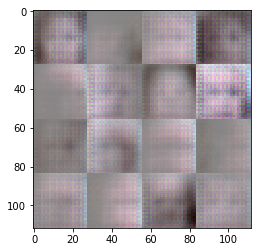

Epoch 1 / 1  D loss:  1.0168 ... G loss:  1.0144 ...
Epoch 1 / 1  D loss:  0.6086 ... G loss:  3.6615 ...
Epoch 1 / 1  D loss:  1.1782 ... G loss:  5.8409 ...
Epoch 1 / 1  D loss:  0.7648 ... G loss:  1.3415 ...
Epoch 1 / 1  D loss:  1.4155 ... G loss:  0.5341 ...
Epoch 1 / 1  D loss:  0.8022 ... G loss:  1.5852 ...
Epoch 1 / 1  D loss:  0.8931 ... G loss:  1.4177 ...
Epoch 1 / 1  D loss:  2.3504 ... G loss:  3.7194 ...
Epoch 1 / 1  D loss:  1.0249 ... G loss:  0.9838 ...
Epoch 1 / 1  D loss:  1.1370 ... G loss:  1.3721 ...
Step:  500


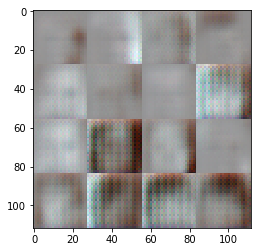

Epoch 1 / 1  D loss:  1.1300 ... G loss:  1.1524 ...
Epoch 1 / 1  D loss:  0.4405 ... G loss:  2.7533 ...
Epoch 1 / 1  D loss:  0.9437 ... G loss:  1.6577 ...
Epoch 1 / 1  D loss:  0.5116 ... G loss:  2.7650 ...
Epoch 1 / 1  D loss:  2.2701 ... G loss:  6.4707 ...
Epoch 1 / 1  D loss:  1.5066 ... G loss:  0.4972 ...
Epoch 1 / 1  D loss:  2.0258 ... G loss:  3.0532 ...
Epoch 1 / 1  D loss:  1.0561 ... G loss:  1.1862 ...
Epoch 1 / 1  D loss:  1.1973 ... G loss:  0.9715 ...
Epoch 1 / 1  D loss:  1.1193 ... G loss:  1.7109 ...
Step:  600


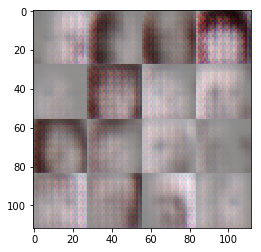

Epoch 1 / 1  D loss:  1.2075 ... G loss:  1.1362 ...
Epoch 1 / 1  D loss:  1.6295 ... G loss:  2.8197 ...
Epoch 1 / 1  D loss:  1.0469 ... G loss:  1.0588 ...
Epoch 1 / 1  D loss:  0.5398 ... G loss:  2.6364 ...
Epoch 1 / 1  D loss:  1.0831 ... G loss:  1.2588 ...
Epoch 1 / 1  D loss:  0.6565 ... G loss:  4.7744 ...
Epoch 1 / 1  D loss:  0.7713 ... G loss:  1.2852 ...
Epoch 1 / 1  D loss:  0.6404 ... G loss:  1.7208 ...
Epoch 1 / 1  D loss:  1.7511 ... G loss:  3.3796 ...
Epoch 1 / 1  D loss:  0.9247 ... G loss:  1.0282 ...
Step:  700


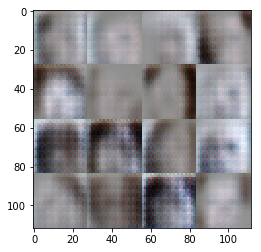

Epoch 1 / 1  D loss:  1.7192 ... G loss:  0.3983 ...
Epoch 1 / 1  D loss:  0.6518 ... G loss:  1.9552 ...
Epoch 1 / 1  D loss:  0.9395 ... G loss:  1.3450 ...
Epoch 1 / 1  D loss:  1.2736 ... G loss:  1.4966 ...
Epoch 1 / 1  D loss:  0.8239 ... G loss:  1.2538 ...
Epoch 1 / 1  D loss:  0.7767 ... G loss:  1.2767 ...
Epoch 1 / 1  D loss:  3.2924 ... G loss:  7.7654 ...
Epoch 1 / 1  D loss:  0.7730 ... G loss:  3.2901 ...
Epoch 1 / 1  D loss:  0.8294 ... G loss:  1.2789 ...
Epoch 1 / 1  D loss:  1.4730 ... G loss:  0.5028 ...
Step:  800


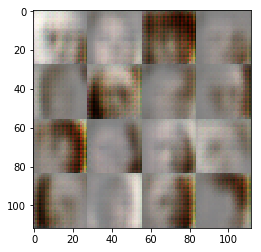

Epoch 1 / 1  D loss:  0.5607 ... G loss:  3.8683 ...
Epoch 1 / 1  D loss:  1.4739 ... G loss:  0.5381 ...
Epoch 1 / 1  D loss:  1.1323 ... G loss:  1.2747 ...
Epoch 1 / 1  D loss:  1.4197 ... G loss:  0.5686 ...
Epoch 1 / 1  D loss:  1.0328 ... G loss:  1.3374 ...
Epoch 1 / 1  D loss:  1.1440 ... G loss:  0.7541 ...
Epoch 1 / 1  D loss:  1.4046 ... G loss:  0.5054 ...
Epoch 1 / 1  D loss:  0.6936 ... G loss:  1.5985 ...
Epoch 1 / 1  D loss:  0.7850 ... G loss:  1.1169 ...
Epoch 1 / 1  D loss:  1.1572 ... G loss:  4.5148 ...
Step:  900


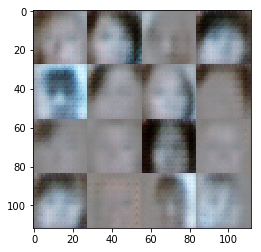

Epoch 1 / 1  D loss:  0.6190 ... G loss:  2.8733 ...
Epoch 1 / 1  D loss:  1.1594 ... G loss:  0.9037 ...
Epoch 1 / 1  D loss:  1.0065 ... G loss:  1.7280 ...
Epoch 1 / 1  D loss:  0.5912 ... G loss:  3.3390 ...
Epoch 1 / 1  D loss:  0.7071 ... G loss:  3.0936 ...
Epoch 1 / 1  D loss:  0.6044 ... G loss:  1.6808 ...
Epoch 1 / 1  D loss:  1.5603 ... G loss:  3.2346 ...
Epoch 1 / 1  D loss:  1.0769 ... G loss:  1.2527 ...
Epoch 1 / 1  D loss:  1.0377 ... G loss:  1.1611 ...
Epoch 1 / 1  D loss:  1.8606 ... G loss:  0.3412 ...
Step:  1000


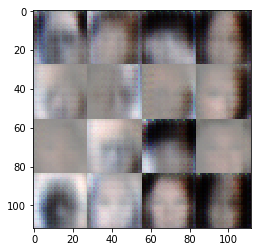

Epoch 1 / 1  D loss:  1.8289 ... G loss:  4.9175 ...
Epoch 1 / 1  D loss:  0.9905 ... G loss:  0.8794 ...
Epoch 1 / 1  D loss:  1.0789 ... G loss:  1.3148 ...
Epoch 1 / 1  D loss:  1.1661 ... G loss:  0.6266 ...
Epoch 1 / 1  D loss:  0.9261 ... G loss:  2.1668 ...
Epoch 1 / 1  D loss:  0.8567 ... G loss:  1.6198 ...
Epoch 1 / 1  D loss:  0.9027 ... G loss:  1.6297 ...
Epoch 1 / 1  D loss:  1.7816 ... G loss:  3.7485 ...
Epoch 1 / 1  D loss:  0.5846 ... G loss:  2.2474 ...
Epoch 1 / 1  D loss:  1.3233 ... G loss:  0.7578 ...
Step:  1100


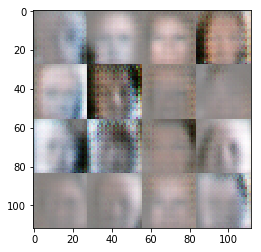

Epoch 1 / 1  D loss:  0.4428 ... G loss:  3.8129 ...
Epoch 1 / 1  D loss:  1.1886 ... G loss:  1.3381 ...
Epoch 1 / 1  D loss:  0.7866 ... G loss:  1.5355 ...
Epoch 1 / 1  D loss:  0.6946 ... G loss:  6.5691 ...
Epoch 1 / 1  D loss:  1.2429 ... G loss:  0.7218 ...
Epoch 1 / 1  D loss:  0.6353 ... G loss:  1.7183 ...
Epoch 1 / 1  D loss:  0.7823 ... G loss:  1.7381 ...
Epoch 1 / 1  D loss:  1.0066 ... G loss:  1.1662 ...
Epoch 1 / 1  D loss:  1.0874 ... G loss:  1.3567 ...
Epoch 1 / 1  D loss:  0.9102 ... G loss:  2.8604 ...
Step:  1200


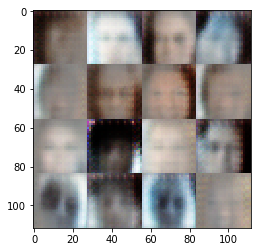

Epoch 1 / 1  D loss:  1.3338 ... G loss:  0.7233 ...
Epoch 1 / 1  D loss:  1.5032 ... G loss:  2.6604 ...
Epoch 1 / 1  D loss:  0.8185 ... G loss:  1.4194 ...
Epoch 1 / 1  D loss:  0.3934 ... G loss:  4.5064 ...
Epoch 1 / 1  D loss:  0.6910 ... G loss:  1.7466 ...
Epoch 1 / 1  D loss:  0.5993 ... G loss:  2.6417 ...
Epoch 1 / 1  D loss:  0.9797 ... G loss:  1.4443 ...
Epoch 1 / 1  D loss:  1.9661 ... G loss:  3.4155 ...
Epoch 1 / 1  D loss:  1.0161 ... G loss:  5.3792 ...
Epoch 1 / 1  D loss:  1.2289 ... G loss:  0.7232 ...
Step:  1300


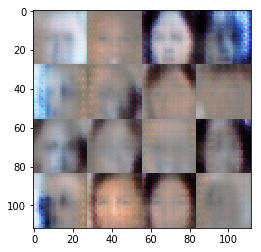

Epoch 1 / 1  D loss:  1.1745 ... G loss:  1.1118 ...
Epoch 1 / 1  D loss:  1.2606 ... G loss:  0.9571 ...
Epoch 1 / 1  D loss:  1.1782 ... G loss:  1.9505 ...
Epoch 1 / 1  D loss:  0.9336 ... G loss:  1.2431 ...
Epoch 1 / 1  D loss:  0.9225 ... G loss:  1.1330 ...
Epoch 1 / 1  D loss:  1.1697 ... G loss:  1.3209 ...
Epoch 1 / 1  D loss:  2.8218 ... G loss:  0.0990 ...
Epoch 1 / 1  D loss:  1.0060 ... G loss:  1.0917 ...
Epoch 1 / 1  D loss:  1.8020 ... G loss:  3.4185 ...
Epoch 1 / 1  D loss:  1.1749 ... G loss:  1.1420 ...
Step:  1400


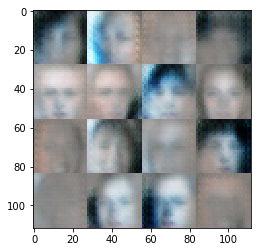

Epoch 1 / 1  D loss:  0.7050 ... G loss:  2.4863 ...
Epoch 1 / 1  D loss:  1.2175 ... G loss:  0.8731 ...
Epoch 1 / 1  D loss:  0.9153 ... G loss:  1.5562 ...
Epoch 1 / 1  D loss:  1.0019 ... G loss:  3.3639 ...
Epoch 1 / 1  D loss:  0.9940 ... G loss:  1.7253 ...
Epoch 1 / 1  D loss:  1.0331 ... G loss:  0.8779 ...
Epoch 1 / 1  D loss:  1.1983 ... G loss:  1.1204 ...
Epoch 1 / 1  D loss:  1.1910 ... G loss:  0.7822 ...
Epoch 1 / 1  D loss:  1.1564 ... G loss:  0.8761 ...
Epoch 1 / 1  D loss:  1.0889 ... G loss:  1.0243 ...
Step:  1500


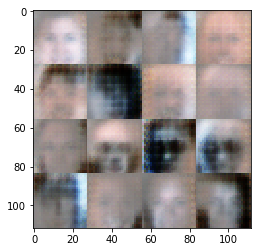

Epoch 1 / 1  D loss:  0.9578 ... G loss:  0.9893 ...
Epoch 1 / 1  D loss:  0.8824 ... G loss:  1.4535 ...
Epoch 1 / 1  D loss:  1.1682 ... G loss:  1.3490 ...
Epoch 1 / 1  D loss:  1.0911 ... G loss:  2.7174 ...
Epoch 1 / 1  D loss:  0.9349 ... G loss:  2.7091 ...
Epoch 1 / 1  D loss:  0.8432 ... G loss:  1.2402 ...
Epoch 1 / 1  D loss:  0.8636 ... G loss:  2.3531 ...
Epoch 1 / 1  D loss:  0.9110 ... G loss:  1.3900 ...
Epoch 1 / 1  D loss:  1.1296 ... G loss:  1.7554 ...
Epoch 1 / 1  D loss:  0.6998 ... G loss:  1.4492 ...
Step:  1600


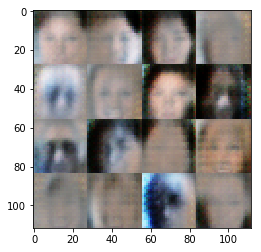

Epoch 1 / 1  D loss:  0.9734 ... G loss:  1.3593 ...
Epoch 1 / 1  D loss:  1.7836 ... G loss:  0.3707 ...
Epoch 1 / 1  D loss:  1.1211 ... G loss:  0.8934 ...
Epoch 1 / 1  D loss:  1.2141 ... G loss:  1.0830 ...
Epoch 1 / 1  D loss:  1.3559 ... G loss:  0.9931 ...
Epoch 1 / 1  D loss:  1.5126 ... G loss:  0.5169 ...
Epoch 1 / 1  D loss:  0.8729 ... G loss:  1.3313 ...
Epoch 1 / 1  D loss:  1.1359 ... G loss:  0.9576 ...
Epoch 1 / 1  D loss:  0.9817 ... G loss:  1.3913 ...
Epoch 1 / 1  D loss:  0.8061 ... G loss:  1.2598 ...
Step:  1700


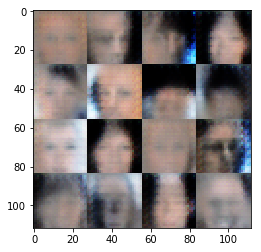

Epoch 1 / 1  D loss:  0.9318 ... G loss:  1.0346 ...
Epoch 1 / 1  D loss:  1.2723 ... G loss:  1.5468 ...
Epoch 1 / 1  D loss:  1.6858 ... G loss:  2.9116 ...
Epoch 1 / 1  D loss:  1.1223 ... G loss:  0.7952 ...
Epoch 1 / 1  D loss:  1.0653 ... G loss:  0.9337 ...
Epoch 1 / 1  D loss:  0.9621 ... G loss:  2.0039 ...
Epoch 1 / 1  D loss:  1.2324 ... G loss:  0.9589 ...
Epoch 1 / 1  D loss:  1.2245 ... G loss:  1.9272 ...
Epoch 1 / 1  D loss:  0.6838 ... G loss:  2.2017 ...
Epoch 1 / 1  D loss:  0.9429 ... G loss:  1.2096 ...
Step:  1800


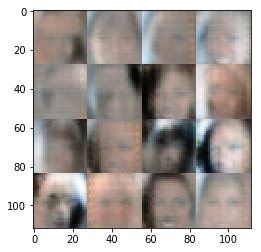

Epoch 1 / 1  D loss:  1.0148 ... G loss:  1.0355 ...
Epoch 1 / 1  D loss:  1.4267 ... G loss:  0.5107 ...
Epoch 1 / 1  D loss:  1.3220 ... G loss:  0.5710 ...
Epoch 1 / 1  D loss:  1.3500 ... G loss:  0.9480 ...
Epoch 1 / 1  D loss:  2.4606 ... G loss:  0.1526 ...
Epoch 1 / 1  D loss:  1.4651 ... G loss:  0.5389 ...
Epoch 1 / 1  D loss:  2.2028 ... G loss:  2.9899 ...
Epoch 1 / 1  D loss:  1.2975 ... G loss:  1.0713 ...
Epoch 1 / 1  D loss:  1.0717 ... G loss:  1.3080 ...
Epoch 1 / 1  D loss:  1.7657 ... G loss:  0.3494 ...
Step:  1900


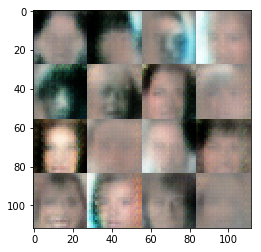

Epoch 1 / 1  D loss:  0.6225 ... G loss:  1.5859 ...
Epoch 1 / 1  D loss:  0.9470 ... G loss:  0.9801 ...
Epoch 1 / 1  D loss:  0.9763 ... G loss:  1.4107 ...
Epoch 1 / 1  D loss:  1.0258 ... G loss:  2.2932 ...
Epoch 1 / 1  D loss:  1.2940 ... G loss:  1.0553 ...
Epoch 1 / 1  D loss:  1.3344 ... G loss:  0.9725 ...
Epoch 1 / 1  D loss:  1.0045 ... G loss:  1.4632 ...
Epoch 1 / 1  D loss:  1.0497 ... G loss:  1.1109 ...
Epoch 1 / 1  D loss:  0.8418 ... G loss:  1.9357 ...
Epoch 1 / 1  D loss:  1.0406 ... G loss:  1.0654 ...
Step:  2000


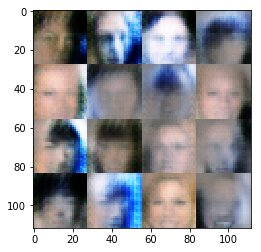

Epoch 1 / 1  D loss:  1.0309 ... G loss:  1.2809 ...
Epoch 1 / 1  D loss:  1.6226 ... G loss:  0.4397 ...
Epoch 1 / 1  D loss:  0.6353 ... G loss:  1.5208 ...
Epoch 1 / 1  D loss:  1.0123 ... G loss:  1.0167 ...
Epoch 1 / 1  D loss:  0.9508 ... G loss:  1.7558 ...
Epoch 1 / 1  D loss:  1.0821 ... G loss:  1.3501 ...
Epoch 1 / 1  D loss:  1.3537 ... G loss:  0.7623 ...
Epoch 1 / 1  D loss:  0.4555 ... G loss:  2.8162 ...
Epoch 1 / 1  D loss:  1.0812 ... G loss:  1.0671 ...
Epoch 1 / 1  D loss:  1.3844 ... G loss:  0.5610 ...
Step:  2100


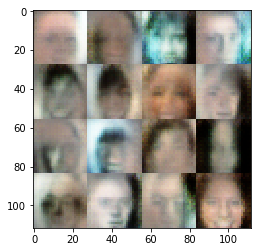

Epoch 1 / 1  D loss:  1.2681 ... G loss:  0.7860 ...
Epoch 1 / 1  D loss:  1.2117 ... G loss:  1.3550 ...
Epoch 1 / 1  D loss:  1.1744 ... G loss:  1.0337 ...
Epoch 1 / 1  D loss:  1.2246 ... G loss:  0.8885 ...
Epoch 1 / 1  D loss:  1.1385 ... G loss:  0.9454 ...
Epoch 1 / 1  D loss:  1.1877 ... G loss:  0.8513 ...
Epoch 1 / 1  D loss:  1.0211 ... G loss:  1.1121 ...
Epoch 1 / 1  D loss:  1.0562 ... G loss:  1.2296 ...
Epoch 1 / 1  D loss:  0.9866 ... G loss:  2.1852 ...
Epoch 1 / 1  D loss:  1.5867 ... G loss:  1.9370 ...
Step:  2200


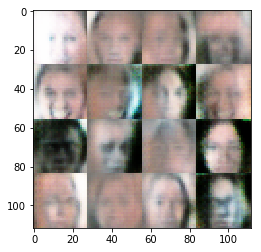

Epoch 1 / 1  D loss:  1.0932 ... G loss:  1.4844 ...
Epoch 1 / 1  D loss:  0.5060 ... G loss:  2.2201 ...
Epoch 1 / 1  D loss:  0.7826 ... G loss:  1.7829 ...
Epoch 1 / 1  D loss:  1.5250 ... G loss:  0.3771 ...
Epoch 1 / 1  D loss:  1.2186 ... G loss:  0.8494 ...
Epoch 1 / 1  D loss:  0.9895 ... G loss:  1.2038 ...
Epoch 1 / 1  D loss:  1.0087 ... G loss:  0.9725 ...
Epoch 1 / 1  D loss:  0.8863 ... G loss:  1.4437 ...
Epoch 1 / 1  D loss:  0.7610 ... G loss:  1.9814 ...
Epoch 1 / 1  D loss:  0.9465 ... G loss:  1.2554 ...
Step:  2300


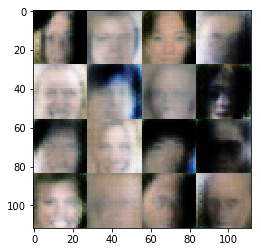

Epoch 1 / 1  D loss:  1.1816 ... G loss:  1.0049 ...
Epoch 1 / 1  D loss:  0.9685 ... G loss:  3.6452 ...
Epoch 1 / 1  D loss:  1.2012 ... G loss:  0.7442 ...
Epoch 1 / 1  D loss:  1.0457 ... G loss:  1.6020 ...
Epoch 1 / 1  D loss:  0.7905 ... G loss:  1.3760 ...
Epoch 1 / 1  D loss:  1.0720 ... G loss:  0.9806 ...
Epoch 1 / 1  D loss:  1.1776 ... G loss:  1.3322 ...
Epoch 1 / 1  D loss:  0.9357 ... G loss:  0.9977 ...
Epoch 1 / 1  D loss:  0.9875 ... G loss:  0.9454 ...
Epoch 1 / 1  D loss:  0.9405 ... G loss:  0.9413 ...
Step:  2400


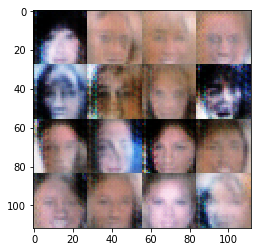

Epoch 1 / 1  D loss:  0.6950 ... G loss:  1.2842 ...
Epoch 1 / 1  D loss:  0.8255 ... G loss:  1.7179 ...
Epoch 1 / 1  D loss:  0.8777 ... G loss:  1.0826 ...
Epoch 1 / 1  D loss:  1.2647 ... G loss:  2.9444 ...
Epoch 1 / 1  D loss:  1.1455 ... G loss:  1.0227 ...
Epoch 1 / 1  D loss:  0.6370 ... G loss:  1.9445 ...
Epoch 1 / 1  D loss:  0.9395 ... G loss:  1.0711 ...
Epoch 1 / 1  D loss:  0.6573 ... G loss:  2.1211 ...
Epoch 1 / 1  D loss:  0.8153 ... G loss:  1.2728 ...
Epoch 1 / 1  D loss:  0.9424 ... G loss:  2.3246 ...
Step:  2500


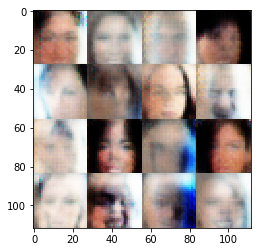

Epoch 1 / 1  D loss:  2.3434 ... G loss:  0.2027 ...
Epoch 1 / 1  D loss:  0.9870 ... G loss:  2.4242 ...
Epoch 1 / 1  D loss:  1.0714 ... G loss:  2.1520 ...
Epoch 1 / 1  D loss:  0.9148 ... G loss:  1.6421 ...
Epoch 1 / 1  D loss:  1.2956 ... G loss:  0.6477 ...
Epoch 1 / 1  D loss:  1.5587 ... G loss:  0.4669 ...
Epoch 1 / 1  D loss:  0.9982 ... G loss:  1.3246 ...
Epoch 1 / 1  D loss:  1.0581 ... G loss:  1.4572 ...
Epoch 1 / 1  D loss:  0.9846 ... G loss:  1.1087 ...
Epoch 1 / 1  D loss:  0.9321 ... G loss:  0.9959 ...
Step:  2600


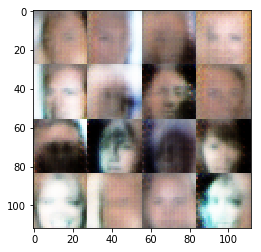

Epoch 1 / 1  D loss:  1.0370 ... G loss:  1.2545 ...
Epoch 1 / 1  D loss:  1.6753 ... G loss:  0.3581 ...
Epoch 1 / 1  D loss:  0.9291 ... G loss:  1.7884 ...
Epoch 1 / 1  D loss:  1.1180 ... G loss:  0.8961 ...
Epoch 1 / 1  D loss:  0.8700 ... G loss:  1.0912 ...
Epoch 1 / 1  D loss:  1.0914 ... G loss:  0.9714 ...
Epoch 1 / 1  D loss:  1.3409 ... G loss:  0.6668 ...
Epoch 1 / 1  D loss:  1.2360 ... G loss:  0.8127 ...
Epoch 1 / 1  D loss:  1.1128 ... G loss:  0.9814 ...
Epoch 1 / 1  D loss:  1.1389 ... G loss:  1.0664 ...
Step:  2700


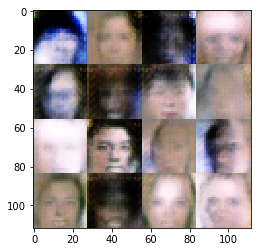

Epoch 1 / 1  D loss:  1.2371 ... G loss:  2.1806 ...
Epoch 1 / 1  D loss:  1.0344 ... G loss:  1.5287 ...
Epoch 1 / 1  D loss:  1.2618 ... G loss:  0.6468 ...
Epoch 1 / 1  D loss:  1.1205 ... G loss:  1.2620 ...
Epoch 1 / 1  D loss:  1.0487 ... G loss:  1.0745 ...
Epoch 1 / 1  D loss:  1.0365 ... G loss:  0.9731 ...
Epoch 1 / 1  D loss:  1.2070 ... G loss:  1.3009 ...
Epoch 1 / 1  D loss:  1.1626 ... G loss:  1.6889 ...
Epoch 1 / 1  D loss:  1.0185 ... G loss:  1.7628 ...
Epoch 1 / 1  D loss:  1.0106 ... G loss:  1.5286 ...
Step:  2800


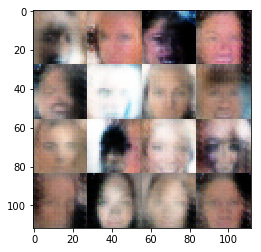

Epoch 1 / 1  D loss:  1.2525 ... G loss:  1.1280 ...
Epoch 1 / 1  D loss:  1.1221 ... G loss:  1.0477 ...
Epoch 1 / 1  D loss:  1.0262 ... G loss:  0.9753 ...
Epoch 1 / 1  D loss:  1.1762 ... G loss:  1.1256 ...
Epoch 1 / 1  D loss:  1.2237 ... G loss:  0.7261 ...
Epoch 1 / 1  D loss:  0.8971 ... G loss:  1.5803 ...
Epoch 1 / 1  D loss:  0.7450 ... G loss:  1.3918 ...
Epoch 1 / 1  D loss:  1.3107 ... G loss:  1.2389 ...
Epoch 1 / 1  D loss:  1.0875 ... G loss:  0.8770 ...
Epoch 1 / 1  D loss:  1.0939 ... G loss:  1.1528 ...
Step:  2900


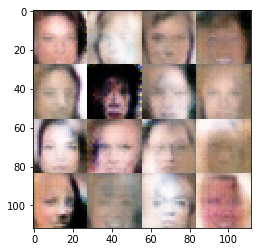

Epoch 1 / 1  D loss:  1.3326 ... G loss:  0.8332 ...
Epoch 1 / 1  D loss:  1.2862 ... G loss:  0.5819 ...
Epoch 1 / 1  D loss:  1.0234 ... G loss:  1.5045 ...
Epoch 1 / 1  D loss:  0.9968 ... G loss:  1.0303 ...
Epoch 1 / 1  D loss:  1.0788 ... G loss:  1.3082 ...
Epoch 1 / 1  D loss:  1.0626 ... G loss:  1.1559 ...
Epoch 1 / 1  D loss:  0.6747 ... G loss:  2.7927 ...
Epoch 1 / 1  D loss:  1.1426 ... G loss:  1.0916 ...
Epoch 1 / 1  D loss:  1.4509 ... G loss:  0.9267 ...
Epoch 1 / 1  D loss:  1.3974 ... G loss:  0.9274 ...
Step:  3000


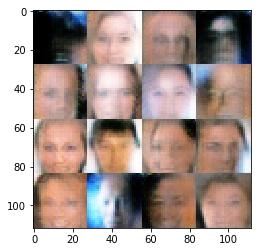

Epoch 1 / 1  D loss:  1.3918 ... G loss:  0.7129 ...
Epoch 1 / 1  D loss:  1.3440 ... G loss:  0.8446 ...
Epoch 1 / 1  D loss:  1.0591 ... G loss:  1.0088 ...
Epoch 1 / 1  D loss:  1.3520 ... G loss:  0.7950 ...
Epoch 1 / 1  D loss:  1.1940 ... G loss:  1.0273 ...
Epoch 1 / 1  D loss:  1.1455 ... G loss:  0.9397 ...
Epoch 1 / 1  D loss:  1.1088 ... G loss:  1.0058 ...
Epoch 1 / 1  D loss:  1.0604 ... G loss:  1.3740 ...
Epoch 1 / 1  D loss:  0.9370 ... G loss:  1.5171 ...
Epoch 1 / 1  D loss:  1.2112 ... G loss:  0.7035 ...
Step:  3100


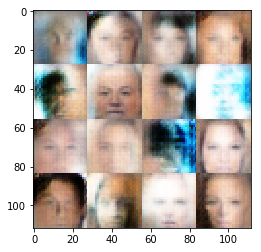

Epoch 1 / 1  D loss:  1.0936 ... G loss:  0.9873 ...
Epoch 1 / 1  D loss:  0.9831 ... G loss:  1.2274 ...
Epoch 1 / 1  D loss:  1.0749 ... G loss:  0.9909 ...
Epoch 1 / 1  D loss:  1.0353 ... G loss:  0.9552 ...
Epoch 1 / 1  D loss:  1.3063 ... G loss:  0.6970 ...
Epoch 1 / 1  D loss:  1.3199 ... G loss:  0.8460 ...
Epoch 1 / 1  D loss:  1.1106 ... G loss:  0.8951 ...


In [43]:
# alpha = .1
net = GAN( data_shape, z_dim, learning_rate, alpha = alpha, beta1 = beta1)
losses = train( net, epoch_count, batch_size, z_dim, 
                celeba_dataset.get_batches, celeba_dataset.image_mode)

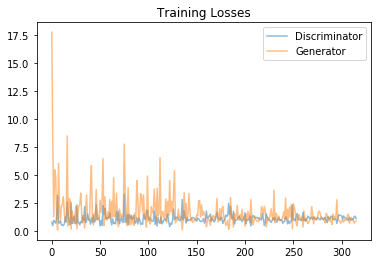

In [44]:
print_losses_chart(losses)

INFO:tensorflow:Restoring parameters from model_checkpoints/genereator.ckpt


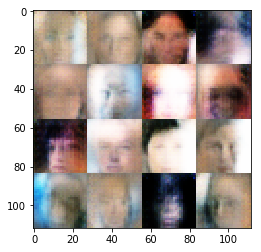

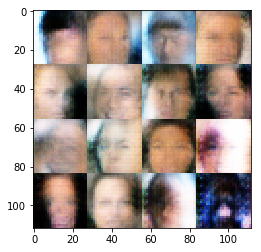

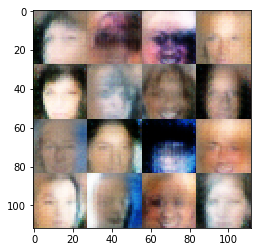

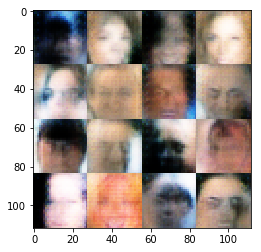

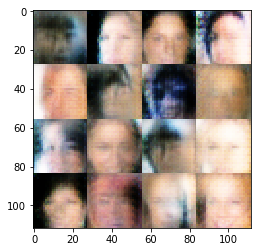

In [45]:
with tf.Session() as sess:
    
    saver = tf.train.Saver()
    saver.restore(sess, "model_checkpoints/genereator.ckpt")
    
    for x in range(5):
        show_generator_output(sess, 20, net.input_z, net.out_channel_dim, 
                                              celeba_dataset.image_mode)

---

Step:  1


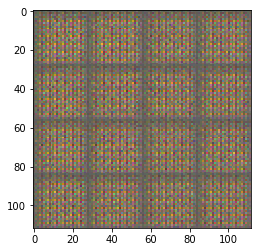

Epoch 1 / 1  D loss:  0.7330 ... G loss:  1.9020 ...
Epoch 1 / 1  D loss:  3.3858 ... G loss:  0.0947 ...
Epoch 1 / 1  D loss:  0.6489 ... G loss:  7.8453 ...
Epoch 1 / 1  D loss:  0.9835 ... G loss:  1.6545 ...
Epoch 1 / 1  D loss:  1.6995 ... G loss:  3.9748 ...
Epoch 1 / 1  D loss:  0.6602 ... G loss:  2.4919 ...
Epoch 1 / 1  D loss:  1.0046 ... G loss:  0.9165 ...
Epoch 1 / 1  D loss:  0.5692 ... G loss:  4.3183 ...
Epoch 1 / 1  D loss:  0.4976 ... G loss:  3.3184 ...
Step:  100


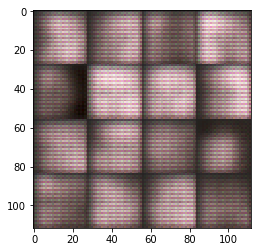

Epoch 1 / 1  D loss:  0.4862 ... G loss:  4.4332 ...
Epoch 1 / 1  D loss:  0.5167 ... G loss:  2.3050 ...
Epoch 1 / 1  D loss:  0.4901 ... G loss:  2.6118 ...
Epoch 1 / 1  D loss:  0.4577 ... G loss:  2.6149 ...
Epoch 1 / 1  D loss:  1.2909 ... G loss:  0.9281 ...
Epoch 1 / 1  D loss:  0.7229 ... G loss:  1.6746 ...
Epoch 1 / 1  D loss:  0.3739 ... G loss:  7.0128 ...
Epoch 1 / 1  D loss:  2.0151 ... G loss:  5.3410 ...
Epoch 1 / 1  D loss:  1.0149 ... G loss:  0.8213 ...
Epoch 1 / 1  D loss:  0.8695 ... G loss:  3.4284 ...
Step:  200


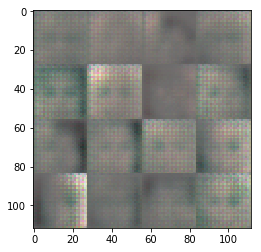

Epoch 1 / 1  D loss:  0.8087 ... G loss:  2.0400 ...
Epoch 1 / 1  D loss:  0.8595 ... G loss:  2.4994 ...
Epoch 1 / 1  D loss:  2.0482 ... G loss:  0.2301 ...
Epoch 1 / 1  D loss:  1.0843 ... G loss:  1.0216 ...
Epoch 1 / 1  D loss:  1.5885 ... G loss:  0.5172 ...
Epoch 1 / 1  D loss:  1.3961 ... G loss:  1.9162 ...
Epoch 1 / 1  D loss:  0.7036 ... G loss:  1.9905 ...
Epoch 1 / 1  D loss:  1.2571 ... G loss:  0.7155 ...
Epoch 1 / 1  D loss:  0.8573 ... G loss:  1.2787 ...
Epoch 1 / 1  D loss:  1.1764 ... G loss:  2.9643 ...
Step:  300


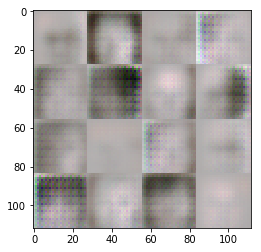

Epoch 1 / 1  D loss:  1.4976 ... G loss:  0.4956 ...
Epoch 1 / 1  D loss:  0.7952 ... G loss:  1.5760 ...
Epoch 1 / 1  D loss:  0.9119 ... G loss:  1.2516 ...
Epoch 1 / 1  D loss:  1.2665 ... G loss:  1.2153 ...
Epoch 1 / 1  D loss:  1.5493 ... G loss:  1.4088 ...
Epoch 1 / 1  D loss:  1.1196 ... G loss:  1.7440 ...
Epoch 1 / 1  D loss:  1.1339 ... G loss:  1.1254 ...
Epoch 1 / 1  D loss:  0.7969 ... G loss:  1.8209 ...
Epoch 1 / 1  D loss:  1.5329 ... G loss:  1.0087 ...
Epoch 1 / 1  D loss:  1.2665 ... G loss:  1.3609 ...
Step:  400


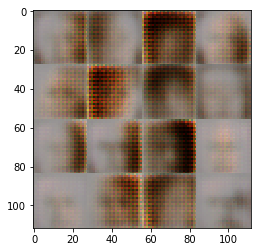

Epoch 1 / 1  D loss:  1.2555 ... G loss:  0.9122 ...
Epoch 1 / 1  D loss:  0.8413 ... G loss:  1.8621 ...
Epoch 1 / 1  D loss:  1.0370 ... G loss:  1.3737 ...
Epoch 1 / 1  D loss:  0.9545 ... G loss:  1.2289 ...
Epoch 1 / 1  D loss:  1.2043 ... G loss:  0.9295 ...
Epoch 1 / 1  D loss:  1.3260 ... G loss:  0.5958 ...
Epoch 1 / 1  D loss:  0.8687 ... G loss:  1.4010 ...
Epoch 1 / 1  D loss:  0.7740 ... G loss:  2.7422 ...
Epoch 1 / 1  D loss:  0.7272 ... G loss:  1.6565 ...
Epoch 1 / 1  D loss:  0.8525 ... G loss:  2.3058 ...
Step:  500


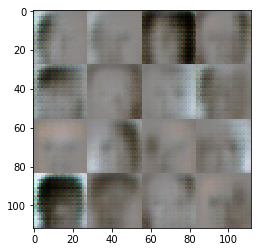

Epoch 1 / 1  D loss:  0.7096 ... G loss:  1.8743 ...
Epoch 1 / 1  D loss:  0.6808 ... G loss:  7.1652 ...
Epoch 1 / 1  D loss:  0.7063 ... G loss:  4.1541 ...
Epoch 1 / 1  D loss:  0.8298 ... G loss:  1.6838 ...
Epoch 1 / 1  D loss:  0.8277 ... G loss:  1.3059 ...
Epoch 1 / 1  D loss:  1.3836 ... G loss:  1.1868 ...
Epoch 1 / 1  D loss:  0.6341 ... G loss:  1.7528 ...
Epoch 1 / 1  D loss:  0.7739 ... G loss:  3.2483 ...
Epoch 1 / 1  D loss:  0.7333 ... G loss:  1.3949 ...
Epoch 1 / 1  D loss:  0.7481 ... G loss:  1.7473 ...
Step:  600


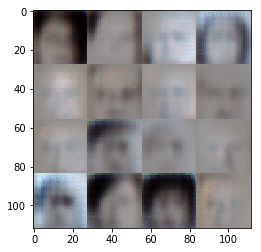

Epoch 1 / 1  D loss:  0.7667 ... G loss:  1.7115 ...
Epoch 1 / 1  D loss:  1.6756 ... G loss:  0.4909 ...
Epoch 1 / 1  D loss:  1.2030 ... G loss:  0.6895 ...
Epoch 1 / 1  D loss:  0.9156 ... G loss:  1.7746 ...
Epoch 1 / 1  D loss:  0.7010 ... G loss:  1.4781 ...
Epoch 1 / 1  D loss:  2.0589 ... G loss:  0.2300 ...
Epoch 1 / 1  D loss:  0.5035 ... G loss:  3.0930 ...
Epoch 1 / 1  D loss:  0.8346 ... G loss:  1.1426 ...
Epoch 1 / 1  D loss:  0.4962 ... G loss:  2.3712 ...
Epoch 1 / 1  D loss:  0.5706 ... G loss:  2.1199 ...
Step:  700


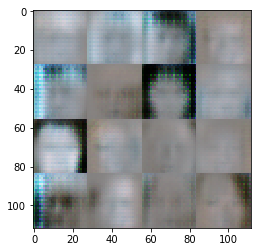

Epoch 1 / 1  D loss:  0.4896 ... G loss:  5.9815 ...
Epoch 1 / 1  D loss:  1.1963 ... G loss:  2.3964 ...
Epoch 1 / 1  D loss:  1.0099 ... G loss:  1.0737 ...
Epoch 1 / 1  D loss:  1.2395 ... G loss:  0.7710 ...
Epoch 1 / 1  D loss:  0.5532 ... G loss:  2.4831 ...
Epoch 1 / 1  D loss:  0.6820 ... G loss:  1.9824 ...
Epoch 1 / 1  D loss:  0.5900 ... G loss:  2.0816 ...
Epoch 1 / 1  D loss:  0.4761 ... G loss:  2.5366 ...
Epoch 1 / 1  D loss:  0.9535 ... G loss:  1.2998 ...
Epoch 1 / 1  D loss:  1.1804 ... G loss:  0.7884 ...


In [38]:
# alpha = .3
net = GAN( data_shape, z_dim, learning_rate, alpha = alpha, beta1 = beta1)
losses = train( net, epoch_count, batch_size, z_dim, 
                celeba_dataset.get_batches, celeba_dataset.image_mode)

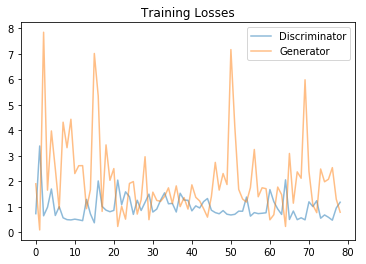

In [39]:
print_losses_chart(losses)

INFO:tensorflow:Restoring parameters from model_checkpoints/genereator.ckpt


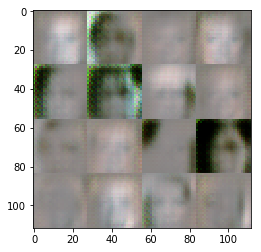

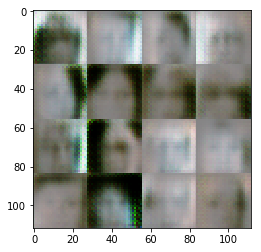

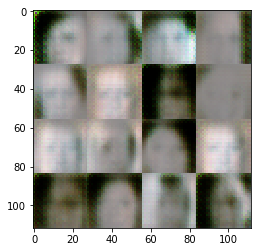

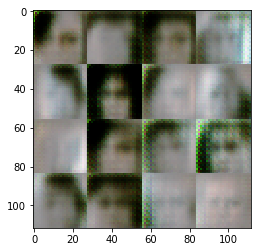

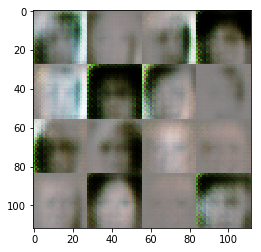

In [41]:
with tf.Session() as sess:
    
    saver = tf.train.Saver()
    saver.restore(sess, "model_checkpoints/genereator.ckpt")
    
    for x in range(5):
        show_generator_output(sess, 20, net.input_z, net.out_channel_dim, 
                                              celeba_dataset.image_mode)

---

Step:  1


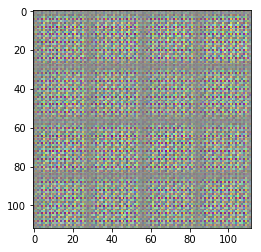

Epoch 1 / 1  D loss:  1.1900 ... G loss:  19.6276 ...
Epoch 1 / 1  D loss:  0.6755 ... G loss:  20.9097 ...
Epoch 1 / 1  D loss:  2.1931 ... G loss:  0.2612 ...
Epoch 1 / 1  D loss:  0.9665 ... G loss:  1.8241 ...
Epoch 1 / 1  D loss:  0.6638 ... G loss:  2.6659 ...
Epoch 1 / 1  D loss:  0.7212 ... G loss:  6.0235 ...
Epoch 1 / 1  D loss:  0.8785 ... G loss:  1.5817 ...
Epoch 1 / 1  D loss:  0.5246 ... G loss:  3.0688 ...
Epoch 1 / 1  D loss:  0.5475 ... G loss:  3.0158 ...
Step:  100


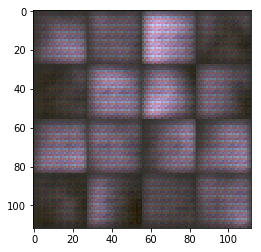

Epoch 1 / 1  D loss:  0.5123 ... G loss:  2.7281 ...
Epoch 1 / 1  D loss:  0.5636 ... G loss:  1.9404 ...
Epoch 1 / 1  D loss:  1.0828 ... G loss:  0.9111 ...
Epoch 1 / 1  D loss:  0.5498 ... G loss:  1.8309 ...
Epoch 1 / 1  D loss:  1.1609 ... G loss:  0.9406 ...
Epoch 1 / 1  D loss:  0.4328 ... G loss:  3.1878 ...
Epoch 1 / 1  D loss:  1.2227 ... G loss:  7.4211 ...
Epoch 1 / 1  D loss:  0.9680 ... G loss:  4.9453 ...
Epoch 1 / 1  D loss:  0.6671 ... G loss:  3.5641 ...
Epoch 1 / 1  D loss:  0.7217 ... G loss:  1.4956 ...
Step:  200


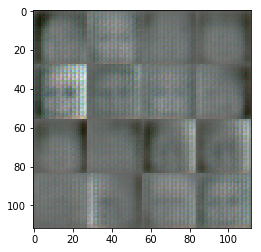

Epoch 1 / 1  D loss:  1.4093 ... G loss:  0.5879 ...
Epoch 1 / 1  D loss:  0.8807 ... G loss:  1.4255 ...
Epoch 1 / 1  D loss:  2.7203 ... G loss:  6.5603 ...
Epoch 1 / 1  D loss:  0.7555 ... G loss:  1.9120 ...
Epoch 1 / 1  D loss:  4.4284 ... G loss:  0.0184 ...
Epoch 1 / 1  D loss:  1.1485 ... G loss:  1.2367 ...
Epoch 1 / 1  D loss:  0.6757 ... G loss:  2.6919 ...
Epoch 1 / 1  D loss:  0.7798 ... G loss:  2.4397 ...
Epoch 1 / 1  D loss:  1.2064 ... G loss:  1.4042 ...
Epoch 1 / 1  D loss:  1.6801 ... G loss:  0.4866 ...
Step:  300


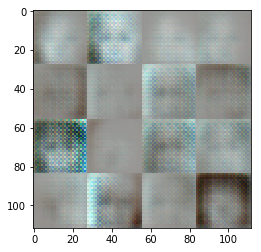

Epoch 1 / 1  D loss:  1.2205 ... G loss:  0.6932 ...
Epoch 1 / 1  D loss:  1.0491 ... G loss:  0.8548 ...
Epoch 1 / 1  D loss:  1.3796 ... G loss:  0.5644 ...
Epoch 1 / 1  D loss:  0.7691 ... G loss:  2.0925 ...
Epoch 1 / 1  D loss:  1.1672 ... G loss:  1.6337 ...
Epoch 1 / 1  D loss:  1.0019 ... G loss:  1.0627 ...
Epoch 1 / 1  D loss:  1.3157 ... G loss:  0.6434 ...
Epoch 1 / 1  D loss:  1.1502 ... G loss:  1.2189 ...
Epoch 1 / 1  D loss:  1.5190 ... G loss:  1.4047 ...
Epoch 1 / 1  D loss:  1.3655 ... G loss:  1.4650 ...
Step:  400


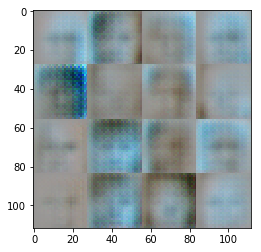

Epoch 1 / 1  D loss:  1.1095 ... G loss:  1.9696 ...
Epoch 1 / 1  D loss:  1.0351 ... G loss:  1.9476 ...
Epoch 1 / 1  D loss:  1.0243 ... G loss:  3.9883 ...
Epoch 1 / 1  D loss:  0.6010 ... G loss:  3.8063 ...
Epoch 1 / 1  D loss:  1.3814 ... G loss:  0.5580 ...
Epoch 1 / 1  D loss:  0.7937 ... G loss:  1.3150 ...
Epoch 1 / 1  D loss:  0.5891 ... G loss:  2.3843 ...
Epoch 1 / 1  D loss:  0.5674 ... G loss:  2.2820 ...
Epoch 1 / 1  D loss:  0.9822 ... G loss:  0.9518 ...
Epoch 1 / 1  D loss:  0.8740 ... G loss:  1.3397 ...
Step:  500


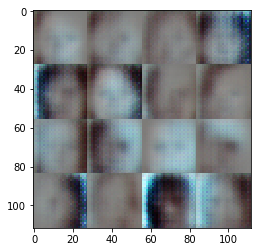

Epoch 1 / 1  D loss:  1.2601 ... G loss:  2.6102 ...
Epoch 1 / 1  D loss:  0.5175 ... G loss:  4.8277 ...
Epoch 1 / 1  D loss:  0.9365 ... G loss:  2.0169 ...
Epoch 1 / 1  D loss:  0.8644 ... G loss:  1.0987 ...
Epoch 1 / 1  D loss:  1.1215 ... G loss:  2.0133 ...
Epoch 1 / 1  D loss:  0.8080 ... G loss:  1.6252 ...
Epoch 1 / 1  D loss:  1.0333 ... G loss:  1.6336 ...
Epoch 1 / 1  D loss:  0.7418 ... G loss:  1.5143 ...
Epoch 1 / 1  D loss:  1.5034 ... G loss:  2.7709 ...
Epoch 1 / 1  D loss:  0.6998 ... G loss:  1.8222 ...
Step:  600


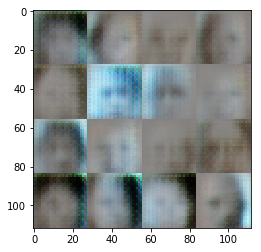

Epoch 1 / 1  D loss:  0.7563 ... G loss:  4.4245 ...
Epoch 1 / 1  D loss:  5.5054 ... G loss:  13.8676 ...
Epoch 1 / 1  D loss:  1.4360 ... G loss:  0.8781 ...
Epoch 1 / 1  D loss:  1.0637 ... G loss:  1.8082 ...
Epoch 1 / 1  D loss:  0.8215 ... G loss:  1.2223 ...
Epoch 1 / 1  D loss:  0.8175 ... G loss:  1.1962 ...
Epoch 1 / 1  D loss:  0.6670 ... G loss:  2.1150 ...
Epoch 1 / 1  D loss:  1.2497 ... G loss:  5.4517 ...
Epoch 1 / 1  D loss:  2.1242 ... G loss:  3.6098 ...
Epoch 1 / 1  D loss:  2.3537 ... G loss:  0.5981 ...
Step:  700


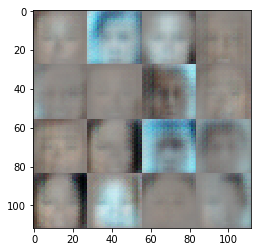

Epoch 1 / 1  D loss:  1.6206 ... G loss:  3.3173 ...
Epoch 1 / 1  D loss:  1.0658 ... G loss:  1.0445 ...
Epoch 1 / 1  D loss:  0.9188 ... G loss:  4.7242 ...
Epoch 1 / 1  D loss:  1.0852 ... G loss:  0.8422 ...
Epoch 1 / 1  D loss:  1.1820 ... G loss:  1.6681 ...
Epoch 1 / 1  D loss:  0.8235 ... G loss:  1.9004 ...
Epoch 1 / 1  D loss:  1.6066 ... G loss:  0.3875 ...
Epoch 1 / 1  D loss:  0.8666 ... G loss:  1.0741 ...
Epoch 1 / 1  D loss:  0.7502 ... G loss:  1.9106 ...
Epoch 1 / 1  D loss:  0.6686 ... G loss:  1.4888 ...


In [22]:
# batch size to 256
# apha .2
net = GAN( data_shape, z_dim, learning_rate, alpha = alpha, beta1 = beta1)
losses = train( net, epoch_count, batch_size, z_dim, 
                celeba_dataset.get_batches, celeba_dataset.image_mode)

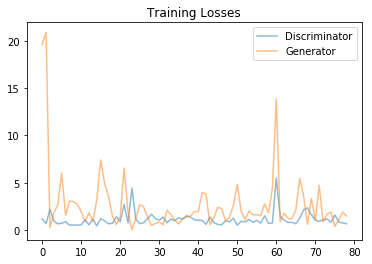

In [23]:
print_losses_chart(losses)

INFO:tensorflow:Restoring parameters from model_checkpoints/genereator.ckpt


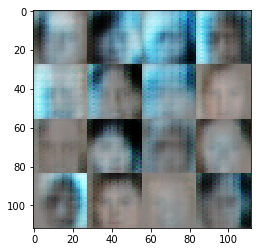

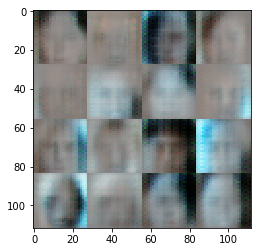

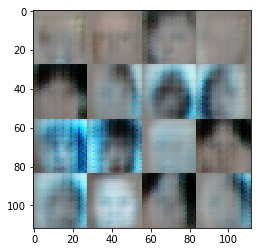

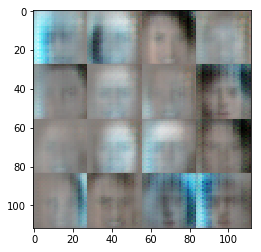

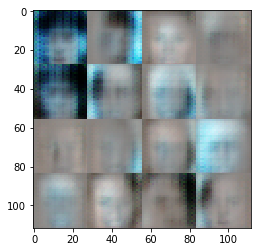

In [25]:
with tf.Session() as sess:
    
    saver = tf.train.Saver()
    saver.restore(sess, "model_checkpoints/genereator.ckpt")
    
    for x in range(5):
        show_generator_output(sess, 20, net.input_z, net.out_channel_dim, 
                                              celeba_dataset.image_mode)

---

Step:  1


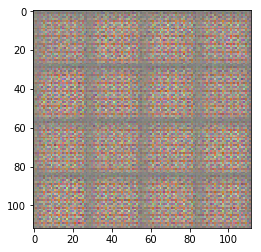

Epoch 1 / 1  D loss:  0.7990 ... G loss:  1.6711 ...
Epoch 1 / 1  D loss:  0.5099 ... G loss:  11.2185 ...
Epoch 1 / 1  D loss:  0.5401 ... G loss:  3.9099 ...
Epoch 1 / 1  D loss:  0.3917 ... G loss:  9.1851 ...
Epoch 1 / 1  D loss:  0.6888 ... G loss:  2.1413 ...
Epoch 1 / 1  D loss:  0.7030 ... G loss:  4.1915 ...
Epoch 1 / 1  D loss:  0.6790 ... G loss:  2.0227 ...
Epoch 1 / 1  D loss:  1.0730 ... G loss:  3.4638 ...
Epoch 1 / 1  D loss:  0.6140 ... G loss:  2.8627 ...
Step:  100


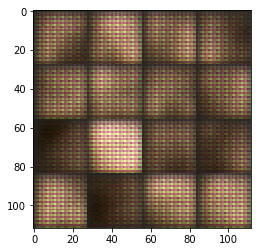

Epoch 1 / 1  D loss:  0.4911 ... G loss:  3.5134 ...
Epoch 1 / 1  D loss:  0.5396 ... G loss:  2.2298 ...
Epoch 1 / 1  D loss:  0.4810 ... G loss:  3.2132 ...
Epoch 1 / 1  D loss:  0.5383 ... G loss:  2.0909 ...
Epoch 1 / 1  D loss:  0.6570 ... G loss:  2.3272 ...
Epoch 1 / 1  D loss:  0.6844 ... G loss:  2.6738 ...
Epoch 1 / 1  D loss:  1.7832 ... G loss:  0.5338 ...
Epoch 1 / 1  D loss:  1.5289 ... G loss:  3.0437 ...
Epoch 1 / 1  D loss:  1.2625 ... G loss:  1.0686 ...
Epoch 1 / 1  D loss:  0.4826 ... G loss:  5.9289 ...
Step:  200


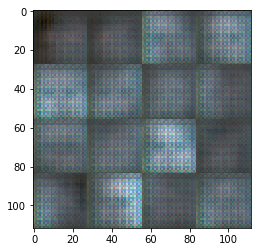

Epoch 1 / 1  D loss:  2.7658 ... G loss:  9.9546 ...
Epoch 1 / 1  D loss:  0.9266 ... G loss:  1.5059 ...
Epoch 1 / 1  D loss:  0.6512 ... G loss:  2.4145 ...
Epoch 1 / 1  D loss:  0.8585 ... G loss:  1.3220 ...
Epoch 1 / 1  D loss:  2.8772 ... G loss:  13.5402 ...
Epoch 1 / 1  D loss:  1.2007 ... G loss:  0.8255 ...
Epoch 1 / 1  D loss:  0.7653 ... G loss:  1.6538 ...
Epoch 1 / 1  D loss:  1.5850 ... G loss:  0.5003 ...
Epoch 1 / 1  D loss:  2.1558 ... G loss:  9.3562 ...
Epoch 1 / 1  D loss:  1.6789 ... G loss:  1.4266 ...
Step:  300


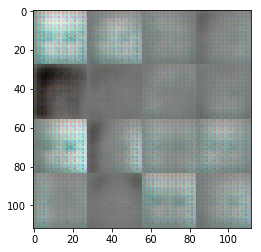

Epoch 1 / 1  D loss:  1.2012 ... G loss:  1.0326 ...
Epoch 1 / 1  D loss:  0.7639 ... G loss:  2.1093 ...
Epoch 1 / 1  D loss:  0.7479 ... G loss:  3.4622 ...
Epoch 1 / 1  D loss:  0.3843 ... G loss:  4.2432 ...
Epoch 1 / 1  D loss:  0.5456 ... G loss:  2.2203 ...
Epoch 1 / 1  D loss:  0.9136 ... G loss:  1.6524 ...
Epoch 1 / 1  D loss:  0.7682 ... G loss:  1.8971 ...
Epoch 1 / 1  D loss:  1.0790 ... G loss:  0.9012 ...
Epoch 1 / 1  D loss:  0.7999 ... G loss:  1.8157 ...
Epoch 1 / 1  D loss:  0.8843 ... G loss:  1.3045 ...
Step:  400


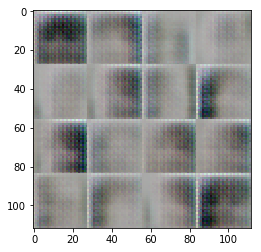

Epoch 1 / 1  D loss:  0.8557 ... G loss:  1.4202 ...
Epoch 1 / 1  D loss:  1.0079 ... G loss:  1.6964 ...
Epoch 1 / 1  D loss:  0.6187 ... G loss:  2.2499 ...
Epoch 1 / 1  D loss:  0.6054 ... G loss:  1.6361 ...
Epoch 1 / 1  D loss:  0.7873 ... G loss:  1.4050 ...
Epoch 1 / 1  D loss:  1.5698 ... G loss:  0.4834 ...
Epoch 1 / 1  D loss:  0.7241 ... G loss:  1.9024 ...
Epoch 1 / 1  D loss:  1.1163 ... G loss:  1.5615 ...
Epoch 1 / 1  D loss:  0.9541 ... G loss:  1.4535 ...
Epoch 1 / 1  D loss:  1.0909 ... G loss:  1.9539 ...
Step:  500


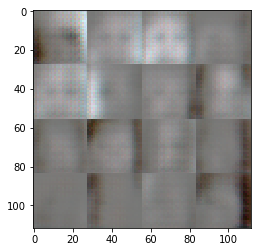

Epoch 1 / 1  D loss:  0.7498 ... G loss:  1.9686 ...
Epoch 1 / 1  D loss:  0.9206 ... G loss:  1.7037 ...
Epoch 1 / 1  D loss:  0.5660 ... G loss:  3.4496 ...
Epoch 1 / 1  D loss:  0.6071 ... G loss:  2.0338 ...
Epoch 1 / 1  D loss:  0.9007 ... G loss:  3.1073 ...
Epoch 1 / 1  D loss:  0.4016 ... G loss:  4.5170 ...
Epoch 1 / 1  D loss:  1.3160 ... G loss:  0.6477 ...
Epoch 1 / 1  D loss:  1.5893 ... G loss:  0.4301 ...
Epoch 1 / 1  D loss:  1.0627 ... G loss:  1.0247 ...
Epoch 1 / 1  D loss:  2.4974 ... G loss:  0.1542 ...
Step:  600


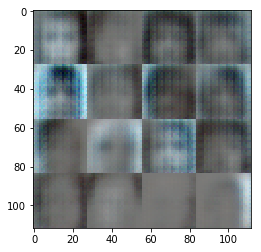

Epoch 1 / 1  D loss:  1.3113 ... G loss:  1.3011 ...
Epoch 1 / 1  D loss:  0.6390 ... G loss:  2.3000 ...
Epoch 1 / 1  D loss:  0.5024 ... G loss:  2.0501 ...
Epoch 1 / 1  D loss:  0.7925 ... G loss:  1.2680 ...
Epoch 1 / 1  D loss:  0.7429 ... G loss:  1.7636 ...
Epoch 1 / 1  D loss:  1.0036 ... G loss:  1.0003 ...
Epoch 1 / 1  D loss:  0.5897 ... G loss:  2.0110 ...
Epoch 1 / 1  D loss:  0.8629 ... G loss:  1.9589 ...
Epoch 1 / 1  D loss:  1.2509 ... G loss:  0.6742 ...
Epoch 1 / 1  D loss:  0.8174 ... G loss:  1.1917 ...
Step:  700


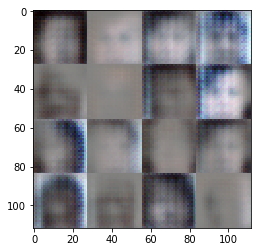

Epoch 1 / 1  D loss:  1.0074 ... G loss:  1.5793 ...
Epoch 1 / 1  D loss:  0.9916 ... G loss:  1.7938 ...
Epoch 1 / 1  D loss:  2.1077 ... G loss:  0.2479 ...
Epoch 1 / 1  D loss:  1.1331 ... G loss:  1.2049 ...
Epoch 1 / 1  D loss:  0.6415 ... G loss:  1.6547 ...
Epoch 1 / 1  D loss:  1.0625 ... G loss:  1.0510 ...
Epoch 1 / 1  D loss:  0.8418 ... G loss:  1.6271 ...
Epoch 1 / 1  D loss:  1.0747 ... G loss:  0.9666 ...
Epoch 1 / 1  D loss:  1.1069 ... G loss:  0.8161 ...
Epoch 1 / 1  D loss:  1.2276 ... G loss:  0.7100 ...
Step:  800


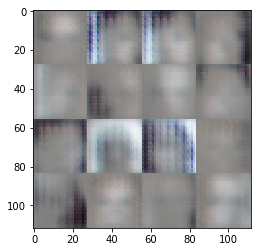

Epoch 1 / 1  D loss:  1.0971 ... G loss:  0.7114 ...
Epoch 1 / 1  D loss:  0.6414 ... G loss:  2.7311 ...
Epoch 1 / 1  D loss:  0.6565 ... G loss:  1.8848 ...
Epoch 1 / 1  D loss:  1.6357 ... G loss:  0.4338 ...
Epoch 1 / 1  D loss:  0.5401 ... G loss:  2.0822 ...
Epoch 1 / 1  D loss:  0.7383 ... G loss:  1.5065 ...
Epoch 1 / 1  D loss:  0.8350 ... G loss:  1.5105 ...
Epoch 1 / 1  D loss:  0.9029 ... G loss:  1.1188 ...
Epoch 1 / 1  D loss:  0.8135 ... G loss:  1.6583 ...
Epoch 1 / 1  D loss:  0.8701 ... G loss:  1.2050 ...
Step:  900


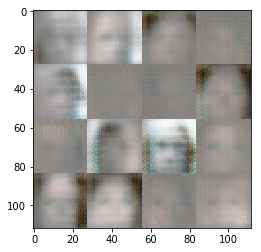

Epoch 1 / 1  D loss:  2.0886 ... G loss:  0.2488 ...
Epoch 1 / 1  D loss:  5.0725 ... G loss:  0.0091 ...
Epoch 1 / 1  D loss:  3.1492 ... G loss:  4.6588 ...
Epoch 1 / 1  D loss:  1.0507 ... G loss:  1.1072 ...
Epoch 1 / 1  D loss:  0.5939 ... G loss:  1.9728 ...
Epoch 1 / 1  D loss:  0.7116 ... G loss:  4.6199 ...
Epoch 1 / 1  D loss:  0.8312 ... G loss:  1.8075 ...
Epoch 1 / 1  D loss:  0.8551 ... G loss:  1.4475 ...
Epoch 1 / 1  D loss:  0.5527 ... G loss:  2.4618 ...
Epoch 1 / 1  D loss:  0.9035 ... G loss:  3.1552 ...
Step:  1000


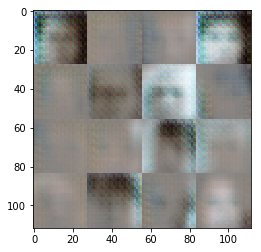

Epoch 1 / 1  D loss:  0.6645 ... G loss:  1.8037 ...
Epoch 1 / 1  D loss:  1.0803 ... G loss:  0.7947 ...
Epoch 1 / 1  D loss:  1.1231 ... G loss:  3.2081 ...
Epoch 1 / 1  D loss:  1.0275 ... G loss:  1.7645 ...
Epoch 1 / 1  D loss:  1.0716 ... G loss:  0.7462 ...
Epoch 1 / 1  D loss:  0.7596 ... G loss:  1.9622 ...
Epoch 1 / 1  D loss:  0.7517 ... G loss:  1.4615 ...
Epoch 1 / 1  D loss:  0.7327 ... G loss:  1.6775 ...
Epoch 1 / 1  D loss:  1.2534 ... G loss:  0.6908 ...
Epoch 1 / 1  D loss:  1.2515 ... G loss:  0.7456 ...
Step:  1100


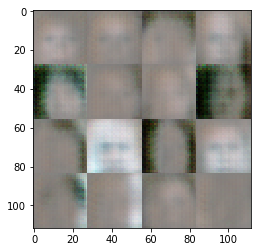

Epoch 1 / 1  D loss:  1.1303 ... G loss:  2.2796 ...
Epoch 1 / 1  D loss:  1.5001 ... G loss:  2.5569 ...
Epoch 1 / 1  D loss:  0.8725 ... G loss:  1.7039 ...
Epoch 1 / 1  D loss:  1.0455 ... G loss:  0.7538 ...
Epoch 1 / 1  D loss:  1.2672 ... G loss:  0.6576 ...
Epoch 1 / 1  D loss:  0.8565 ... G loss:  1.5638 ...
Epoch 1 / 1  D loss:  0.6131 ... G loss:  4.6009 ...
Epoch 1 / 1  D loss:  1.4608 ... G loss:  0.7887 ...
Epoch 1 / 1  D loss:  1.4526 ... G loss:  0.5015 ...
Epoch 1 / 1  D loss:  0.9283 ... G loss:  1.4483 ...
Step:  1200


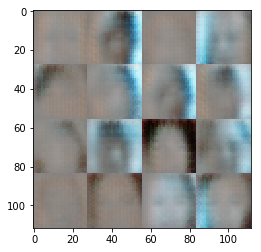

Epoch 1 / 1  D loss:  0.8974 ... G loss:  1.6321 ...
Epoch 1 / 1  D loss:  1.0164 ... G loss:  1.2737 ...
Epoch 1 / 1  D loss:  1.6399 ... G loss:  2.2351 ...
Epoch 1 / 1  D loss:  0.7758 ... G loss:  1.4759 ...
Epoch 1 / 1  D loss:  1.0764 ... G loss:  1.5906 ...
Epoch 1 / 1  D loss:  0.8577 ... G loss:  1.7888 ...
Epoch 1 / 1  D loss:  0.9359 ... G loss:  1.0787 ...
Epoch 1 / 1  D loss:  1.1255 ... G loss:  2.1549 ...
Epoch 1 / 1  D loss:  1.5510 ... G loss:  5.4217 ...
Epoch 1 / 1  D loss:  0.9991 ... G loss:  0.9776 ...
Step:  1300


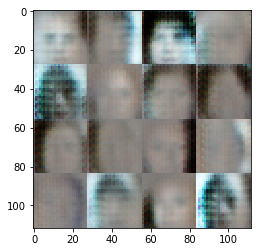

Epoch 1 / 1  D loss:  1.6292 ... G loss:  0.4183 ...
Epoch 1 / 1  D loss:  0.8090 ... G loss:  2.6351 ...
Epoch 1 / 1  D loss:  0.8470 ... G loss:  1.3726 ...
Epoch 1 / 1  D loss:  0.7451 ... G loss:  1.6110 ...
Epoch 1 / 1  D loss:  0.5119 ... G loss:  2.9364 ...
Epoch 1 / 1  D loss:  1.1375 ... G loss:  1.8776 ...
Epoch 1 / 1  D loss:  2.2999 ... G loss:  3.1275 ...
Epoch 1 / 1  D loss:  1.0689 ... G loss:  1.5031 ...
Epoch 1 / 1  D loss:  0.8389 ... G loss:  1.4963 ...
Epoch 1 / 1  D loss:  0.7717 ... G loss:  1.6797 ...
Step:  1400


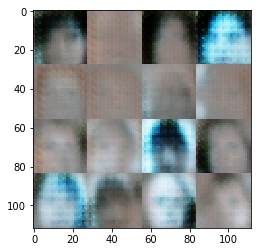

Epoch 1 / 1  D loss:  1.3151 ... G loss:  4.4913 ...
Epoch 1 / 1  D loss:  0.8784 ... G loss:  1.5237 ...
Epoch 1 / 1  D loss:  1.1322 ... G loss:  0.9649 ...
Epoch 1 / 1  D loss:  1.2103 ... G loss:  0.8578 ...
Epoch 1 / 1  D loss:  0.9159 ... G loss:  1.1744 ...
Epoch 1 / 1  D loss:  1.1628 ... G loss:  1.2958 ...
Epoch 1 / 1  D loss:  1.0595 ... G loss:  0.7981 ...
Epoch 1 / 1  D loss:  1.2597 ... G loss:  0.7681 ...
Epoch 1 / 1  D loss:  0.9486 ... G loss:  1.0434 ...
Epoch 1 / 1  D loss:  1.0110 ... G loss:  1.3557 ...
Step:  1500


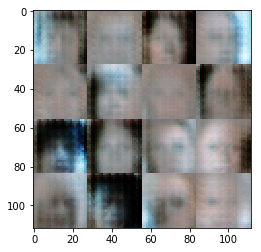

Epoch 1 / 1  D loss:  0.9522 ... G loss:  1.2190 ...
Epoch 1 / 1  D loss:  1.6625 ... G loss:  4.4203 ...
Epoch 1 / 1  D loss:  4.0590 ... G loss:  12.8860 ...
Epoch 1 / 1  D loss:  0.8266 ... G loss:  1.4283 ...
Epoch 1 / 1  D loss:  1.2190 ... G loss:  0.7529 ...
Epoch 1 / 1  D loss:  1.2756 ... G loss:  1.1432 ...
Epoch 1 / 1  D loss:  1.0486 ... G loss:  1.2721 ...
Epoch 1 / 1  D loss:  1.2871 ... G loss:  1.0290 ...
Epoch 1 / 1  D loss:  0.9902 ... G loss:  1.1887 ...
Epoch 1 / 1  D loss:  1.2308 ... G loss:  1.2126 ...
Step:  1600


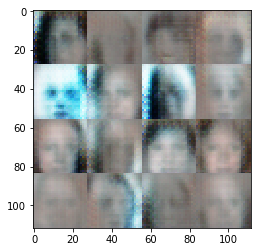

Epoch 1 / 1  D loss:  0.8477 ... G loss:  1.3812 ...
Epoch 1 / 1  D loss:  1.1893 ... G loss:  0.9084 ...
Epoch 1 / 1  D loss:  0.9056 ... G loss:  1.7084 ...
Epoch 1 / 1  D loss:  0.3935 ... G loss:  4.1097 ...
Epoch 1 / 1  D loss:  0.7812 ... G loss:  1.3471 ...
Epoch 1 / 1  D loss:  0.9160 ... G loss:  1.3378 ...
Epoch 1 / 1  D loss:  1.0713 ... G loss:  1.2826 ...
Epoch 1 / 1  D loss:  0.8855 ... G loss:  2.2350 ...
Epoch 1 / 1  D loss:  0.5549 ... G loss:  3.3313 ...
Epoch 1 / 1  D loss:  0.9133 ... G loss:  2.1066 ...
Step:  1700


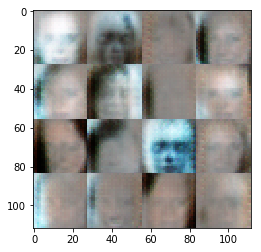

Epoch 1 / 1  D loss:  1.1097 ... G loss:  0.8413 ...
Epoch 1 / 1  D loss:  0.9553 ... G loss:  1.0922 ...
Epoch 1 / 1  D loss:  1.0042 ... G loss:  1.9240 ...
Epoch 1 / 1  D loss:  1.3111 ... G loss:  1.9386 ...
Epoch 1 / 1  D loss:  0.5869 ... G loss:  1.8881 ...
Epoch 1 / 1  D loss:  1.0450 ... G loss:  1.4506 ...
Epoch 1 / 1  D loss:  2.8532 ... G loss:  4.5390 ...
Epoch 1 / 1  D loss:  1.0908 ... G loss:  1.4961 ...
Epoch 1 / 1  D loss:  1.8166 ... G loss:  0.4270 ...
Epoch 1 / 1  D loss:  1.1541 ... G loss:  1.7126 ...
Step:  1800


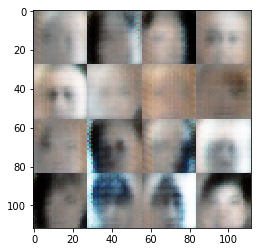

Epoch 1 / 1  D loss:  0.9321 ... G loss:  1.0461 ...
Epoch 1 / 1  D loss:  0.7365 ... G loss:  1.6305 ...
Epoch 1 / 1  D loss:  0.7457 ... G loss:  1.8267 ...
Epoch 1 / 1  D loss:  1.1639 ... G loss:  0.7205 ...
Epoch 1 / 1  D loss:  1.1942 ... G loss:  0.6648 ...
Epoch 1 / 1  D loss:  0.9083 ... G loss:  0.9847 ...
Epoch 1 / 1  D loss:  0.7729 ... G loss:  1.4299 ...
Epoch 1 / 1  D loss:  0.4543 ... G loss:  4.4098 ...
Epoch 1 / 1  D loss:  1.0694 ... G loss:  1.1579 ...
Epoch 1 / 1  D loss:  0.6466 ... G loss:  2.3730 ...
Step:  1900


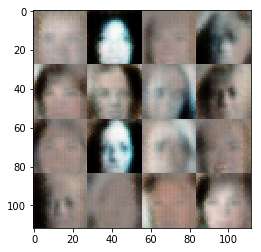

Epoch 1 / 1  D loss:  0.7199 ... G loss:  1.7267 ...
Epoch 1 / 1  D loss:  0.8969 ... G loss:  1.5781 ...
Epoch 1 / 1  D loss:  1.9714 ... G loss:  0.2526 ...
Epoch 1 / 1  D loss:  1.0385 ... G loss:  1.2064 ...
Epoch 1 / 1  D loss:  0.8789 ... G loss:  2.3960 ...
Epoch 1 / 1  D loss:  1.2594 ... G loss:  1.8171 ...
Epoch 1 / 1  D loss:  0.8485 ... G loss:  1.3513 ...
Epoch 1 / 1  D loss:  0.8658 ... G loss:  1.1255 ...
Epoch 1 / 1  D loss:  1.0288 ... G loss:  3.1700 ...
Epoch 1 / 1  D loss:  1.2028 ... G loss:  1.0710 ...
Step:  2000


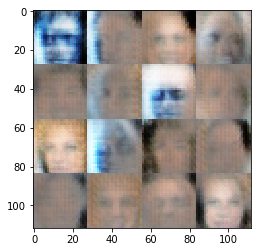

Epoch 1 / 1  D loss:  1.0930 ... G loss:  0.9845 ...
Epoch 1 / 1  D loss:  1.4020 ... G loss:  1.0158 ...
Epoch 1 / 1  D loss:  0.9709 ... G loss:  1.3495 ...
Epoch 1 / 1  D loss:  1.4438 ... G loss:  0.5890 ...
Epoch 1 / 1  D loss:  0.8945 ... G loss:  1.4249 ...
Epoch 1 / 1  D loss:  0.8793 ... G loss:  1.2082 ...
Epoch 1 / 1  D loss:  0.9515 ... G loss:  1.1697 ...
Epoch 1 / 1  D loss:  0.5570 ... G loss:  1.9200 ...
Epoch 1 / 1  D loss:  0.8406 ... G loss:  1.4977 ...
Epoch 1 / 1  D loss:  1.7598 ... G loss:  0.3360 ...
Step:  2100


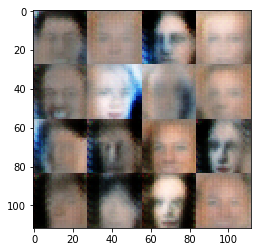

Epoch 1 / 1  D loss:  1.0786 ... G loss:  1.5505 ...
Epoch 1 / 1  D loss:  0.9774 ... G loss:  1.1646 ...
Epoch 1 / 1  D loss:  1.5805 ... G loss:  7.4381 ...
Epoch 1 / 1  D loss:  0.7388 ... G loss:  1.9509 ...
Epoch 1 / 1  D loss:  1.2209 ... G loss:  1.0103 ...
Epoch 1 / 1  D loss:  1.2107 ... G loss:  0.8638 ...
Epoch 1 / 1  D loss:  0.6036 ... G loss:  2.0404 ...
Epoch 1 / 1  D loss:  0.7600 ... G loss:  1.4589 ...
Epoch 1 / 1  D loss:  0.9354 ... G loss:  0.9778 ...
Epoch 1 / 1  D loss:  0.8448 ... G loss:  1.1905 ...
Step:  2200


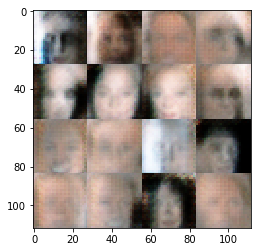

Epoch 1 / 1  D loss:  0.8894 ... G loss:  1.1441 ...
Epoch 1 / 1  D loss:  1.8055 ... G loss:  0.3534 ...
Epoch 1 / 1  D loss:  0.9493 ... G loss:  1.3796 ...
Epoch 1 / 1  D loss:  1.0800 ... G loss:  0.8704 ...
Epoch 1 / 1  D loss:  1.0572 ... G loss:  2.0158 ...
Epoch 1 / 1  D loss:  1.0987 ... G loss:  1.9878 ...
Epoch 1 / 1  D loss:  0.8847 ... G loss:  1.2087 ...
Epoch 1 / 1  D loss:  0.8918 ... G loss:  1.3863 ...
Epoch 1 / 1  D loss:  0.6940 ... G loss:  1.8577 ...
Epoch 1 / 1  D loss:  0.7290 ... G loss:  1.5104 ...
Step:  2300


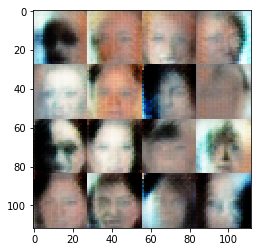

Epoch 1 / 1  D loss:  0.3842 ... G loss:  3.4776 ...
Epoch 1 / 1  D loss:  0.6729 ... G loss:  2.4049 ...
Epoch 1 / 1  D loss:  0.8277 ... G loss:  1.6310 ...
Epoch 1 / 1  D loss:  0.3707 ... G loss:  5.8360 ...
Epoch 1 / 1  D loss:  0.9994 ... G loss:  0.8530 ...
Epoch 1 / 1  D loss:  1.0788 ... G loss:  0.9855 ...
Epoch 1 / 1  D loss:  1.5322 ... G loss:  8.1256 ...
Epoch 1 / 1  D loss:  0.7010 ... G loss:  1.6635 ...
Epoch 1 / 1  D loss:  1.0962 ... G loss:  0.7775 ...
Epoch 1 / 1  D loss:  0.8024 ... G loss:  1.7450 ...
Step:  2400


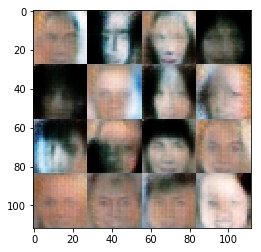

Epoch 1 / 1  D loss:  0.9618 ... G loss:  1.7032 ...
Epoch 1 / 1  D loss:  1.1755 ... G loss:  0.7714 ...
Epoch 1 / 1  D loss:  1.0925 ... G loss:  1.9418 ...
Epoch 1 / 1  D loss:  0.8350 ... G loss:  2.2848 ...
Epoch 1 / 1  D loss:  0.9825 ... G loss:  1.0217 ...
Epoch 1 / 1  D loss:  0.6956 ... G loss:  2.1398 ...
Epoch 1 / 1  D loss:  0.7809 ... G loss:  1.3179 ...
Epoch 1 / 1  D loss:  3.3175 ... G loss:  4.4762 ...
Epoch 1 / 1  D loss:  0.9838 ... G loss:  1.2584 ...
Epoch 1 / 1  D loss:  0.9552 ... G loss:  2.7927 ...
Step:  2500


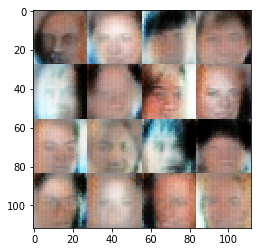

Epoch 1 / 1  D loss:  0.8322 ... G loss:  1.1628 ...
Epoch 1 / 1  D loss:  0.5409 ... G loss:  3.0471 ...
Epoch 1 / 1  D loss:  0.7505 ... G loss:  1.4260 ...
Epoch 1 / 1  D loss:  0.7902 ... G loss:  1.3059 ...
Epoch 1 / 1  D loss:  0.5301 ... G loss:  2.2776 ...
Epoch 1 / 1  D loss:  0.9869 ... G loss:  2.1573 ...
Epoch 1 / 1  D loss:  1.1843 ... G loss:  1.7065 ...
Epoch 1 / 1  D loss:  0.5659 ... G loss:  1.8614 ...
Epoch 1 / 1  D loss:  2.0444 ... G loss:  4.0470 ...
Epoch 1 / 1  D loss:  0.6095 ... G loss:  1.7879 ...
Step:  2600


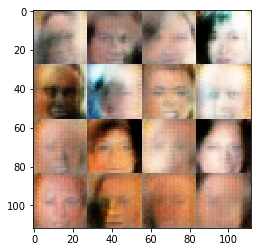

Epoch 1 / 1  D loss:  1.3589 ... G loss:  0.5621 ...
Epoch 1 / 1  D loss:  0.9394 ... G loss:  1.5395 ...
Epoch 1 / 1  D loss:  1.0733 ... G loss:  0.8166 ...
Epoch 1 / 1  D loss:  0.5705 ... G loss:  2.1498 ...
Epoch 1 / 1  D loss:  1.5434 ... G loss:  3.5075 ...
Epoch 1 / 1  D loss:  0.7024 ... G loss:  1.6343 ...
Epoch 1 / 1  D loss:  0.7992 ... G loss:  1.8579 ...
Epoch 1 / 1  D loss:  0.6878 ... G loss:  2.2757 ...
Epoch 1 / 1  D loss:  0.5370 ... G loss:  3.5490 ...
Epoch 1 / 1  D loss:  0.7103 ... G loss:  1.3653 ...
Step:  2700


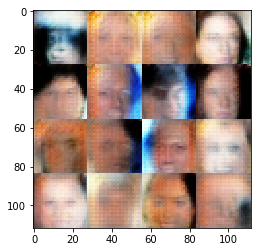

Epoch 1 / 1  D loss:  0.3643 ... G loss:  5.7520 ...
Epoch 1 / 1  D loss:  0.4840 ... G loss:  2.7930 ...
Epoch 1 / 1  D loss:  0.9110 ... G loss:  1.0526 ...
Epoch 1 / 1  D loss:  1.2178 ... G loss:  0.6731 ...
Epoch 1 / 1  D loss:  0.3721 ... G loss:  5.8004 ...
Epoch 1 / 1  D loss:  1.4799 ... G loss:  13.0196 ...
Epoch 1 / 1  D loss:  0.9944 ... G loss:  1.1725 ...
Epoch 1 / 1  D loss:  1.6016 ... G loss:  3.9810 ...
Epoch 1 / 1  D loss:  1.1004 ... G loss:  0.7806 ...
Epoch 1 / 1  D loss:  0.4864 ... G loss:  2.5100 ...
Step:  2800


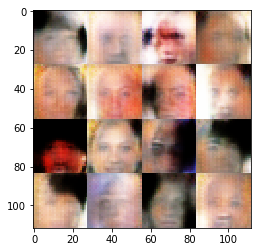

Epoch 1 / 1  D loss:  0.9162 ... G loss:  1.0271 ...
Epoch 1 / 1  D loss:  0.6888 ... G loss:  2.3678 ...
Epoch 1 / 1  D loss:  1.0080 ... G loss:  0.9182 ...
Epoch 1 / 1  D loss:  1.0417 ... G loss:  0.8742 ...
Epoch 1 / 1  D loss:  1.2901 ... G loss:  0.6123 ...
Epoch 1 / 1  D loss:  1.1119 ... G loss:  0.7461 ...
Epoch 1 / 1  D loss:  0.6426 ... G loss:  2.7588 ...
Epoch 1 / 1  D loss:  1.0439 ... G loss:  0.8714 ...
Epoch 1 / 1  D loss:  0.4833 ... G loss:  3.4338 ...
Epoch 1 / 1  D loss:  0.9058 ... G loss:  2.1899 ...
Step:  2900


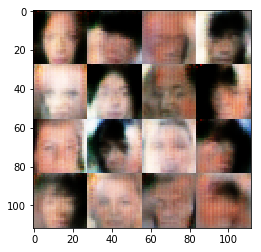

Epoch 1 / 1  D loss:  1.1929 ... G loss:  1.0832 ...
Epoch 1 / 1  D loss:  1.1229 ... G loss:  3.1599 ...
Epoch 1 / 1  D loss:  0.8957 ... G loss:  1.3009 ...
Epoch 1 / 1  D loss:  1.2659 ... G loss:  2.2444 ...
Epoch 1 / 1  D loss:  1.1095 ... G loss:  0.8970 ...
Epoch 1 / 1  D loss:  0.5574 ... G loss:  2.3833 ...
Epoch 1 / 1  D loss:  0.6578 ... G loss:  1.7220 ...
Epoch 1 / 1  D loss:  1.5803 ... G loss:  2.6928 ...
Epoch 1 / 1  D loss:  0.6880 ... G loss:  1.8841 ...
Epoch 1 / 1  D loss:  1.2626 ... G loss:  0.6335 ...
Step:  3000


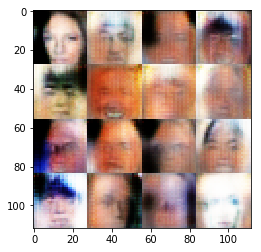

Epoch 1 / 1  D loss:  1.3325 ... G loss:  2.4869 ...
Epoch 1 / 1  D loss:  1.0002 ... G loss:  2.1208 ...
Epoch 1 / 1  D loss:  0.3537 ... G loss:  5.6624 ...
Epoch 1 / 1  D loss:  0.6873 ... G loss:  2.2395 ...
Epoch 1 / 1  D loss:  0.8478 ... G loss:  2.2671 ...
Epoch 1 / 1  D loss:  0.8410 ... G loss:  1.3072 ...
Epoch 1 / 1  D loss:  0.7364 ... G loss:  2.3830 ...
Epoch 1 / 1  D loss:  0.3864 ... G loss:  3.4944 ...
Epoch 1 / 1  D loss:  0.6834 ... G loss:  1.9554 ...
Epoch 1 / 1  D loss:  1.1251 ... G loss:  0.7354 ...
Step:  3100


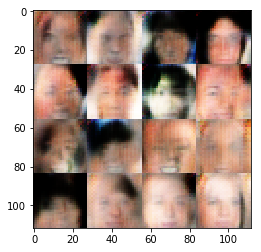

Epoch 1 / 1  D loss:  0.9209 ... G loss:  0.9907 ...
Epoch 1 / 1  D loss:  0.3649 ... G loss:  5.1865 ...
Epoch 1 / 1  D loss:  0.7409 ... G loss:  1.5941 ...
Epoch 1 / 1  D loss:  0.4561 ... G loss:  2.6687 ...
Epoch 1 / 1  D loss:  0.6864 ... G loss:  1.6257 ...
Epoch 1 / 1  D loss:  0.8472 ... G loss:  1.1251 ...
Epoch 1 / 1  D loss:  1.3200 ... G loss:  0.5665 ...


In [65]:
# learning rate 3e-4  batch size 64
# std = .1
losses = train( net, epoch_count, batch_size, z_dim, 
                celeba_dataset.get_batches, celeba_dataset.image_mode)

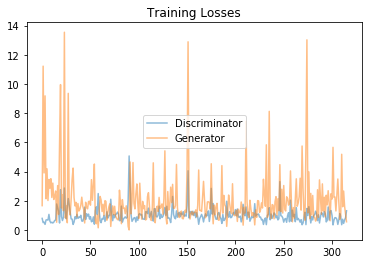

In [66]:
print_losses_chart(losses)

---

Step:  1


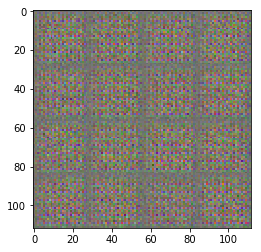

Epoch 1 / 1  D loss:  0.7557 ... G loss:  16.0727 ...
Epoch 1 / 1  D loss:  2.1361 ... G loss:  0.3030 ...
Epoch 1 / 1  D loss:  3.9813 ... G loss:  0.1175 ...
Epoch 1 / 1  D loss:  0.4892 ... G loss:  4.7783 ...
Epoch 1 / 1  D loss:  1.3076 ... G loss:  0.7775 ...
Epoch 1 / 1  D loss:  0.7072 ... G loss:  2.5924 ...
Epoch 1 / 1  D loss:  0.6870 ... G loss:  2.0344 ...
Epoch 1 / 1  D loss:  0.6349 ... G loss:  2.0600 ...
Epoch 1 / 1  D loss:  0.5810 ... G loss:  2.4097 ...
Step:  100


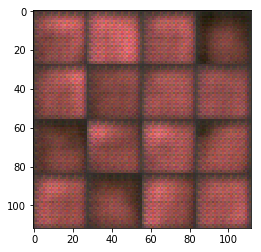

Epoch 1 / 1  D loss:  0.6632 ... G loss:  1.6485 ...
Epoch 1 / 1  D loss:  1.6788 ... G loss:  8.3884 ...
Epoch 1 / 1  D loss:  0.8044 ... G loss:  1.4979 ...
Epoch 1 / 1  D loss:  0.6048 ... G loss:  3.2408 ...
Epoch 1 / 1  D loss:  0.8452 ... G loss:  3.9183 ...
Epoch 1 / 1  D loss:  0.5868 ... G loss:  3.5297 ...
Epoch 1 / 1  D loss:  2.1353 ... G loss:  0.3412 ...
Epoch 1 / 1  D loss:  0.8527 ... G loss:  2.9601 ...
Epoch 1 / 1  D loss:  0.5509 ... G loss:  2.2917 ...
Epoch 1 / 1  D loss:  1.2121 ... G loss:  0.7017 ...
Step:  200


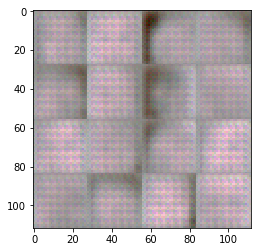

Epoch 1 / 1  D loss:  0.6648 ... G loss:  1.8727 ...
Epoch 1 / 1  D loss:  0.6378 ... G loss:  1.8038 ...
Epoch 1 / 1  D loss:  2.3140 ... G loss:  11.6514 ...
Epoch 1 / 1  D loss:  1.0092 ... G loss:  1.3280 ...
Epoch 1 / 1  D loss:  1.0229 ... G loss:  0.9164 ...
Epoch 1 / 1  D loss:  1.8708 ... G loss:  0.3824 ...
Epoch 1 / 1  D loss:  0.7256 ... G loss:  2.0402 ...
Epoch 1 / 1  D loss:  0.8296 ... G loss:  1.1503 ...
Epoch 1 / 1  D loss:  0.8152 ... G loss:  3.3060 ...
Epoch 1 / 1  D loss:  1.2297 ... G loss:  0.7712 ...
Step:  300


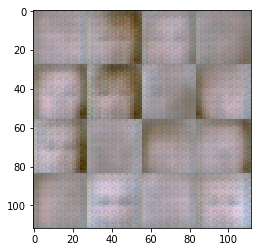

Epoch 1 / 1  D loss:  0.8289 ... G loss:  1.7455 ...
Epoch 1 / 1  D loss:  1.2070 ... G loss:  0.6627 ...
Epoch 1 / 1  D loss:  0.7143 ... G loss:  1.6625 ...
Epoch 1 / 1  D loss:  1.0539 ... G loss:  0.7227 ...
Epoch 1 / 1  D loss:  1.1498 ... G loss:  1.0344 ...
Epoch 1 / 1  D loss:  0.8428 ... G loss:  1.2443 ...
Epoch 1 / 1  D loss:  0.7184 ... G loss:  1.7308 ...
Epoch 1 / 1  D loss:  0.5162 ... G loss:  4.2233 ...
Epoch 1 / 1  D loss:  0.4892 ... G loss:  2.6180 ...
Epoch 1 / 1  D loss:  0.6734 ... G loss:  1.7313 ...
Step:  400


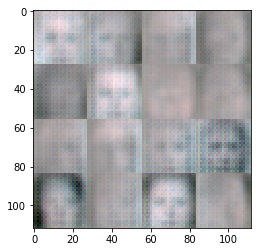

Epoch 1 / 1  D loss:  1.3112 ... G loss:  0.6756 ...
Epoch 1 / 1  D loss:  1.0599 ... G loss:  1.3428 ...
Epoch 1 / 1  D loss:  1.2679 ... G loss:  0.6912 ...
Epoch 1 / 1  D loss:  0.8271 ... G loss:  1.5018 ...
Epoch 1 / 1  D loss:  0.5061 ... G loss:  2.8294 ...
Epoch 1 / 1  D loss:  1.0981 ... G loss:  3.7957 ...
Epoch 1 / 1  D loss:  0.7739 ... G loss:  1.3219 ...
Epoch 1 / 1  D loss:  1.1004 ... G loss:  2.0836 ...
Epoch 1 / 1  D loss:  0.6906 ... G loss:  1.7762 ...
Epoch 1 / 1  D loss:  1.0257 ... G loss:  1.7731 ...
Step:  500


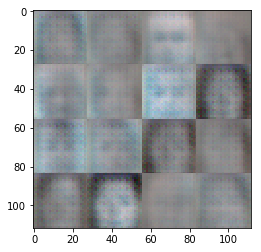

Epoch 1 / 1  D loss:  1.0307 ... G loss:  1.9478 ...
Epoch 1 / 1  D loss:  1.4736 ... G loss:  0.5031 ...
Epoch 1 / 1  D loss:  0.8572 ... G loss:  1.3594 ...
Epoch 1 / 1  D loss:  0.4122 ... G loss:  3.4490 ...
Epoch 1 / 1  D loss:  0.7177 ... G loss:  4.4730 ...
Epoch 1 / 1  D loss:  0.8107 ... G loss:  2.2749 ...
Epoch 1 / 1  D loss:  0.6771 ... G loss:  2.2383 ...
Epoch 1 / 1  D loss:  0.9712 ... G loss:  1.1800 ...
Epoch 1 / 1  D loss:  0.4222 ... G loss:  3.8897 ...
Epoch 1 / 1  D loss:  0.8447 ... G loss:  1.6202 ...
Step:  600


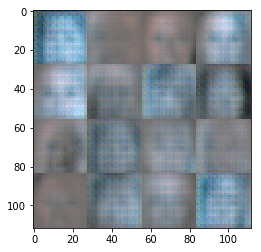

Epoch 1 / 1  D loss:  0.9434 ... G loss:  1.0102 ...
Epoch 1 / 1  D loss:  0.9325 ... G loss:  1.0509 ...
Epoch 1 / 1  D loss:  0.6036 ... G loss:  3.2669 ...
Epoch 1 / 1  D loss:  0.8154 ... G loss:  3.1633 ...
Epoch 1 / 1  D loss:  0.8636 ... G loss:  1.2523 ...
Epoch 1 / 1  D loss:  0.7662 ... G loss:  1.6137 ...
Epoch 1 / 1  D loss:  0.5017 ... G loss:  2.3506 ...
Epoch 1 / 1  D loss:  0.5972 ... G loss:  3.0484 ...
Epoch 1 / 1  D loss:  0.7904 ... G loss:  1.8988 ...
Epoch 1 / 1  D loss:  1.8660 ... G loss:  0.3844 ...
Step:  700


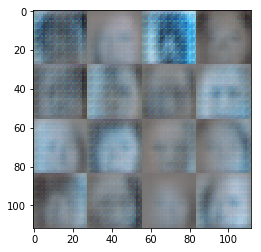

Epoch 1 / 1  D loss:  1.0910 ... G loss:  0.8728 ...
Epoch 1 / 1  D loss:  0.8506 ... G loss:  1.3825 ...
Epoch 1 / 1  D loss:  1.0548 ... G loss:  11.2036 ...
Epoch 1 / 1  D loss:  0.6043 ... G loss:  1.6162 ...
Epoch 1 / 1  D loss:  0.5086 ... G loss:  2.9539 ...
Epoch 1 / 1  D loss:  0.7123 ... G loss:  1.7283 ...
Epoch 1 / 1  D loss:  1.6437 ... G loss:  0.3476 ...
Epoch 1 / 1  D loss:  0.9244 ... G loss:  1.9186 ...
Epoch 1 / 1  D loss:  0.7544 ... G loss:  1.4589 ...
Epoch 1 / 1  D loss:  0.7247 ... G loss:  2.6387 ...
Step:  800


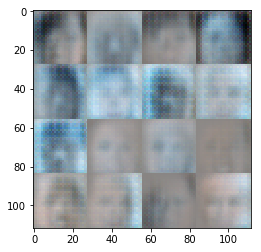

Epoch 1 / 1  D loss:  0.6861 ... G loss:  1.7395 ...
Epoch 1 / 1  D loss:  0.7438 ... G loss:  2.9057 ...
Epoch 1 / 1  D loss:  1.4678 ... G loss:  0.7078 ...
Epoch 1 / 1  D loss:  0.8019 ... G loss:  1.6120 ...
Epoch 1 / 1  D loss:  0.6884 ... G loss:  1.6229 ...
Epoch 1 / 1  D loss:  0.7423 ... G loss:  3.0666 ...
Epoch 1 / 1  D loss:  0.9132 ... G loss:  3.9857 ...
Epoch 1 / 1  D loss:  0.7145 ... G loss:  2.4635 ...
Epoch 1 / 1  D loss:  0.7250 ... G loss:  1.4915 ...
Epoch 1 / 1  D loss:  1.2482 ... G loss:  0.7590 ...
Step:  900


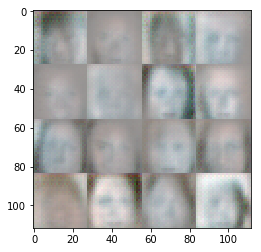

Epoch 1 / 1  D loss:  0.7742 ... G loss:  1.7349 ...
Epoch 1 / 1  D loss:  0.7492 ... G loss:  1.3829 ...
Epoch 1 / 1  D loss:  2.5549 ... G loss:  6.8965 ...
Epoch 1 / 1  D loss:  0.6175 ... G loss:  1.9420 ...
Epoch 1 / 1  D loss:  1.0830 ... G loss:  2.1720 ...
Epoch 1 / 1  D loss:  0.6068 ... G loss:  2.2601 ...
Epoch 1 / 1  D loss:  0.4039 ... G loss:  3.6764 ...
Epoch 1 / 1  D loss:  0.5097 ... G loss:  2.4098 ...
Epoch 1 / 1  D loss:  0.8502 ... G loss:  1.1973 ...
Epoch 1 / 1  D loss:  0.7907 ... G loss:  1.2200 ...
Step:  1000


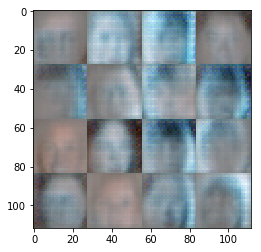

Epoch 1 / 1  D loss:  0.5727 ... G loss:  1.9758 ...
Epoch 1 / 1  D loss:  0.4835 ... G loss:  4.2748 ...
Epoch 1 / 1  D loss:  0.6114 ... G loss:  1.9732 ...
Epoch 1 / 1  D loss:  0.3769 ... G loss:  6.4469 ...
Epoch 1 / 1  D loss:  0.6026 ... G loss:  2.5597 ...
Epoch 1 / 1  D loss:  0.4976 ... G loss:  2.4012 ...
Epoch 1 / 1  D loss:  0.5606 ... G loss:  2.6111 ...
Epoch 1 / 1  D loss:  0.9486 ... G loss:  0.9225 ...
Epoch 1 / 1  D loss:  0.6869 ... G loss:  2.0640 ...
Epoch 1 / 1  D loss:  0.6414 ... G loss:  1.6617 ...
Step:  1100


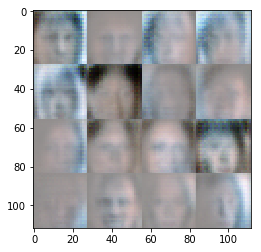

Epoch 1 / 1  D loss:  0.5536 ... G loss:  2.1313 ...
Epoch 1 / 1  D loss:  1.4102 ... G loss:  0.6288 ...
Epoch 1 / 1  D loss:  0.6837 ... G loss:  2.7365 ...
Epoch 1 / 1  D loss:  1.1464 ... G loss:  2.3615 ...
Epoch 1 / 1  D loss:  0.4505 ... G loss:  5.1365 ...
Epoch 1 / 1  D loss:  0.5240 ... G loss:  2.3032 ...
Epoch 1 / 1  D loss:  0.4264 ... G loss:  4.4971 ...
Epoch 1 / 1  D loss:  0.6171 ... G loss:  1.8267 ...
Epoch 1 / 1  D loss:  0.4159 ... G loss:  3.2637 ...
Epoch 1 / 1  D loss:  0.4997 ... G loss:  2.5458 ...
Step:  1200


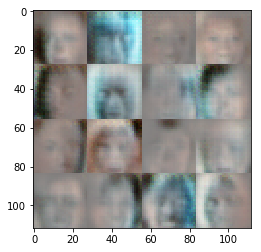

Epoch 1 / 1  D loss:  1.0961 ... G loss:  0.7742 ...
Epoch 1 / 1  D loss:  0.5614 ... G loss:  1.9174 ...
Epoch 1 / 1  D loss:  0.3830 ... G loss:  4.5929 ...
Epoch 1 / 1  D loss:  0.8434 ... G loss:  1.0939 ...
Epoch 1 / 1  D loss:  0.4163 ... G loss:  3.8731 ...
Epoch 1 / 1  D loss:  0.6712 ... G loss:  1.6063 ...
Epoch 1 / 1  D loss:  0.3824 ... G loss:  9.2919 ...
Epoch 1 / 1  D loss:  1.1321 ... G loss:  5.5788 ...
Epoch 1 / 1  D loss:  0.5104 ... G loss:  2.6156 ...
Epoch 1 / 1  D loss:  0.9268 ... G loss:  0.9730 ...
Step:  1300


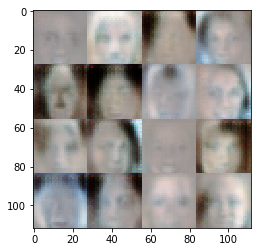

Epoch 1 / 1  D loss:  0.5354 ... G loss:  2.1455 ...
Epoch 1 / 1  D loss:  0.5888 ... G loss:  1.7680 ...
Epoch 1 / 1  D loss:  0.5584 ... G loss:  2.0243 ...
Epoch 1 / 1  D loss:  0.8942 ... G loss:  1.1198 ...
Epoch 1 / 1  D loss:  1.0244 ... G loss:  0.8558 ...
Epoch 1 / 1  D loss:  0.6508 ... G loss:  1.6166 ...
Epoch 1 / 1  D loss:  0.7976 ... G loss:  2.6838 ...
Epoch 1 / 1  D loss:  1.2651 ... G loss:  0.6597 ...
Epoch 1 / 1  D loss:  0.7048 ... G loss:  3.1943 ...
Epoch 1 / 1  D loss:  1.0878 ... G loss:  0.7879 ...
Step:  1400


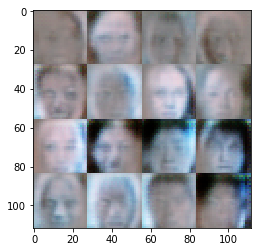

Epoch 1 / 1  D loss:  0.4501 ... G loss:  3.2705 ...
Epoch 1 / 1  D loss:  0.8792 ... G loss:  1.0837 ...
Epoch 1 / 1  D loss:  0.4420 ... G loss:  5.7208 ...
Epoch 1 / 1  D loss:  0.4647 ... G loss:  2.6538 ...
Epoch 1 / 1  D loss:  0.7172 ... G loss:  1.4462 ...
Epoch 1 / 1  D loss:  1.4818 ... G loss:  3.6308 ...
Epoch 1 / 1  D loss:  0.4521 ... G loss:  2.6937 ...
Epoch 1 / 1  D loss:  0.4556 ... G loss:  6.0129 ...
Epoch 1 / 1  D loss:  0.5395 ... G loss:  3.0080 ...
Epoch 1 / 1  D loss:  0.7042 ... G loss:  1.4563 ...
Step:  1500


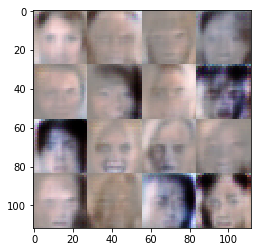

Epoch 1 / 1  D loss:  0.5656 ... G loss:  7.4701 ...
Epoch 1 / 1  D loss:  1.0750 ... G loss:  1.5806 ...
Epoch 1 / 1  D loss:  0.7706 ... G loss:  1.4339 ...
Epoch 1 / 1  D loss:  0.3851 ... G loss:  4.0013 ...
Epoch 1 / 1  D loss:  1.3288 ... G loss:  0.5730 ...
Epoch 1 / 1  D loss:  0.8324 ... G loss:  3.4150 ...
Epoch 1 / 1  D loss:  0.5052 ... G loss:  3.7848 ...
Epoch 1 / 1  D loss:  0.6810 ... G loss:  1.8080 ...
Epoch 1 / 1  D loss:  0.4088 ... G loss:  3.5008 ...
Epoch 1 / 1  D loss:  1.1651 ... G loss:  0.6889 ...
Step:  1600


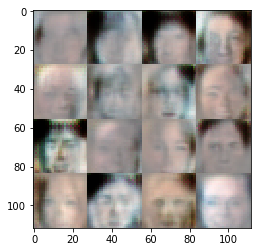

Epoch 1 / 1  D loss:  0.4742 ... G loss:  2.7785 ...
Epoch 1 / 1  D loss:  0.4297 ... G loss:  2.9080 ...
Epoch 1 / 1  D loss:  0.8890 ... G loss:  1.0093 ...
Epoch 1 / 1  D loss:  0.6053 ... G loss:  1.7021 ...
Epoch 1 / 1  D loss:  0.4158 ... G loss:  8.6122 ...
Epoch 1 / 1  D loss:  0.4533 ... G loss:  2.8822 ...
Epoch 1 / 1  D loss:  2.1692 ... G loss:  11.2658 ...
Epoch 1 / 1  D loss:  1.0989 ... G loss:  0.7731 ...
Epoch 1 / 1  D loss:  0.7141 ... G loss:  2.9519 ...
Epoch 1 / 1  D loss:  0.6202 ... G loss:  2.2147 ...
Step:  1700


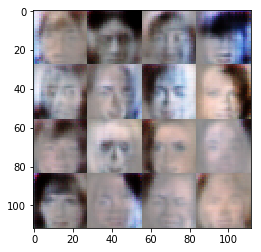

Epoch 1 / 1  D loss:  0.7570 ... G loss:  1.3040 ...
Epoch 1 / 1  D loss:  0.8682 ... G loss:  0.9993 ...
Epoch 1 / 1  D loss:  0.8664 ... G loss:  1.2749 ...
Epoch 1 / 1  D loss:  0.4626 ... G loss:  3.0456 ...
Epoch 1 / 1  D loss:  0.6904 ... G loss:  1.4226 ...
Epoch 1 / 1  D loss:  0.7731 ... G loss:  1.3745 ...
Epoch 1 / 1  D loss:  0.4822 ... G loss:  2.5171 ...
Epoch 1 / 1  D loss:  1.3550 ... G loss:  0.5767 ...
Epoch 1 / 1  D loss:  0.5479 ... G loss:  2.1749 ...
Epoch 1 / 1  D loss:  0.4042 ... G loss:  4.0628 ...
Step:  1800


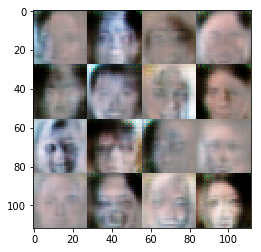

Epoch 1 / 1  D loss:  0.7736 ... G loss:  1.4633 ...
Epoch 1 / 1  D loss:  0.7984 ... G loss:  1.7383 ...
Epoch 1 / 1  D loss:  0.6783 ... G loss:  1.9285 ...
Epoch 1 / 1  D loss:  0.9565 ... G loss:  1.0677 ...
Epoch 1 / 1  D loss:  0.5182 ... G loss:  2.5135 ...
Epoch 1 / 1  D loss:  0.9080 ... G loss:  1.1886 ...
Epoch 1 / 1  D loss:  1.2298 ... G loss:  0.7440 ...
Epoch 1 / 1  D loss:  0.8664 ... G loss:  2.6300 ...
Epoch 1 / 1  D loss:  0.6763 ... G loss:  1.6755 ...
Epoch 1 / 1  D loss:  0.4452 ... G loss:  2.9221 ...
Step:  1900


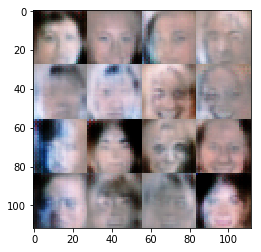

Epoch 1 / 1  D loss:  0.7080 ... G loss:  1.8487 ...
Epoch 1 / 1  D loss:  2.0439 ... G loss:  5.7795 ...
Epoch 1 / 1  D loss:  1.6948 ... G loss:  0.4034 ...
Epoch 1 / 1  D loss:  0.6040 ... G loss:  1.8541 ...
Epoch 1 / 1  D loss:  0.6279 ... G loss:  2.1804 ...
Epoch 1 / 1  D loss:  0.5019 ... G loss:  2.3434 ...
Epoch 1 / 1  D loss:  0.7134 ... G loss:  1.3969 ...
Epoch 1 / 1  D loss:  0.9038 ... G loss:  1.1941 ...
Epoch 1 / 1  D loss:  0.8416 ... G loss:  3.5824 ...
Epoch 1 / 1  D loss:  0.7447 ... G loss:  2.8039 ...
Step:  2000


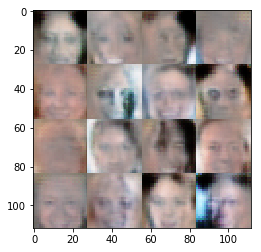

Epoch 1 / 1  D loss:  0.6259 ... G loss:  2.0715 ...
Epoch 1 / 1  D loss:  0.5294 ... G loss:  3.1994 ...
Epoch 1 / 1  D loss:  0.8593 ... G loss:  1.1684 ...
Epoch 1 / 1  D loss:  0.7131 ... G loss:  1.4257 ...
Epoch 1 / 1  D loss:  0.5987 ... G loss:  2.0545 ...
Epoch 1 / 1  D loss:  0.4349 ... G loss:  3.0869 ...
Epoch 1 / 1  D loss:  1.0583 ... G loss:  0.8044 ...
Epoch 1 / 1  D loss:  0.4523 ... G loss:  2.6411 ...
Epoch 1 / 1  D loss:  0.4535 ... G loss:  5.0167 ...
Epoch 1 / 1  D loss:  0.8209 ... G loss:  1.5857 ...
Step:  2100


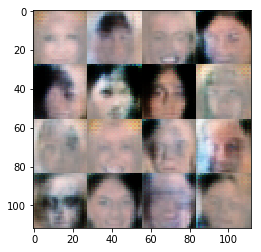

Epoch 1 / 1  D loss:  0.8652 ... G loss:  3.3493 ...
Epoch 1 / 1  D loss:  0.6165 ... G loss:  2.0513 ...
Epoch 1 / 1  D loss:  0.5446 ... G loss:  2.7605 ...
Epoch 1 / 1  D loss:  0.6862 ... G loss:  1.5919 ...
Epoch 1 / 1  D loss:  0.8938 ... G loss:  2.9180 ...
Epoch 1 / 1  D loss:  0.6787 ... G loss:  1.7356 ...
Epoch 1 / 1  D loss:  0.8111 ... G loss:  1.7521 ...
Epoch 1 / 1  D loss:  0.6955 ... G loss:  1.5027 ...
Epoch 1 / 1  D loss:  0.7320 ... G loss:  1.4736 ...
Epoch 1 / 1  D loss:  0.7189 ... G loss:  2.4247 ...
Step:  2200


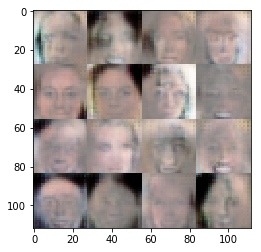

Epoch 1 / 1  D loss:  0.5913 ... G loss:  3.7561 ...
Epoch 1 / 1  D loss:  0.5069 ... G loss:  2.2923 ...
Epoch 1 / 1  D loss:  0.3915 ... G loss:  5.7556 ...
Epoch 1 / 1  D loss:  0.8059 ... G loss:  2.0813 ...
Epoch 1 / 1  D loss:  2.2359 ... G loss:  0.2589 ...
Epoch 1 / 1  D loss:  0.5216 ... G loss:  2.2403 ...
Epoch 1 / 1  D loss:  0.5861 ... G loss:  2.2660 ...
Epoch 1 / 1  D loss:  0.6697 ... G loss:  1.5437 ...
Epoch 1 / 1  D loss:  0.8246 ... G loss:  1.2992 ...
Epoch 1 / 1  D loss:  0.7032 ... G loss:  1.5930 ...
Step:  2300


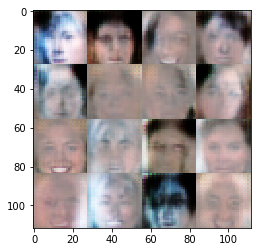

Epoch 1 / 1  D loss:  1.1290 ... G loss:  0.7926 ...
Epoch 1 / 1  D loss:  0.3791 ... G loss:  8.5649 ...
Epoch 1 / 1  D loss:  0.7310 ... G loss:  1.4257 ...
Epoch 1 / 1  D loss:  1.1850 ... G loss:  3.4681 ...
Epoch 1 / 1  D loss:  0.4256 ... G loss:  2.9765 ...
Epoch 1 / 1  D loss:  2.2630 ... G loss:  0.2528 ...
Epoch 1 / 1  D loss:  0.6935 ... G loss:  1.7678 ...
Epoch 1 / 1  D loss:  0.6486 ... G loss:  1.8281 ...
Epoch 1 / 1  D loss:  0.6737 ... G loss:  1.5532 ...
Epoch 1 / 1  D loss:  0.6944 ... G loss:  1.7735 ...
Step:  2400


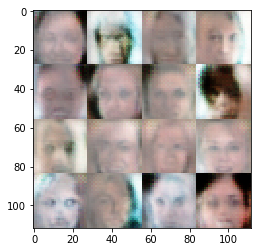

Epoch 1 / 1  D loss:  0.8276 ... G loss:  1.2740 ...
Epoch 1 / 1  D loss:  0.4362 ... G loss:  14.5098 ...
Epoch 1 / 1  D loss:  0.6115 ... G loss:  1.7959 ...
Epoch 1 / 1  D loss:  0.9228 ... G loss:  1.0100 ...
Epoch 1 / 1  D loss:  0.8120 ... G loss:  1.1597 ...
Epoch 1 / 1  D loss:  2.2553 ... G loss:  4.6979 ...
Epoch 1 / 1  D loss:  0.5180 ... G loss:  2.4454 ...
Epoch 1 / 1  D loss:  0.4737 ... G loss:  3.3266 ...
Epoch 1 / 1  D loss:  0.7035 ... G loss:  2.7808 ...
Epoch 1 / 1  D loss:  0.4815 ... G loss:  2.5831 ...
Step:  2500


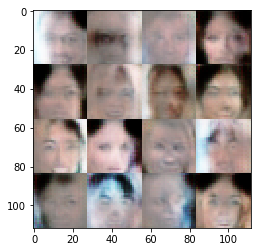

Epoch 1 / 1  D loss:  0.9158 ... G loss:  1.0636 ...
Epoch 1 / 1  D loss:  0.4210 ... G loss:  6.7773 ...
Epoch 1 / 1  D loss:  0.3922 ... G loss:  3.8796 ...
Epoch 1 / 1  D loss:  0.6127 ... G loss:  1.6502 ...
Epoch 1 / 1  D loss:  0.9940 ... G loss:  5.5224 ...
Epoch 1 / 1  D loss:  0.5573 ... G loss:  2.2239 ...
Epoch 1 / 1  D loss:  1.3770 ... G loss:  3.6892 ...
Epoch 1 / 1  D loss:  0.7118 ... G loss:  1.8114 ...
Epoch 1 / 1  D loss:  0.5126 ... G loss:  2.0313 ...
Epoch 1 / 1  D loss:  0.6868 ... G loss:  2.5230 ...
Step:  2600


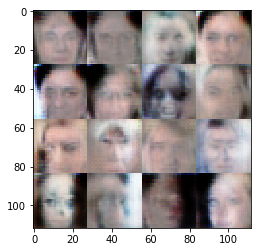

Epoch 1 / 1  D loss:  0.6537 ... G loss:  1.6960 ...
Epoch 1 / 1  D loss:  0.9668 ... G loss:  2.1178 ...
Epoch 1 / 1  D loss:  0.7278 ... G loss:  1.4870 ...
Epoch 1 / 1  D loss:  0.6821 ... G loss:  1.5965 ...
Epoch 1 / 1  D loss:  1.1173 ... G loss:  3.7904 ...
Epoch 1 / 1  D loss:  0.3736 ... G loss:  5.4166 ...
Epoch 1 / 1  D loss:  0.4667 ... G loss:  2.7569 ...
Epoch 1 / 1  D loss:  0.9511 ... G loss:  1.1122 ...
Epoch 1 / 1  D loss:  0.5409 ... G loss:  1.9903 ...
Epoch 1 / 1  D loss:  0.6581 ... G loss:  1.5546 ...
Step:  2700


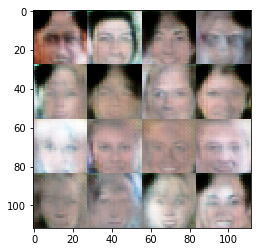

Epoch 1 / 1  D loss:  0.4451 ... G loss:  2.9965 ...
Epoch 1 / 1  D loss:  4.7977 ... G loss:  8.7483 ...
Epoch 1 / 1  D loss:  1.2322 ... G loss:  1.2993 ...
Epoch 1 / 1  D loss:  0.3988 ... G loss:  4.6211 ...
Epoch 1 / 1  D loss:  0.7464 ... G loss:  1.3739 ...
Epoch 1 / 1  D loss:  0.9212 ... G loss:  1.0242 ...
Epoch 1 / 1  D loss:  0.7142 ... G loss:  1.4874 ...
Epoch 1 / 1  D loss:  0.7986 ... G loss:  1.3339 ...
Epoch 1 / 1  D loss:  0.8901 ... G loss:  1.0783 ...
Epoch 1 / 1  D loss:  0.7392 ... G loss:  4.1230 ...
Step:  2800


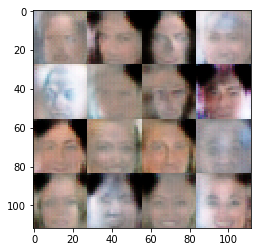

Epoch 1 / 1  D loss:  0.5475 ... G loss:  1.9649 ...
Epoch 1 / 1  D loss:  0.3985 ... G loss:  6.6043 ...
Epoch 1 / 1  D loss:  0.6405 ... G loss:  2.0429 ...
Epoch 1 / 1  D loss:  0.6855 ... G loss:  1.4991 ...
Epoch 1 / 1  D loss:  0.5616 ... G loss:  1.8683 ...
Epoch 1 / 1  D loss:  0.6283 ... G loss:  2.0797 ...
Epoch 1 / 1  D loss:  0.4155 ... G loss:  3.3165 ...
Epoch 1 / 1  D loss:  1.8574 ... G loss:  3.7761 ...
Epoch 1 / 1  D loss:  0.4111 ... G loss:  3.5707 ...
Epoch 1 / 1  D loss:  0.5943 ... G loss:  2.1640 ...
Step:  2900


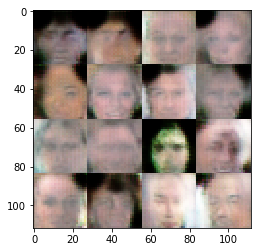

Epoch 1 / 1  D loss:  0.9378 ... G loss:  0.9289 ...
Epoch 1 / 1  D loss:  0.4218 ... G loss:  3.9487 ...
Epoch 1 / 1  D loss:  0.4896 ... G loss:  4.0032 ...
Epoch 1 / 1  D loss:  0.3895 ... G loss:  4.2601 ...
Epoch 1 / 1  D loss:  0.6226 ... G loss:  1.6992 ...
Epoch 1 / 1  D loss:  0.3736 ... G loss:  4.9140 ...
Epoch 1 / 1  D loss:  1.1089 ... G loss:  1.3754 ...
Epoch 1 / 1  D loss:  1.8080 ... G loss:  0.4586 ...
Epoch 1 / 1  D loss:  1.1713 ... G loss:  1.1272 ...
Epoch 1 / 1  D loss:  1.1094 ... G loss:  0.8624 ...
Step:  3000


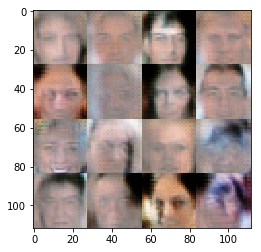

Epoch 1 / 1  D loss:  1.0660 ... G loss:  0.8550 ...
Epoch 1 / 1  D loss:  1.5487 ... G loss:  5.4491 ...
Epoch 1 / 1  D loss:  1.3768 ... G loss:  1.2764 ...
Epoch 1 / 1  D loss:  1.0767 ... G loss:  1.1422 ...
Epoch 1 / 1  D loss:  1.2118 ... G loss:  2.4695 ...
Epoch 1 / 1  D loss:  0.7866 ... G loss:  1.5277 ...
Epoch 1 / 1  D loss:  0.6373 ... G loss:  1.6054 ...
Epoch 1 / 1  D loss:  0.5642 ... G loss:  2.8222 ...
Epoch 1 / 1  D loss:  0.7798 ... G loss:  3.1893 ...
Epoch 1 / 1  D loss:  0.7188 ... G loss:  1.3926 ...
Step:  3100


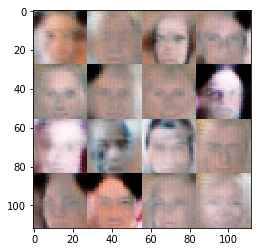

Epoch 1 / 1  D loss:  0.6765 ... G loss:  1.4009 ...
Epoch 1 / 1  D loss:  0.6964 ... G loss:  2.4830 ...
Epoch 1 / 1  D loss:  0.4736 ... G loss:  2.4685 ...
Epoch 1 / 1  D loss:  0.4528 ... G loss:  2.5447 ...
Epoch 1 / 1  D loss:  0.5533 ... G loss:  4.2294 ...
Epoch 1 / 1  D loss:  0.6227 ... G loss:  1.6979 ...
Epoch 1 / 1  D loss:  1.0836 ... G loss:  0.8041 ...


In [70]:
# learning rate 2e-4
losses = train( net, epoch_count, batch_size, z_dim, 
                celeba_dataset.get_batches, celeba_dataset.image_mode)

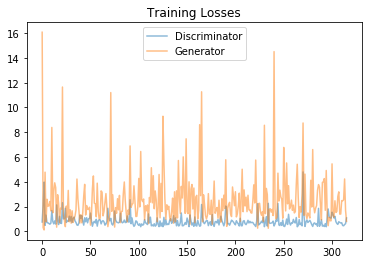

In [71]:
print_losses_chart(losses)

---

Step:  1


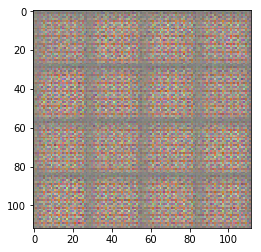

Epoch 1 / 1  D loss:  0.7990 ... G loss:  1.6711 ...
Epoch 1 / 1  D loss:  0.5099 ... G loss:  11.2185 ...
Epoch 1 / 1  D loss:  0.5401 ... G loss:  3.9099 ...
Epoch 1 / 1  D loss:  0.3917 ... G loss:  9.1851 ...
Epoch 1 / 1  D loss:  0.6888 ... G loss:  2.1413 ...
Epoch 1 / 1  D loss:  0.7030 ... G loss:  4.1915 ...
Epoch 1 / 1  D loss:  0.6790 ... G loss:  2.0227 ...
Epoch 1 / 1  D loss:  1.0730 ... G loss:  3.4638 ...
Epoch 1 / 1  D loss:  0.6140 ... G loss:  2.8627 ...
Step:  100


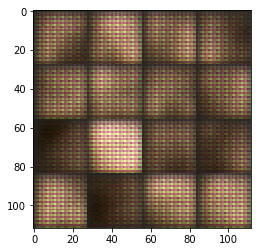

Epoch 1 / 1  D loss:  0.4911 ... G loss:  3.5134 ...
Epoch 1 / 1  D loss:  0.5396 ... G loss:  2.2298 ...
Epoch 1 / 1  D loss:  0.4810 ... G loss:  3.2132 ...
Epoch 1 / 1  D loss:  0.5383 ... G loss:  2.0909 ...
Epoch 1 / 1  D loss:  0.6570 ... G loss:  2.3272 ...
Epoch 1 / 1  D loss:  0.6844 ... G loss:  2.6738 ...
Epoch 1 / 1  D loss:  1.7832 ... G loss:  0.5338 ...
Epoch 1 / 1  D loss:  1.5289 ... G loss:  3.0437 ...
Epoch 1 / 1  D loss:  1.2625 ... G loss:  1.0686 ...
Epoch 1 / 1  D loss:  0.4826 ... G loss:  5.9289 ...
Step:  200


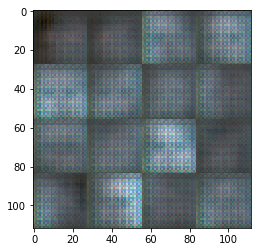

Epoch 1 / 1  D loss:  2.7658 ... G loss:  9.9546 ...
Epoch 1 / 1  D loss:  0.9266 ... G loss:  1.5059 ...
Epoch 1 / 1  D loss:  0.6512 ... G loss:  2.4145 ...
Epoch 1 / 1  D loss:  0.8585 ... G loss:  1.3220 ...
Epoch 1 / 1  D loss:  2.8772 ... G loss:  13.5402 ...
Epoch 1 / 1  D loss:  1.2007 ... G loss:  0.8255 ...
Epoch 1 / 1  D loss:  0.7653 ... G loss:  1.6538 ...
Epoch 1 / 1  D loss:  1.5850 ... G loss:  0.5003 ...
Epoch 1 / 1  D loss:  2.1558 ... G loss:  9.3562 ...
Epoch 1 / 1  D loss:  1.6789 ... G loss:  1.4266 ...
Step:  300


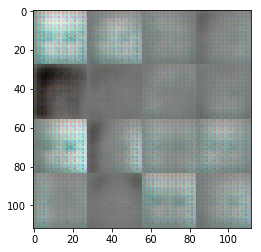

Epoch 1 / 1  D loss:  1.2012 ... G loss:  1.0326 ...
Epoch 1 / 1  D loss:  0.7639 ... G loss:  2.1093 ...
Epoch 1 / 1  D loss:  0.7479 ... G loss:  3.4622 ...
Epoch 1 / 1  D loss:  0.3843 ... G loss:  4.2432 ...
Epoch 1 / 1  D loss:  0.5456 ... G loss:  2.2203 ...
Epoch 1 / 1  D loss:  0.9136 ... G loss:  1.6524 ...
Epoch 1 / 1  D loss:  0.7682 ... G loss:  1.8971 ...
Epoch 1 / 1  D loss:  1.0790 ... G loss:  0.9012 ...
Epoch 1 / 1  D loss:  0.7999 ... G loss:  1.8157 ...
Epoch 1 / 1  D loss:  0.8843 ... G loss:  1.3045 ...
Step:  400


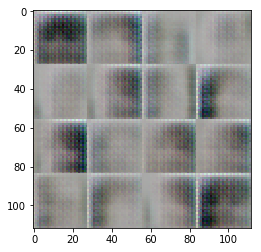

Epoch 1 / 1  D loss:  0.8557 ... G loss:  1.4202 ...
Epoch 1 / 1  D loss:  1.0079 ... G loss:  1.6964 ...
Epoch 1 / 1  D loss:  0.6187 ... G loss:  2.2499 ...
Epoch 1 / 1  D loss:  0.6054 ... G loss:  1.6361 ...
Epoch 1 / 1  D loss:  0.7873 ... G loss:  1.4050 ...
Epoch 1 / 1  D loss:  1.5698 ... G loss:  0.4834 ...
Epoch 1 / 1  D loss:  0.7241 ... G loss:  1.9024 ...
Epoch 1 / 1  D loss:  1.1163 ... G loss:  1.5615 ...
Epoch 1 / 1  D loss:  0.9541 ... G loss:  1.4535 ...
Epoch 1 / 1  D loss:  1.0909 ... G loss:  1.9539 ...
Step:  500


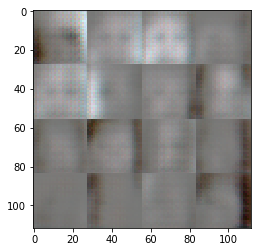

Epoch 1 / 1  D loss:  0.7498 ... G loss:  1.9686 ...
Epoch 1 / 1  D loss:  0.9206 ... G loss:  1.7037 ...
Epoch 1 / 1  D loss:  0.5660 ... G loss:  3.4496 ...
Epoch 1 / 1  D loss:  0.6071 ... G loss:  2.0338 ...
Epoch 1 / 1  D loss:  0.9007 ... G loss:  3.1073 ...
Epoch 1 / 1  D loss:  0.4016 ... G loss:  4.5170 ...
Epoch 1 / 1  D loss:  1.3160 ... G loss:  0.6477 ...
Epoch 1 / 1  D loss:  1.5893 ... G loss:  0.4301 ...
Epoch 1 / 1  D loss:  1.0627 ... G loss:  1.0247 ...
Epoch 1 / 1  D loss:  2.4974 ... G loss:  0.1542 ...
Step:  600


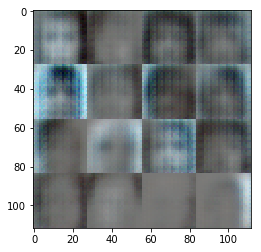

Epoch 1 / 1  D loss:  1.3113 ... G loss:  1.3011 ...
Epoch 1 / 1  D loss:  0.6390 ... G loss:  2.3000 ...
Epoch 1 / 1  D loss:  0.5024 ... G loss:  2.0501 ...
Epoch 1 / 1  D loss:  0.7925 ... G loss:  1.2680 ...
Epoch 1 / 1  D loss:  0.7429 ... G loss:  1.7636 ...
Epoch 1 / 1  D loss:  1.0036 ... G loss:  1.0003 ...
Epoch 1 / 1  D loss:  0.5897 ... G loss:  2.0110 ...
Epoch 1 / 1  D loss:  0.8629 ... G loss:  1.9589 ...
Epoch 1 / 1  D loss:  1.2509 ... G loss:  0.6742 ...
Epoch 1 / 1  D loss:  0.8174 ... G loss:  1.1917 ...
Step:  700


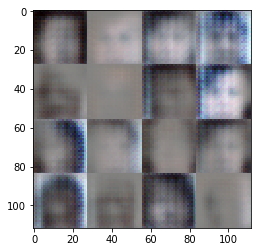

Epoch 1 / 1  D loss:  1.0074 ... G loss:  1.5793 ...
Epoch 1 / 1  D loss:  0.9916 ... G loss:  1.7938 ...
Epoch 1 / 1  D loss:  2.1077 ... G loss:  0.2479 ...
Epoch 1 / 1  D loss:  1.1331 ... G loss:  1.2049 ...
Epoch 1 / 1  D loss:  0.6415 ... G loss:  1.6547 ...
Epoch 1 / 1  D loss:  1.0625 ... G loss:  1.0510 ...
Epoch 1 / 1  D loss:  0.8418 ... G loss:  1.6271 ...
Epoch 1 / 1  D loss:  1.0747 ... G loss:  0.9666 ...
Epoch 1 / 1  D loss:  1.1069 ... G loss:  0.8161 ...
Epoch 1 / 1  D loss:  1.2276 ... G loss:  0.7100 ...
Step:  800


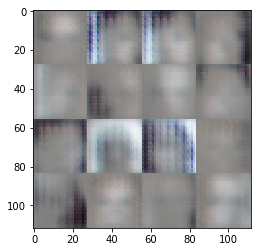

Epoch 1 / 1  D loss:  1.0971 ... G loss:  0.7114 ...
Epoch 1 / 1  D loss:  0.6414 ... G loss:  2.7311 ...
Epoch 1 / 1  D loss:  0.6565 ... G loss:  1.8848 ...
Epoch 1 / 1  D loss:  1.6357 ... G loss:  0.4338 ...
Epoch 1 / 1  D loss:  0.5401 ... G loss:  2.0822 ...
Epoch 1 / 1  D loss:  0.7383 ... G loss:  1.5065 ...
Epoch 1 / 1  D loss:  0.8350 ... G loss:  1.5105 ...
Epoch 1 / 1  D loss:  0.9029 ... G loss:  1.1188 ...
Epoch 1 / 1  D loss:  0.8135 ... G loss:  1.6583 ...
Epoch 1 / 1  D loss:  0.8701 ... G loss:  1.2050 ...
Step:  900


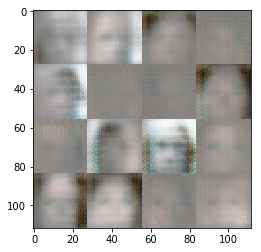

Epoch 1 / 1  D loss:  2.0886 ... G loss:  0.2488 ...
Epoch 1 / 1  D loss:  5.0725 ... G loss:  0.0091 ...
Epoch 1 / 1  D loss:  3.1492 ... G loss:  4.6588 ...
Epoch 1 / 1  D loss:  1.0507 ... G loss:  1.1072 ...
Epoch 1 / 1  D loss:  0.5939 ... G loss:  1.9728 ...
Epoch 1 / 1  D loss:  0.7116 ... G loss:  4.6199 ...
Epoch 1 / 1  D loss:  0.8312 ... G loss:  1.8075 ...
Epoch 1 / 1  D loss:  0.8551 ... G loss:  1.4475 ...
Epoch 1 / 1  D loss:  0.5527 ... G loss:  2.4618 ...
Epoch 1 / 1  D loss:  0.9035 ... G loss:  3.1552 ...
Step:  1000


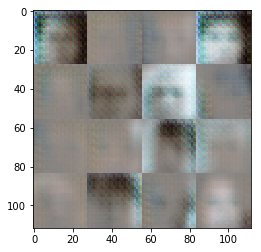

Epoch 1 / 1  D loss:  0.6645 ... G loss:  1.8037 ...
Epoch 1 / 1  D loss:  1.0803 ... G loss:  0.7947 ...
Epoch 1 / 1  D loss:  1.1231 ... G loss:  3.2081 ...
Epoch 1 / 1  D loss:  1.0275 ... G loss:  1.7645 ...
Epoch 1 / 1  D loss:  1.0716 ... G loss:  0.7462 ...
Epoch 1 / 1  D loss:  0.7596 ... G loss:  1.9622 ...
Epoch 1 / 1  D loss:  0.7517 ... G loss:  1.4615 ...
Epoch 1 / 1  D loss:  0.7327 ... G loss:  1.6775 ...
Epoch 1 / 1  D loss:  1.2534 ... G loss:  0.6908 ...
Epoch 1 / 1  D loss:  1.2515 ... G loss:  0.7456 ...
Step:  1100


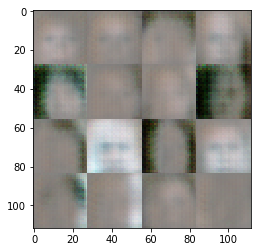

Epoch 1 / 1  D loss:  1.1303 ... G loss:  2.2796 ...
Epoch 1 / 1  D loss:  1.5001 ... G loss:  2.5569 ...
Epoch 1 / 1  D loss:  0.8725 ... G loss:  1.7039 ...
Epoch 1 / 1  D loss:  1.0455 ... G loss:  0.7538 ...
Epoch 1 / 1  D loss:  1.2672 ... G loss:  0.6576 ...
Epoch 1 / 1  D loss:  0.8565 ... G loss:  1.5638 ...
Epoch 1 / 1  D loss:  0.6131 ... G loss:  4.6009 ...
Epoch 1 / 1  D loss:  1.4608 ... G loss:  0.7887 ...
Epoch 1 / 1  D loss:  1.4526 ... G loss:  0.5015 ...
Epoch 1 / 1  D loss:  0.9283 ... G loss:  1.4483 ...
Step:  1200


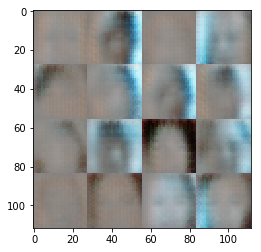

Epoch 1 / 1  D loss:  0.8974 ... G loss:  1.6321 ...
Epoch 1 / 1  D loss:  1.0164 ... G loss:  1.2737 ...
Epoch 1 / 1  D loss:  1.6399 ... G loss:  2.2351 ...
Epoch 1 / 1  D loss:  0.7758 ... G loss:  1.4759 ...
Epoch 1 / 1  D loss:  1.0764 ... G loss:  1.5906 ...
Epoch 1 / 1  D loss:  0.8577 ... G loss:  1.7888 ...
Epoch 1 / 1  D loss:  0.9359 ... G loss:  1.0787 ...
Epoch 1 / 1  D loss:  1.1255 ... G loss:  2.1549 ...
Epoch 1 / 1  D loss:  1.5510 ... G loss:  5.4217 ...
Epoch 1 / 1  D loss:  0.9991 ... G loss:  0.9776 ...
Step:  1300


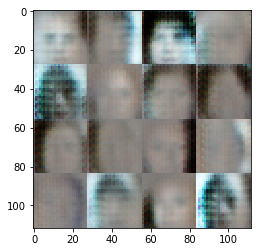

Epoch 1 / 1  D loss:  1.6292 ... G loss:  0.4183 ...
Epoch 1 / 1  D loss:  0.8090 ... G loss:  2.6351 ...
Epoch 1 / 1  D loss:  0.8470 ... G loss:  1.3726 ...
Epoch 1 / 1  D loss:  0.7451 ... G loss:  1.6110 ...
Epoch 1 / 1  D loss:  0.5119 ... G loss:  2.9364 ...
Epoch 1 / 1  D loss:  1.1375 ... G loss:  1.8776 ...
Epoch 1 / 1  D loss:  2.2999 ... G loss:  3.1275 ...
Epoch 1 / 1  D loss:  1.0689 ... G loss:  1.5031 ...
Epoch 1 / 1  D loss:  0.8389 ... G loss:  1.4963 ...
Epoch 1 / 1  D loss:  0.7717 ... G loss:  1.6797 ...
Step:  1400


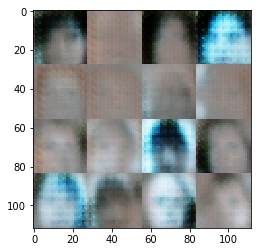

Epoch 1 / 1  D loss:  1.3151 ... G loss:  4.4913 ...
Epoch 1 / 1  D loss:  0.8784 ... G loss:  1.5237 ...
Epoch 1 / 1  D loss:  1.1322 ... G loss:  0.9649 ...
Epoch 1 / 1  D loss:  1.2103 ... G loss:  0.8578 ...
Epoch 1 / 1  D loss:  0.9159 ... G loss:  1.1744 ...
Epoch 1 / 1  D loss:  1.1628 ... G loss:  1.2958 ...
Epoch 1 / 1  D loss:  1.0595 ... G loss:  0.7981 ...
Epoch 1 / 1  D loss:  1.2597 ... G loss:  0.7681 ...
Epoch 1 / 1  D loss:  0.9486 ... G loss:  1.0434 ...
Epoch 1 / 1  D loss:  1.0110 ... G loss:  1.3557 ...
Step:  1500


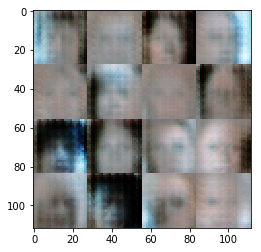

Epoch 1 / 1  D loss:  0.9522 ... G loss:  1.2190 ...
Epoch 1 / 1  D loss:  1.6625 ... G loss:  4.4203 ...
Epoch 1 / 1  D loss:  4.0590 ... G loss:  12.8860 ...
Epoch 1 / 1  D loss:  0.8266 ... G loss:  1.4283 ...
Epoch 1 / 1  D loss:  1.2190 ... G loss:  0.7529 ...
Epoch 1 / 1  D loss:  1.2756 ... G loss:  1.1432 ...
Epoch 1 / 1  D loss:  1.0486 ... G loss:  1.2721 ...
Epoch 1 / 1  D loss:  1.2871 ... G loss:  1.0290 ...
Epoch 1 / 1  D loss:  0.9902 ... G loss:  1.1887 ...
Epoch 1 / 1  D loss:  1.2308 ... G loss:  1.2126 ...
Step:  1600


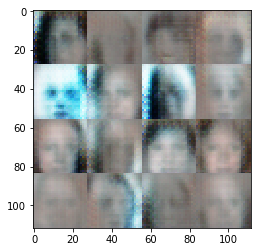

Epoch 1 / 1  D loss:  0.8477 ... G loss:  1.3812 ...
Epoch 1 / 1  D loss:  1.1893 ... G loss:  0.9084 ...
Epoch 1 / 1  D loss:  0.9056 ... G loss:  1.7084 ...
Epoch 1 / 1  D loss:  0.3935 ... G loss:  4.1097 ...
Epoch 1 / 1  D loss:  0.7812 ... G loss:  1.3471 ...
Epoch 1 / 1  D loss:  0.9160 ... G loss:  1.3378 ...
Epoch 1 / 1  D loss:  1.0713 ... G loss:  1.2826 ...
Epoch 1 / 1  D loss:  0.8855 ... G loss:  2.2350 ...
Epoch 1 / 1  D loss:  0.5549 ... G loss:  3.3313 ...
Epoch 1 / 1  D loss:  0.9133 ... G loss:  2.1066 ...
Step:  1700


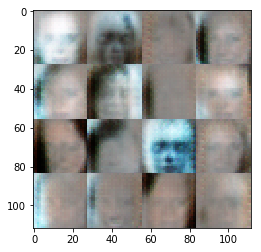

Epoch 1 / 1  D loss:  1.1097 ... G loss:  0.8413 ...
Epoch 1 / 1  D loss:  0.9553 ... G loss:  1.0922 ...
Epoch 1 / 1  D loss:  1.0042 ... G loss:  1.9240 ...
Epoch 1 / 1  D loss:  1.3111 ... G loss:  1.9386 ...
Epoch 1 / 1  D loss:  0.5869 ... G loss:  1.8881 ...
Epoch 1 / 1  D loss:  1.0450 ... G loss:  1.4506 ...
Epoch 1 / 1  D loss:  2.8532 ... G loss:  4.5390 ...
Epoch 1 / 1  D loss:  1.0908 ... G loss:  1.4961 ...
Epoch 1 / 1  D loss:  1.8166 ... G loss:  0.4270 ...
Epoch 1 / 1  D loss:  1.1541 ... G loss:  1.7126 ...
Step:  1800


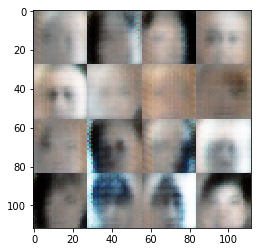

Epoch 1 / 1  D loss:  0.9321 ... G loss:  1.0461 ...
Epoch 1 / 1  D loss:  0.7365 ... G loss:  1.6305 ...
Epoch 1 / 1  D loss:  0.7457 ... G loss:  1.8267 ...
Epoch 1 / 1  D loss:  1.1639 ... G loss:  0.7205 ...
Epoch 1 / 1  D loss:  1.1942 ... G loss:  0.6648 ...
Epoch 1 / 1  D loss:  0.9083 ... G loss:  0.9847 ...
Epoch 1 / 1  D loss:  0.7729 ... G loss:  1.4299 ...
Epoch 1 / 1  D loss:  0.4543 ... G loss:  4.4098 ...
Epoch 1 / 1  D loss:  1.0694 ... G loss:  1.1579 ...
Epoch 1 / 1  D loss:  0.6466 ... G loss:  2.3730 ...
Step:  1900


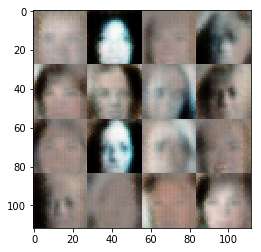

Epoch 1 / 1  D loss:  0.7199 ... G loss:  1.7267 ...
Epoch 1 / 1  D loss:  0.8969 ... G loss:  1.5781 ...
Epoch 1 / 1  D loss:  1.9714 ... G loss:  0.2526 ...
Epoch 1 / 1  D loss:  1.0385 ... G loss:  1.2064 ...
Epoch 1 / 1  D loss:  0.8789 ... G loss:  2.3960 ...
Epoch 1 / 1  D loss:  1.2594 ... G loss:  1.8171 ...
Epoch 1 / 1  D loss:  0.8485 ... G loss:  1.3513 ...
Epoch 1 / 1  D loss:  0.8658 ... G loss:  1.1255 ...
Epoch 1 / 1  D loss:  1.0288 ... G loss:  3.1700 ...
Epoch 1 / 1  D loss:  1.2028 ... G loss:  1.0710 ...
Step:  2000


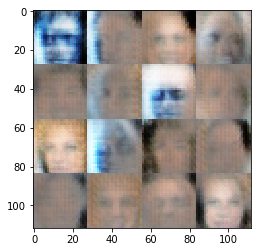

Epoch 1 / 1  D loss:  1.0930 ... G loss:  0.9845 ...
Epoch 1 / 1  D loss:  1.4020 ... G loss:  1.0158 ...
Epoch 1 / 1  D loss:  0.9709 ... G loss:  1.3495 ...
Epoch 1 / 1  D loss:  1.4438 ... G loss:  0.5890 ...
Epoch 1 / 1  D loss:  0.8945 ... G loss:  1.4249 ...
Epoch 1 / 1  D loss:  0.8793 ... G loss:  1.2082 ...
Epoch 1 / 1  D loss:  0.9515 ... G loss:  1.1697 ...
Epoch 1 / 1  D loss:  0.5570 ... G loss:  1.9200 ...
Epoch 1 / 1  D loss:  0.8406 ... G loss:  1.4977 ...
Epoch 1 / 1  D loss:  1.7598 ... G loss:  0.3360 ...
Step:  2100


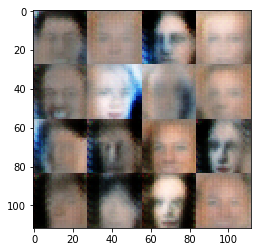

Epoch 1 / 1  D loss:  1.0786 ... G loss:  1.5505 ...
Epoch 1 / 1  D loss:  0.9774 ... G loss:  1.1646 ...
Epoch 1 / 1  D loss:  1.5805 ... G loss:  7.4381 ...
Epoch 1 / 1  D loss:  0.7388 ... G loss:  1.9509 ...
Epoch 1 / 1  D loss:  1.2209 ... G loss:  1.0103 ...
Epoch 1 / 1  D loss:  1.2107 ... G loss:  0.8638 ...
Epoch 1 / 1  D loss:  0.6036 ... G loss:  2.0404 ...
Epoch 1 / 1  D loss:  0.7600 ... G loss:  1.4589 ...
Epoch 1 / 1  D loss:  0.9354 ... G loss:  0.9778 ...
Epoch 1 / 1  D loss:  0.8448 ... G loss:  1.1905 ...
Step:  2200


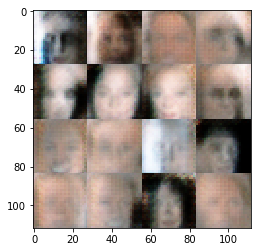

Epoch 1 / 1  D loss:  0.8894 ... G loss:  1.1441 ...
Epoch 1 / 1  D loss:  1.8055 ... G loss:  0.3534 ...
Epoch 1 / 1  D loss:  0.9493 ... G loss:  1.3796 ...
Epoch 1 / 1  D loss:  1.0800 ... G loss:  0.8704 ...
Epoch 1 / 1  D loss:  1.0572 ... G loss:  2.0158 ...
Epoch 1 / 1  D loss:  1.0987 ... G loss:  1.9878 ...
Epoch 1 / 1  D loss:  0.8847 ... G loss:  1.2087 ...
Epoch 1 / 1  D loss:  0.8918 ... G loss:  1.3863 ...
Epoch 1 / 1  D loss:  0.6940 ... G loss:  1.8577 ...
Epoch 1 / 1  D loss:  0.7290 ... G loss:  1.5104 ...
Step:  2300


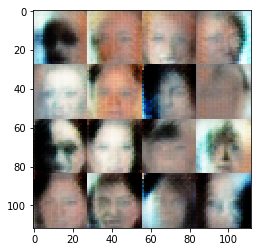

Epoch 1 / 1  D loss:  0.3842 ... G loss:  3.4776 ...
Epoch 1 / 1  D loss:  0.6729 ... G loss:  2.4049 ...
Epoch 1 / 1  D loss:  0.8277 ... G loss:  1.6310 ...
Epoch 1 / 1  D loss:  0.3707 ... G loss:  5.8360 ...
Epoch 1 / 1  D loss:  0.9994 ... G loss:  0.8530 ...
Epoch 1 / 1  D loss:  1.0788 ... G loss:  0.9855 ...
Epoch 1 / 1  D loss:  1.5322 ... G loss:  8.1256 ...
Epoch 1 / 1  D loss:  0.7010 ... G loss:  1.6635 ...
Epoch 1 / 1  D loss:  1.0962 ... G loss:  0.7775 ...
Epoch 1 / 1  D loss:  0.8024 ... G loss:  1.7450 ...
Step:  2400


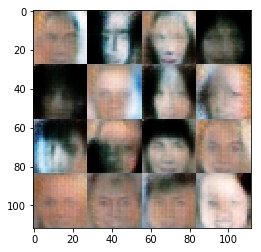

Epoch 1 / 1  D loss:  0.9618 ... G loss:  1.7032 ...
Epoch 1 / 1  D loss:  1.1755 ... G loss:  0.7714 ...
Epoch 1 / 1  D loss:  1.0925 ... G loss:  1.9418 ...
Epoch 1 / 1  D loss:  0.8350 ... G loss:  2.2848 ...
Epoch 1 / 1  D loss:  0.9825 ... G loss:  1.0217 ...
Epoch 1 / 1  D loss:  0.6956 ... G loss:  2.1398 ...
Epoch 1 / 1  D loss:  0.7809 ... G loss:  1.3179 ...
Epoch 1 / 1  D loss:  3.3175 ... G loss:  4.4762 ...
Epoch 1 / 1  D loss:  0.9838 ... G loss:  1.2584 ...
Epoch 1 / 1  D loss:  0.9552 ... G loss:  2.7927 ...
Step:  2500


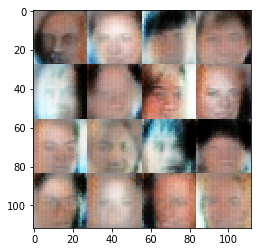

Epoch 1 / 1  D loss:  0.8322 ... G loss:  1.1628 ...
Epoch 1 / 1  D loss:  0.5409 ... G loss:  3.0471 ...
Epoch 1 / 1  D loss:  0.7505 ... G loss:  1.4260 ...
Epoch 1 / 1  D loss:  0.7902 ... G loss:  1.3059 ...
Epoch 1 / 1  D loss:  0.5301 ... G loss:  2.2776 ...
Epoch 1 / 1  D loss:  0.9869 ... G loss:  2.1573 ...
Epoch 1 / 1  D loss:  1.1843 ... G loss:  1.7065 ...
Epoch 1 / 1  D loss:  0.5659 ... G loss:  1.8614 ...
Epoch 1 / 1  D loss:  2.0444 ... G loss:  4.0470 ...
Epoch 1 / 1  D loss:  0.6095 ... G loss:  1.7879 ...
Step:  2600


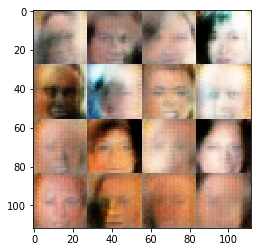

Epoch 1 / 1  D loss:  1.3589 ... G loss:  0.5621 ...
Epoch 1 / 1  D loss:  0.9394 ... G loss:  1.5395 ...
Epoch 1 / 1  D loss:  1.0733 ... G loss:  0.8166 ...
Epoch 1 / 1  D loss:  0.5705 ... G loss:  2.1498 ...
Epoch 1 / 1  D loss:  1.5434 ... G loss:  3.5075 ...
Epoch 1 / 1  D loss:  0.7024 ... G loss:  1.6343 ...
Epoch 1 / 1  D loss:  0.7992 ... G loss:  1.8579 ...
Epoch 1 / 1  D loss:  0.6878 ... G loss:  2.2757 ...
Epoch 1 / 1  D loss:  0.5370 ... G loss:  3.5490 ...
Epoch 1 / 1  D loss:  0.7103 ... G loss:  1.3653 ...
Step:  2700


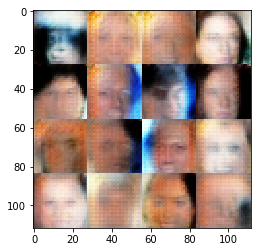

Epoch 1 / 1  D loss:  0.3643 ... G loss:  5.7520 ...
Epoch 1 / 1  D loss:  0.4840 ... G loss:  2.7930 ...
Epoch 1 / 1  D loss:  0.9110 ... G loss:  1.0526 ...
Epoch 1 / 1  D loss:  1.2178 ... G loss:  0.6731 ...
Epoch 1 / 1  D loss:  0.3721 ... G loss:  5.8004 ...
Epoch 1 / 1  D loss:  1.4799 ... G loss:  13.0196 ...
Epoch 1 / 1  D loss:  0.9944 ... G loss:  1.1725 ...
Epoch 1 / 1  D loss:  1.6016 ... G loss:  3.9810 ...
Epoch 1 / 1  D loss:  1.1004 ... G loss:  0.7806 ...
Epoch 1 / 1  D loss:  0.4864 ... G loss:  2.5100 ...
Step:  2800


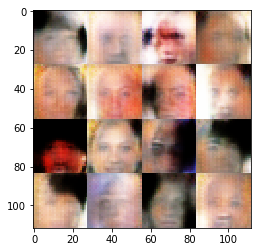

Epoch 1 / 1  D loss:  0.9162 ... G loss:  1.0271 ...
Epoch 1 / 1  D loss:  0.6888 ... G loss:  2.3678 ...
Epoch 1 / 1  D loss:  1.0080 ... G loss:  0.9182 ...
Epoch 1 / 1  D loss:  1.0417 ... G loss:  0.8742 ...
Epoch 1 / 1  D loss:  1.2901 ... G loss:  0.6123 ...
Epoch 1 / 1  D loss:  1.1119 ... G loss:  0.7461 ...
Epoch 1 / 1  D loss:  0.6426 ... G loss:  2.7588 ...
Epoch 1 / 1  D loss:  1.0439 ... G loss:  0.8714 ...
Epoch 1 / 1  D loss:  0.4833 ... G loss:  3.4338 ...
Epoch 1 / 1  D loss:  0.9058 ... G loss:  2.1899 ...
Step:  2900


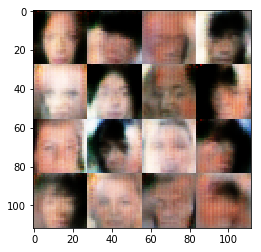

Epoch 1 / 1  D loss:  1.1929 ... G loss:  1.0832 ...
Epoch 1 / 1  D loss:  1.1229 ... G loss:  3.1599 ...
Epoch 1 / 1  D loss:  0.8957 ... G loss:  1.3009 ...
Epoch 1 / 1  D loss:  1.2659 ... G loss:  2.2444 ...
Epoch 1 / 1  D loss:  1.1095 ... G loss:  0.8970 ...
Epoch 1 / 1  D loss:  0.5574 ... G loss:  2.3833 ...
Epoch 1 / 1  D loss:  0.6578 ... G loss:  1.7220 ...
Epoch 1 / 1  D loss:  1.5803 ... G loss:  2.6928 ...
Epoch 1 / 1  D loss:  0.6880 ... G loss:  1.8841 ...
Epoch 1 / 1  D loss:  1.2626 ... G loss:  0.6335 ...
Step:  3000


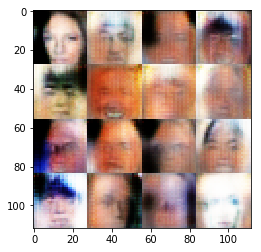

Epoch 1 / 1  D loss:  1.3325 ... G loss:  2.4869 ...
Epoch 1 / 1  D loss:  1.0002 ... G loss:  2.1208 ...
Epoch 1 / 1  D loss:  0.3537 ... G loss:  5.6624 ...
Epoch 1 / 1  D loss:  0.6873 ... G loss:  2.2395 ...
Epoch 1 / 1  D loss:  0.8478 ... G loss:  2.2671 ...
Epoch 1 / 1  D loss:  0.8410 ... G loss:  1.3072 ...
Epoch 1 / 1  D loss:  0.7364 ... G loss:  2.3830 ...
Epoch 1 / 1  D loss:  0.3864 ... G loss:  3.4944 ...
Epoch 1 / 1  D loss:  0.6834 ... G loss:  1.9554 ...
Epoch 1 / 1  D loss:  1.1251 ... G loss:  0.7354 ...
Step:  3100


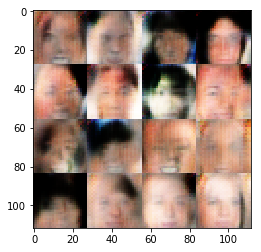

Epoch 1 / 1  D loss:  0.9209 ... G loss:  0.9907 ...
Epoch 1 / 1  D loss:  0.3649 ... G loss:  5.1865 ...
Epoch 1 / 1  D loss:  0.7409 ... G loss:  1.5941 ...
Epoch 1 / 1  D loss:  0.4561 ... G loss:  2.6687 ...
Epoch 1 / 1  D loss:  0.6864 ... G loss:  1.6257 ...
Epoch 1 / 1  D loss:  0.8472 ... G loss:  1.1251 ...
Epoch 1 / 1  D loss:  1.3200 ... G loss:  0.5665 ...


In [65]:
# alpha = .2
# learning rate 1e-4 to 3e-4
losses = train( net, epoch_count, batch_size, z_dim, 
                celeba_dataset.get_batches, celeba_dataset.image_mode)

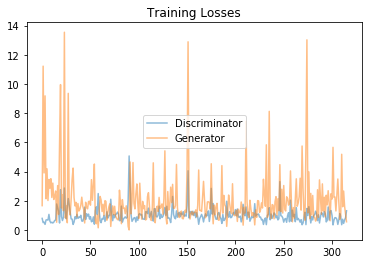

In [66]:
print_losses_chart(losses)

---

Step:  1


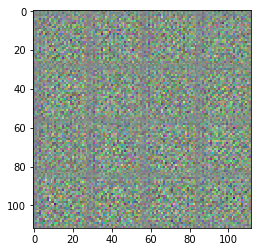

Epoch 1 / 1  D loss:  1.3629 ... G loss:  2.6094 ...
Epoch 1 / 1  D loss:  1.0736 ... G loss:  0.8894 ...
Epoch 1 / 1  D loss:  0.6383 ... G loss:  2.0094 ...
Epoch 1 / 1  D loss:  0.7994 ... G loss:  1.6188 ...
Epoch 1 / 1  D loss:  0.6704 ... G loss:  3.5394 ...
Epoch 1 / 1  D loss:  0.6316 ... G loss:  3.5981 ...
Epoch 1 / 1  D loss:  0.6490 ... G loss:  2.0576 ...
Epoch 1 / 1  D loss:  0.8128 ... G loss:  1.6778 ...
Epoch 1 / 1  D loss:  0.7658 ... G loss:  2.0408 ...
Step:  100


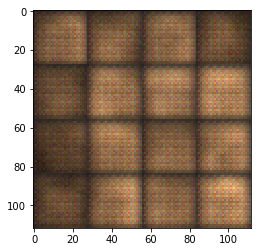

Epoch 1 / 1  D loss:  0.5594 ... G loss:  2.3357 ...
Epoch 1 / 1  D loss:  0.7157 ... G loss:  2.4862 ...
Epoch 1 / 1  D loss:  0.5670 ... G loss:  2.0266 ...
Epoch 1 / 1  D loss:  0.7165 ... G loss:  6.2294 ...
Epoch 1 / 1  D loss:  0.7245 ... G loss:  2.5536 ...
Epoch 1 / 1  D loss:  0.4962 ... G loss:  2.9296 ...
Epoch 1 / 1  D loss:  1.5482 ... G loss:  0.5847 ...
Epoch 1 / 1  D loss:  0.9585 ... G loss:  6.0053 ...
Epoch 1 / 1  D loss:  0.9134 ... G loss:  1.3145 ...
Epoch 1 / 1  D loss:  0.6754 ... G loss:  2.5010 ...
Step:  200


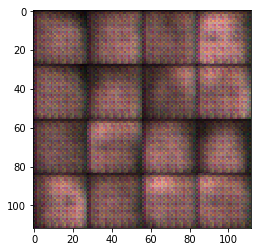

Epoch 1 / 1  D loss:  0.9218 ... G loss:  1.3220 ...
Epoch 1 / 1  D loss:  0.9402 ... G loss:  1.1087 ...
Epoch 1 / 1  D loss:  1.1446 ... G loss:  0.8810 ...
Epoch 1 / 1  D loss:  1.4090 ... G loss:  0.5825 ...
Epoch 1 / 1  D loss:  0.7737 ... G loss:  1.4190 ...
Epoch 1 / 1  D loss:  0.8110 ... G loss:  2.2982 ...
Epoch 1 / 1  D loss:  0.7394 ... G loss:  1.4072 ...
Epoch 1 / 1  D loss:  0.7522 ... G loss:  4.5344 ...
Epoch 1 / 1  D loss:  0.7014 ... G loss:  1.8839 ...
Epoch 1 / 1  D loss:  2.4878 ... G loss:  0.1375 ...
Step:  300


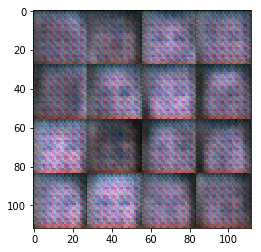

Epoch 1 / 1  D loss:  0.8684 ... G loss:  2.1634 ...
Epoch 1 / 1  D loss:  1.2093 ... G loss:  5.6758 ...
Epoch 1 / 1  D loss:  0.7225 ... G loss:  2.0133 ...
Epoch 1 / 1  D loss:  0.8278 ... G loss:  3.0335 ...
Epoch 1 / 1  D loss:  0.7543 ... G loss:  1.4806 ...
Epoch 1 / 1  D loss:  0.8395 ... G loss:  1.4114 ...
Epoch 1 / 1  D loss:  0.8893 ... G loss:  1.8826 ...
Epoch 1 / 1  D loss:  1.1231 ... G loss:  0.9208 ...
Epoch 1 / 1  D loss:  0.8627 ... G loss:  1.8137 ...
Epoch 1 / 1  D loss:  0.9686 ... G loss:  1.3392 ...
Step:  400


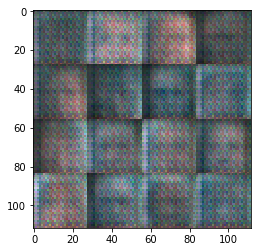

Epoch 1 / 1  D loss:  1.4389 ... G loss:  0.5581 ...
Epoch 1 / 1  D loss:  0.6369 ... G loss:  2.7083 ...
Epoch 1 / 1  D loss:  0.6752 ... G loss:  2.7804 ...
Epoch 1 / 1  D loss:  1.0150 ... G loss:  0.9837 ...
Epoch 1 / 1  D loss:  0.8191 ... G loss:  1.3578 ...
Epoch 1 / 1  D loss:  0.8565 ... G loss:  1.1184 ...
Epoch 1 / 1  D loss:  1.3517 ... G loss:  0.4845 ...
Epoch 1 / 1  D loss:  0.6185 ... G loss:  2.4339 ...
Epoch 1 / 1  D loss:  0.5483 ... G loss:  2.4433 ...
Epoch 1 / 1  D loss:  1.0947 ... G loss:  8.8918 ...
Step:  500


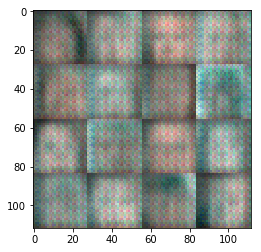

Epoch 1 / 1  D loss:  0.6998 ... G loss:  2.2577 ...
Epoch 1 / 1  D loss:  0.4620 ... G loss:  3.1001 ...
Epoch 1 / 1  D loss:  0.6463 ... G loss:  3.9709 ...
Epoch 1 / 1  D loss:  1.1408 ... G loss:  0.8043 ...
Epoch 1 / 1  D loss:  0.9425 ... G loss:  1.0741 ...
Epoch 1 / 1  D loss:  0.7435 ... G loss:  1.8666 ...
Epoch 1 / 1  D loss:  0.6269 ... G loss:  1.8504 ...
Epoch 1 / 1  D loss:  0.6319 ... G loss:  1.7768 ...
Epoch 1 / 1  D loss:  0.6860 ... G loss:  2.4967 ...
Epoch 1 / 1  D loss:  0.7961 ... G loss:  2.0915 ...
Step:  600


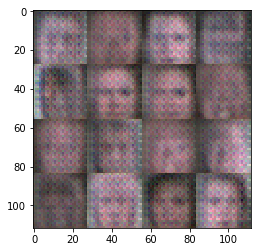

Epoch 1 / 1  D loss:  0.6572 ... G loss:  1.9091 ...
Epoch 1 / 1  D loss:  0.6972 ... G loss:  1.9506 ...
Epoch 1 / 1  D loss:  0.8468 ... G loss:  1.3725 ...
Epoch 1 / 1  D loss:  0.7107 ... G loss:  1.7917 ...
Epoch 1 / 1  D loss:  0.7720 ... G loss:  1.2106 ...
Epoch 1 / 1  D loss:  0.7461 ... G loss:  4.3109 ...
Epoch 1 / 1  D loss:  0.5693 ... G loss:  1.7905 ...
Epoch 1 / 1  D loss:  0.6596 ... G loss:  1.8383 ...
Epoch 1 / 1  D loss:  0.8255 ... G loss:  1.6160 ...
Epoch 1 / 1  D loss:  0.7576 ... G loss:  3.3038 ...
Step:  700


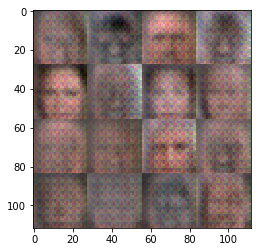

Epoch 1 / 1  D loss:  0.7443 ... G loss:  1.7945 ...
Epoch 1 / 1  D loss:  1.2535 ... G loss:  0.9745 ...
Epoch 1 / 1  D loss:  1.0437 ... G loss:  1.0085 ...
Epoch 1 / 1  D loss:  0.7469 ... G loss:  4.5224 ...
Epoch 1 / 1  D loss:  0.8871 ... G loss:  1.6154 ...
Epoch 1 / 1  D loss:  4.6006 ... G loss:  0.0149 ...
Epoch 1 / 1  D loss:  1.2159 ... G loss:  1.3124 ...
Epoch 1 / 1  D loss:  1.3049 ... G loss:  2.2397 ...
Epoch 1 / 1  D loss:  0.7725 ... G loss:  1.6467 ...
Epoch 1 / 1  D loss:  0.8612 ... G loss:  1.1587 ...
Step:  800


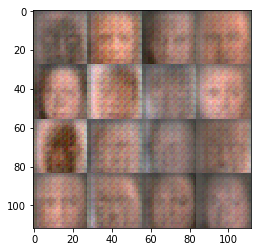

Epoch 1 / 1  D loss:  2.5918 ... G loss:  0.1172 ...
Epoch 1 / 1  D loss:  1.0932 ... G loss:  0.8875 ...
Epoch 1 / 1  D loss:  0.8103 ... G loss:  2.2508 ...
Epoch 1 / 1  D loss:  0.9163 ... G loss:  1.5109 ...
Epoch 1 / 1  D loss:  1.0403 ... G loss:  1.1955 ...
Epoch 1 / 1  D loss:  0.4759 ... G loss:  3.6042 ...
Epoch 1 / 1  D loss:  0.9103 ... G loss:  1.3046 ...
Epoch 1 / 1  D loss:  0.9638 ... G loss:  1.6378 ...
Epoch 1 / 1  D loss:  0.5956 ... G loss:  2.4183 ...
Epoch 1 / 1  D loss:  1.2930 ... G loss:  0.6610 ...
Step:  900


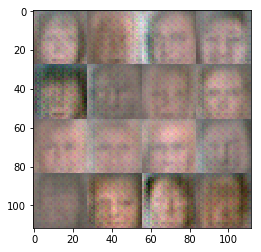

Epoch 1 / 1  D loss:  0.8642 ... G loss:  1.2634 ...
Epoch 1 / 1  D loss:  0.6608 ... G loss:  1.8258 ...
Epoch 1 / 1  D loss:  1.0842 ... G loss:  1.0760 ...
Epoch 1 / 1  D loss:  1.1811 ... G loss:  0.8227 ...
Epoch 1 / 1  D loss:  0.8673 ... G loss:  2.6449 ...
Epoch 1 / 1  D loss:  0.7322 ... G loss:  1.8637 ...
Epoch 1 / 1  D loss:  1.2260 ... G loss:  0.8095 ...
Epoch 1 / 1  D loss:  0.8516 ... G loss:  1.2678 ...
Epoch 1 / 1  D loss:  0.9422 ... G loss:  1.1075 ...
Epoch 1 / 1  D loss:  0.6936 ... G loss:  2.7212 ...
Step:  1000


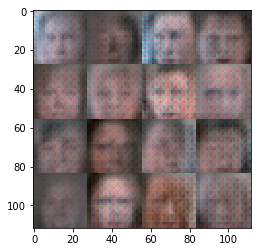

Epoch 1 / 1  D loss:  0.9183 ... G loss:  1.1857 ...
Epoch 1 / 1  D loss:  1.0778 ... G loss:  1.7698 ...
Epoch 1 / 1  D loss:  0.9567 ... G loss:  2.1416 ...
Epoch 1 / 1  D loss:  1.9109 ... G loss:  0.2490 ...
Epoch 1 / 1  D loss:  0.7604 ... G loss:  1.5020 ...
Epoch 1 / 1  D loss:  0.6186 ... G loss:  2.3389 ...
Epoch 1 / 1  D loss:  0.7457 ... G loss:  1.5048 ...
Epoch 1 / 1  D loss:  0.6981 ... G loss:  1.8413 ...
Epoch 1 / 1  D loss:  0.7047 ... G loss:  1.5632 ...
Epoch 1 / 1  D loss:  0.6194 ... G loss:  1.9332 ...
Step:  1100


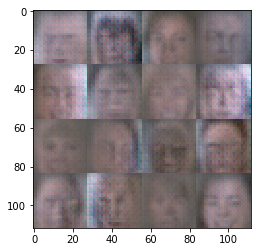

Epoch 1 / 1  D loss:  0.9590 ... G loss:  1.6101 ...
Epoch 1 / 1  D loss:  1.1298 ... G loss:  1.5406 ...
Epoch 1 / 1  D loss:  1.2677 ... G loss:  0.9469 ...
Epoch 1 / 1  D loss:  0.9393 ... G loss:  2.2712 ...
Epoch 1 / 1  D loss:  0.5583 ... G loss:  2.5191 ...
Epoch 1 / 1  D loss:  1.2692 ... G loss:  0.7157 ...
Epoch 1 / 1  D loss:  0.9380 ... G loss:  1.1362 ...
Epoch 1 / 1  D loss:  0.8355 ... G loss:  1.1769 ...
Epoch 1 / 1  D loss:  0.5651 ... G loss:  2.5695 ...
Epoch 1 / 1  D loss:  0.7490 ... G loss:  1.9195 ...
Step:  1200


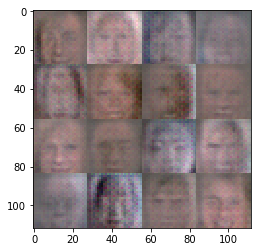

Epoch 1 / 1  D loss:  0.6649 ... G loss:  2.5285 ...
Epoch 1 / 1  D loss:  0.7884 ... G loss:  3.2050 ...
Epoch 1 / 1  D loss:  0.9322 ... G loss:  1.2120 ...
Epoch 1 / 1  D loss:  0.6470 ... G loss:  1.6775 ...
Epoch 1 / 1  D loss:  0.7044 ... G loss:  1.4686 ...
Epoch 1 / 1  D loss:  0.5268 ... G loss:  2.0338 ...
Epoch 1 / 1  D loss:  0.5849 ... G loss:  2.9236 ...
Epoch 1 / 1  D loss:  0.4181 ... G loss:  3.2352 ...
Epoch 1 / 1  D loss:  0.6892 ... G loss:  1.7895 ...
Epoch 1 / 1  D loss:  0.8761 ... G loss:  1.4469 ...
Step:  1300


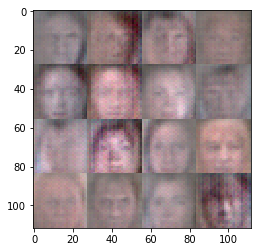

Epoch 1 / 1  D loss:  0.7079 ... G loss:  1.4302 ...
Epoch 1 / 1  D loss:  0.4336 ... G loss:  3.8085 ...
Epoch 1 / 1  D loss:  0.5243 ... G loss:  4.7574 ...
Epoch 1 / 1  D loss:  0.6337 ... G loss:  2.2034 ...
Epoch 1 / 1  D loss:  0.6974 ... G loss:  1.5363 ...
Epoch 1 / 1  D loss:  1.5887 ... G loss:  0.4187 ...
Epoch 1 / 1  D loss:  0.8465 ... G loss:  1.1427 ...
Epoch 1 / 1  D loss:  0.3767 ... G loss:  4.2331 ...
Epoch 1 / 1  D loss:  0.4527 ... G loss:  2.8857 ...
Epoch 1 / 1  D loss:  0.7401 ... G loss:  4.7793 ...
Step:  1400


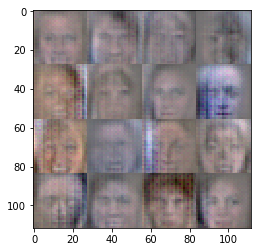

Epoch 1 / 1  D loss:  0.3696 ... G loss:  4.6813 ...
Epoch 1 / 1  D loss:  0.4204 ... G loss:  3.1865 ...
Epoch 1 / 1  D loss:  0.4049 ... G loss:  4.9387 ...
Epoch 1 / 1  D loss:  0.6314 ... G loss:  1.7088 ...
Epoch 1 / 1  D loss:  0.3960 ... G loss:  3.5765 ...
Epoch 1 / 1  D loss:  0.5002 ... G loss:  3.7325 ...
Epoch 1 / 1  D loss:  0.4205 ... G loss:  3.1024 ...
Epoch 1 / 1  D loss:  0.5704 ... G loss:  2.1493 ...
Epoch 1 / 1  D loss:  0.4199 ... G loss:  3.0426 ...
Epoch 1 / 1  D loss:  1.6239 ... G loss:  0.4408 ...
Step:  1500


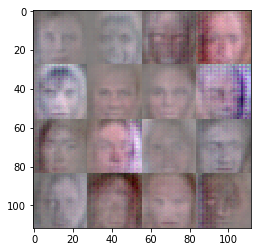

Epoch 1 / 1  D loss:  0.5706 ... G loss:  1.8151 ...
Epoch 1 / 1  D loss:  0.5217 ... G loss:  3.8862 ...
Epoch 1 / 1  D loss:  0.4341 ... G loss:  4.3088 ...
Epoch 1 / 1  D loss:  0.4157 ... G loss:  4.6745 ...
Epoch 1 / 1  D loss:  0.3676 ... G loss:  8.2086 ...
Epoch 1 / 1  D loss:  0.4488 ... G loss:  2.6914 ...
Epoch 1 / 1  D loss:  0.9610 ... G loss:  0.9850 ...
Epoch 1 / 1  D loss:  0.4439 ... G loss:  3.7150 ...
Epoch 1 / 1  D loss:  0.4306 ... G loss:  4.1647 ...
Epoch 1 / 1  D loss:  0.4393 ... G loss:  2.9198 ...
Step:  1600


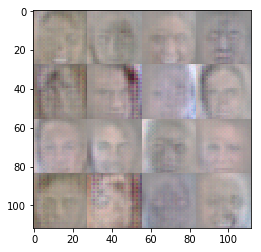

Epoch 1 / 1  D loss:  0.9127 ... G loss:  0.9902 ...
Epoch 1 / 1  D loss:  0.5442 ... G loss:  1.7573 ...
Epoch 1 / 1  D loss:  0.4271 ... G loss:  2.9595 ...
Epoch 1 / 1  D loss:  0.3496 ... G loss:  8.3512 ...
Epoch 1 / 1  D loss:  0.4943 ... G loss:  2.3496 ...
Epoch 1 / 1  D loss:  1.7093 ... G loss:  0.3862 ...
Epoch 1 / 1  D loss:  0.6269 ... G loss:  1.7647 ...
Epoch 1 / 1  D loss:  0.5084 ... G loss:  2.1861 ...
Epoch 1 / 1  D loss:  0.5354 ... G loss:  3.0182 ...
Epoch 1 / 1  D loss:  0.7086 ... G loss:  1.4333 ...
Step:  1700


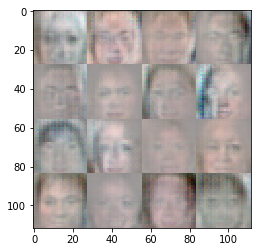

Epoch 1 / 1  D loss:  0.4301 ... G loss:  4.0506 ...
Epoch 1 / 1  D loss:  0.5872 ... G loss:  1.7250 ...
Epoch 1 / 1  D loss:  0.5099 ... G loss:  3.1517 ...
Epoch 1 / 1  D loss:  0.4031 ... G loss:  5.8218 ...
Epoch 1 / 1  D loss:  0.9663 ... G loss:  0.9492 ...
Epoch 1 / 1  D loss:  0.6841 ... G loss:  2.8474 ...
Epoch 1 / 1  D loss:  0.4115 ... G loss:  3.0054 ...
Epoch 1 / 1  D loss:  0.4748 ... G loss:  4.1628 ...
Epoch 1 / 1  D loss:  0.5976 ... G loss:  1.6657 ...
Epoch 1 / 1  D loss:  0.4011 ... G loss:  3.3725 ...
Step:  1800


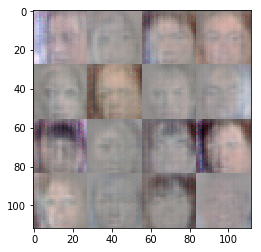

Epoch 1 / 1  D loss:  0.4187 ... G loss:  3.1215 ...
Epoch 1 / 1  D loss:  0.6110 ... G loss:  1.7082 ...
Epoch 1 / 1  D loss:  0.3633 ... G loss:  5.8836 ...
Epoch 1 / 1  D loss:  0.3942 ... G loss:  4.2905 ...
Epoch 1 / 1  D loss:  0.5942 ... G loss:  1.7944 ...
Epoch 1 / 1  D loss:  0.5701 ... G loss:  1.8681 ...
Epoch 1 / 1  D loss:  0.4024 ... G loss:  3.2101 ...
Epoch 1 / 1  D loss:  0.3481 ... G loss:  6.6062 ...
Epoch 1 / 1  D loss:  0.3473 ... G loss:  9.3217 ...
Epoch 1 / 1  D loss:  0.3736 ... G loss:  4.3249 ...
Step:  1900


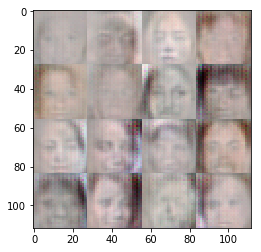

Epoch 1 / 1  D loss:  0.4611 ... G loss:  2.6044 ...
Epoch 1 / 1  D loss:  0.6473 ... G loss:  1.4375 ...
Epoch 1 / 1  D loss:  0.7814 ... G loss:  1.1672 ...
Epoch 1 / 1  D loss:  0.4656 ... G loss:  3.0617 ...
Epoch 1 / 1  D loss:  0.6526 ... G loss:  1.8397 ...
Epoch 1 / 1  D loss:  1.0273 ... G loss:  0.8190 ...
Epoch 1 / 1  D loss:  1.7584 ... G loss:  4.6869 ...
Epoch 1 / 1  D loss:  0.4070 ... G loss:  3.2056 ...
Epoch 1 / 1  D loss:  0.4239 ... G loss:  3.4074 ...
Epoch 1 / 1  D loss:  0.6401 ... G loss:  1.6480 ...
Step:  2000


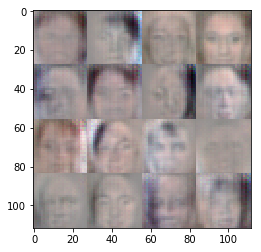

Epoch 1 / 1  D loss:  0.6416 ... G loss:  1.5025 ...
Epoch 1 / 1  D loss:  0.6054 ... G loss:  1.6865 ...
Epoch 1 / 1  D loss:  0.5696 ... G loss:  5.5343 ...
Epoch 1 / 1  D loss:  0.5066 ... G loss:  2.3592 ...
Epoch 1 / 1  D loss:  0.3761 ... G loss:  4.8102 ...
Epoch 1 / 1  D loss:  0.4567 ... G loss:  6.4847 ...
Epoch 1 / 1  D loss:  0.5534 ... G loss:  1.9400 ...
Epoch 1 / 1  D loss:  0.6344 ... G loss:  1.6415 ...
Epoch 1 / 1  D loss:  0.4506 ... G loss:  2.6764 ...
Epoch 1 / 1  D loss:  0.3461 ... G loss:  5.3501 ...
Step:  2100


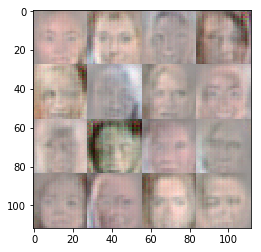

Epoch 1 / 1  D loss:  0.4820 ... G loss:  2.5623 ...
Epoch 1 / 1  D loss:  0.3487 ... G loss:  11.2353 ...
Epoch 1 / 1  D loss:  0.4126 ... G loss:  3.4527 ...
Epoch 1 / 1  D loss:  0.6119 ... G loss:  2.1074 ...
Epoch 1 / 1  D loss:  0.4443 ... G loss:  3.1279 ...
Epoch 1 / 1  D loss:  0.3517 ... G loss:  10.3059 ...
Epoch 1 / 1  D loss:  0.4395 ... G loss:  5.0527 ...
Epoch 1 / 1  D loss:  0.4579 ... G loss:  5.6927 ...
Epoch 1 / 1  D loss:  0.5167 ... G loss:  2.2612 ...
Epoch 1 / 1  D loss:  0.6118 ... G loss:  1.6402 ...
Step:  2200


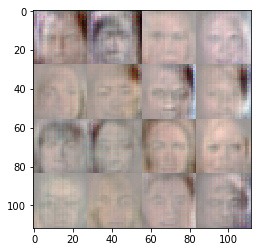

Epoch 1 / 1  D loss:  0.4645 ... G loss:  2.9938 ...
Epoch 1 / 1  D loss:  0.6333 ... G loss:  1.6309 ...
Epoch 1 / 1  D loss:  0.4256 ... G loss:  2.9562 ...
Epoch 1 / 1  D loss:  0.4208 ... G loss:  3.2108 ...
Epoch 1 / 1  D loss:  0.3758 ... G loss:  4.1277 ...
Epoch 1 / 1  D loss:  0.8178 ... G loss:  2.5194 ...
Epoch 1 / 1  D loss:  0.7303 ... G loss:  1.4120 ...
Epoch 1 / 1  D loss:  0.4331 ... G loss:  3.2952 ...
Epoch 1 / 1  D loss:  0.3496 ... G loss:  8.8199 ...
Epoch 1 / 1  D loss:  0.4386 ... G loss:  3.1884 ...
Step:  2300


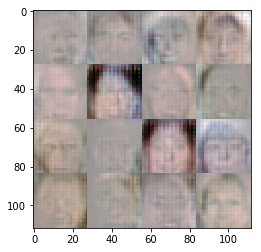

Epoch 1 / 1  D loss:  0.4575 ... G loss:  2.5601 ...
Epoch 1 / 1  D loss:  0.4067 ... G loss:  3.3175 ...
Epoch 1 / 1  D loss:  0.4407 ... G loss:  3.6930 ...
Epoch 1 / 1  D loss:  0.9557 ... G loss:  0.9154 ...
Epoch 1 / 1  D loss:  0.6200 ... G loss:  1.6484 ...
Epoch 1 / 1  D loss:  0.4748 ... G loss:  2.4999 ...
Epoch 1 / 1  D loss:  0.6164 ... G loss:  1.6552 ...
Epoch 1 / 1  D loss:  0.4224 ... G loss:  3.1206 ...
Epoch 1 / 1  D loss:  0.3850 ... G loss:  11.2706 ...
Epoch 1 / 1  D loss:  0.4398 ... G loss:  2.5035 ...
Step:  2400


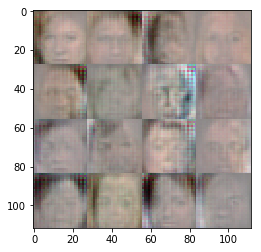

Epoch 1 / 1  D loss:  0.5916 ... G loss:  3.5217 ...
Epoch 1 / 1  D loss:  0.9590 ... G loss:  1.0085 ...
Epoch 1 / 1  D loss:  0.3557 ... G loss:  9.9748 ...
Epoch 1 / 1  D loss:  0.3745 ... G loss:  4.3445 ...
Epoch 1 / 1  D loss:  0.3484 ... G loss:  12.6300 ...
Epoch 1 / 1  D loss:  0.4967 ... G loss:  2.3868 ...
Epoch 1 / 1  D loss:  0.3451 ... G loss:  10.5574 ...
Epoch 1 / 1  D loss:  0.5130 ... G loss:  2.9888 ...
Epoch 1 / 1  D loss:  0.6337 ... G loss:  2.2970 ...
Epoch 1 / 1  D loss:  0.4608 ... G loss:  3.0798 ...
Step:  2500


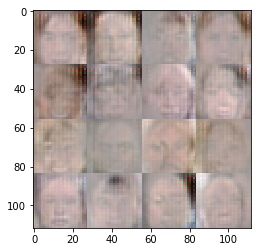

Epoch 1 / 1  D loss:  0.6955 ... G loss:  1.4880 ...
Epoch 1 / 1  D loss:  0.4719 ... G loss:  2.3495 ...
Epoch 1 / 1  D loss:  0.3635 ... G loss:  5.8680 ...
Epoch 1 / 1  D loss:  0.5540 ... G loss:  3.0890 ...
Epoch 1 / 1  D loss:  0.3576 ... G loss:  5.7046 ...
Epoch 1 / 1  D loss:  0.7932 ... G loss:  1.6244 ...
Epoch 1 / 1  D loss:  0.4872 ... G loss:  3.5531 ...
Epoch 1 / 1  D loss:  0.6661 ... G loss:  1.6807 ...
Epoch 1 / 1  D loss:  0.3521 ... G loss:  10.8590 ...
Epoch 1 / 1  D loss:  0.4102 ... G loss:  3.1146 ...
Step:  2600


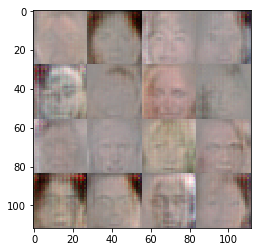

Epoch 1 / 1  D loss:  0.4670 ... G loss:  2.4166 ...
Epoch 1 / 1  D loss:  0.5672 ... G loss:  1.9357 ...
Epoch 1 / 1  D loss:  0.5717 ... G loss:  2.1199 ...
Epoch 1 / 1  D loss:  0.5697 ... G loss:  1.9291 ...
Epoch 1 / 1  D loss:  0.5152 ... G loss:  2.1077 ...
Epoch 1 / 1  D loss:  0.4833 ... G loss:  2.3375 ...
Epoch 1 / 1  D loss:  0.3615 ... G loss:  4.5747 ...
Epoch 1 / 1  D loss:  0.4128 ... G loss:  3.1061 ...
Epoch 1 / 1  D loss:  0.3780 ... G loss:  3.8527 ...
Epoch 1 / 1  D loss:  0.4697 ... G loss:  2.7003 ...
Step:  2700


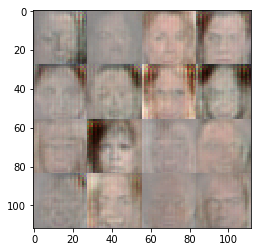

Epoch 1 / 1  D loss:  0.5179 ... G loss:  2.3183 ...
Epoch 1 / 1  D loss:  0.6687 ... G loss:  1.5197 ...
Epoch 1 / 1  D loss:  0.6350 ... G loss:  2.4493 ...
Epoch 1 / 1  D loss:  0.3602 ... G loss:  5.5160 ...
Epoch 1 / 1  D loss:  0.5684 ... G loss:  2.2823 ...
Epoch 1 / 1  D loss:  0.4184 ... G loss:  3.2918 ...
Epoch 1 / 1  D loss:  0.9905 ... G loss:  4.4207 ...
Epoch 1 / 1  D loss:  0.6292 ... G loss:  1.8737 ...
Epoch 1 / 1  D loss:  0.4584 ... G loss:  3.2942 ...
Epoch 1 / 1  D loss:  0.6084 ... G loss:  2.0219 ...
Step:  2800


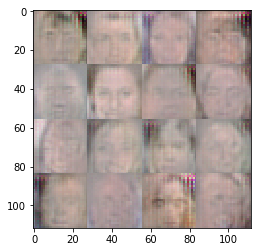

Epoch 1 / 1  D loss:  0.5634 ... G loss:  1.9179 ...
Epoch 1 / 1  D loss:  0.4567 ... G loss:  2.6715 ...
Epoch 1 / 1  D loss:  0.5608 ... G loss:  1.9197 ...
Epoch 1 / 1  D loss:  0.3943 ... G loss:  3.6796 ...
Epoch 1 / 1  D loss:  0.4337 ... G loss:  3.0660 ...
Epoch 1 / 1  D loss:  0.7020 ... G loss:  1.4014 ...
Epoch 1 / 1  D loss:  0.3751 ... G loss:  8.2284 ...
Epoch 1 / 1  D loss:  0.4549 ... G loss:  2.7815 ...
Epoch 1 / 1  D loss:  0.3431 ... G loss:  9.9518 ...
Epoch 1 / 1  D loss:  0.3691 ... G loss:  4.2377 ...
Step:  2900


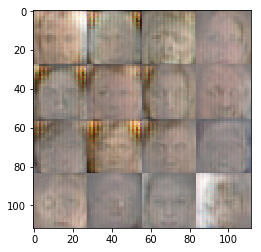

Epoch 1 / 1  D loss:  0.4217 ... G loss:  3.3104 ...
Epoch 1 / 1  D loss:  0.3434 ... G loss:  6.0982 ...
Epoch 1 / 1  D loss:  0.3696 ... G loss:  4.1850 ...
Epoch 1 / 1  D loss:  0.4927 ... G loss:  2.3744 ...
Epoch 1 / 1  D loss:  0.5626 ... G loss:  2.0505 ...
Epoch 1 / 1  D loss:  0.3679 ... G loss:  4.1317 ...
Epoch 1 / 1  D loss:  0.4563 ... G loss:  2.4480 ...
Epoch 1 / 1  D loss:  0.3698 ... G loss:  12.9211 ...
Epoch 1 / 1  D loss:  1.0189 ... G loss:  0.9875 ...
Epoch 1 / 1  D loss:  0.6883 ... G loss:  1.5879 ...
Step:  3000


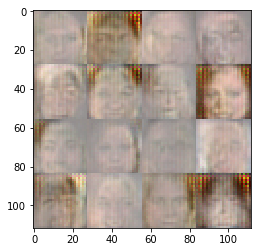

Epoch 1 / 1  D loss:  0.4789 ... G loss:  2.7902 ...
Epoch 1 / 1  D loss:  0.6316 ... G loss:  1.8165 ...
Epoch 1 / 1  D loss:  0.5340 ... G loss:  2.1903 ...
Epoch 1 / 1  D loss:  0.3560 ... G loss:  10.1556 ...
Epoch 1 / 1  D loss:  0.4634 ... G loss:  2.5744 ...
Epoch 1 / 1  D loss:  0.3680 ... G loss:  6.9474 ...
Epoch 1 / 1  D loss:  0.4713 ... G loss:  3.4567 ...
Epoch 1 / 1  D loss:  0.4226 ... G loss:  3.0211 ...
Epoch 1 / 1  D loss:  0.6364 ... G loss:  1.5792 ...
Epoch 1 / 1  D loss:  0.4711 ... G loss:  8.0282 ...
Step:  3100


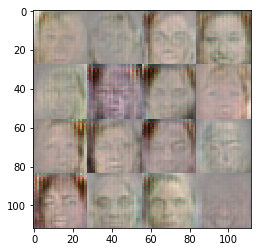

Epoch 1 / 1  D loss:  0.6249 ... G loss:  1.8729 ...
Epoch 1 / 1  D loss:  0.4925 ... G loss:  2.5826 ...
Epoch 1 / 1  D loss:  0.5945 ... G loss:  1.8214 ...
Epoch 1 / 1  D loss:  0.4959 ... G loss:  3.5788 ...
Epoch 1 / 1  D loss:  0.4321 ... G loss:  3.2752 ...
Epoch 1 / 1  D loss:  0.5365 ... G loss:  2.1195 ...
Epoch 1 / 1  D loss:  0.6635 ... G loss:  1.6225 ...


In [58]:
# alpha = .3
# learning rate = 1e-4
# back to same size networks
losses = train( net, epoch_count, batch_size, z_dim, 
                celeba_dataset.get_batches, celeba_dataset.image_mode)

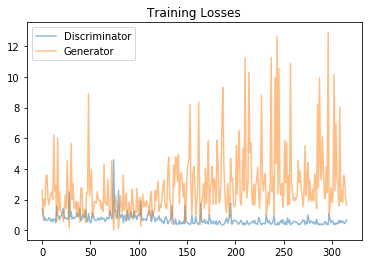

In [59]:
print_losses_chart(losses)

---

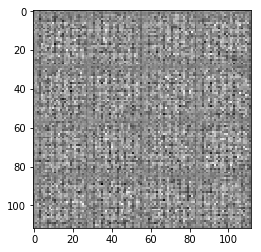

Epoch 1 / 1  D loss:  1.3768 ... G loss:  0.6715 ...
Epoch 1 / 1  D loss:  0.6615 ... G loss:  5.6008 ...
Epoch 1 / 1  D loss:  0.4704 ... G loss:  15.2820 ...
Epoch 1 / 1  D loss:  0.4858 ... G loss:  8.7059 ...
Epoch 1 / 1  D loss:  0.3903 ... G loss:  4.8531 ...
Epoch 1 / 1  D loss:  0.4230 ... G loss:  20.3050 ...
Epoch 1 / 1  D loss:  0.3837 ... G loss:  11.1667 ...
Epoch 1 / 1  D loss:  1.0334 ... G loss:  0.9382 ...
Epoch 1 / 1  D loss:  0.9588 ... G loss:  0.9975 ...


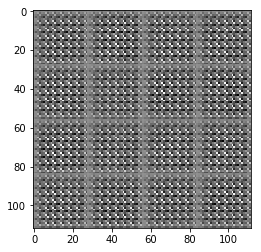

Epoch 1 / 1  D loss:  0.7051 ... G loss:  4.0260 ...
Epoch 1 / 1  D loss:  0.5896 ... G loss:  19.8428 ...
Epoch 1 / 1  D loss:  0.5084 ... G loss:  7.4784 ...
Epoch 1 / 1  D loss:  0.5039 ... G loss:  3.0982 ...
Epoch 1 / 1  D loss:  0.3922 ... G loss:  8.5482 ...
Epoch 1 / 1  D loss:  0.3787 ... G loss:  9.8130 ...
Epoch 1 / 1  D loss:  0.3720 ... G loss:  5.7105 ...
Epoch 1 / 1  D loss:  0.3599 ... G loss:  5.4596 ...
Epoch 1 / 1  D loss:  0.4036 ... G loss:  3.4291 ...
Epoch 1 / 1  D loss:  0.3547 ... G loss:  8.6544 ...


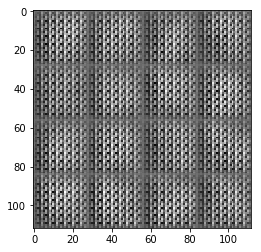

Epoch 1 / 1  D loss:  0.3576 ... G loss:  6.9915 ...
Epoch 1 / 1  D loss:  0.3497 ... G loss:  6.6814 ...
Epoch 1 / 1  D loss:  0.3985 ... G loss:  3.2168 ...
Epoch 1 / 1  D loss:  0.3837 ... G loss:  4.8813 ...
Epoch 1 / 1  D loss:  0.3914 ... G loss:  3.9081 ...
Epoch 1 / 1  D loss:  0.4290 ... G loss:  3.4079 ...
Epoch 1 / 1  D loss:  0.3878 ... G loss:  7.2335 ...
Epoch 1 / 1  D loss:  0.4121 ... G loss:  4.1539 ...
Epoch 1 / 1  D loss:  0.4483 ... G loss:  3.2831 ...
Epoch 1 / 1  D loss:  0.3985 ... G loss:  9.1614 ...


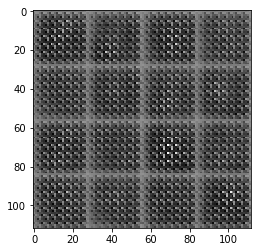

Epoch 1 / 1  D loss:  0.4144 ... G loss:  4.4044 ...
Epoch 1 / 1  D loss:  0.3641 ... G loss:  5.7122 ...
Epoch 1 / 1  D loss:  0.3500 ... G loss:  6.5605 ...
Epoch 1 / 1  D loss:  0.3519 ... G loss:  6.5827 ...
Epoch 1 / 1  D loss:  0.3664 ... G loss:  7.1432 ...
Epoch 1 / 1  D loss:  0.3544 ... G loss:  5.6075 ...
Epoch 1 / 1  D loss:  0.3569 ... G loss:  7.1802 ...
Epoch 1 / 1  D loss:  0.3408 ... G loss:  9.4490 ...
Epoch 1 / 1  D loss:  0.3494 ... G loss:  6.4207 ...
Epoch 1 / 1  D loss:  0.3472 ... G loss:  5.9593 ...


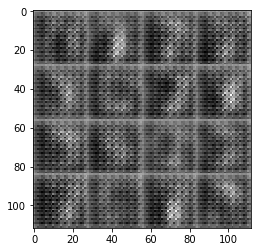

Epoch 1 / 1  D loss:  0.3594 ... G loss:  5.2354 ...
Epoch 1 / 1  D loss:  0.4375 ... G loss:  3.9299 ...
Epoch 1 / 1  D loss:  0.5468 ... G loss:  2.8573 ...
Epoch 1 / 1  D loss:  0.4285 ... G loss:  4.4336 ...
Epoch 1 / 1  D loss:  0.4037 ... G loss:  5.8591 ...
Epoch 1 / 1  D loss:  0.3996 ... G loss:  5.1561 ...
Epoch 1 / 1  D loss:  0.4413 ... G loss:  3.2072 ...
Epoch 1 / 1  D loss:  0.4061 ... G loss:  3.8029 ...
Epoch 1 / 1  D loss:  0.4158 ... G loss:  7.2367 ...
Epoch 1 / 1  D loss:  0.4097 ... G loss:  4.9353 ...


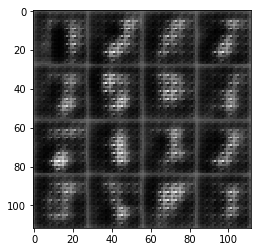

Epoch 1 / 1  D loss:  0.4018 ... G loss:  6.4936 ...
Epoch 1 / 1  D loss:  0.3634 ... G loss:  6.5460 ...
Epoch 1 / 1  D loss:  0.3720 ... G loss:  5.6377 ...
Epoch 1 / 1  D loss:  0.3682 ... G loss:  6.5818 ...
Epoch 1 / 1  D loss:  0.3841 ... G loss:  6.3714 ...
Epoch 1 / 1  D loss:  0.3695 ... G loss:  5.6970 ...
Epoch 1 / 1  D loss:  0.3808 ... G loss:  4.2467 ...
Epoch 1 / 1  D loss:  0.3935 ... G loss:  3.5589 ...
Epoch 1 / 1  D loss:  0.5143 ... G loss:  2.9410 ...
Epoch 1 / 1  D loss:  0.3987 ... G loss:  6.1660 ...


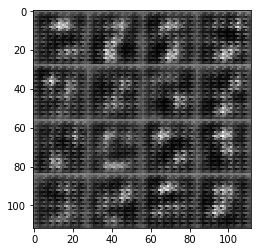

Epoch 1 / 1  D loss:  0.4774 ... G loss:  4.6778 ...
Epoch 1 / 1  D loss:  0.4262 ... G loss:  4.3288 ...
Epoch 1 / 1  D loss:  0.3749 ... G loss:  4.0074 ...
Epoch 1 / 1  D loss:  0.3910 ... G loss:  4.3412 ...
Epoch 1 / 1  D loss:  0.3931 ... G loss:  3.7580 ...
Epoch 1 / 1  D loss:  0.3713 ... G loss:  4.2884 ...
Epoch 1 / 1  D loss:  0.4150 ... G loss:  4.1089 ...
Epoch 1 / 1  D loss:  0.4523 ... G loss:  3.4580 ...
Epoch 1 / 1  D loss:  0.6018 ... G loss:  3.0662 ...
Epoch 1 / 1  D loss:  0.4192 ... G loss:  5.4434 ...


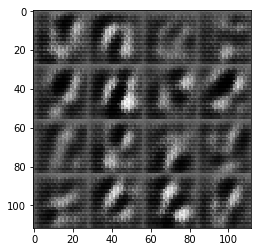

Epoch 1 / 1  D loss:  0.4619 ... G loss:  3.9937 ...
Epoch 1 / 1  D loss:  0.4232 ... G loss:  5.0665 ...
Epoch 1 / 1  D loss:  0.3930 ... G loss:  4.8607 ...
Epoch 1 / 1  D loss:  0.4920 ... G loss:  2.6357 ...
Epoch 1 / 1  D loss:  0.4320 ... G loss:  3.3885 ...
Epoch 1 / 1  D loss:  0.4238 ... G loss:  6.5197 ...
Epoch 1 / 1  D loss:  0.4089 ... G loss:  4.8141 ...
Epoch 1 / 1  D loss:  0.3900 ... G loss:  4.2572 ...
Epoch 1 / 1  D loss:  0.4046 ... G loss:  4.2235 ...
Epoch 1 / 1  D loss:  0.4430 ... G loss:  3.4529 ...


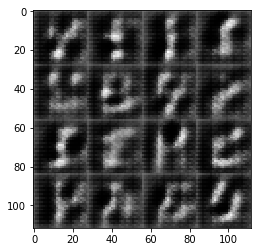

Epoch 1 / 1  D loss:  0.4420 ... G loss:  3.5561 ...
Epoch 1 / 1  D loss:  0.4635 ... G loss:  7.0458 ...
Epoch 1 / 1  D loss:  0.4005 ... G loss:  5.2006 ...
Epoch 1 / 1  D loss:  0.4325 ... G loss:  5.6419 ...
Epoch 1 / 1  D loss:  0.3892 ... G loss:  7.2295 ...
Epoch 1 / 1  D loss:  0.4857 ... G loss:  3.9782 ...
Epoch 1 / 1  D loss:  0.4565 ... G loss:  3.8539 ...
Epoch 1 / 1  D loss:  0.5321 ... G loss:  4.2895 ...
Epoch 1 / 1  D loss:  0.4676 ... G loss:  3.8500 ...
Epoch 1 / 1  D loss:  0.3926 ... G loss:  4.6419 ...


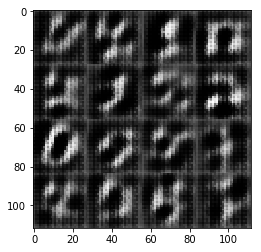

Epoch 1 / 1  D loss:  0.4014 ... G loss:  6.1317 ...
Epoch 1 / 1  D loss:  0.4231 ... G loss:  5.3343 ...
Epoch 1 / 1  D loss:  0.5411 ... G loss:  2.9487 ...
Epoch 1 / 1  D loss:  0.5140 ... G loss:  5.1858 ...
Epoch 1 / 1  D loss:  0.3862 ... G loss:  4.3387 ...
Epoch 1 / 1  D loss:  0.4118 ... G loss:  6.0067 ...
Epoch 1 / 1  D loss:  0.4493 ... G loss:  3.5340 ...
Epoch 1 / 1  D loss:  0.3766 ... G loss:  5.9291 ...
Epoch 1 / 1  D loss:  0.5315 ... G loss:  2.9363 ...
Epoch 1 / 1  D loss:  0.4192 ... G loss:  5.0519 ...


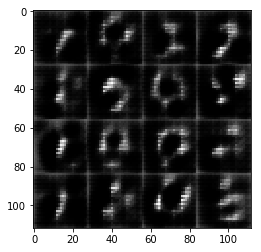

Epoch 1 / 1  D loss:  1.1197 ... G loss:  2.7616 ...
Epoch 1 / 1  D loss:  0.4681 ... G loss:  7.5995 ...
Epoch 1 / 1  D loss:  0.4661 ... G loss:  7.7955 ...
Epoch 1 / 1  D loss:  0.5113 ... G loss:  4.0914 ...
Epoch 1 / 1  D loss:  0.7113 ... G loss:  2.0075 ...
Epoch 1 / 1  D loss:  0.3925 ... G loss:  7.6772 ...
Epoch 1 / 1  D loss:  0.4220 ... G loss:  8.5558 ...
Epoch 1 / 1  D loss:  0.4094 ... G loss:  4.8644 ...
Epoch 1 / 1  D loss:  0.4037 ... G loss:  6.4630 ...
Epoch 1 / 1  D loss:  0.5252 ... G loss:  2.5677 ...


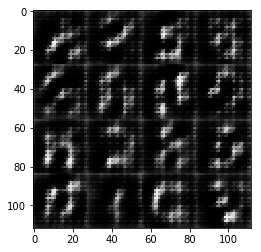

Epoch 1 / 1  D loss:  0.4028 ... G loss:  4.6764 ...
Epoch 1 / 1  D loss:  0.5430 ... G loss:  4.4154 ...
Epoch 1 / 1  D loss:  0.3782 ... G loss:  4.4509 ...
Epoch 1 / 1  D loss:  0.5446 ... G loss:  2.4522 ...
Epoch 1 / 1  D loss:  0.3849 ... G loss:  6.1203 ...
Epoch 1 / 1  D loss:  0.4064 ... G loss:  3.7778 ...
Epoch 1 / 1  D loss:  0.4040 ... G loss:  3.6156 ...
Epoch 1 / 1  D loss:  0.5300 ... G loss:  2.2772 ...
Epoch 1 / 1  D loss:  0.5223 ... G loss:  2.9060 ...
Epoch 1 / 1  D loss:  0.5514 ... G loss:  2.7639 ...


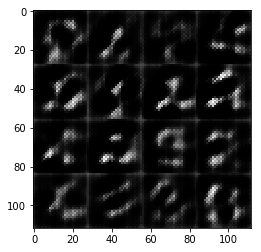

Epoch 1 / 1  D loss:  0.4978 ... G loss:  2.9267 ...
Epoch 1 / 1  D loss:  0.6310 ... G loss:  1.8375 ...
Epoch 1 / 1  D loss:  0.4770 ... G loss:  4.0943 ...
Epoch 1 / 1  D loss:  0.6248 ... G loss:  2.5859 ...
Epoch 1 / 1  D loss:  0.6065 ... G loss:  4.0653 ...
Epoch 1 / 1  D loss:  0.6233 ... G loss:  3.1535 ...
Epoch 1 / 1  D loss:  1.0154 ... G loss:  3.6136 ...
Epoch 1 / 1  D loss:  0.5701 ... G loss:  4.5634 ...
Epoch 1 / 1  D loss:  0.5650 ... G loss:  4.7185 ...
Epoch 1 / 1  D loss:  0.6727 ... G loss:  3.5843 ...


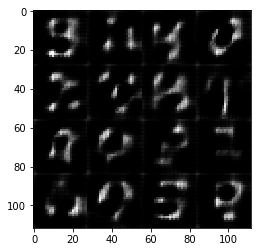

Epoch 1 / 1  D loss:  0.4831 ... G loss:  7.8399 ...
Epoch 1 / 1  D loss:  0.4983 ... G loss:  7.5303 ...
Epoch 1 / 1  D loss:  1.2273 ... G loss:  1.5242 ...
Epoch 1 / 1  D loss:  0.6618 ... G loss:  3.5518 ...
Epoch 1 / 1  D loss:  0.6469 ... G loss:  3.5277 ...
Epoch 1 / 1  D loss:  0.6428 ... G loss:  4.6076 ...
Epoch 1 / 1  D loss:  0.7594 ... G loss:  1.5563 ...
Epoch 1 / 1  D loss:  0.6332 ... G loss:  3.9723 ...
Epoch 1 / 1  D loss:  0.5618 ... G loss:  5.6364 ...
Epoch 1 / 1  D loss:  0.4740 ... G loss:  3.7562 ...


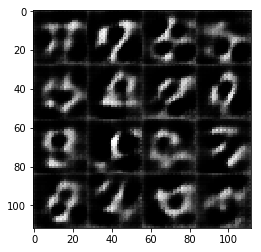

Epoch 1 / 1  D loss:  0.4809 ... G loss:  4.2129 ...
Epoch 1 / 1  D loss:  0.6166 ... G loss:  2.2577 ...
Epoch 1 / 1  D loss:  0.4675 ... G loss:  3.1483 ...
Epoch 1 / 1  D loss:  0.4190 ... G loss:  3.7036 ...
Epoch 1 / 1  D loss:  0.4670 ... G loss:  9.9538 ...
Epoch 1 / 1  D loss:  0.4381 ... G loss:  11.6278 ...
Epoch 1 / 1  D loss:  0.4687 ... G loss:  2.9498 ...
Epoch 1 / 1  D loss:  0.7776 ... G loss:  6.5917 ...
Epoch 1 / 1  D loss:  0.9672 ... G loss:  4.7158 ...
Epoch 1 / 1  D loss:  0.8919 ... G loss:  2.4091 ...


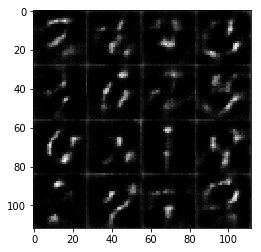

Epoch 1 / 1  D loss:  0.4933 ... G loss:  8.1799 ...
Epoch 1 / 1  D loss:  0.4689 ... G loss:  4.8128 ...
Epoch 1 / 1  D loss:  0.6700 ... G loss:  2.8750 ...
Epoch 1 / 1  D loss:  0.6205 ... G loss:  2.5643 ...
Epoch 1 / 1  D loss:  0.8438 ... G loss:  2.0089 ...
Epoch 1 / 1  D loss:  0.5026 ... G loss:  3.8722 ...
Epoch 1 / 1  D loss:  0.4493 ... G loss:  4.6105 ...
Epoch 1 / 1  D loss:  0.5218 ... G loss:  2.5172 ...
Epoch 1 / 1  D loss:  0.4694 ... G loss:  2.9145 ...
Epoch 1 / 1  D loss:  0.5356 ... G loss:  2.6065 ...


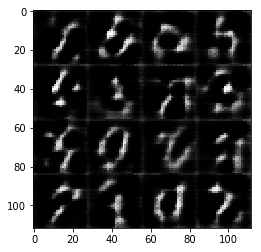

Epoch 1 / 1  D loss:  0.6820 ... G loss:  2.0141 ...
Epoch 1 / 1  D loss:  0.9574 ... G loss:  1.2831 ...
Epoch 1 / 1  D loss:  0.4747 ... G loss:  4.0406 ...
Epoch 1 / 1  D loss:  0.3811 ... G loss:  5.0715 ...
Epoch 1 / 1  D loss:  0.4548 ... G loss:  4.2796 ...
Epoch 1 / 1  D loss:  0.6658 ... G loss:  4.0612 ...
Epoch 1 / 1  D loss:  0.4958 ... G loss:  4.4715 ...
Epoch 1 / 1  D loss:  0.5717 ... G loss:  3.5957 ...
Epoch 1 / 1  D loss:  0.9389 ... G loss:  2.0389 ...
Epoch 1 / 1  D loss:  0.8911 ... G loss:  2.3646 ...


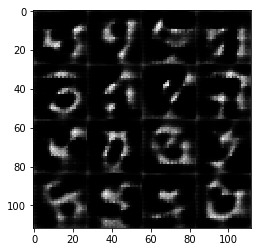

Epoch 1 / 1  D loss:  0.5719 ... G loss:  2.5809 ...
Epoch 1 / 1  D loss:  0.4595 ... G loss:  2.9158 ...
Epoch 1 / 1  D loss:  0.4856 ... G loss:  4.2799 ...
Epoch 1 / 1  D loss:  0.8231 ... G loss:  2.1871 ...
Epoch 1 / 1  D loss:  0.7643 ... G loss:  2.8558 ...
Epoch 1 / 1  D loss:  0.7489 ... G loss:  1.8573 ...
Epoch 1 / 1  D loss:  0.7045 ... G loss:  2.7434 ...
Epoch 1 / 1  D loss:  1.1881 ... G loss:  1.2307 ...
Epoch 1 / 1  D loss:  0.8076 ... G loss:  1.8410 ...
Epoch 1 / 1  D loss:  0.4873 ... G loss:  3.7239 ...


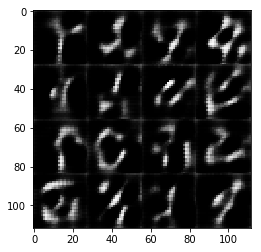

Epoch 1 / 1  D loss:  0.5383 ... G loss:  3.2839 ...
Epoch 1 / 1  D loss:  0.5007 ... G loss:  3.1855 ...
Epoch 1 / 1  D loss:  0.8894 ... G loss:  2.4250 ...
Epoch 1 / 1  D loss:  0.8520 ... G loss:  5.7589 ...
Epoch 1 / 1  D loss:  0.6433 ... G loss:  5.4840 ...
Epoch 1 / 1  D loss:  0.7422 ... G loss:  2.4644 ...
Epoch 1 / 1  D loss:  0.6962 ... G loss:  2.0312 ...
Epoch 1 / 1  D loss:  0.4762 ... G loss:  4.2950 ...


In [28]:
beta1 = .9
losses = train( net, epoch_count, batch_size, z_dim, 
                mnist_dataset.get_batches, mnist_dataset.image_mode)

---

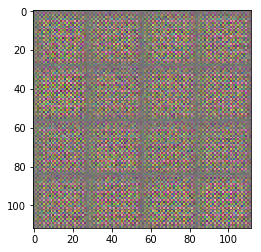

Epoch 1 / 1  D loss:  1.0797 ... G loss:  1.3886 ...
Epoch 1 / 1  D loss:  0.4705 ... G loss:  2.7325 ...
Epoch 1 / 1  D loss:  1.7082 ... G loss:  0.4049 ...
Epoch 1 / 1  D loss:  0.4801 ... G loss:  2.4725 ...
Epoch 1 / 1  D loss:  1.0856 ... G loss:  0.7732 ...
Epoch 1 / 1  D loss:  1.2566 ... G loss:  0.6778 ...
Epoch 1 / 1  D loss:  0.8018 ... G loss:  2.4773 ...
Epoch 1 / 1  D loss:  1.4479 ... G loss:  0.5714 ...
Epoch 1 / 1  D loss:  0.8338 ... G loss:  1.8483 ...


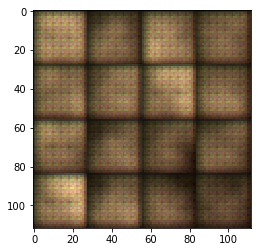

Epoch 1 / 1  D loss:  0.7925 ... G loss:  2.0210 ...
Epoch 1 / 1  D loss:  0.5803 ... G loss:  4.1163 ...
Epoch 1 / 1  D loss:  0.8726 ... G loss:  1.8921 ...
Epoch 1 / 1  D loss:  0.6397 ... G loss:  3.6379 ...
Epoch 1 / 1  D loss:  1.2597 ... G loss:  0.6164 ...
Epoch 1 / 1  D loss:  0.8151 ... G loss:  7.2577 ...
Epoch 1 / 1  D loss:  1.7741 ... G loss:  0.3626 ...
Epoch 1 / 1  D loss:  1.2971 ... G loss:  0.9903 ...
Epoch 1 / 1  D loss:  3.3991 ... G loss:  0.0992 ...
Epoch 1 / 1  D loss:  1.0013 ... G loss:  1.4299 ...


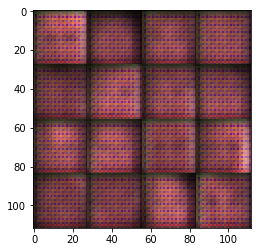

Epoch 1 / 1  D loss:  1.1812 ... G loss:  6.8368 ...
Epoch 1 / 1  D loss:  0.9631 ... G loss:  1.1094 ...
Epoch 1 / 1  D loss:  1.2390 ... G loss:  0.9312 ...
Epoch 1 / 1  D loss:  0.7060 ... G loss:  1.9150 ...
Epoch 1 / 1  D loss:  0.9884 ... G loss:  2.7027 ...
Epoch 1 / 1  D loss:  2.2034 ... G loss:  0.2031 ...
Epoch 1 / 1  D loss:  1.1201 ... G loss:  3.9909 ...
Epoch 1 / 1  D loss:  1.0937 ... G loss:  1.3201 ...
Epoch 1 / 1  D loss:  1.1350 ... G loss:  0.7314 ...
Epoch 1 / 1  D loss:  1.4449 ... G loss:  3.3285 ...


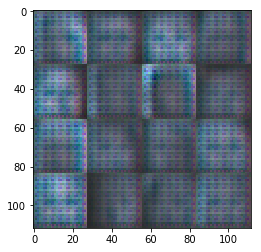

Epoch 1 / 1  D loss:  1.0215 ... G loss:  1.5791 ...
Epoch 1 / 1  D loss:  1.4479 ... G loss:  0.6040 ...
Epoch 1 / 1  D loss:  1.0008 ... G loss:  1.1739 ...
Epoch 1 / 1  D loss:  1.1320 ... G loss:  0.8376 ...
Epoch 1 / 1  D loss:  1.2750 ... G loss:  0.6047 ...
Epoch 1 / 1  D loss:  0.4251 ... G loss:  5.7343 ...
Epoch 1 / 1  D loss:  0.5472 ... G loss:  2.4738 ...
Epoch 1 / 1  D loss:  0.7139 ... G loss:  1.4397 ...
Epoch 1 / 1  D loss:  0.4415 ... G loss:  3.3045 ...
Epoch 1 / 1  D loss:  0.7869 ... G loss:  1.7848 ...


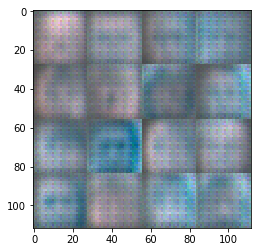

Epoch 1 / 1  D loss:  0.5703 ... G loss:  2.2660 ...
Epoch 1 / 1  D loss:  0.6788 ... G loss:  4.6960 ...
Epoch 1 / 1  D loss:  0.7251 ... G loss:  2.2854 ...
Epoch 1 / 1  D loss:  0.7353 ... G loss:  3.7829 ...
Epoch 1 / 1  D loss:  0.9742 ... G loss:  1.3880 ...
Epoch 1 / 1  D loss:  0.6223 ... G loss:  2.1102 ...
Epoch 1 / 1  D loss:  0.8178 ... G loss:  1.0861 ...
Epoch 1 / 1  D loss:  1.2948 ... G loss:  3.1231 ...
Epoch 1 / 1  D loss:  0.6914 ... G loss:  1.4809 ...
Epoch 1 / 1  D loss:  0.9811 ... G loss:  2.2845 ...


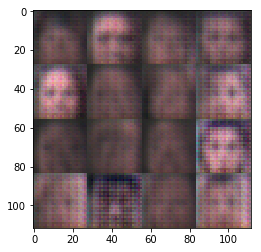

Epoch 1 / 1  D loss:  1.0261 ... G loss:  0.9746 ...
Epoch 1 / 1  D loss:  0.7840 ... G loss:  2.4500 ...
Epoch 1 / 1  D loss:  0.9576 ... G loss:  3.2294 ...
Epoch 1 / 1  D loss:  0.8231 ... G loss:  1.5973 ...
Epoch 1 / 1  D loss:  0.7992 ... G loss:  1.5266 ...
Epoch 1 / 1  D loss:  1.0974 ... G loss:  0.8375 ...
Epoch 1 / 1  D loss:  0.5801 ... G loss:  1.7489 ...
Epoch 1 / 1  D loss:  1.0459 ... G loss:  6.8214 ...
Epoch 1 / 1  D loss:  1.4807 ... G loss:  0.8228 ...
Epoch 1 / 1  D loss:  0.8156 ... G loss:  2.3756 ...


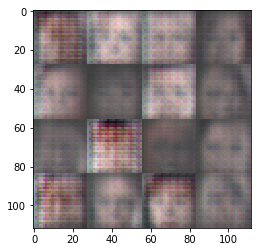

Epoch 1 / 1  D loss:  1.2076 ... G loss:  1.6798 ...
Epoch 1 / 1  D loss:  0.8202 ... G loss:  1.5437 ...
Epoch 1 / 1  D loss:  0.8260 ... G loss:  4.3446 ...
Epoch 1 / 1  D loss:  0.5935 ... G loss:  1.8015 ...
Epoch 1 / 1  D loss:  0.7441 ... G loss:  1.8247 ...
Epoch 1 / 1  D loss:  0.4496 ... G loss:  3.2111 ...
Epoch 1 / 1  D loss:  0.6006 ... G loss:  2.3665 ...
Epoch 1 / 1  D loss:  0.7405 ... G loss:  1.4232 ...
Epoch 1 / 1  D loss:  1.1056 ... G loss:  3.2644 ...
Epoch 1 / 1  D loss:  1.7575 ... G loss:  0.3985 ...


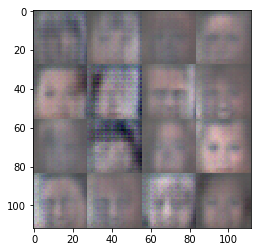

Epoch 1 / 1  D loss:  0.4920 ... G loss:  2.5636 ...
Epoch 1 / 1  D loss:  0.9422 ... G loss:  1.1290 ...
Epoch 1 / 1  D loss:  1.7565 ... G loss:  0.3505 ...
Epoch 1 / 1  D loss:  0.5457 ... G loss:  5.4468 ...
Epoch 1 / 1  D loss:  0.5901 ... G loss:  2.0124 ...
Epoch 1 / 1  D loss:  0.7069 ... G loss:  1.5764 ...
Epoch 1 / 1  D loss:  0.4265 ... G loss:  2.8167 ...
Epoch 1 / 1  D loss:  0.5299 ... G loss:  2.6024 ...
Epoch 1 / 1  D loss:  0.7575 ... G loss:  1.4160 ...
Epoch 1 / 1  D loss:  0.5284 ... G loss:  1.9012 ...


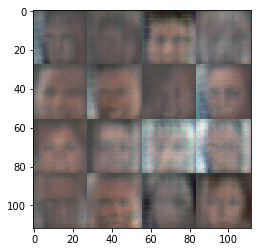

Epoch 1 / 1  D loss:  1.0460 ... G loss:  1.2263 ...
Epoch 1 / 1  D loss:  0.9085 ... G loss:  1.9323 ...
Epoch 1 / 1  D loss:  0.7722 ... G loss:  1.2605 ...
Epoch 1 / 1  D loss:  0.4776 ... G loss:  2.5968 ...
Epoch 1 / 1  D loss:  0.9438 ... G loss:  1.6703 ...
Epoch 1 / 1  D loss:  2.2053 ... G loss:  1.1478 ...
Epoch 1 / 1  D loss:  1.2261 ... G loss:  1.1940 ...
Epoch 1 / 1  D loss:  1.0787 ... G loss:  0.9789 ...
Epoch 1 / 1  D loss:  1.1226 ... G loss:  1.8149 ...
Epoch 1 / 1  D loss:  1.2361 ... G loss:  1.2447 ...


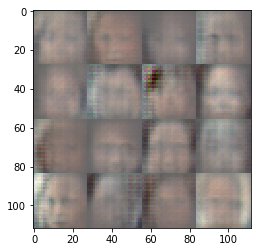

Epoch 1 / 1  D loss:  0.8961 ... G loss:  2.6739 ...
Epoch 1 / 1  D loss:  0.8192 ... G loss:  1.2007 ...
Epoch 1 / 1  D loss:  1.0206 ... G loss:  2.2587 ...
Epoch 1 / 1  D loss:  1.1232 ... G loss:  0.8206 ...
Epoch 1 / 1  D loss:  1.1553 ... G loss:  0.9393 ...
Epoch 1 / 1  D loss:  0.8353 ... G loss:  1.9348 ...
Epoch 1 / 1  D loss:  1.1224 ... G loss:  0.9123 ...
Epoch 1 / 1  D loss:  0.8596 ... G loss:  1.2068 ...
Epoch 1 / 1  D loss:  0.9157 ... G loss:  3.3237 ...
Epoch 1 / 1  D loss:  0.9148 ... G loss:  1.6036 ...


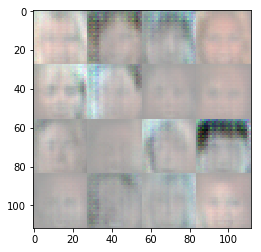

Epoch 1 / 1  D loss:  0.4875 ... G loss:  2.8389 ...
Epoch 1 / 1  D loss:  1.1586 ... G loss:  0.9336 ...
Epoch 1 / 1  D loss:  1.2100 ... G loss:  0.7923 ...
Epoch 1 / 1  D loss:  1.4134 ... G loss:  1.5164 ...
Epoch 1 / 1  D loss:  1.1134 ... G loss:  1.1811 ...
Epoch 1 / 1  D loss:  1.2094 ... G loss:  0.9078 ...
Epoch 1 / 1  D loss:  1.1454 ... G loss:  0.7018 ...
Epoch 1 / 1  D loss:  0.7511 ... G loss:  1.3562 ...
Epoch 1 / 1  D loss:  0.4203 ... G loss:  3.1163 ...
Epoch 1 / 1  D loss:  0.7281 ... G loss:  1.3132 ...


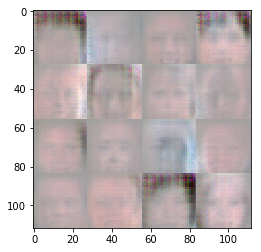

Epoch 1 / 1  D loss:  1.5855 ... G loss:  0.5148 ...
Epoch 1 / 1  D loss:  1.1337 ... G loss:  1.3249 ...
Epoch 1 / 1  D loss:  1.4059 ... G loss:  0.9561 ...
Epoch 1 / 1  D loss:  1.4051 ... G loss:  0.8399 ...
Epoch 1 / 1  D loss:  1.2001 ... G loss:  1.1117 ...
Epoch 1 / 1  D loss:  1.1653 ... G loss:  0.9981 ...
Epoch 1 / 1  D loss:  1.2709 ... G loss:  0.8645 ...
Epoch 1 / 1  D loss:  0.5738 ... G loss:  2.3246 ...
Epoch 1 / 1  D loss:  0.6678 ... G loss:  3.4012 ...
Epoch 1 / 1  D loss:  0.8420 ... G loss:  1.2572 ...


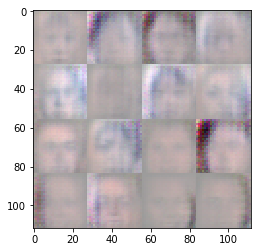

Epoch 1 / 1  D loss:  1.3190 ... G loss:  1.4384 ...
Epoch 1 / 1  D loss:  1.0629 ... G loss:  1.0861 ...
Epoch 1 / 1  D loss:  0.4737 ... G loss:  2.5517 ...
Epoch 1 / 1  D loss:  0.7585 ... G loss:  1.1901 ...
Epoch 1 / 1  D loss:  0.7297 ... G loss:  1.7891 ...
Epoch 1 / 1  D loss:  0.6740 ... G loss:  1.4946 ...
Epoch 1 / 1  D loss:  0.8144 ... G loss:  1.4657 ...
Epoch 1 / 1  D loss:  1.2427 ... G loss:  1.1466 ...
Epoch 1 / 1  D loss:  0.8742 ... G loss:  1.1008 ...
Epoch 1 / 1  D loss:  0.8500 ... G loss:  1.0704 ...


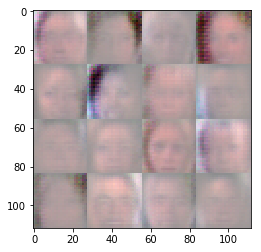

Epoch 1 / 1  D loss:  0.9918 ... G loss:  1.1933 ...
Epoch 1 / 1  D loss:  1.4353 ... G loss:  1.1522 ...
Epoch 1 / 1  D loss:  1.4107 ... G loss:  0.5901 ...
Epoch 1 / 1  D loss:  1.0554 ... G loss:  1.5272 ...
Epoch 1 / 1  D loss:  1.1641 ... G loss:  1.0860 ...
Epoch 1 / 1  D loss:  1.2512 ... G loss:  1.0170 ...
Epoch 1 / 1  D loss:  1.1528 ... G loss:  1.0541 ...
Epoch 1 / 1  D loss:  1.2725 ... G loss:  0.9160 ...
Epoch 1 / 1  D loss:  0.9152 ... G loss:  1.3887 ...
Epoch 1 / 1  D loss:  0.9262 ... G loss:  1.2628 ...


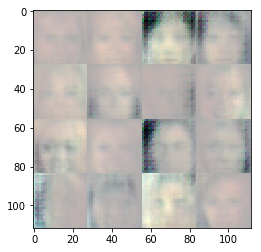

Epoch 1 / 1  D loss:  0.5357 ... G loss:  2.4237 ...
Epoch 1 / 1  D loss:  0.6127 ... G loss:  7.7265 ...
Epoch 1 / 1  D loss:  0.9292 ... G loss:  3.7073 ...
Epoch 1 / 1  D loss:  0.5261 ... G loss:  2.1930 ...
Epoch 1 / 1  D loss:  0.4567 ... G loss:  2.5100 ...
Epoch 1 / 1  D loss:  0.5726 ... G loss:  1.7449 ...
Epoch 1 / 1  D loss:  1.2103 ... G loss:  1.0028 ...
Epoch 1 / 1  D loss:  0.8769 ... G loss:  1.2714 ...
Epoch 1 / 1  D loss:  0.9583 ... G loss:  1.0711 ...
Epoch 1 / 1  D loss:  1.1030 ... G loss:  1.1321 ...


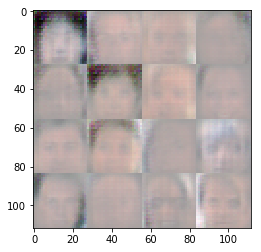

Epoch 1 / 1  D loss:  1.2448 ... G loss:  0.7355 ...
Epoch 1 / 1  D loss:  1.3083 ... G loss:  1.0379 ...
Epoch 1 / 1  D loss:  1.2016 ... G loss:  1.0294 ...
Epoch 1 / 1  D loss:  1.1564 ... G loss:  1.0728 ...
Epoch 1 / 1  D loss:  1.1364 ... G loss:  1.2703 ...
Epoch 1 / 1  D loss:  1.0964 ... G loss:  1.6253 ...
Epoch 1 / 1  D loss:  1.5415 ... G loss:  0.5950 ...
Epoch 1 / 1  D loss:  0.7457 ... G loss:  1.9927 ...
Epoch 1 / 1  D loss:  1.1934 ... G loss:  0.9195 ...
Epoch 1 / 1  D loss:  1.0406 ... G loss:  0.9980 ...


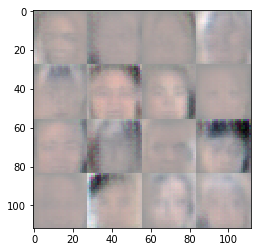

Epoch 1 / 1  D loss:  1.0821 ... G loss:  0.8512 ...
Epoch 1 / 1  D loss:  1.1750 ... G loss:  0.7900 ...
Epoch 1 / 1  D loss:  0.8380 ... G loss:  2.2942 ...
Epoch 1 / 1  D loss:  0.4450 ... G loss:  3.3693 ...
Epoch 1 / 1  D loss:  1.7708 ... G loss:  1.1982 ...
Epoch 1 / 1  D loss:  1.0064 ... G loss:  1.0953 ...
Epoch 1 / 1  D loss:  1.0696 ... G loss:  1.3671 ...
Epoch 1 / 1  D loss:  1.2007 ... G loss:  0.9344 ...
Epoch 1 / 1  D loss:  0.7053 ... G loss:  4.6672 ...
Epoch 1 / 1  D loss:  0.6487 ... G loss:  1.5041 ...


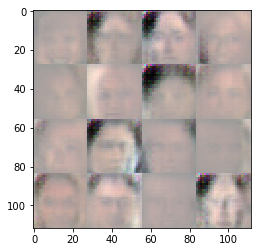

Epoch 1 / 1  D loss:  0.9225 ... G loss:  1.2717 ...
Epoch 1 / 1  D loss:  1.0717 ... G loss:  1.7674 ...
Epoch 1 / 1  D loss:  1.1562 ... G loss:  0.7886 ...
Epoch 1 / 1  D loss:  1.2368 ... G loss:  0.8659 ...
Epoch 1 / 1  D loss:  0.6658 ... G loss:  1.7842 ...
Epoch 1 / 1  D loss:  1.3013 ... G loss:  0.5423 ...
Epoch 1 / 1  D loss:  0.6586 ... G loss:  2.3304 ...
Epoch 1 / 1  D loss:  0.5247 ... G loss:  6.0679 ...
Epoch 1 / 1  D loss:  0.9810 ... G loss:  0.8385 ...
Epoch 1 / 1  D loss:  1.4006 ... G loss:  0.5399 ...


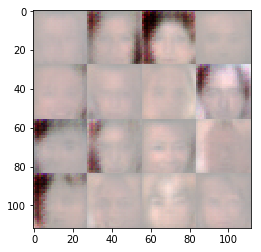

Epoch 1 / 1  D loss:  0.5903 ... G loss:  3.8195 ...
Epoch 1 / 1  D loss:  1.3497 ... G loss:  1.8668 ...
Epoch 1 / 1  D loss:  0.9362 ... G loss:  5.6163 ...
Epoch 1 / 1  D loss:  0.4689 ... G loss:  2.9942 ...
Epoch 1 / 1  D loss:  0.5691 ... G loss:  2.1091 ...
Epoch 1 / 1  D loss:  0.6955 ... G loss:  1.4682 ...
Epoch 1 / 1  D loss:  0.8660 ... G loss:  1.1905 ...
Epoch 1 / 1  D loss:  0.8683 ... G loss:  1.2991 ...
Epoch 1 / 1  D loss:  0.6189 ... G loss:  1.7382 ...
Epoch 1 / 1  D loss:  0.4084 ... G loss:  3.5783 ...


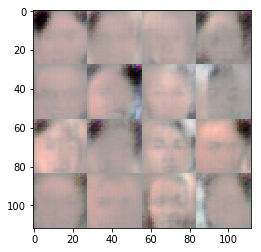

Epoch 1 / 1  D loss:  0.5841 ... G loss:  1.8866 ...
Epoch 1 / 1  D loss:  0.7782 ... G loss:  1.4583 ...
Epoch 1 / 1  D loss:  0.4671 ... G loss:  2.4046 ...
Epoch 1 / 1  D loss:  1.3698 ... G loss:  0.6691 ...
Epoch 1 / 1  D loss:  1.4693 ... G loss:  0.5240 ...
Epoch 1 / 1  D loss:  0.7489 ... G loss:  1.4325 ...
Epoch 1 / 1  D loss:  0.8949 ... G loss:  2.0557 ...
Epoch 1 / 1  D loss:  0.7386 ... G loss:  1.3938 ...
Epoch 1 / 1  D loss:  0.9140 ... G loss:  0.9590 ...
Epoch 1 / 1  D loss:  1.0459 ... G loss:  0.7932 ...


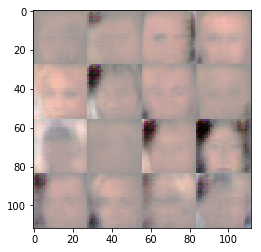

Epoch 1 / 1  D loss:  0.5862 ... G loss:  1.9301 ...
Epoch 1 / 1  D loss:  0.8233 ... G loss:  1.2354 ...
Epoch 1 / 1  D loss:  0.6934 ... G loss:  1.9090 ...
Epoch 1 / 1  D loss:  0.6508 ... G loss:  1.7227 ...
Epoch 1 / 1  D loss:  1.1113 ... G loss:  0.8949 ...
Epoch 1 / 1  D loss:  1.1050 ... G loss:  1.1591 ...
Epoch 1 / 1  D loss:  1.1155 ... G loss:  0.9679 ...
Epoch 1 / 1  D loss:  1.1300 ... G loss:  0.6634 ...
Epoch 1 / 1  D loss:  1.3154 ... G loss:  0.8881 ...
Epoch 1 / 1  D loss:  0.8134 ... G loss:  2.0170 ...


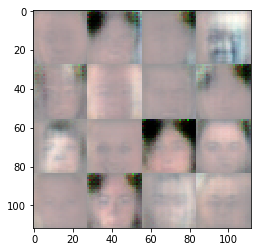

Epoch 1 / 1  D loss:  1.2580 ... G loss:  0.6550 ...
Epoch 1 / 1  D loss:  0.4001 ... G loss:  4.9836 ...
Epoch 1 / 1  D loss:  0.8626 ... G loss:  1.5480 ...
Epoch 1 / 1  D loss:  1.2140 ... G loss:  0.9659 ...
Epoch 1 / 1  D loss:  1.1058 ... G loss:  1.1907 ...
Epoch 1 / 1  D loss:  1.2130 ... G loss:  0.7943 ...
Epoch 1 / 1  D loss:  1.1647 ... G loss:  0.9761 ...
Epoch 1 / 1  D loss:  0.9923 ... G loss:  1.3330 ...
Epoch 1 / 1  D loss:  1.0265 ... G loss:  1.2855 ...
Epoch 1 / 1  D loss:  1.2245 ... G loss:  0.9861 ...


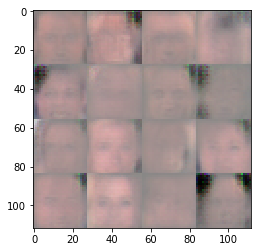

Epoch 1 / 1  D loss:  1.0812 ... G loss:  1.1090 ...
Epoch 1 / 1  D loss:  1.1577 ... G loss:  1.1190 ...
Epoch 1 / 1  D loss:  1.1584 ... G loss:  0.8468 ...
Epoch 1 / 1  D loss:  1.1342 ... G loss:  0.8502 ...
Epoch 1 / 1  D loss:  0.6327 ... G loss:  1.9531 ...
Epoch 1 / 1  D loss:  0.6954 ... G loss:  1.4683 ...
Epoch 1 / 1  D loss:  1.1925 ... G loss:  0.7219 ...
Epoch 1 / 1  D loss:  0.4864 ... G loss:  2.5431 ...
Epoch 1 / 1  D loss:  0.7784 ... G loss:  1.1599 ...
Epoch 1 / 1  D loss:  0.8168 ... G loss:  1.4991 ...


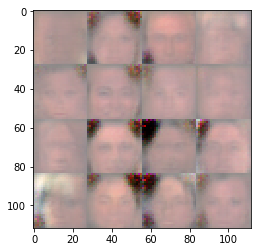

Epoch 1 / 1  D loss:  1.0633 ... G loss:  0.9813 ...
Epoch 1 / 1  D loss:  1.1920 ... G loss:  1.2413 ...
Epoch 1 / 1  D loss:  1.1828 ... G loss:  0.7325 ...
Epoch 1 / 1  D loss:  1.2916 ... G loss:  0.7293 ...
Epoch 1 / 1  D loss:  1.1791 ... G loss:  0.8771 ...
Epoch 1 / 1  D loss:  1.2430 ... G loss:  0.5896 ...
Epoch 1 / 1  D loss:  1.5007 ... G loss:  0.4318 ...
Epoch 1 / 1  D loss:  0.9502 ... G loss:  0.9354 ...
Epoch 1 / 1  D loss:  0.5003 ... G loss:  2.6343 ...
Epoch 1 / 1  D loss:  0.6154 ... G loss:  1.7513 ...


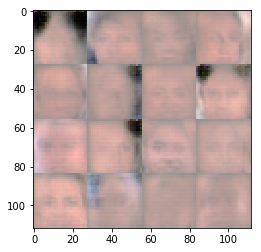

Epoch 1 / 1  D loss:  0.8512 ... G loss:  1.5945 ...
Epoch 1 / 1  D loss:  1.1017 ... G loss:  0.8866 ...
Epoch 1 / 1  D loss:  1.1144 ... G loss:  1.0044 ...
Epoch 1 / 1  D loss:  0.7208 ... G loss:  4.2487 ...
Epoch 1 / 1  D loss:  1.2345 ... G loss:  2.1377 ...
Epoch 1 / 1  D loss:  1.2975 ... G loss:  0.6451 ...
Epoch 1 / 1  D loss:  1.2947 ... G loss:  0.6510 ...
Epoch 1 / 1  D loss:  1.5393 ... G loss:  0.4551 ...
Epoch 1 / 1  D loss:  0.3549 ... G loss:  9.4279 ...
Epoch 1 / 1  D loss:  0.6033 ... G loss:  2.2378 ...


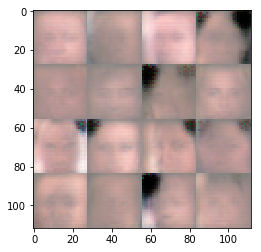

Epoch 1 / 1  D loss:  0.8821 ... G loss:  1.9356 ...
Epoch 1 / 1  D loss:  0.8087 ... G loss:  1.3472 ...
Epoch 1 / 1  D loss:  0.9667 ... G loss:  1.0782 ...
Epoch 1 / 1  D loss:  1.0382 ... G loss:  1.7804 ...
Epoch 1 / 1  D loss:  2.9614 ... G loss:  0.0781 ...
Epoch 1 / 1  D loss:  1.2063 ... G loss:  0.7097 ...
Epoch 1 / 1  D loss:  1.2556 ... G loss:  1.4100 ...
Epoch 1 / 1  D loss:  1.1385 ... G loss:  0.7755 ...
Epoch 1 / 1  D loss:  1.0592 ... G loss:  0.9072 ...
Epoch 1 / 1  D loss:  0.8600 ... G loss:  1.0533 ...


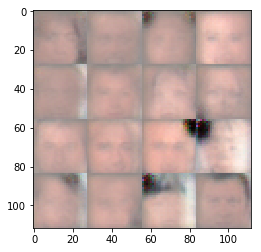

Epoch 1 / 1  D loss:  0.3634 ... G loss:  6.3487 ...
Epoch 1 / 1  D loss:  1.2159 ... G loss:  0.6487 ...
Epoch 1 / 1  D loss:  1.2173 ... G loss:  0.6752 ...
Epoch 1 / 1  D loss:  1.2037 ... G loss:  0.7059 ...


KeyboardInterrupt: 

In [47]:
# G() from 512 -> 1024 and extra layer
losses = train( net, epoch_count, batch_size, z_dim, 
                celeba_dataset.get_batches, celeba_dataset.image_mode)

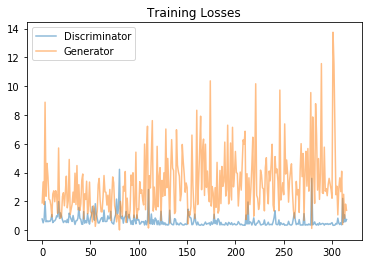

In [48]:
print_losses_chart(losses)

---

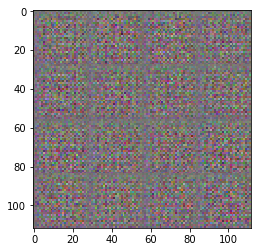

Epoch 1 / 1  D loss:  0.7811 ... G loss:  1.8974 ...
Epoch 1 / 1  D loss:  0.5133 ... G loss:  3.3542 ...
Epoch 1 / 1  D loss:  0.7257 ... G loss:  1.7832 ...
Epoch 1 / 1  D loss:  1.9941 ... G loss:  8.8883 ...
Epoch 1 / 1  D loss:  0.5880 ... G loss:  2.3583 ...
Epoch 1 / 1  D loss:  0.6619 ... G loss:  4.6398 ...
Epoch 1 / 1  D loss:  0.5891 ... G loss:  3.7099 ...
Epoch 1 / 1  D loss:  0.6448 ... G loss:  2.1570 ...
Epoch 1 / 1  D loss:  0.6113 ... G loss:  2.1058 ...


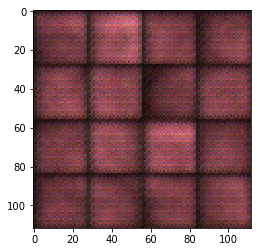

Epoch 1 / 1  D loss:  0.7330 ... G loss:  1.7400 ...
Epoch 1 / 1  D loss:  1.0872 ... G loss:  0.9153 ...
Epoch 1 / 1  D loss:  0.5295 ... G loss:  2.5097 ...
Epoch 1 / 1  D loss:  0.6268 ... G loss:  2.7345 ...
Epoch 1 / 1  D loss:  0.6547 ... G loss:  1.9790 ...
Epoch 1 / 1  D loss:  0.7574 ... G loss:  2.7445 ...
Epoch 1 / 1  D loss:  1.0032 ... G loss:  2.3911 ...
Epoch 1 / 1  D loss:  0.9317 ... G loss:  1.1830 ...
Epoch 1 / 1  D loss:  1.9892 ... G loss:  5.7094 ...
Epoch 1 / 1  D loss:  0.8161 ... G loss:  1.5571 ...


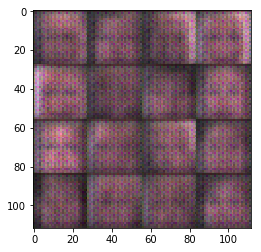

Epoch 1 / 1  D loss:  1.2073 ... G loss:  0.8366 ...
Epoch 1 / 1  D loss:  0.9828 ... G loss:  0.9874 ...
Epoch 1 / 1  D loss:  0.7172 ... G loss:  2.3406 ...
Epoch 1 / 1  D loss:  0.5319 ... G loss:  2.6046 ...
Epoch 1 / 1  D loss:  0.6318 ... G loss:  1.6971 ...
Epoch 1 / 1  D loss:  0.6484 ... G loss:  2.6485 ...
Epoch 1 / 1  D loss:  0.5356 ... G loss:  3.7526 ...
Epoch 1 / 1  D loss:  0.7560 ... G loss:  1.5566 ...
Epoch 1 / 1  D loss:  0.5294 ... G loss:  2.0398 ...
Epoch 1 / 1  D loss:  1.1895 ... G loss:  4.9144 ...


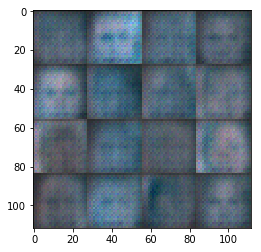

Epoch 1 / 1  D loss:  0.9400 ... G loss:  1.0906 ...
Epoch 1 / 1  D loss:  0.7593 ... G loss:  1.4725 ...
Epoch 1 / 1  D loss:  0.6101 ... G loss:  1.8146 ...
Epoch 1 / 1  D loss:  1.0202 ... G loss:  2.6466 ...
Epoch 1 / 1  D loss:  0.6677 ... G loss:  1.9357 ...
Epoch 1 / 1  D loss:  0.4017 ... G loss:  3.9626 ...
Epoch 1 / 1  D loss:  0.6526 ... G loss:  1.7813 ...
Epoch 1 / 1  D loss:  0.6681 ... G loss:  4.4904 ...
Epoch 1 / 1  D loss:  0.8366 ... G loss:  1.4158 ...
Epoch 1 / 1  D loss:  1.5866 ... G loss:  3.1655 ...


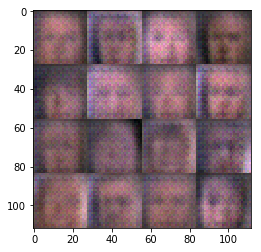

Epoch 1 / 1  D loss:  0.8331 ... G loss:  1.3699 ...
Epoch 1 / 1  D loss:  0.7481 ... G loss:  1.8368 ...
Epoch 1 / 1  D loss:  0.4196 ... G loss:  3.4681 ...
Epoch 1 / 1  D loss:  0.4138 ... G loss:  3.9024 ...
Epoch 1 / 1  D loss:  1.2980 ... G loss:  0.7895 ...
Epoch 1 / 1  D loss:  0.4898 ... G loss:  2.5274 ...
Epoch 1 / 1  D loss:  0.6576 ... G loss:  2.1342 ...
Epoch 1 / 1  D loss:  0.5156 ... G loss:  3.4017 ...
Epoch 1 / 1  D loss:  1.1393 ... G loss:  1.1404 ...
Epoch 1 / 1  D loss:  0.6434 ... G loss:  1.7373 ...


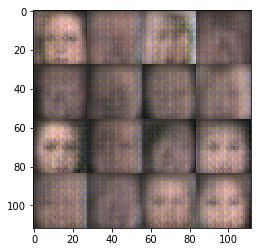

Epoch 1 / 1  D loss:  0.4248 ... G loss:  3.3429 ...
Epoch 1 / 1  D loss:  0.8479 ... G loss:  1.3002 ...
Epoch 1 / 1  D loss:  1.0549 ... G loss:  1.1911 ...
Epoch 1 / 1  D loss:  1.6526 ... G loss:  0.5787 ...
Epoch 1 / 1  D loss:  1.2593 ... G loss:  1.6885 ...
Epoch 1 / 1  D loss:  0.6970 ... G loss:  1.4922 ...
Epoch 1 / 1  D loss:  1.8406 ... G loss:  0.2684 ...
Epoch 1 / 1  D loss:  1.0998 ... G loss:  0.7880 ...
Epoch 1 / 1  D loss:  0.8142 ... G loss:  1.3257 ...
Epoch 1 / 1  D loss:  0.5020 ... G loss:  3.1630 ...


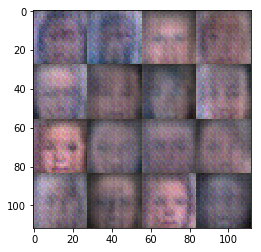

Epoch 1 / 1  D loss:  0.5072 ... G loss:  3.5964 ...
Epoch 1 / 1  D loss:  0.6582 ... G loss:  2.0695 ...
Epoch 1 / 1  D loss:  0.8208 ... G loss:  1.2877 ...
Epoch 1 / 1  D loss:  0.8798 ... G loss:  1.2728 ...
Epoch 1 / 1  D loss:  0.5964 ... G loss:  2.3055 ...
Epoch 1 / 1  D loss:  1.3964 ... G loss:  3.7985 ...
Epoch 1 / 1  D loss:  0.6147 ... G loss:  2.6610 ...
Epoch 1 / 1  D loss:  0.6024 ... G loss:  2.6366 ...
Epoch 1 / 1  D loss:  0.6227 ... G loss:  1.7473 ...
Epoch 1 / 1  D loss:  1.0028 ... G loss:  2.4339 ...


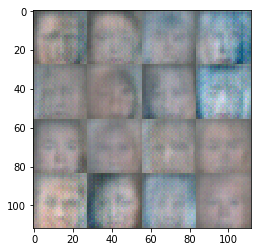

Epoch 1 / 1  D loss:  0.7846 ... G loss:  1.2744 ...
Epoch 1 / 1  D loss:  0.8432 ... G loss:  2.8317 ...
Epoch 1 / 1  D loss:  1.3145 ... G loss:  0.6740 ...
Epoch 1 / 1  D loss:  0.5480 ... G loss:  2.2413 ...
Epoch 1 / 1  D loss:  0.4732 ... G loss:  3.7019 ...
Epoch 1 / 1  D loss:  0.4269 ... G loss:  3.2985 ...
Epoch 1 / 1  D loss:  0.8518 ... G loss:  1.7108 ...
Epoch 1 / 1  D loss:  1.0709 ... G loss:  1.3381 ...
Epoch 1 / 1  D loss:  2.1640 ... G loss:  0.5824 ...
Epoch 1 / 1  D loss:  1.1409 ... G loss:  1.0894 ...


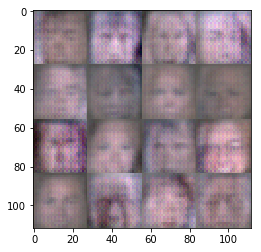

Epoch 1 / 1  D loss:  1.5016 ... G loss:  0.9385 ...
Epoch 1 / 1  D loss:  4.2286 ... G loss:  0.0221 ...
Epoch 1 / 1  D loss:  0.9362 ... G loss:  1.9989 ...
Epoch 1 / 1  D loss:  0.8005 ... G loss:  1.4689 ...
Epoch 1 / 1  D loss:  0.9854 ... G loss:  0.9650 ...
Epoch 1 / 1  D loss:  0.4899 ... G loss:  3.0492 ...
Epoch 1 / 1  D loss:  0.8793 ... G loss:  2.7150 ...
Epoch 1 / 1  D loss:  0.9466 ... G loss:  4.0781 ...
Epoch 1 / 1  D loss:  1.3031 ... G loss:  0.5328 ...
Epoch 1 / 1  D loss:  0.5424 ... G loss:  2.2291 ...


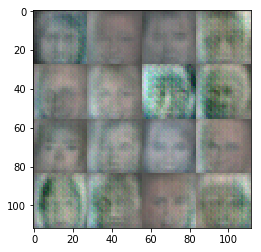

Epoch 1 / 1  D loss:  0.9732 ... G loss:  1.0847 ...
Epoch 1 / 1  D loss:  1.0953 ... G loss:  0.8391 ...
Epoch 1 / 1  D loss:  0.7247 ... G loss:  1.3946 ...
Epoch 1 / 1  D loss:  0.4104 ... G loss:  3.8366 ...
Epoch 1 / 1  D loss:  0.6599 ... G loss:  3.1238 ...
Epoch 1 / 1  D loss:  0.3952 ... G loss:  3.9897 ...
Epoch 1 / 1  D loss:  1.0512 ... G loss:  0.8665 ...
Epoch 1 / 1  D loss:  0.6545 ... G loss:  1.7067 ...
Epoch 1 / 1  D loss:  0.4465 ... G loss:  5.4210 ...
Epoch 1 / 1  D loss:  1.0656 ... G loss:  0.8256 ...


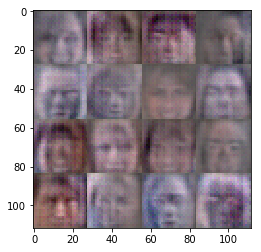

Epoch 1 / 1  D loss:  0.6940 ... G loss:  1.4904 ...
Epoch 1 / 1  D loss:  0.7270 ... G loss:  1.4262 ...
Epoch 1 / 1  D loss:  0.4191 ... G loss:  3.3704 ...
Epoch 1 / 1  D loss:  0.4629 ... G loss:  2.5672 ...
Epoch 1 / 1  D loss:  0.6074 ... G loss:  2.8172 ...
Epoch 1 / 1  D loss:  0.5723 ... G loss:  2.1244 ...
Epoch 1 / 1  D loss:  0.6030 ... G loss:  1.7567 ...
Epoch 1 / 1  D loss:  0.3645 ... G loss:  5.9820 ...
Epoch 1 / 1  D loss:  0.6679 ... G loss:  1.4242 ...
Epoch 1 / 1  D loss:  0.3774 ... G loss:  5.5550 ...


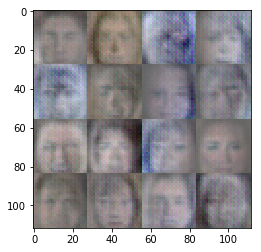

Epoch 1 / 1  D loss:  0.6530 ... G loss:  7.2188 ...
Epoch 1 / 1  D loss:  2.8272 ... G loss:  0.1576 ...
Epoch 1 / 1  D loss:  0.5173 ... G loss:  3.7826 ...
Epoch 1 / 1  D loss:  0.4462 ... G loss:  2.9326 ...
Epoch 1 / 1  D loss:  1.1273 ... G loss:  5.2416 ...
Epoch 1 / 1  D loss:  0.4124 ... G loss:  7.6108 ...
Epoch 1 / 1  D loss:  0.7272 ... G loss:  1.3281 ...
Epoch 1 / 1  D loss:  0.4084 ... G loss:  2.9956 ...
Epoch 1 / 1  D loss:  0.8488 ... G loss:  1.5998 ...
Epoch 1 / 1  D loss:  0.7276 ... G loss:  1.4039 ...


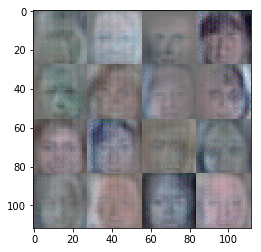

Epoch 1 / 1  D loss:  0.3854 ... G loss:  5.8251 ...
Epoch 1 / 1  D loss:  0.6651 ... G loss:  1.6307 ...
Epoch 1 / 1  D loss:  0.3796 ... G loss:  3.7360 ...
Epoch 1 / 1  D loss:  0.3816 ... G loss:  4.3454 ...
Epoch 1 / 1  D loss:  1.3197 ... G loss:  0.6669 ...
Epoch 1 / 1  D loss:  0.4173 ... G loss:  3.4587 ...
Epoch 1 / 1  D loss:  0.5668 ... G loss:  2.3537 ...
Epoch 1 / 1  D loss:  0.3979 ... G loss:  3.9889 ...
Epoch 1 / 1  D loss:  0.5181 ... G loss:  2.4079 ...
Epoch 1 / 1  D loss:  0.3604 ... G loss:  7.0268 ...


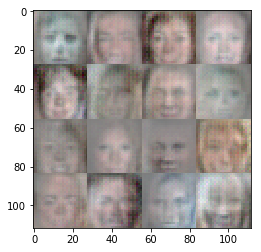

Epoch 1 / 1  D loss:  0.4173 ... G loss:  2.9490 ...
Epoch 1 / 1  D loss:  0.3557 ... G loss:  4.9861 ...
Epoch 1 / 1  D loss:  0.3944 ... G loss:  3.0798 ...
Epoch 1 / 1  D loss:  1.3905 ... G loss:  0.4947 ...
Epoch 1 / 1  D loss:  0.5212 ... G loss:  4.1198 ...
Epoch 1 / 1  D loss:  0.4308 ... G loss:  6.2903 ...
Epoch 1 / 1  D loss:  0.3829 ... G loss:  4.3131 ...
Epoch 1 / 1  D loss:  0.3806 ... G loss:  4.1456 ...
Epoch 1 / 1  D loss:  0.8057 ... G loss:  1.1548 ...
Epoch 1 / 1  D loss:  0.7567 ... G loss:  1.2989 ...


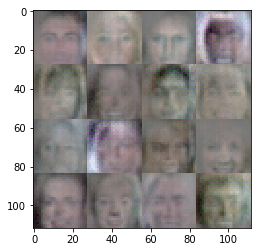

Epoch 1 / 1  D loss:  0.3904 ... G loss:  6.9737 ...
Epoch 1 / 1  D loss:  0.4942 ... G loss:  4.5287 ...
Epoch 1 / 1  D loss:  0.3847 ... G loss:  4.0554 ...
Epoch 1 / 1  D loss:  0.3782 ... G loss:  3.7557 ...
Epoch 1 / 1  D loss:  0.5115 ... G loss:  2.0433 ...
Epoch 1 / 1  D loss:  0.4661 ... G loss:  2.5098 ...
Epoch 1 / 1  D loss:  0.3839 ... G loss:  5.9561 ...
Epoch 1 / 1  D loss:  0.3608 ... G loss:  4.7621 ...
Epoch 1 / 1  D loss:  0.3713 ... G loss:  3.9078 ...
Epoch 1 / 1  D loss:  0.4473 ... G loss:  2.6403 ...


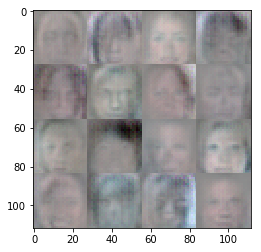

Epoch 1 / 1  D loss:  0.3991 ... G loss:  3.2810 ...
Epoch 1 / 1  D loss:  0.4076 ... G loss:  2.9712 ...
Epoch 1 / 1  D loss:  1.4627 ... G loss:  0.4389 ...
Epoch 1 / 1  D loss:  1.0169 ... G loss:  1.2812 ...
Epoch 1 / 1  D loss:  0.8871 ... G loss:  1.0542 ...
Epoch 1 / 1  D loss:  0.8478 ... G loss:  1.6579 ...
Epoch 1 / 1  D loss:  0.3825 ... G loss:  6.6052 ...
Epoch 1 / 1  D loss:  0.4070 ... G loss:  3.1236 ...
Epoch 1 / 1  D loss:  0.6316 ... G loss:  1.5863 ...
Epoch 1 / 1  D loss:  1.1229 ... G loss:  0.8064 ...


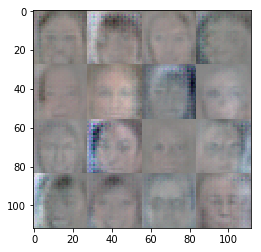

Epoch 1 / 1  D loss:  0.5523 ... G loss:  2.0665 ...
Epoch 1 / 1  D loss:  0.3666 ... G loss:  8.3300 ...
Epoch 1 / 1  D loss:  0.5705 ... G loss:  1.7819 ...
Epoch 1 / 1  D loss:  0.3838 ... G loss:  3.5554 ...
Epoch 1 / 1  D loss:  0.3510 ... G loss:  5.5752 ...
Epoch 1 / 1  D loss:  0.3486 ... G loss:  7.9185 ...
Epoch 1 / 1  D loss:  0.4190 ... G loss:  2.8141 ...
Epoch 1 / 1  D loss:  0.3577 ... G loss:  5.5536 ...
Epoch 1 / 1  D loss:  0.3477 ... G loss:  6.3270 ...
Epoch 1 / 1  D loss:  0.4512 ... G loss:  2.4154 ...


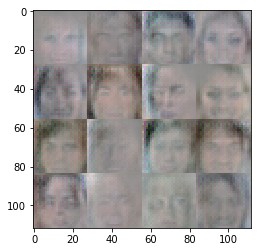

Epoch 1 / 1  D loss:  0.5690 ... G loss:  5.9727 ...
Epoch 1 / 1  D loss:  0.4139 ... G loss:  2.9711 ...
Epoch 1 / 1  D loss:  0.4620 ... G loss:  4.1101 ...
Epoch 1 / 1  D loss:  0.4549 ... G loss:  2.6733 ...
Epoch 1 / 1  D loss:  0.5189 ... G loss:  1.9745 ...
Epoch 1 / 1  D loss:  0.3448 ... G loss:  10.3703 ...
Epoch 1 / 1  D loss:  0.5850 ... G loss:  1.6779 ...
Epoch 1 / 1  D loss:  0.4097 ... G loss:  3.0367 ...
Epoch 1 / 1  D loss:  0.4777 ... G loss:  2.5781 ...
Epoch 1 / 1  D loss:  1.1126 ... G loss:  0.8164 ...


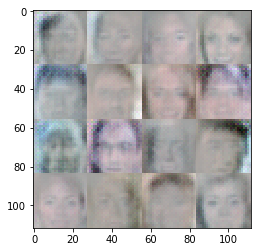

Epoch 1 / 1  D loss:  0.4606 ... G loss:  2.9550 ...
Epoch 1 / 1  D loss:  0.6829 ... G loss:  1.5949 ...
Epoch 1 / 1  D loss:  0.3988 ... G loss:  4.7119 ...
Epoch 1 / 1  D loss:  0.7994 ... G loss:  1.1872 ...
Epoch 1 / 1  D loss:  0.6905 ... G loss:  1.3857 ...
Epoch 1 / 1  D loss:  0.3657 ... G loss:  4.1495 ...
Epoch 1 / 1  D loss:  0.5501 ... G loss:  1.8494 ...
Epoch 1 / 1  D loss:  0.3825 ... G loss:  4.4261 ...
Epoch 1 / 1  D loss:  0.3977 ... G loss:  3.0451 ...
Epoch 1 / 1  D loss:  0.3810 ... G loss:  3.3811 ...


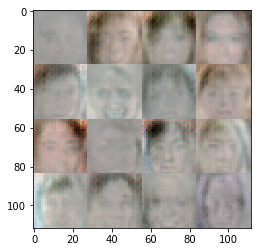

Epoch 1 / 1  D loss:  0.3660 ... G loss:  6.1196 ...
Epoch 1 / 1  D loss:  0.5230 ... G loss:  2.3730 ...
Epoch 1 / 1  D loss:  0.4264 ... G loss:  2.8254 ...
Epoch 1 / 1  D loss:  0.3439 ... G loss:  7.2937 ...
Epoch 1 / 1  D loss:  0.5501 ... G loss:  1.8246 ...
Epoch 1 / 1  D loss:  0.4645 ... G loss:  2.3823 ...
Epoch 1 / 1  D loss:  0.4008 ... G loss:  6.0558 ...
Epoch 1 / 1  D loss:  0.5276 ... G loss:  2.1014 ...
Epoch 1 / 1  D loss:  0.3731 ... G loss:  7.1467 ...
Epoch 1 / 1  D loss:  0.4071 ... G loss:  3.0101 ...


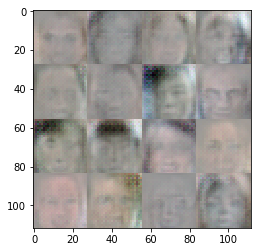

Epoch 1 / 1  D loss:  0.4633 ... G loss:  3.8620 ...
Epoch 1 / 1  D loss:  0.3836 ... G loss:  5.4702 ...
Epoch 1 / 1  D loss:  0.3759 ... G loss:  3.9963 ...
Epoch 1 / 1  D loss:  0.4156 ... G loss:  3.9475 ...
Epoch 1 / 1  D loss:  0.6020 ... G loss:  1.6814 ...
Epoch 1 / 1  D loss:  0.4952 ... G loss:  2.8966 ...
Epoch 1 / 1  D loss:  0.3780 ... G loss:  4.0394 ...
Epoch 1 / 1  D loss:  0.4264 ... G loss:  2.7855 ...
Epoch 1 / 1  D loss:  0.3782 ... G loss:  4.4807 ...
Epoch 1 / 1  D loss:  0.3451 ... G loss:  6.2737 ...


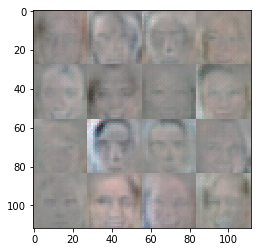

Epoch 1 / 1  D loss:  0.3572 ... G loss:  5.9733 ...
Epoch 1 / 1  D loss:  0.3401 ... G loss:  6.8726 ...
Epoch 1 / 1  D loss:  1.0560 ... G loss:  0.7471 ...
Epoch 1 / 1  D loss:  0.4264 ... G loss:  3.9253 ...
Epoch 1 / 1  D loss:  1.9609 ... G loss:  1.1149 ...
Epoch 1 / 1  D loss:  0.4314 ... G loss:  3.6405 ...
Epoch 1 / 1  D loss:  0.5848 ... G loss:  1.7823 ...
Epoch 1 / 1  D loss:  0.5492 ... G loss:  2.8620 ...
Epoch 1 / 1  D loss:  0.3601 ... G loss:  4.4441 ...
Epoch 1 / 1  D loss:  0.5320 ... G loss:  6.4584 ...


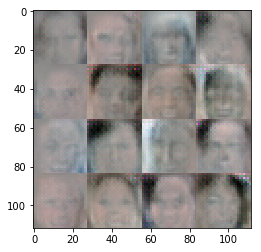

Epoch 1 / 1  D loss:  0.8610 ... G loss:  0.9766 ...
Epoch 1 / 1  D loss:  0.3873 ... G loss:  3.9911 ...
Epoch 1 / 1  D loss:  0.3464 ... G loss:  10.1688 ...
Epoch 1 / 1  D loss:  0.4853 ... G loss:  2.4229 ...
Epoch 1 / 1  D loss:  0.5032 ... G loss:  2.2239 ...
Epoch 1 / 1  D loss:  0.6757 ... G loss:  1.4400 ...
Epoch 1 / 1  D loss:  0.5860 ... G loss:  1.8350 ...
Epoch 1 / 1  D loss:  0.3766 ... G loss:  4.1728 ...
Epoch 1 / 1  D loss:  0.3726 ... G loss:  3.8437 ...
Epoch 1 / 1  D loss:  0.4150 ... G loss:  2.9469 ...


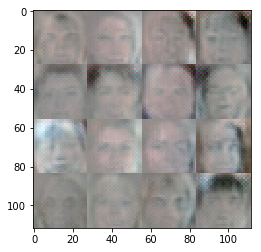

Epoch 1 / 1  D loss:  0.4247 ... G loss:  2.8742 ...
Epoch 1 / 1  D loss:  0.7125 ... G loss:  1.3444 ...
Epoch 1 / 1  D loss:  0.3622 ... G loss:  4.3490 ...
Epoch 1 / 1  D loss:  0.3592 ... G loss:  5.0335 ...
Epoch 1 / 1  D loss:  0.4306 ... G loss:  2.7215 ...
Epoch 1 / 1  D loss:  0.5599 ... G loss:  1.8332 ...
Epoch 1 / 1  D loss:  0.3790 ... G loss:  4.1108 ...
Epoch 1 / 1  D loss:  0.3953 ... G loss:  3.4264 ...
Epoch 1 / 1  D loss:  0.4081 ... G loss:  4.5843 ...
Epoch 1 / 1  D loss:  0.3757 ... G loss:  5.9685 ...


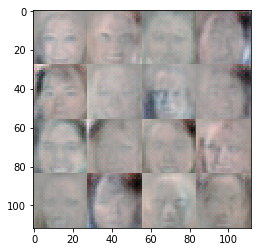

Epoch 1 / 1  D loss:  0.5767 ... G loss:  1.7540 ...
Epoch 1 / 1  D loss:  0.8674 ... G loss:  1.3304 ...
Epoch 1 / 1  D loss:  1.3532 ... G loss:  5.1125 ...
Epoch 1 / 1  D loss:  0.4333 ... G loss:  3.9860 ...
Epoch 1 / 1  D loss:  0.3856 ... G loss:  4.2588 ...
Epoch 1 / 1  D loss:  0.3951 ... G loss:  3.3993 ...
Epoch 1 / 1  D loss:  0.7160 ... G loss:  1.3525 ...
Epoch 1 / 1  D loss:  0.3487 ... G loss:  9.7307 ...
Epoch 1 / 1  D loss:  0.5251 ... G loss:  2.0955 ...
Epoch 1 / 1  D loss:  0.4330 ... G loss:  2.6530 ...


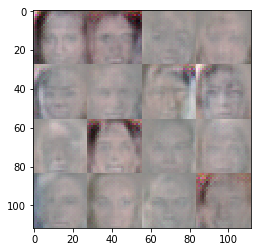

Epoch 1 / 1  D loss:  0.4010 ... G loss:  3.3011 ...
Epoch 1 / 1  D loss:  0.4679 ... G loss:  2.4669 ...
Epoch 1 / 1  D loss:  0.3453 ... G loss:  7.3808 ...
Epoch 1 / 1  D loss:  0.3691 ... G loss:  3.8994 ...
Epoch 1 / 1  D loss:  0.3527 ... G loss:  4.8756 ...
Epoch 1 / 1  D loss:  0.3784 ... G loss:  3.9574 ...
Epoch 1 / 1  D loss:  0.6201 ... G loss:  1.9508 ...
Epoch 1 / 1  D loss:  0.4076 ... G loss:  3.4455 ...
Epoch 1 / 1  D loss:  0.3652 ... G loss:  4.0697 ...
Epoch 1 / 1  D loss:  0.3577 ... G loss:  4.6089 ...


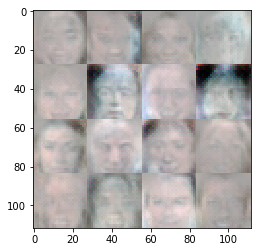

Epoch 1 / 1  D loss:  0.4425 ... G loss:  2.6953 ...
Epoch 1 / 1  D loss:  0.8142 ... G loss:  1.4266 ...
Epoch 1 / 1  D loss:  1.2090 ... G loss:  0.8411 ...
Epoch 1 / 1  D loss:  0.7009 ... G loss:  1.3634 ...
Epoch 1 / 1  D loss:  0.3914 ... G loss:  3.3907 ...
Epoch 1 / 1  D loss:  0.4623 ... G loss:  2.4554 ...
Epoch 1 / 1  D loss:  0.4183 ... G loss:  2.8248 ...
Epoch 1 / 1  D loss:  0.7400 ... G loss:  1.2366 ...
Epoch 1 / 1  D loss:  0.3675 ... G loss:  4.1389 ...
Epoch 1 / 1  D loss:  0.3568 ... G loss:  6.0106 ...


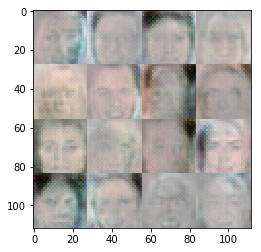

Epoch 1 / 1  D loss:  0.3743 ... G loss:  3.7200 ...
Epoch 1 / 1  D loss:  0.3537 ... G loss:  5.3281 ...
Epoch 1 / 1  D loss:  1.1532 ... G loss:  0.6832 ...
Epoch 1 / 1  D loss:  0.3634 ... G loss:  4.2089 ...
Epoch 1 / 1  D loss:  0.3611 ... G loss:  5.4784 ...
Epoch 1 / 1  D loss:  0.4010 ... G loss:  3.0589 ...
Epoch 1 / 1  D loss:  0.3569 ... G loss:  5.6715 ...
Epoch 1 / 1  D loss:  0.4399 ... G loss:  2.7135 ...
Epoch 1 / 1  D loss:  0.3803 ... G loss:  3.8645 ...
Epoch 1 / 1  D loss:  0.3622 ... G loss:  9.5565 ...


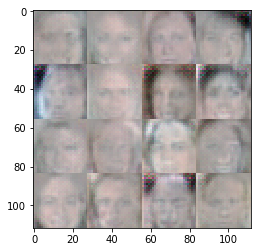

Epoch 1 / 1  D loss:  3.6004 ... G loss:  0.1235 ...
Epoch 1 / 1  D loss:  0.3704 ... G loss:  7.8642 ...
Epoch 1 / 1  D loss:  0.4365 ... G loss:  3.9720 ...
Epoch 1 / 1  D loss:  0.5777 ... G loss:  1.8657 ...
Epoch 1 / 1  D loss:  0.3993 ... G loss:  8.7851 ...
Epoch 1 / 1  D loss:  0.3611 ... G loss:  6.5938 ...
Epoch 1 / 1  D loss:  0.4489 ... G loss:  2.7855 ...
Epoch 1 / 1  D loss:  0.3534 ... G loss:  4.9758 ...
Epoch 1 / 1  D loss:  0.5173 ... G loss:  2.1415 ...
Epoch 1 / 1  D loss:  0.4012 ... G loss:  3.9450 ...


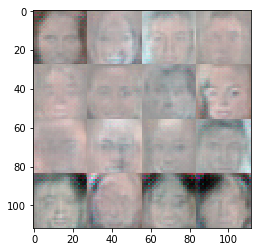

Epoch 1 / 1  D loss:  0.4292 ... G loss:  11.5695 ...
Epoch 1 / 1  D loss:  0.4718 ... G loss:  2.5976 ...
Epoch 1 / 1  D loss:  0.4572 ... G loss:  2.5533 ...
Epoch 1 / 1  D loss:  0.3552 ... G loss:  5.7691 ...
Epoch 1 / 1  D loss:  0.4552 ... G loss:  2.7134 ...
Epoch 1 / 1  D loss:  0.4157 ... G loss:  2.8878 ...
Epoch 1 / 1  D loss:  0.4632 ... G loss:  2.3965 ...
Epoch 1 / 1  D loss:  0.3980 ... G loss:  3.1655 ...
Epoch 1 / 1  D loss:  0.4461 ... G loss:  3.6009 ...
Epoch 1 / 1  D loss:  0.4068 ... G loss:  3.2285 ...


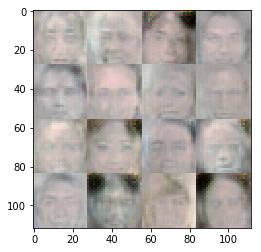

Epoch 1 / 1  D loss:  0.4758 ... G loss:  2.8260 ...
Epoch 1 / 1  D loss:  0.5247 ... G loss:  2.2215 ...
Epoch 1 / 1  D loss:  0.3416 ... G loss:  13.7452 ...
Epoch 1 / 1  D loss:  0.3426 ... G loss:  11.5300 ...
Epoch 1 / 1  D loss:  0.3572 ... G loss:  6.8043 ...
Epoch 1 / 1  D loss:  0.4656 ... G loss:  2.4665 ...
Epoch 1 / 1  D loss:  0.4210 ... G loss:  3.0561 ...
Epoch 1 / 1  D loss:  0.8371 ... G loss:  1.0648 ...
Epoch 1 / 1  D loss:  0.4904 ... G loss:  2.9094 ...
Epoch 1 / 1  D loss:  0.3916 ... G loss:  3.6368 ...


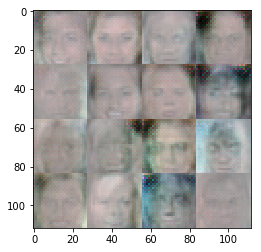

Epoch 1 / 1  D loss:  0.5229 ... G loss:  2.6798 ...
Epoch 1 / 1  D loss:  0.3751 ... G loss:  4.0948 ...
Epoch 1 / 1  D loss:  2.2095 ... G loss:  0.4064 ...
Epoch 1 / 1  D loss:  0.5436 ... G loss:  2.4956 ...
Epoch 1 / 1  D loss:  1.0736 ... G loss:  0.8266 ...
Epoch 1 / 1  D loss:  0.5952 ... G loss:  1.8146 ...
Epoch 1 / 1  D loss:  0.7436 ... G loss:  1.3824 ...


In [41]:
# noise = .1 std
losses = train( net, epoch_count, batch_size, z_dim, 
                celeba_dataset.get_batches, celeba_dataset.image_mode)

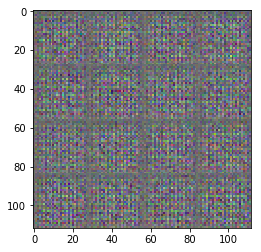

Epoch 1 / 1  D loss:  0.6971 ... G loss:  1.9018 ...
Epoch 1 / 1  D loss:  1.6421 ... G loss:  0.4597 ...
Epoch 1 / 1  D loss:  4.5620 ... G loss:  0.0166 ...
Epoch 1 / 1  D loss:  3.4927 ... G loss:  17.2322 ...
Epoch 1 / 1  D loss:  0.5934 ... G loss:  1.9309 ...
Epoch 1 / 1  D loss:  0.5481 ... G loss:  2.2000 ...
Epoch 1 / 1  D loss:  0.5765 ... G loss:  2.1797 ...
Epoch 1 / 1  D loss:  0.6053 ... G loss:  2.2824 ...
Epoch 1 / 1  D loss:  0.6334 ... G loss:  1.8777 ...


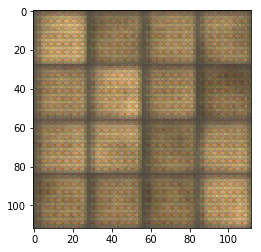

Epoch 1 / 1  D loss:  0.5432 ... G loss:  2.2951 ...
Epoch 1 / 1  D loss:  0.4478 ... G loss:  2.9166 ...
Epoch 1 / 1  D loss:  0.5370 ... G loss:  3.5000 ...
Epoch 1 / 1  D loss:  0.4219 ... G loss:  3.4170 ...
Epoch 1 / 1  D loss:  0.4225 ... G loss:  3.0764 ...
Epoch 1 / 1  D loss:  0.4263 ... G loss:  3.0324 ...
Epoch 1 / 1  D loss:  0.3735 ... G loss:  3.9110 ...
Epoch 1 / 1  D loss:  0.3873 ... G loss:  3.7826 ...
Epoch 1 / 1  D loss:  0.3782 ... G loss:  3.5991 ...
Epoch 1 / 1  D loss:  0.3606 ... G loss:  5.1909 ...


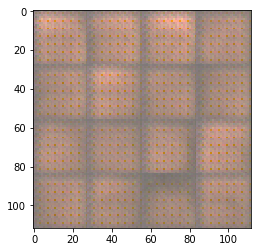

Epoch 1 / 1  D loss:  0.3460 ... G loss:  5.0206 ...
Epoch 1 / 1  D loss:  0.3852 ... G loss:  4.4082 ...
Epoch 1 / 1  D loss:  0.3561 ... G loss:  6.1606 ...
Epoch 1 / 1  D loss:  0.3537 ... G loss:  4.4450 ...
Epoch 1 / 1  D loss:  0.3407 ... G loss:  5.8383 ...
Epoch 1 / 1  D loss:  0.4297 ... G loss:  3.7837 ...
Epoch 1 / 1  D loss:  0.3465 ... G loss:  5.0329 ...
Epoch 1 / 1  D loss:  0.3518 ... G loss:  5.2036 ...
Epoch 1 / 1  D loss:  0.3741 ... G loss:  4.5310 ...
Epoch 1 / 1  D loss:  0.3564 ... G loss:  5.1141 ...


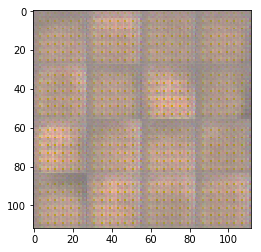

Epoch 1 / 1  D loss:  0.3379 ... G loss:  6.3235 ...
Epoch 1 / 1  D loss:  0.3917 ... G loss:  3.4175 ...
Epoch 1 / 1  D loss:  0.3477 ... G loss:  4.5771 ...
Epoch 1 / 1  D loss:  0.3994 ... G loss:  4.7707 ...
Epoch 1 / 1  D loss:  0.3376 ... G loss:  6.2556 ...
Epoch 1 / 1  D loss:  0.3464 ... G loss:  4.9259 ...
Epoch 1 / 1  D loss:  0.3548 ... G loss:  4.0588 ...
Epoch 1 / 1  D loss:  0.5585 ... G loss:  4.8489 ...
Epoch 1 / 1  D loss:  0.4548 ... G loss:  2.8716 ...
Epoch 1 / 1  D loss:  6.9334 ... G loss:  0.0030 ...


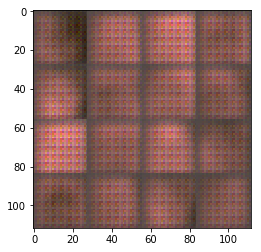

Epoch 1 / 1  D loss:  0.6554 ... G loss:  3.3491 ...
Epoch 1 / 1  D loss:  0.9171 ... G loss:  4.8267 ...
Epoch 1 / 1  D loss:  1.7152 ... G loss:  0.3414 ...
Epoch 1 / 1  D loss:  0.6390 ... G loss:  2.0041 ...
Epoch 1 / 1  D loss:  0.5885 ... G loss:  1.8518 ...
Epoch 1 / 1  D loss:  0.7243 ... G loss:  6.2188 ...
Epoch 1 / 1  D loss:  0.5912 ... G loss:  3.4303 ...
Epoch 1 / 1  D loss:  0.6867 ... G loss:  1.6280 ...
Epoch 1 / 1  D loss:  0.7511 ... G loss:  1.2799 ...
Epoch 1 / 1  D loss:  1.3992 ... G loss:  0.5981 ...


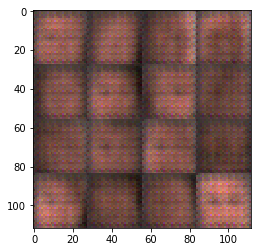

Epoch 1 / 1  D loss:  0.4434 ... G loss:  3.3311 ...
Epoch 1 / 1  D loss:  0.3807 ... G loss:  4.8352 ...
Epoch 1 / 1  D loss:  0.7517 ... G loss:  4.4205 ...
Epoch 1 / 1  D loss:  2.3114 ... G loss:  0.1998 ...
Epoch 1 / 1  D loss:  0.4969 ... G loss:  3.3965 ...
Epoch 1 / 1  D loss:  0.5807 ... G loss:  4.3938 ...
Epoch 1 / 1  D loss:  0.4587 ... G loss:  4.3132 ...
Epoch 1 / 1  D loss:  0.4845 ... G loss:  2.5603 ...
Epoch 1 / 1  D loss:  0.4746 ... G loss:  3.1517 ...
Epoch 1 / 1  D loss:  0.4414 ... G loss:  3.8272 ...


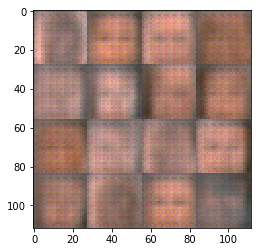

Epoch 1 / 1  D loss:  0.5580 ... G loss:  9.6919 ...
Epoch 1 / 1  D loss:  0.9399 ... G loss:  5.5911 ...
Epoch 1 / 1  D loss:  0.4610 ... G loss:  2.7754 ...
Epoch 1 / 1  D loss:  0.5040 ... G loss:  3.8016 ...
Epoch 1 / 1  D loss:  0.6132 ... G loss:  2.8968 ...
Epoch 1 / 1  D loss:  1.1647 ... G loss:  0.7923 ...
Epoch 1 / 1  D loss:  1.7447 ... G loss:  0.3358 ...
Epoch 1 / 1  D loss:  0.8638 ... G loss:  2.1749 ...
Epoch 1 / 1  D loss:  1.0595 ... G loss:  0.8769 ...
Epoch 1 / 1  D loss:  1.0806 ... G loss:  0.8025 ...


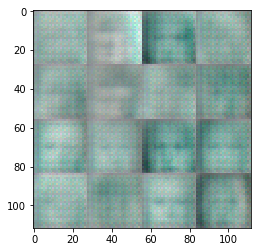

Epoch 1 / 1  D loss:  0.5898 ... G loss:  3.1235 ...
Epoch 1 / 1  D loss:  0.5720 ... G loss:  2.4834 ...
Epoch 1 / 1  D loss:  0.6809 ... G loss:  2.5236 ...
Epoch 1 / 1  D loss:  0.5897 ... G loss:  2.2428 ...
Epoch 1 / 1  D loss:  0.8209 ... G loss:  1.3745 ...
Epoch 1 / 1  D loss:  0.5305 ... G loss:  2.2783 ...
Epoch 1 / 1  D loss:  0.3908 ... G loss:  4.5037 ...
Epoch 1 / 1  D loss:  0.6917 ... G loss:  1.7016 ...
Epoch 1 / 1  D loss:  1.4701 ... G loss:  0.6909 ...
Epoch 1 / 1  D loss:  0.4764 ... G loss:  2.5825 ...


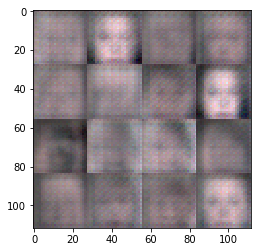

Epoch 1 / 1  D loss:  0.8040 ... G loss:  1.7861 ...
Epoch 1 / 1  D loss:  1.0252 ... G loss:  0.8289 ...
Epoch 1 / 1  D loss:  0.4893 ... G loss:  4.1364 ...
Epoch 1 / 1  D loss:  0.8293 ... G loss:  2.1724 ...
Epoch 1 / 1  D loss:  2.0908 ... G loss:  16.8932 ...
Epoch 1 / 1  D loss:  0.7278 ... G loss:  1.6579 ...
Epoch 1 / 1  D loss:  0.5120 ... G loss:  2.7888 ...
Epoch 1 / 1  D loss:  0.9498 ... G loss:  0.8869 ...
Epoch 1 / 1  D loss:  0.6668 ... G loss:  2.9991 ...
Epoch 1 / 1  D loss:  0.7110 ... G loss:  2.8918 ...


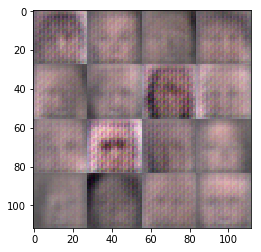

Epoch 1 / 1  D loss:  0.5422 ... G loss:  3.8812 ...
Epoch 1 / 1  D loss:  0.8430 ... G loss:  1.1302 ...
Epoch 1 / 1  D loss:  0.6705 ... G loss:  3.2123 ...
Epoch 1 / 1  D loss:  0.3997 ... G loss:  3.4471 ...
Epoch 1 / 1  D loss:  0.7853 ... G loss:  1.9489 ...
Epoch 1 / 1  D loss:  0.4171 ... G loss:  3.2653 ...
Epoch 1 / 1  D loss:  0.6209 ... G loss:  1.7273 ...
Epoch 1 / 1  D loss:  0.8498 ... G loss:  1.1844 ...
Epoch 1 / 1  D loss:  0.5418 ... G loss:  2.2224 ...
Epoch 1 / 1  D loss:  0.9867 ... G loss:  0.9249 ...


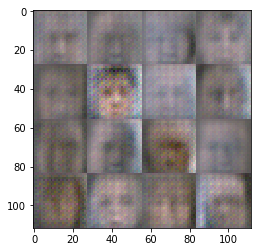

Epoch 1 / 1  D loss:  0.3941 ... G loss:  5.4129 ...
Epoch 1 / 1  D loss:  0.3724 ... G loss:  6.4987 ...
Epoch 1 / 1  D loss:  0.4638 ... G loss:  3.2698 ...
Epoch 1 / 1  D loss:  0.8594 ... G loss:  1.1145 ...
Epoch 1 / 1  D loss:  0.4129 ... G loss:  3.6934 ...
Epoch 1 / 1  D loss:  0.5578 ... G loss:  1.8754 ...
Epoch 1 / 1  D loss:  0.7698 ... G loss:  1.3002 ...
Epoch 1 / 1  D loss:  0.3828 ... G loss:  3.6610 ...
Epoch 1 / 1  D loss:  0.5211 ... G loss:  2.7419 ...
Epoch 1 / 1  D loss:  0.4038 ... G loss:  3.4809 ...


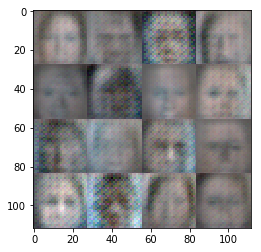

Epoch 1 / 1  D loss:  0.4017 ... G loss:  3.5456 ...
Epoch 1 / 1  D loss:  0.4355 ... G loss:  3.0191 ...
Epoch 1 / 1  D loss:  0.4030 ... G loss:  3.4668 ...
Epoch 1 / 1  D loss:  0.4825 ... G loss:  2.5512 ...
Epoch 1 / 1  D loss:  0.4251 ... G loss:  3.5108 ...
Epoch 1 / 1  D loss:  0.3994 ... G loss:  4.6703 ...
Epoch 1 / 1  D loss:  0.4832 ... G loss:  3.0202 ...
Epoch 1 / 1  D loss:  0.3949 ... G loss:  5.8364 ...
Epoch 1 / 1  D loss:  0.5255 ... G loss:  2.5426 ...
Epoch 1 / 1  D loss:  0.3949 ... G loss:  7.7894 ...


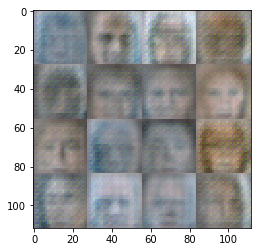

Epoch 1 / 1  D loss:  0.6074 ... G loss:  1.7852 ...
Epoch 1 / 1  D loss:  0.4198 ... G loss:  5.7289 ...
Epoch 1 / 1  D loss:  0.4181 ... G loss:  3.2540 ...
Epoch 1 / 1  D loss:  0.5522 ... G loss:  6.4461 ...
Epoch 1 / 1  D loss:  0.4021 ... G loss:  4.9372 ...
Epoch 1 / 1  D loss:  0.6317 ... G loss:  8.3069 ...
Epoch 1 / 1  D loss:  0.3563 ... G loss:  5.6007 ...
Epoch 1 / 1  D loss:  0.7298 ... G loss:  2.0542 ...
Epoch 1 / 1  D loss:  0.5373 ... G loss:  2.0645 ...
Epoch 1 / 1  D loss:  0.3612 ... G loss:  5.5237 ...


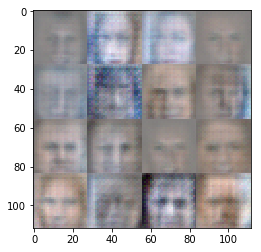

Epoch 1 / 1  D loss:  0.5227 ... G loss:  2.1226 ...
Epoch 1 / 1  D loss:  0.7091 ... G loss:  1.4082 ...
Epoch 1 / 1  D loss:  0.3493 ... G loss:  8.8887 ...
Epoch 1 / 1  D loss:  0.4074 ... G loss:  5.0691 ...
Epoch 1 / 1  D loss:  0.3670 ... G loss:  4.6934 ...
Epoch 1 / 1  D loss:  0.3585 ... G loss:  5.5539 ...
Epoch 1 / 1  D loss:  0.5052 ... G loss:  2.6853 ...
Epoch 1 / 1  D loss:  0.4026 ... G loss:  3.5955 ...
Epoch 1 / 1  D loss:  0.5322 ... G loss:  2.1055 ...
Epoch 1 / 1  D loss:  0.4905 ... G loss:  2.4762 ...


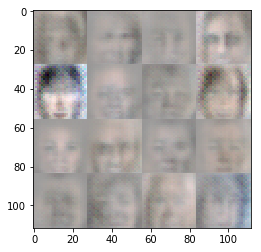

Epoch 1 / 1  D loss:  0.3642 ... G loss:  4.0519 ...
Epoch 1 / 1  D loss:  0.4711 ... G loss:  2.5979 ...
Epoch 1 / 1  D loss:  0.6578 ... G loss:  1.4637 ...
Epoch 1 / 1  D loss:  0.3425 ... G loss:  8.7731 ...
Epoch 1 / 1  D loss:  0.5371 ... G loss:  1.8502 ...
Epoch 1 / 1  D loss:  0.3501 ... G loss:  4.7163 ...
Epoch 1 / 1  D loss:  0.3585 ... G loss:  6.1132 ...
Epoch 1 / 1  D loss:  0.4633 ... G loss:  2.4276 ...
Epoch 1 / 1  D loss:  0.3753 ... G loss:  4.1445 ...
Epoch 1 / 1  D loss:  0.6040 ... G loss:  1.6323 ...


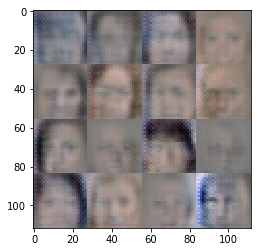

Epoch 1 / 1  D loss:  0.8061 ... G loss:  1.1431 ...
Epoch 1 / 1  D loss:  0.5379 ... G loss:  4.8085 ...
Epoch 1 / 1  D loss:  0.5026 ... G loss:  2.2728 ...
Epoch 1 / 1  D loss:  0.4702 ... G loss:  2.7878 ...
Epoch 1 / 1  D loss:  0.4146 ... G loss:  4.3432 ...
Epoch 1 / 1  D loss:  0.9595 ... G loss:  0.9173 ...
Epoch 1 / 1  D loss:  0.3616 ... G loss:  4.8492 ...
Epoch 1 / 1  D loss:  0.5186 ... G loss:  2.1453 ...
Epoch 1 / 1  D loss:  0.3546 ... G loss:  5.5144 ...
Epoch 1 / 1  D loss:  0.3353 ... G loss:  10.3352 ...


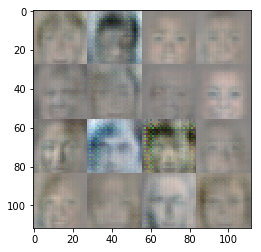

Epoch 1 / 1  D loss:  0.5106 ... G loss:  3.8349 ...
Epoch 1 / 1  D loss:  3.2560 ... G loss:  5.3736 ...
Epoch 1 / 1  D loss:  0.6995 ... G loss:  1.4768 ...
Epoch 1 / 1  D loss:  0.5448 ... G loss:  1.9892 ...
Epoch 1 / 1  D loss:  0.5963 ... G loss:  3.3961 ...
Epoch 1 / 1  D loss:  0.3788 ... G loss:  3.8904 ...
Epoch 1 / 1  D loss:  0.3675 ... G loss:  4.4476 ...
Epoch 1 / 1  D loss:  0.5972 ... G loss:  1.8818 ...
Epoch 1 / 1  D loss:  0.3734 ... G loss:  3.9120 ...
Epoch 1 / 1  D loss:  0.4102 ... G loss:  3.0573 ...


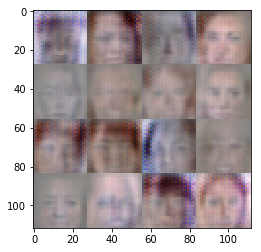

Epoch 1 / 1  D loss:  0.3484 ... G loss:  7.2039 ...
Epoch 1 / 1  D loss:  0.4861 ... G loss:  2.2058 ...
Epoch 1 / 1  D loss:  0.3795 ... G loss:  12.8358 ...
Epoch 1 / 1  D loss:  0.4636 ... G loss:  2.6797 ...
Epoch 1 / 1  D loss:  0.6094 ... G loss:  3.4629 ...
Epoch 1 / 1  D loss:  0.3986 ... G loss:  3.7016 ...
Epoch 1 / 1  D loss:  0.5614 ... G loss:  1.8945 ...
Epoch 1 / 1  D loss:  0.4066 ... G loss:  6.5957 ...
Epoch 1 / 1  D loss:  0.3387 ... G loss:  11.4121 ...
Epoch 1 / 1  D loss:  0.4413 ... G loss:  3.8633 ...


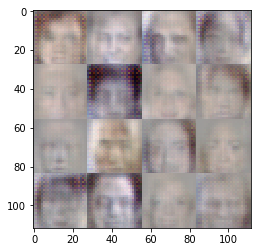

Epoch 1 / 1  D loss:  0.3469 ... G loss:  9.8578 ...
Epoch 1 / 1  D loss:  0.4453 ... G loss:  4.7326 ...
Epoch 1 / 1  D loss:  0.4477 ... G loss:  2.6651 ...
Epoch 1 / 1  D loss:  0.5325 ... G loss:  1.9837 ...
Epoch 1 / 1  D loss:  0.4514 ... G loss:  3.9454 ...
Epoch 1 / 1  D loss:  0.6985 ... G loss:  1.4794 ...
Epoch 1 / 1  D loss:  0.4236 ... G loss:  2.9851 ...
Epoch 1 / 1  D loss:  0.4678 ... G loss:  2.3322 ...
Epoch 1 / 1  D loss:  0.4178 ... G loss:  3.0542 ...
Epoch 1 / 1  D loss:  0.6481 ... G loss:  1.5293 ...


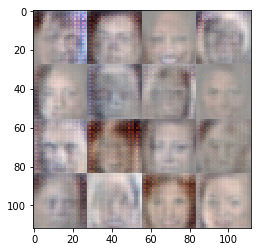

Epoch 1 / 1  D loss:  0.7366 ... G loss:  1.4020 ...
Epoch 1 / 1  D loss:  0.4941 ... G loss:  2.3307 ...
Epoch 1 / 1  D loss:  0.9035 ... G loss:  1.7380 ...
Epoch 1 / 1  D loss:  0.3828 ... G loss:  3.9212 ...
Epoch 1 / 1  D loss:  0.4842 ... G loss:  2.8366 ...
Epoch 1 / 1  D loss:  0.4822 ... G loss:  3.3111 ...
Epoch 1 / 1  D loss:  0.6530 ... G loss:  3.0164 ...
Epoch 1 / 1  D loss:  0.4111 ... G loss:  3.0153 ...
Epoch 1 / 1  D loss:  0.3575 ... G loss:  5.0613 ...
Epoch 1 / 1  D loss:  0.5547 ... G loss:  1.9296 ...


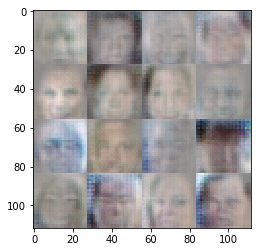

Epoch 1 / 1  D loss:  0.4301 ... G loss:  6.7265 ...
Epoch 1 / 1  D loss:  0.6385 ... G loss:  4.1000 ...
Epoch 1 / 1  D loss:  0.4499 ... G loss:  2.5368 ...
Epoch 1 / 1  D loss:  0.3554 ... G loss:  12.5123 ...
Epoch 1 / 1  D loss:  0.6526 ... G loss:  1.4894 ...
Epoch 1 / 1  D loss:  2.6866 ... G loss:  0.2993 ...
Epoch 1 / 1  D loss:  1.4397 ... G loss:  0.5286 ...
Epoch 1 / 1  D loss:  0.8081 ... G loss:  1.3774 ...
Epoch 1 / 1  D loss:  0.3780 ... G loss:  4.3278 ...
Epoch 1 / 1  D loss:  0.6217 ... G loss:  3.0633 ...


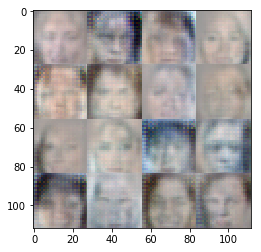

Epoch 1 / 1  D loss:  0.4217 ... G loss:  3.4506 ...
Epoch 1 / 1  D loss:  0.3581 ... G loss:  6.0971 ...
Epoch 1 / 1  D loss:  0.6254 ... G loss:  1.6554 ...
Epoch 1 / 1  D loss:  0.3507 ... G loss:  12.2894 ...
Epoch 1 / 1  D loss:  0.4357 ... G loss:  2.6933 ...
Epoch 1 / 1  D loss:  0.3860 ... G loss:  3.2680 ...
Epoch 1 / 1  D loss:  0.4665 ... G loss:  3.6269 ...
Epoch 1 / 1  D loss:  0.3656 ... G loss:  5.0015 ...
Epoch 1 / 1  D loss:  0.5521 ... G loss:  2.0137 ...
Epoch 1 / 1  D loss:  0.9346 ... G loss:  0.9998 ...


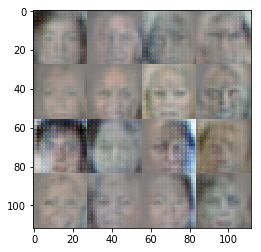

Epoch 1 / 1  D loss:  0.5515 ... G loss:  2.0263 ...
Epoch 1 / 1  D loss:  0.4141 ... G loss:  3.1412 ...
Epoch 1 / 1  D loss:  0.4292 ... G loss:  2.8601 ...
Epoch 1 / 1  D loss:  0.5432 ... G loss:  2.2198 ...
Epoch 1 / 1  D loss:  0.5845 ... G loss:  2.2257 ...
Epoch 1 / 1  D loss:  0.4106 ... G loss:  3.3152 ...
Epoch 1 / 1  D loss:  0.5117 ... G loss:  2.4796 ...
Epoch 1 / 1  D loss:  0.4673 ... G loss:  3.1907 ...
Epoch 1 / 1  D loss:  0.8134 ... G loss:  1.1589 ...
Epoch 1 / 1  D loss:  0.5014 ... G loss:  2.8788 ...


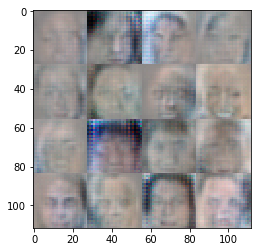

Epoch 1 / 1  D loss:  0.3604 ... G loss:  13.8276 ...
Epoch 1 / 1  D loss:  0.5399 ... G loss:  2.5334 ...
Epoch 1 / 1  D loss:  0.4004 ... G loss:  3.4289 ...
Epoch 1 / 1  D loss:  0.8349 ... G loss:  3.1737 ...
Epoch 1 / 1  D loss:  0.5352 ... G loss:  2.5717 ...
Epoch 1 / 1  D loss:  0.6225 ... G loss:  1.9230 ...
Epoch 1 / 1  D loss:  0.6092 ... G loss:  1.7340 ...
Epoch 1 / 1  D loss:  0.4948 ... G loss:  2.9569 ...
Epoch 1 / 1  D loss:  0.5392 ... G loss:  3.7491 ...
Epoch 1 / 1  D loss:  0.4432 ... G loss:  2.8869 ...


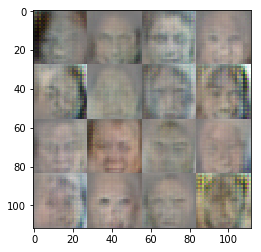

Epoch 1 / 1  D loss:  0.6498 ... G loss:  1.6800 ...
Epoch 1 / 1  D loss:  1.6190 ... G loss:  0.5404 ...
Epoch 1 / 1  D loss:  1.0513 ... G loss:  1.2970 ...
Epoch 1 / 1  D loss:  0.7875 ... G loss:  1.3986 ...
Epoch 1 / 1  D loss:  0.4900 ... G loss:  5.7431 ...
Epoch 1 / 1  D loss:  0.4493 ... G loss:  3.8845 ...
Epoch 1 / 1  D loss:  0.5061 ... G loss:  4.2300 ...
Epoch 1 / 1  D loss:  0.4879 ... G loss:  2.3732 ...
Epoch 1 / 1  D loss:  0.5955 ... G loss:  2.7220 ...
Epoch 1 / 1  D loss:  0.3952 ... G loss:  3.9850 ...


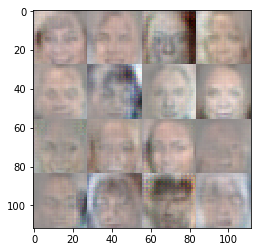

Epoch 1 / 1  D loss:  0.7447 ... G loss:  1.3037 ...
Epoch 1 / 1  D loss:  0.3832 ... G loss:  9.2488 ...
Epoch 1 / 1  D loss:  0.5065 ... G loss:  2.1974 ...
Epoch 1 / 1  D loss:  0.5077 ... G loss:  2.7299 ...
Epoch 1 / 1  D loss:  0.4324 ... G loss:  2.7987 ...
Epoch 1 / 1  D loss:  0.4375 ... G loss:  2.9604 ...
Epoch 1 / 1  D loss:  0.6812 ... G loss:  1.4916 ...
Epoch 1 / 1  D loss:  0.5035 ... G loss:  3.6087 ...
Epoch 1 / 1  D loss:  0.4934 ... G loss:  2.2975 ...
Epoch 1 / 1  D loss:  0.4768 ... G loss:  2.8544 ...


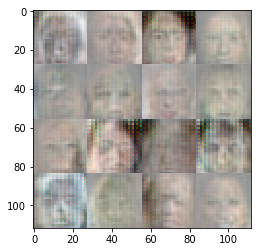

Epoch 1 / 1  D loss:  0.4447 ... G loss:  2.6612 ...
Epoch 1 / 1  D loss:  0.5736 ... G loss:  2.4542 ...
Epoch 1 / 1  D loss:  0.5474 ... G loss:  1.9410 ...
Epoch 1 / 1  D loss:  0.4222 ... G loss:  3.3650 ...
Epoch 1 / 1  D loss:  0.8859 ... G loss:  1.1140 ...
Epoch 1 / 1  D loss:  0.5643 ... G loss:  1.9242 ...
Epoch 1 / 1  D loss:  0.3853 ... G loss:  4.0262 ...
Epoch 1 / 1  D loss:  0.4838 ... G loss:  2.5859 ...
Epoch 1 / 1  D loss:  0.4231 ... G loss:  3.0930 ...
Epoch 1 / 1  D loss:  0.7779 ... G loss:  3.2431 ...


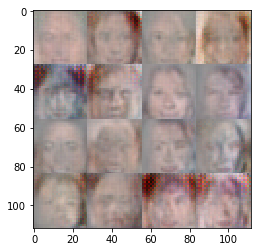

Epoch 1 / 1  D loss:  0.7795 ... G loss:  4.3757 ...
Epoch 1 / 1  D loss:  0.5198 ... G loss:  2.1424 ...
Epoch 1 / 1  D loss:  0.7301 ... G loss:  1.3041 ...
Epoch 1 / 1  D loss:  0.3803 ... G loss:  3.9101 ...
Epoch 1 / 1  D loss:  0.5758 ... G loss:  2.0177 ...
Epoch 1 / 1  D loss:  0.5312 ... G loss:  2.0959 ...
Epoch 1 / 1  D loss:  0.6817 ... G loss:  1.4455 ...
Epoch 1 / 1  D loss:  0.5830 ... G loss:  2.1671 ...
Epoch 1 / 1  D loss:  0.4883 ... G loss:  2.3538 ...
Epoch 1 / 1  D loss:  1.7445 ... G loss:  5.4456 ...


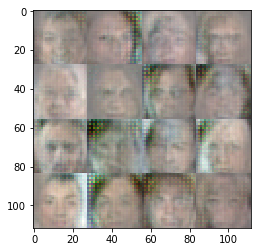

Epoch 1 / 1  D loss:  0.4542 ... G loss:  3.6757 ...
Epoch 1 / 1  D loss:  0.5299 ... G loss:  2.0800 ...
Epoch 1 / 1  D loss:  0.4228 ... G loss:  3.0331 ...
Epoch 1 / 1  D loss:  0.4154 ... G loss:  4.0324 ...
Epoch 1 / 1  D loss:  0.4995 ... G loss:  2.2619 ...
Epoch 1 / 1  D loss:  0.3949 ... G loss:  3.3233 ...
Epoch 1 / 1  D loss:  0.6522 ... G loss:  5.7735 ...
Epoch 1 / 1  D loss:  0.4561 ... G loss:  5.7997 ...
Epoch 1 / 1  D loss:  0.8164 ... G loss:  1.3671 ...
Epoch 1 / 1  D loss:  0.5338 ... G loss:  2.3675 ...


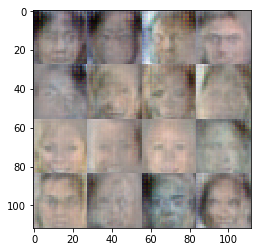

Epoch 1 / 1  D loss:  0.5713 ... G loss:  1.7958 ...
Epoch 1 / 1  D loss:  0.5996 ... G loss:  2.8449 ...
Epoch 1 / 1  D loss:  0.3899 ... G loss:  3.7094 ...
Epoch 1 / 1  D loss:  0.4738 ... G loss:  2.5076 ...
Epoch 1 / 1  D loss:  0.7983 ... G loss:  1.2301 ...
Epoch 1 / 1  D loss:  0.5147 ... G loss:  2.0989 ...
Epoch 1 / 1  D loss:  0.3963 ... G loss:  4.8354 ...
Epoch 1 / 1  D loss:  1.0876 ... G loss:  1.0434 ...
Epoch 1 / 1  D loss:  0.7276 ... G loss:  1.6907 ...
Epoch 1 / 1  D loss:  1.1513 ... G loss:  0.7168 ...


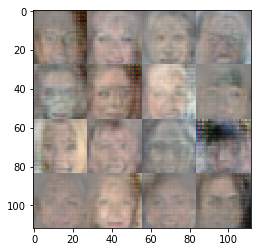

Epoch 1 / 1  D loss:  0.5690 ... G loss:  2.3978 ...
Epoch 1 / 1  D loss:  1.1046 ... G loss:  0.8340 ...
Epoch 1 / 1  D loss:  0.5624 ... G loss:  2.1478 ...
Epoch 1 / 1  D loss:  0.3732 ... G loss:  6.6998 ...
Epoch 1 / 1  D loss:  0.5292 ... G loss:  2.5946 ...
Epoch 1 / 1  D loss:  0.4655 ... G loss:  2.5823 ...
Epoch 1 / 1  D loss:  0.3665 ... G loss:  4.2851 ...
Epoch 1 / 1  D loss:  0.4942 ... G loss:  2.3204 ...
Epoch 1 / 1  D loss:  0.4782 ... G loss:  2.3791 ...
Epoch 1 / 1  D loss:  0.4393 ... G loss:  2.8337 ...


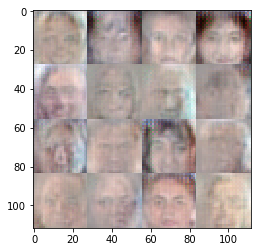

Epoch 1 / 1  D loss:  0.3508 ... G loss:  12.4826 ...
Epoch 1 / 1  D loss:  0.4335 ... G loss:  3.1763 ...
Epoch 1 / 1  D loss:  0.5982 ... G loss:  1.6443 ...
Epoch 1 / 1  D loss:  0.4668 ... G loss:  7.2241 ...
Epoch 1 / 1  D loss:  0.5855 ... G loss:  3.5964 ...
Epoch 1 / 1  D loss:  0.8788 ... G loss:  1.1403 ...
Epoch 1 / 1  D loss:  0.6482 ... G loss:  1.6616 ...


In [36]:
# beta1 = .5
# noise .2 std
losses = train( net, epoch_count, batch_size, z_dim, 
                celeba_dataset.get_batches, celeba_dataset.image_mode)

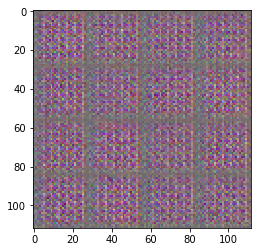

Epoch 1 / 1  D loss:  3.3599 ... G loss:  0.2483 ...
Epoch 1 / 1  D loss:  1.4506 ... G loss:  0.5573 ...
Epoch 1 / 1  D loss:  1.7605 ... G loss:  0.6887 ...
Epoch 1 / 1  D loss:  0.9161 ... G loss:  1.9587 ...
Epoch 1 / 1  D loss:  0.9306 ... G loss:  2.6493 ...
Epoch 1 / 1  D loss:  1.0091 ... G loss:  2.7961 ...
Epoch 1 / 1  D loss:  1.9198 ... G loss:  0.5007 ...
Epoch 1 / 1  D loss:  1.5814 ... G loss:  0.6644 ...
Epoch 1 / 1  D loss:  1.0003 ... G loss:  1.4582 ...


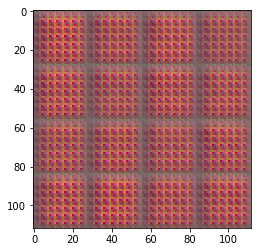

Epoch 1 / 1  D loss:  0.8877 ... G loss:  1.2502 ...
Epoch 1 / 1  D loss:  1.8924 ... G loss:  0.5128 ...
Epoch 1 / 1  D loss:  1.4152 ... G loss:  0.9999 ...
Epoch 1 / 1  D loss:  1.5574 ... G loss:  0.8396 ...
Epoch 1 / 1  D loss:  1.3101 ... G loss:  1.8433 ...
Epoch 1 / 1  D loss:  1.5248 ... G loss:  1.0017 ...
Epoch 1 / 1  D loss:  0.8327 ... G loss:  2.0689 ...
Epoch 1 / 1  D loss:  1.8376 ... G loss:  0.4189 ...
Epoch 1 / 1  D loss:  3.1068 ... G loss:  1.6633 ...
Epoch 1 / 1  D loss:  1.7355 ... G loss:  1.1107 ...


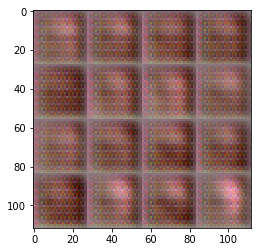

Epoch 1 / 1  D loss:  1.0260 ... G loss:  1.0092 ...
Epoch 1 / 1  D loss:  1.9175 ... G loss:  1.0578 ...
Epoch 1 / 1  D loss:  1.3957 ... G loss:  1.1030 ...
Epoch 1 / 1  D loss:  1.5145 ... G loss:  0.7854 ...
Epoch 1 / 1  D loss:  1.4705 ... G loss:  1.1227 ...
Epoch 1 / 1  D loss:  0.8116 ... G loss:  1.4980 ...
Epoch 1 / 1  D loss:  0.8107 ... G loss:  1.7289 ...
Epoch 1 / 1  D loss:  0.8651 ... G loss:  1.5631 ...
Epoch 1 / 1  D loss:  0.9236 ... G loss:  1.8780 ...
Epoch 1 / 1  D loss:  0.7076 ... G loss:  2.0595 ...


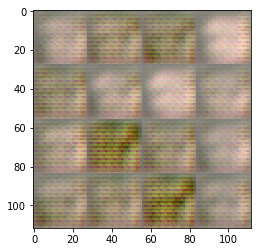

Epoch 1 / 1  D loss:  0.7016 ... G loss:  3.1395 ...
Epoch 1 / 1  D loss:  1.1229 ... G loss:  1.1734 ...
Epoch 1 / 1  D loss:  1.1415 ... G loss:  1.3250 ...
Epoch 1 / 1  D loss:  0.7178 ... G loss:  1.7612 ...
Epoch 1 / 1  D loss:  1.0858 ... G loss:  1.2506 ...
Epoch 1 / 1  D loss:  1.4093 ... G loss:  1.0504 ...
Epoch 1 / 1  D loss:  0.8167 ... G loss:  1.5214 ...
Epoch 1 / 1  D loss:  0.9857 ... G loss:  1.1173 ...
Epoch 1 / 1  D loss:  1.2866 ... G loss:  1.1851 ...
Epoch 1 / 1  D loss:  0.7361 ... G loss:  2.4965 ...


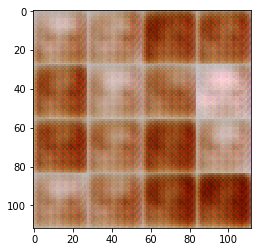

Epoch 1 / 1  D loss:  1.0543 ... G loss:  1.2699 ...
Epoch 1 / 1  D loss:  1.9022 ... G loss:  0.7179 ...
Epoch 1 / 1  D loss:  1.3893 ... G loss:  0.7518 ...
Epoch 1 / 1  D loss:  1.0852 ... G loss:  2.0435 ...
Epoch 1 / 1  D loss:  0.8086 ... G loss:  2.2255 ...
Epoch 1 / 1  D loss:  1.0578 ... G loss:  1.5888 ...
Epoch 1 / 1  D loss:  1.0374 ... G loss:  2.1802 ...
Epoch 1 / 1  D loss:  1.2264 ... G loss:  3.2111 ...
Epoch 1 / 1  D loss:  1.1220 ... G loss:  2.6272 ...
Epoch 1 / 1  D loss:  0.9663 ... G loss:  1.3719 ...


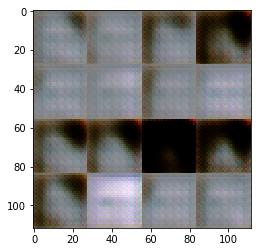

Epoch 1 / 1  D loss:  1.5080 ... G loss:  1.3777 ...
Epoch 1 / 1  D loss:  0.9840 ... G loss:  2.0540 ...
Epoch 1 / 1  D loss:  1.0121 ... G loss:  1.3220 ...
Epoch 1 / 1  D loss:  1.1492 ... G loss:  0.9396 ...
Epoch 1 / 1  D loss:  1.1396 ... G loss:  1.2071 ...
Epoch 1 / 1  D loss:  1.1436 ... G loss:  1.2758 ...
Epoch 1 / 1  D loss:  0.6348 ... G loss:  2.0451 ...
Epoch 1 / 1  D loss:  1.0679 ... G loss:  0.9872 ...
Epoch 1 / 1  D loss:  0.8517 ... G loss:  1.5120 ...
Epoch 1 / 1  D loss:  1.1409 ... G loss:  0.9133 ...


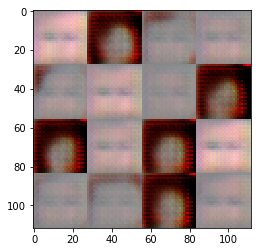

Epoch 1 / 1  D loss:  1.9902 ... G loss:  0.5673 ...
Epoch 1 / 1  D loss:  0.9096 ... G loss:  1.2368 ...
Epoch 1 / 1  D loss:  1.2397 ... G loss:  1.2121 ...


In [ ]:
# beta1 = .9
# testing noise vector
losses = train( net, epoch_count, batch_size, z_dim, 
                celeba_dataset.get_batches, celeba_dataset.image_mode)

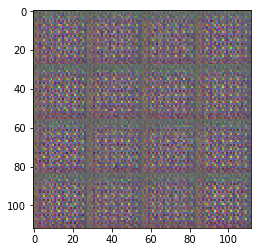

Epoch 1 / 1  D loss:  1.6478 ... G loss:  0.6487 ...
Epoch 1 / 1  D loss:  0.6120 ... G loss:  2.1078 ...
Epoch 1 / 1  D loss:  0.5847 ... G loss:  2.0112 ...
Epoch 1 / 1  D loss:  0.4919 ... G loss:  3.2708 ...
Epoch 1 / 1  D loss:  0.5851 ... G loss:  3.5492 ...
Epoch 1 / 1  D loss:  0.5217 ... G loss:  2.6363 ...
Epoch 1 / 1  D loss:  0.5321 ... G loss:  3.1541 ...
Epoch 1 / 1  D loss:  0.5579 ... G loss:  2.2751 ...
Epoch 1 / 1  D loss:  0.5098 ... G loss:  2.8975 ...


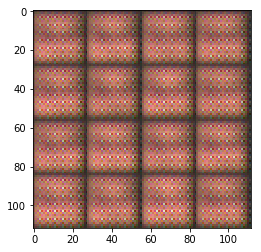

Epoch 1 / 1  D loss:  0.5226 ... G loss:  3.0608 ...
Epoch 1 / 1  D loss:  0.7188 ... G loss:  1.6050 ...
Epoch 1 / 1  D loss:  0.6914 ... G loss:  2.2271 ...
Epoch 1 / 1  D loss:  0.5661 ... G loss:  2.9407 ...
Epoch 1 / 1  D loss:  0.6799 ... G loss:  2.9852 ...
Epoch 1 / 1  D loss:  0.6645 ... G loss:  2.5262 ...
Epoch 1 / 1  D loss:  0.5486 ... G loss:  3.1046 ...
Epoch 1 / 1  D loss:  0.5173 ... G loss:  3.0536 ...
Epoch 1 / 1  D loss:  0.5104 ... G loss:  2.8158 ...
Epoch 1 / 1  D loss:  0.4601 ... G loss:  3.5322 ...


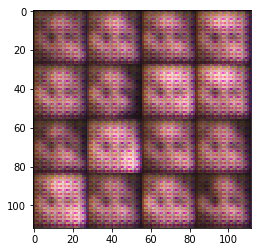

Epoch 1 / 1  D loss:  0.9367 ... G loss:  1.7075 ...
Epoch 1 / 1  D loss:  0.5680 ... G loss:  2.6127 ...
Epoch 1 / 1  D loss:  0.7466 ... G loss:  1.9161 ...
Epoch 1 / 1  D loss:  0.6405 ... G loss:  2.5743 ...
Epoch 1 / 1  D loss:  0.5595 ... G loss:  2.8778 ...
Epoch 1 / 1  D loss:  0.8460 ... G loss:  2.1195 ...
Epoch 1 / 1  D loss:  0.6832 ... G loss:  2.4997 ...
Epoch 1 / 1  D loss:  0.5219 ... G loss:  3.1946 ...
Epoch 1 / 1  D loss:  0.6836 ... G loss:  2.5805 ...
Epoch 1 / 1  D loss:  0.5100 ... G loss:  2.9177 ...


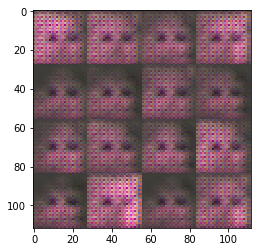

Epoch 1 / 1  D loss:  0.6579 ... G loss:  2.8188 ...
Epoch 1 / 1  D loss:  0.7122 ... G loss:  2.6439 ...
Epoch 1 / 1  D loss:  0.6067 ... G loss:  2.3979 ...
Epoch 1 / 1  D loss:  0.5071 ... G loss:  3.0551 ...
Epoch 1 / 1  D loss:  0.5669 ... G loss:  2.6386 ...
Epoch 1 / 1  D loss:  0.5367 ... G loss:  2.5792 ...
Epoch 1 / 1  D loss:  0.7093 ... G loss:  2.5219 ...
Epoch 1 / 1  D loss:  0.6397 ... G loss:  1.9730 ...
Epoch 1 / 1  D loss:  0.4801 ... G loss:  3.2097 ...
Epoch 1 / 1  D loss:  0.4339 ... G loss:  3.7835 ...


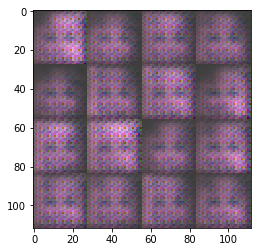

Epoch 1 / 1  D loss:  0.5596 ... G loss:  2.3068 ...
Epoch 1 / 1  D loss:  0.4854 ... G loss:  3.3887 ...
Epoch 1 / 1  D loss:  0.5184 ... G loss:  3.4897 ...
Epoch 1 / 1  D loss:  0.5486 ... G loss:  2.5997 ...
Epoch 1 / 1  D loss:  0.5987 ... G loss:  2.3181 ...
Epoch 1 / 1  D loss:  0.9171 ... G loss:  1.4711 ...
Epoch 1 / 1  D loss:  0.5717 ... G loss:  3.6711 ...
Epoch 1 / 1  D loss:  0.7216 ... G loss:  1.7086 ...
Epoch 1 / 1  D loss:  0.4646 ... G loss:  3.8947 ...
Epoch 1 / 1  D loss:  0.7038 ... G loss:  2.1145 ...


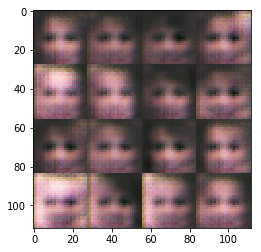

Epoch 1 / 1  D loss:  0.4550 ... G loss:  3.2477 ...
Epoch 1 / 1  D loss:  0.7599 ... G loss:  2.1487 ...
Epoch 1 / 1  D loss:  0.9298 ... G loss:  2.1472 ...
Epoch 1 / 1  D loss:  0.7855 ... G loss:  2.3739 ...
Epoch 1 / 1  D loss:  0.7155 ... G loss:  2.3788 ...
Epoch 1 / 1  D loss:  0.7391 ... G loss:  2.4370 ...
Epoch 1 / 1  D loss:  0.6686 ... G loss:  2.7573 ...
Epoch 1 / 1  D loss:  0.8094 ... G loss:  2.7874 ...
Epoch 1 / 1  D loss:  0.5083 ... G loss:  3.5771 ...
Epoch 1 / 1  D loss:  1.3261 ... G loss:  1.5923 ...


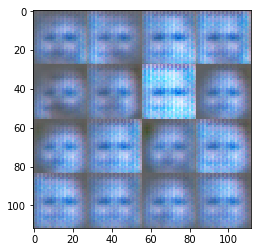

Epoch 1 / 1  D loss:  0.5590 ... G loss:  3.4008 ...
Epoch 1 / 1  D loss:  0.6375 ... G loss:  2.9919 ...
Epoch 1 / 1  D loss:  0.6695 ... G loss:  2.7359 ...
Epoch 1 / 1  D loss:  0.5779 ... G loss:  2.6589 ...
Epoch 1 / 1  D loss:  0.6772 ... G loss:  1.7129 ...
Epoch 1 / 1  D loss:  0.5140 ... G loss:  3.2605 ...
Epoch 1 / 1  D loss:  0.4516 ... G loss:  3.5147 ...
Epoch 1 / 1  D loss:  1.0171 ... G loss:  1.2057 ...
Epoch 1 / 1  D loss:  0.5942 ... G loss:  2.5603 ...
Epoch 1 / 1  D loss:  0.5630 ... G loss:  2.4267 ...


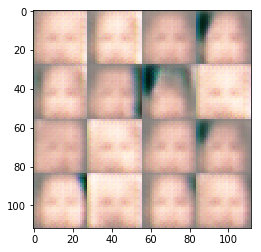

Epoch 1 / 1  D loss:  0.6983 ... G loss:  2.0993 ...
Epoch 1 / 1  D loss:  0.9885 ... G loss:  2.1091 ...
Epoch 1 / 1  D loss:  0.8933 ... G loss:  1.9164 ...
Epoch 1 / 1  D loss:  1.6885 ... G loss:  1.0465 ...
Epoch 1 / 1  D loss:  0.8676 ... G loss:  2.0382 ...
Epoch 1 / 1  D loss:  1.1315 ... G loss:  1.5078 ...
Epoch 1 / 1  D loss:  0.5725 ... G loss:  2.1396 ...
Epoch 1 / 1  D loss:  0.5017 ... G loss:  3.1312 ...
Epoch 1 / 1  D loss:  1.5715 ... G loss:  1.0517 ...
Epoch 1 / 1  D loss:  1.3651 ... G loss:  1.2619 ...


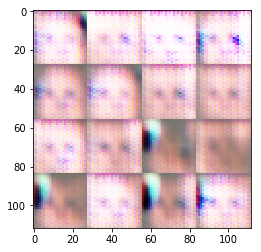

Epoch 1 / 1  D loss:  1.0193 ... G loss:  1.8898 ...
Epoch 1 / 1  D loss:  0.7590 ... G loss:  2.7850 ...
Epoch 1 / 1  D loss:  0.9426 ... G loss:  2.3622 ...
Epoch 1 / 1  D loss:  0.6786 ... G loss:  3.1953 ...
Epoch 1 / 1  D loss:  0.7001 ... G loss:  2.3934 ...
Epoch 1 / 1  D loss:  0.6121 ... G loss:  3.4853 ...
Epoch 1 / 1  D loss:  0.5336 ... G loss:  3.1345 ...
Epoch 1 / 1  D loss:  0.5618 ... G loss:  2.5930 ...
Epoch 1 / 1  D loss:  0.6251 ... G loss:  2.3355 ...
Epoch 1 / 1  D loss:  0.6963 ... G loss:  2.5157 ...


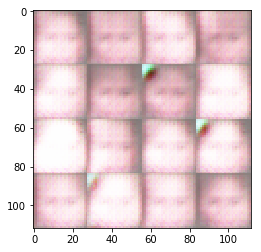

Epoch 1 / 1  D loss:  0.7507 ... G loss:  2.2043 ...
Epoch 1 / 1  D loss:  1.7075 ... G loss:  0.9826 ...
Epoch 1 / 1  D loss:  0.9064 ... G loss:  1.3419 ...
Epoch 1 / 1  D loss:  1.2119 ... G loss:  1.7644 ...
Epoch 1 / 1  D loss:  2.5736 ... G loss:  0.6641 ...
Epoch 1 / 1  D loss:  1.1154 ... G loss:  2.2838 ...
Epoch 1 / 1  D loss:  1.2441 ... G loss:  3.0394 ...
Epoch 1 / 1  D loss:  0.9173 ... G loss:  2.0423 ...
Epoch 1 / 1  D loss:  1.3312 ... G loss:  0.9963 ...
Epoch 1 / 1  D loss:  1.4671 ... G loss:  1.1723 ...


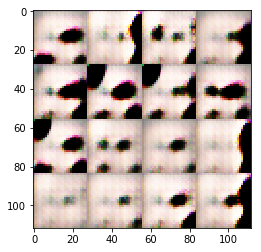

Epoch 1 / 1  D loss:  0.9391 ... G loss:  2.2009 ...
Epoch 1 / 1  D loss:  0.8374 ... G loss:  3.0532 ...
Epoch 1 / 1  D loss:  1.3139 ... G loss:  1.7446 ...
Epoch 1 / 1  D loss:  0.9623 ... G loss:  2.2841 ...
Epoch 1 / 1  D loss:  0.6109 ... G loss:  2.6362 ...
Epoch 1 / 1  D loss:  0.9267 ... G loss:  1.7303 ...
Epoch 1 / 1  D loss:  1.1933 ... G loss:  2.1249 ...
Epoch 1 / 1  D loss:  0.9027 ... G loss:  2.6948 ...
Epoch 1 / 1  D loss:  1.2392 ... G loss:  1.9328 ...
Epoch 1 / 1  D loss:  1.0363 ... G loss:  1.8517 ...


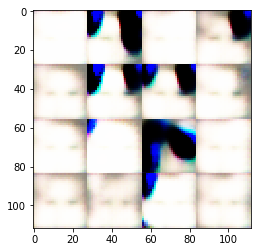

Epoch 1 / 1  D loss:  1.1894 ... G loss:  1.6792 ...


KeyboardInterrupt: 

In [26]:
# noise back to 1) instead of .5
losses = train( net, epoch_count, batch_size, z_dim, 
                celeba_dataset.get_batches, celeba_dataset.image_mode)

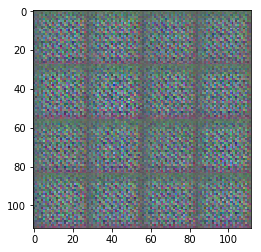

Epoch 1 / 1  D loss:  1.7742 ... G loss:  0.4467 ...
Epoch 1 / 1  D loss:  0.5442 ... G loss:  3.3637 ...
Epoch 1 / 1  D loss:  0.7863 ... G loss:  1.3396 ...
Epoch 1 / 1  D loss:  0.5953 ... G loss:  2.1425 ...
Epoch 1 / 1  D loss:  0.9598 ... G loss:  1.1436 ...
Epoch 1 / 1  D loss:  0.7922 ... G loss:  2.1088 ...
Epoch 1 / 1  D loss:  0.6557 ... G loss:  2.5922 ...
Epoch 1 / 1  D loss:  0.9655 ... G loss:  1.7796 ...
Epoch 1 / 1  D loss:  0.9878 ... G loss:  1.4632 ...


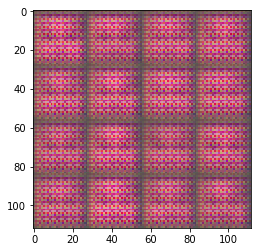

Epoch 1 / 1  D loss:  0.8546 ... G loss:  1.3001 ...
Epoch 1 / 1  D loss:  0.9189 ... G loss:  1.6487 ...
Epoch 1 / 1  D loss:  0.5812 ... G loss:  2.6076 ...
Epoch 1 / 1  D loss:  0.8697 ... G loss:  2.2845 ...
Epoch 1 / 1  D loss:  0.7929 ... G loss:  2.3888 ...
Epoch 1 / 1  D loss:  0.7413 ... G loss:  3.5857 ...
Epoch 1 / 1  D loss:  0.6721 ... G loss:  2.7611 ...
Epoch 1 / 1  D loss:  0.7523 ... G loss:  2.2293 ...
Epoch 1 / 1  D loss:  0.9303 ... G loss:  2.2480 ...
Epoch 1 / 1  D loss:  0.9065 ... G loss:  2.2258 ...


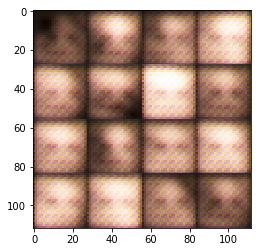

Epoch 1 / 1  D loss:  0.7242 ... G loss:  1.7866 ...
Epoch 1 / 1  D loss:  0.9163 ... G loss:  1.7318 ...
Epoch 1 / 1  D loss:  0.9373 ... G loss:  1.7085 ...
Epoch 1 / 1  D loss:  0.9370 ... G loss:  1.8251 ...
Epoch 1 / 1  D loss:  0.9843 ... G loss:  1.5934 ...
Epoch 1 / 1  D loss:  0.7884 ... G loss:  1.8164 ...
Epoch 1 / 1  D loss:  0.8400 ... G loss:  1.9666 ...
Epoch 1 / 1  D loss:  0.5918 ... G loss:  2.5735 ...
Epoch 1 / 1  D loss:  0.8701 ... G loss:  2.7275 ...
Epoch 1 / 1  D loss:  0.7116 ... G loss:  2.4694 ...


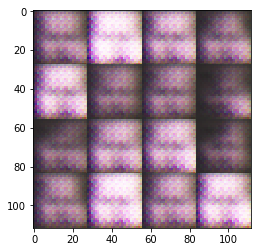

Epoch 1 / 1  D loss:  0.6669 ... G loss:  2.3294 ...
Epoch 1 / 1  D loss:  0.7657 ... G loss:  2.1516 ...
Epoch 1 / 1  D loss:  0.9546 ... G loss:  1.7636 ...
Epoch 1 / 1  D loss:  0.7864 ... G loss:  2.0149 ...
Epoch 1 / 1  D loss:  0.6488 ... G loss:  2.9281 ...
Epoch 1 / 1  D loss:  0.6626 ... G loss:  3.0123 ...
Epoch 1 / 1  D loss:  0.8045 ... G loss:  2.2599 ...
Epoch 1 / 1  D loss:  0.8680 ... G loss:  1.7902 ...
Epoch 1 / 1  D loss:  0.7325 ... G loss:  1.9081 ...
Epoch 1 / 1  D loss:  0.9018 ... G loss:  2.0150 ...


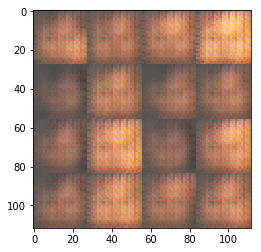

Epoch 1 / 1  D loss:  0.5809 ... G loss:  2.6166 ...
Epoch 1 / 1  D loss:  0.7785 ... G loss:  1.7924 ...
Epoch 1 / 1  D loss:  0.8529 ... G loss:  1.4009 ...
Epoch 1 / 1  D loss:  0.5962 ... G loss:  2.6632 ...
Epoch 1 / 1  D loss:  0.5952 ... G loss:  2.2631 ...
Epoch 1 / 1  D loss:  0.6078 ... G loss:  2.3481 ...
Epoch 1 / 1  D loss:  1.2752 ... G loss:  2.0128 ...
Epoch 1 / 1  D loss:  0.5367 ... G loss:  2.9510 ...
Epoch 1 / 1  D loss:  0.6496 ... G loss:  2.2183 ...
Epoch 1 / 1  D loss:  0.4501 ... G loss:  2.7826 ...


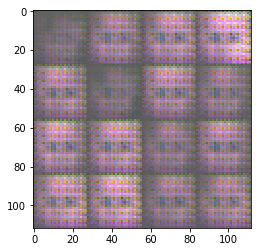

Epoch 1 / 1  D loss:  0.5006 ... G loss:  3.3121 ...
Epoch 1 / 1  D loss:  0.5663 ... G loss:  3.6106 ...
Epoch 1 / 1  D loss:  0.4357 ... G loss:  3.2943 ...
Epoch 1 / 1  D loss:  0.9761 ... G loss:  1.0273 ...
Epoch 1 / 1  D loss:  0.5697 ... G loss:  2.8505 ...
Epoch 1 / 1  D loss:  0.8271 ... G loss:  2.0917 ...
Epoch 1 / 1  D loss:  0.7172 ... G loss:  1.7523 ...
Epoch 1 / 1  D loss:  0.8984 ... G loss:  1.1852 ...
Epoch 1 / 1  D loss:  0.9126 ... G loss:  1.4775 ...
Epoch 1 / 1  D loss:  1.0807 ... G loss:  2.2595 ...


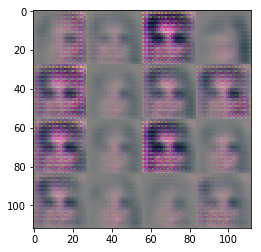

Epoch 1 / 1  D loss:  0.6179 ... G loss:  3.1768 ...
Epoch 1 / 1  D loss:  0.7559 ... G loss:  2.3845 ...
Epoch 1 / 1  D loss:  0.5879 ... G loss:  3.5763 ...
Epoch 1 / 1  D loss:  0.6714 ... G loss:  3.1045 ...
Epoch 1 / 1  D loss:  0.6503 ... G loss:  2.0314 ...
Epoch 1 / 1  D loss:  0.5840 ... G loss:  2.2691 ...
Epoch 1 / 1  D loss:  0.5562 ... G loss:  2.2860 ...
Epoch 1 / 1  D loss:  0.6805 ... G loss:  2.0257 ...
Epoch 1 / 1  D loss:  0.9485 ... G loss:  1.1696 ...
Epoch 1 / 1  D loss:  0.7953 ... G loss:  1.7251 ...


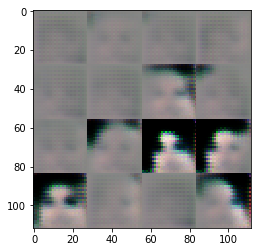

Epoch 1 / 1  D loss:  0.7810 ... G loss:  1.8366 ...
Epoch 1 / 1  D loss:  1.1576 ... G loss:  1.4888 ...
Epoch 1 / 1  D loss:  0.9895 ... G loss:  1.3382 ...
Epoch 1 / 1  D loss:  0.7566 ... G loss:  1.7769 ...
Epoch 1 / 1  D loss:  1.2106 ... G loss:  1.2111 ...
Epoch 1 / 1  D loss:  1.0044 ... G loss:  2.2285 ...
Epoch 1 / 1  D loss:  1.1080 ... G loss:  2.9263 ...
Epoch 1 / 1  D loss:  0.8023 ... G loss:  2.2698 ...
Epoch 1 / 1  D loss:  1.4647 ... G loss:  2.2273 ...
Epoch 1 / 1  D loss:  1.3685 ... G loss:  2.1399 ...


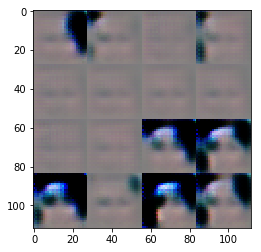

Epoch 1 / 1  D loss:  0.7421 ... G loss:  2.5474 ...
Epoch 1 / 1  D loss:  0.7336 ... G loss:  2.2372 ...
Epoch 1 / 1  D loss:  0.7809 ... G loss:  1.6064 ...
Epoch 1 / 1  D loss:  0.7920 ... G loss:  1.9887 ...
Epoch 1 / 1  D loss:  0.8608 ... G loss:  1.6946 ...
Epoch 1 / 1  D loss:  1.2959 ... G loss:  1.7723 ...
Epoch 1 / 1  D loss:  0.8987 ... G loss:  1.8269 ...
Epoch 1 / 1  D loss:  0.7127 ... G loss:  2.4046 ...
Epoch 1 / 1  D loss:  0.7911 ... G loss:  2.3076 ...
Epoch 1 / 1  D loss:  1.0579 ... G loss:  1.6242 ...


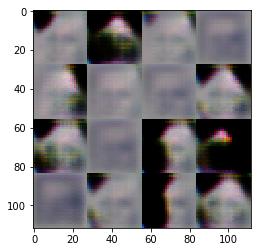

Epoch 1 / 1  D loss:  1.3505 ... G loss:  1.3174 ...
Epoch 1 / 1  D loss:  0.9692 ... G loss:  1.4664 ...
Epoch 1 / 1  D loss:  1.5468 ... G loss:  1.1734 ...
Epoch 1 / 1  D loss:  1.6140 ... G loss:  1.4295 ...
Epoch 1 / 1  D loss:  1.0502 ... G loss:  2.2231 ...
Epoch 1 / 1  D loss:  0.6839 ... G loss:  2.2976 ...
Epoch 1 / 1  D loss:  1.2895 ... G loss:  0.9432 ...
Epoch 1 / 1  D loss:  2.4215 ... G loss:  0.8159 ...
Epoch 1 / 1  D loss:  1.6285 ... G loss:  1.3325 ...
Epoch 1 / 1  D loss:  1.4248 ... G loss:  1.2104 ...


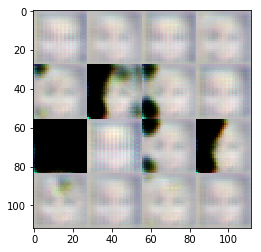

Epoch 1 / 1  D loss:  1.9601 ... G loss:  1.7504 ...
Epoch 1 / 1  D loss:  0.7697 ... G loss:  1.7907 ...
Epoch 1 / 1  D loss:  1.3346 ... G loss:  1.1439 ...
Epoch 1 / 1  D loss:  1.4553 ... G loss:  1.0124 ...
Epoch 1 / 1  D loss:  0.7165 ... G loss:  2.1947 ...
Epoch 1 / 1  D loss:  1.1928 ... G loss:  1.5072 ...
Epoch 1 / 1  D loss:  0.8585 ... G loss:  1.8766 ...
Epoch 1 / 1  D loss:  1.2476 ... G loss:  1.1848 ...
Epoch 1 / 1  D loss:  1.3668 ... G loss:  1.4726 ...
Epoch 1 / 1  D loss:  1.0580 ... G loss:  1.3033 ...


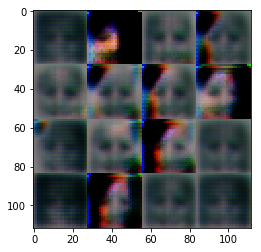

Epoch 1 / 1  D loss:  0.9701 ... G loss:  1.3462 ...
Epoch 1 / 1  D loss:  1.2895 ... G loss:  0.8814 ...
Epoch 1 / 1  D loss:  1.3879 ... G loss:  1.2757 ...
Epoch 1 / 1  D loss:  1.6674 ... G loss:  0.6259 ...
Epoch 1 / 1  D loss:  1.4141 ... G loss:  1.4038 ...
Epoch 1 / 1  D loss:  1.0338 ... G loss:  1.2032 ...
Epoch 1 / 1  D loss:  1.6312 ... G loss:  0.9687 ...
Epoch 1 / 1  D loss:  1.9641 ... G loss:  1.0864 ...
Epoch 1 / 1  D loss:  1.6719 ... G loss:  1.0490 ...
Epoch 1 / 1  D loss:  1.0146 ... G loss:  1.4668 ...


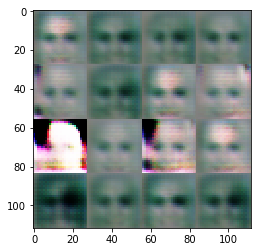

Epoch 1 / 1  D loss:  0.8060 ... G loss:  1.7087 ...
Epoch 1 / 1  D loss:  0.9283 ... G loss:  1.9049 ...
Epoch 1 / 1  D loss:  1.1993 ... G loss:  1.4185 ...
Epoch 1 / 1  D loss:  1.4928 ... G loss:  1.3121 ...
Epoch 1 / 1  D loss:  1.5288 ... G loss:  1.0503 ...
Epoch 1 / 1  D loss:  1.2555 ... G loss:  1.1677 ...
Epoch 1 / 1  D loss:  0.7550 ... G loss:  1.8084 ...
Epoch 1 / 1  D loss:  1.1411 ... G loss:  1.3420 ...
Epoch 1 / 1  D loss:  0.8665 ... G loss:  1.6943 ...
Epoch 1 / 1  D loss:  0.9191 ... G loss:  1.8596 ...


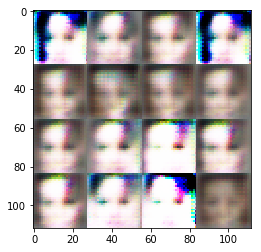

Epoch 1 / 1  D loss:  1.5187 ... G loss:  1.1095 ...
Epoch 1 / 1  D loss:  1.5519 ... G loss:  0.7364 ...
Epoch 1 / 1  D loss:  0.6399 ... G loss:  2.0642 ...
Epoch 1 / 1  D loss:  1.0462 ... G loss:  1.3952 ...
Epoch 1 / 1  D loss:  1.1096 ... G loss:  1.4039 ...
Epoch 1 / 1  D loss:  1.0255 ... G loss:  1.5426 ...
Epoch 1 / 1  D loss:  0.7978 ... G loss:  1.5950 ...
Epoch 1 / 1  D loss:  0.9015 ... G loss:  1.5785 ...
Epoch 1 / 1  D loss:  1.1395 ... G loss:  1.4394 ...
Epoch 1 / 1  D loss:  1.2893 ... G loss:  1.2029 ...


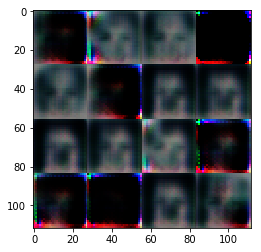

Epoch 1 / 1  D loss:  1.4417 ... G loss:  1.2057 ...
Epoch 1 / 1  D loss:  0.9917 ... G loss:  1.3688 ...
Epoch 1 / 1  D loss:  1.8891 ... G loss:  0.8674 ...
Epoch 1 / 1  D loss:  1.8851 ... G loss:  1.1215 ...
Epoch 1 / 1  D loss:  1.6229 ... G loss:  0.8398 ...
Epoch 1 / 1  D loss:  1.7421 ... G loss:  1.1614 ...
Epoch 1 / 1  D loss:  0.9767 ... G loss:  1.3500 ...
Epoch 1 / 1  D loss:  1.6031 ... G loss:  1.1183 ...
Epoch 1 / 1  D loss:  1.5660 ... G loss:  0.8751 ...
Epoch 1 / 1  D loss:  1.0995 ... G loss:  1.0930 ...


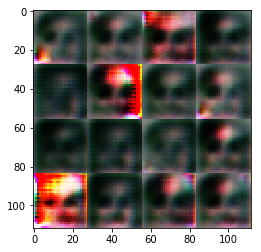

Epoch 1 / 1  D loss:  0.9297 ... G loss:  1.3999 ...
Epoch 1 / 1  D loss:  1.5962 ... G loss:  1.1552 ...
Epoch 1 / 1  D loss:  0.9523 ... G loss:  1.1684 ...
Epoch 1 / 1  D loss:  0.8972 ... G loss:  1.4620 ...
Epoch 1 / 1  D loss:  1.3288 ... G loss:  0.9027 ...
Epoch 1 / 1  D loss:  1.1740 ... G loss:  1.2512 ...
Epoch 1 / 1  D loss:  1.5438 ... G loss:  1.1706 ...
Epoch 1 / 1  D loss:  1.0316 ... G loss:  1.6098 ...
Epoch 1 / 1  D loss:  0.7823 ... G loss:  2.0537 ...


In [37]:
# g() extra layer
# g() switch logits to be single stride I think that makes more sense
losses = train( net, epoch_count, batch_size, z_dim, 
                celeba_dataset.get_batches, celeba_dataset.image_mode)

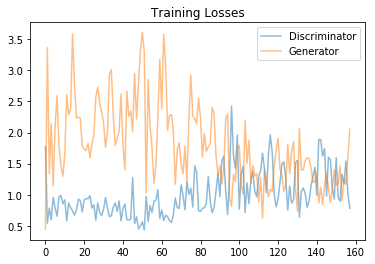

In [38]:
print_losses_chart(losses)

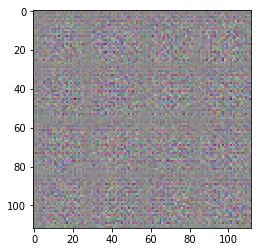

Epoch 1 / 1  D loss:  1.2758 ... G loss:  1.1255 ...
Epoch 1 / 1  D loss:  0.6623 ... G loss:  1.9911 ...
Epoch 1 / 1  D loss:  0.6571 ... G loss:  1.9955 ...
Epoch 1 / 1  D loss:  0.6127 ... G loss:  2.2168 ...
Epoch 1 / 1  D loss:  0.5705 ... G loss:  2.4764 ...
Epoch 1 / 1  D loss:  0.4787 ... G loss:  2.9460 ...
Epoch 1 / 1  D loss:  0.4708 ... G loss:  3.0998 ...
Epoch 1 / 1  D loss:  0.4795 ... G loss:  2.9551 ...
Epoch 1 / 1  D loss:  0.4639 ... G loss:  3.0044 ...


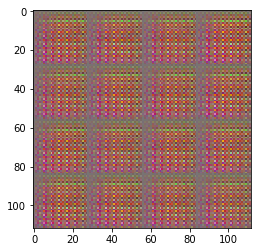

Epoch 1 / 1  D loss:  0.4412 ... G loss:  3.2027 ...
Epoch 1 / 1  D loss:  0.4362 ... G loss:  3.3752 ...
Epoch 1 / 1  D loss:  0.4057 ... G loss:  3.5668 ...
Epoch 1 / 1  D loss:  0.3910 ... G loss:  3.7115 ...
Epoch 1 / 1  D loss:  0.3930 ... G loss:  3.6850 ...
Epoch 1 / 1  D loss:  0.3918 ... G loss:  3.9292 ...
Epoch 1 / 1  D loss:  0.3911 ... G loss:  3.4035 ...
Epoch 1 / 1  D loss:  0.3629 ... G loss:  4.6214 ...
Epoch 1 / 1  D loss:  0.3718 ... G loss:  3.8229 ...
Epoch 1 / 1  D loss:  0.3876 ... G loss:  3.2989 ...


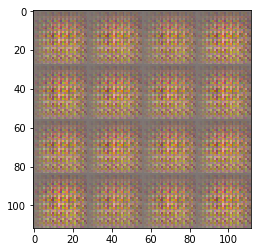

Epoch 1 / 1  D loss:  0.4088 ... G loss:  3.1871 ...
Epoch 1 / 1  D loss:  0.4016 ... G loss:  3.2225 ...
Epoch 1 / 1  D loss:  0.3799 ... G loss:  3.6540 ...
Epoch 1 / 1  D loss:  0.3666 ... G loss:  3.9519 ...
Epoch 1 / 1  D loss:  0.3752 ... G loss:  4.3830 ...
Epoch 1 / 1  D loss:  0.3789 ... G loss:  4.0582 ...
Epoch 1 / 1  D loss:  0.3776 ... G loss:  4.1508 ...
Epoch 1 / 1  D loss:  0.3652 ... G loss:  3.9971 ...
Epoch 1 / 1  D loss:  0.3762 ... G loss:  4.4739 ...
Epoch 1 / 1  D loss:  0.3775 ... G loss:  3.7477 ...


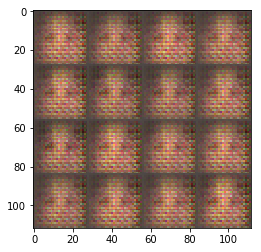

Epoch 1 / 1  D loss:  0.3728 ... G loss:  4.1154 ...
Epoch 1 / 1  D loss:  0.3658 ... G loss:  4.4594 ...
Epoch 1 / 1  D loss:  0.3916 ... G loss:  5.2291 ...
Epoch 1 / 1  D loss:  0.3990 ... G loss:  3.5632 ...
Epoch 1 / 1  D loss:  0.3936 ... G loss:  3.6707 ...
Epoch 1 / 1  D loss:  0.3957 ... G loss:  3.9459 ...
Epoch 1 / 1  D loss:  0.3983 ... G loss:  3.2500 ...
Epoch 1 / 1  D loss:  0.4045 ... G loss:  3.1632 ...
Epoch 1 / 1  D loss:  0.3839 ... G loss:  3.7861 ...
Epoch 1 / 1  D loss:  0.3847 ... G loss:  3.7404 ...


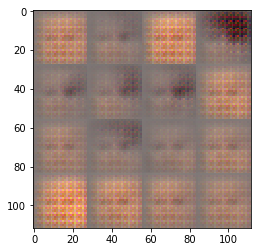

Epoch 1 / 1  D loss:  0.3972 ... G loss:  3.7230 ...
Epoch 1 / 1  D loss:  0.4104 ... G loss:  4.8809 ...
Epoch 1 / 1  D loss:  0.3904 ... G loss:  3.9315 ...
Epoch 1 / 1  D loss:  0.3872 ... G loss:  4.5570 ...
Epoch 1 / 1  D loss:  0.3864 ... G loss:  4.4181 ...
Epoch 1 / 1  D loss:  0.4180 ... G loss:  3.4811 ...
Epoch 1 / 1  D loss:  0.3624 ... G loss:  4.9036 ...
Epoch 1 / 1  D loss:  0.3706 ... G loss:  4.4803 ...
Epoch 1 / 1  D loss:  0.3962 ... G loss:  4.5277 ...
Epoch 1 / 1  D loss:  0.4199 ... G loss:  3.2826 ...


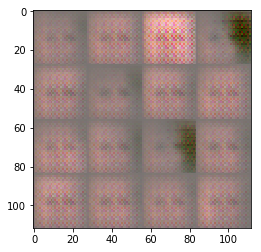

Epoch 1 / 1  D loss:  0.3877 ... G loss:  4.3673 ...
Epoch 1 / 1  D loss:  0.4098 ... G loss:  3.0805 ...
Epoch 1 / 1  D loss:  0.4263 ... G loss:  4.0989 ...
Epoch 1 / 1  D loss:  0.3859 ... G loss:  4.4381 ...
Epoch 1 / 1  D loss:  0.3829 ... G loss:  3.5807 ...
Epoch 1 / 1  D loss:  0.3935 ... G loss:  3.8406 ...
Epoch 1 / 1  D loss:  0.4132 ... G loss:  3.2279 ...
Epoch 1 / 1  D loss:  0.3595 ... G loss:  4.7065 ...
Epoch 1 / 1  D loss:  0.4084 ... G loss:  3.7150 ...
Epoch 1 / 1  D loss:  0.4035 ... G loss:  3.5958 ...


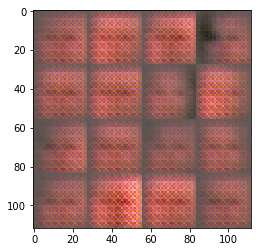

Epoch 1 / 1  D loss:  0.4020 ... G loss:  3.6496 ...
Epoch 1 / 1  D loss:  0.3886 ... G loss:  5.3030 ...
Epoch 1 / 1  D loss:  0.4021 ... G loss:  3.6930 ...
Epoch 1 / 1  D loss:  0.4063 ... G loss:  3.4914 ...
Epoch 1 / 1  D loss:  0.4165 ... G loss:  3.4424 ...
Epoch 1 / 1  D loss:  0.3839 ... G loss:  4.2898 ...
Epoch 1 / 1  D loss:  0.4189 ... G loss:  3.6467 ...
Epoch 1 / 1  D loss:  0.3829 ... G loss:  4.6590 ...
Epoch 1 / 1  D loss:  0.4142 ... G loss:  3.0120 ...
Epoch 1 / 1  D loss:  0.3842 ... G loss:  4.5733 ...


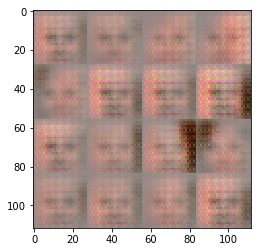

Epoch 1 / 1  D loss:  0.3793 ... G loss:  4.7015 ...
Epoch 1 / 1  D loss:  0.4459 ... G loss:  3.7276 ...
Epoch 1 / 1  D loss:  0.3809 ... G loss:  4.6584 ...
Epoch 1 / 1  D loss:  0.3739 ... G loss:  4.8508 ...
Epoch 1 / 1  D loss:  0.4686 ... G loss:  2.7072 ...
Epoch 1 / 1  D loss:  0.4099 ... G loss:  4.4333 ...
Epoch 1 / 1  D loss:  0.4230 ... G loss:  4.3190 ...
Epoch 1 / 1  D loss:  0.4668 ... G loss:  6.4822 ...
Epoch 1 / 1  D loss:  0.4302 ... G loss:  3.0776 ...
Epoch 1 / 1  D loss:  0.3820 ... G loss:  4.6904 ...


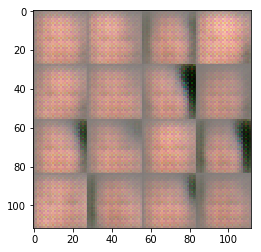

Epoch 1 / 1  D loss:  0.4210 ... G loss:  3.3565 ...
Epoch 1 / 1  D loss:  0.3950 ... G loss:  3.5753 ...
Epoch 1 / 1  D loss:  0.4371 ... G loss:  2.9034 ...
Epoch 1 / 1  D loss:  0.3719 ... G loss:  4.3607 ...
Epoch 1 / 1  D loss:  0.3858 ... G loss:  3.9342 ...
Epoch 1 / 1  D loss:  0.3757 ... G loss:  4.5956 ...
Epoch 1 / 1  D loss:  0.4178 ... G loss:  3.0170 ...
Epoch 1 / 1  D loss:  0.3708 ... G loss:  4.0451 ...
Epoch 1 / 1  D loss:  0.4399 ... G loss:  3.0413 ...
Epoch 1 / 1  D loss:  0.4140 ... G loss:  3.4223 ...


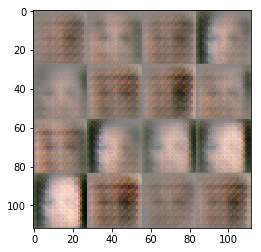

Epoch 1 / 1  D loss:  0.4357 ... G loss:  3.6038 ...
Epoch 1 / 1  D loss:  0.4135 ... G loss:  4.1441 ...
Epoch 1 / 1  D loss:  0.3984 ... G loss:  4.4752 ...
Epoch 1 / 1  D loss:  0.4011 ... G loss:  3.6521 ...
Epoch 1 / 1  D loss:  0.4069 ... G loss:  4.0574 ...
Epoch 1 / 1  D loss:  0.4386 ... G loss:  4.3249 ...
Epoch 1 / 1  D loss:  0.4321 ... G loss:  3.0070 ...
Epoch 1 / 1  D loss:  0.4076 ... G loss:  4.4640 ...
Epoch 1 / 1  D loss:  0.4088 ... G loss:  3.7089 ...
Epoch 1 / 1  D loss:  0.4471 ... G loss:  3.9250 ...


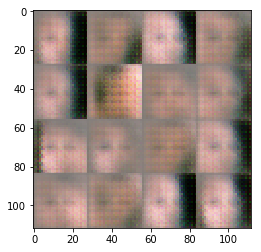

Epoch 1 / 1  D loss:  0.3847 ... G loss:  4.8117 ...
Epoch 1 / 1  D loss:  0.3990 ... G loss:  4.1118 ...
Epoch 1 / 1  D loss:  0.4333 ... G loss:  3.4967 ...
Epoch 1 / 1  D loss:  0.4018 ... G loss:  4.2798 ...
Epoch 1 / 1  D loss:  0.4056 ... G loss:  3.5385 ...
Epoch 1 / 1  D loss:  0.4442 ... G loss:  2.9967 ...
Epoch 1 / 1  D loss:  0.4228 ... G loss:  3.9050 ...
Epoch 1 / 1  D loss:  0.3968 ... G loss:  4.1172 ...
Epoch 1 / 1  D loss:  0.4501 ... G loss:  2.8556 ...
Epoch 1 / 1  D loss:  0.4191 ... G loss:  3.5053 ...


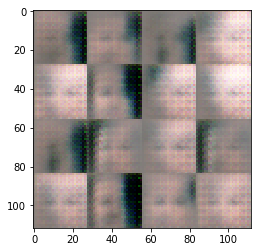

Epoch 1 / 1  D loss:  0.4177 ... G loss:  4.0528 ...
Epoch 1 / 1  D loss:  0.4539 ... G loss:  3.1661 ...
Epoch 1 / 1  D loss:  0.4319 ... G loss:  4.5828 ...
Epoch 1 / 1  D loss:  0.4412 ... G loss:  3.3095 ...
Epoch 1 / 1  D loss:  0.4179 ... G loss:  4.3184 ...
Epoch 1 / 1  D loss:  0.4652 ... G loss:  4.4146 ...
Epoch 1 / 1  D loss:  0.3973 ... G loss:  4.6431 ...
Epoch 1 / 1  D loss:  0.4141 ... G loss:  3.6103 ...
Epoch 1 / 1  D loss:  0.4092 ... G loss:  3.7793 ...
Epoch 1 / 1  D loss:  0.4486 ... G loss:  2.9042 ...


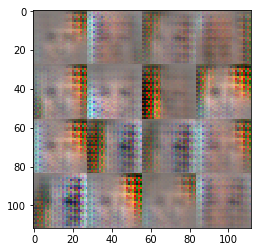

Epoch 1 / 1  D loss:  0.4014 ... G loss:  4.0888 ...
Epoch 1 / 1  D loss:  0.4663 ... G loss:  5.0734 ...
Epoch 1 / 1  D loss:  0.4094 ... G loss:  3.9118 ...
Epoch 1 / 1  D loss:  0.4035 ... G loss:  4.7033 ...
Epoch 1 / 1  D loss:  0.4367 ... G loss:  4.8257 ...
Epoch 1 / 1  D loss:  0.5162 ... G loss:  3.3943 ...
Epoch 1 / 1  D loss:  0.4732 ... G loss:  3.6631 ...
Epoch 1 / 1  D loss:  0.3781 ... G loss:  5.3155 ...
Epoch 1 / 1  D loss:  0.5582 ... G loss:  5.9396 ...
Epoch 1 / 1  D loss:  0.4912 ... G loss:  4.0275 ...


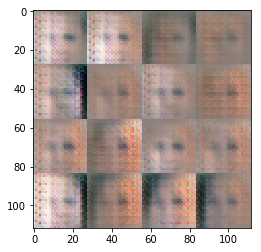

Epoch 1 / 1  D loss:  0.5093 ... G loss:  2.2083 ...
Epoch 1 / 1  D loss:  0.6046 ... G loss:  4.7896 ...
Epoch 1 / 1  D loss:  0.4593 ... G loss:  3.2458 ...
Epoch 1 / 1  D loss:  0.5566 ... G loss:  4.4186 ...
Epoch 1 / 1  D loss:  0.4396 ... G loss:  3.6356 ...
Epoch 1 / 1  D loss:  0.4086 ... G loss:  4.1336 ...
Epoch 1 / 1  D loss:  0.4846 ... G loss:  2.8743 ...
Epoch 1 / 1  D loss:  0.4617 ... G loss:  3.4387 ...
Epoch 1 / 1  D loss:  0.4389 ... G loss:  4.1155 ...
Epoch 1 / 1  D loss:  0.5465 ... G loss:  2.2724 ...


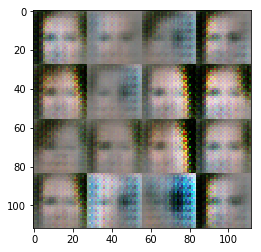

Epoch 1 / 1  D loss:  0.4517 ... G loss:  3.4495 ...
Epoch 1 / 1  D loss:  0.4802 ... G loss:  4.5912 ...
Epoch 1 / 1  D loss:  0.4518 ... G loss:  3.5514 ...
Epoch 1 / 1  D loss:  0.4761 ... G loss:  3.6808 ...
Epoch 1 / 1  D loss:  0.5549 ... G loss:  2.8835 ...
Epoch 1 / 1  D loss:  0.4606 ... G loss:  2.9446 ...
Epoch 1 / 1  D loss:  0.4601 ... G loss:  3.4958 ...
Epoch 1 / 1  D loss:  0.4592 ... G loss:  3.3073 ...
Epoch 1 / 1  D loss:  0.4707 ... G loss:  3.6377 ...
Epoch 1 / 1  D loss:  0.4821 ... G loss:  3.2335 ...


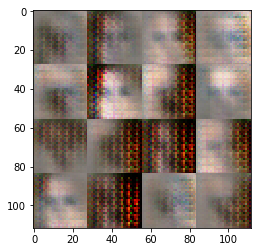

Epoch 1 / 1  D loss:  0.4853 ... G loss:  3.2238 ...
Epoch 1 / 1  D loss:  0.4440 ... G loss:  4.2510 ...
Epoch 1 / 1  D loss:  0.4718 ... G loss:  3.9410 ...
Epoch 1 / 1  D loss:  0.4269 ... G loss:  4.2517 ...
Epoch 1 / 1  D loss:  0.4070 ... G loss:  4.4372 ...
Epoch 1 / 1  D loss:  0.4156 ... G loss:  3.5187 ...
Epoch 1 / 1  D loss:  0.4377 ... G loss:  3.2412 ...
Epoch 1 / 1  D loss:  0.4711 ... G loss:  2.5901 ...
Epoch 1 / 1  D loss:  0.4645 ... G loss:  3.4744 ...


In [26]:
# learning rate 1e-4 in relation to beta1 as .9
# d() extra layer

losses = train( net, epoch_count, batch_size, z_dim, 
                celeba_dataset.get_batches, celeba_dataset.image_mode)

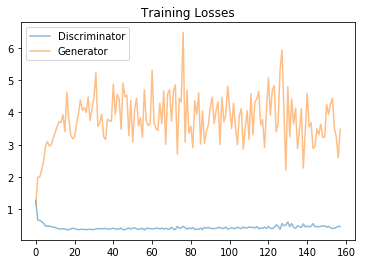

In [27]:
print_losses_chart(losses)
# observe this was with d() bigger than g()

---